In [1]:
# Import all libraries
import os
os.environ['KERAS_BACKEND'] = 'theano' # tensorflow leads to a memory leak with a gridsearch
from datetime import date, datetime
import math
import itertools
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import re
import unittest

import keras
from keras.wrappers.scikit_learn import KerasClassifier
import numpy as np
import pandas as pd
import trueskill
import seaborn as sn
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV, ShuffleSplit
from statistics import mean


def get_sport_data(competitions, 
                   years, 
                   competition_paths, 
                   format_file_name, 
                   required_fields=None, 
                   reverse=False):
    """
    Reads data for the given sports and returns it as a dictionary of dictionaries
    { competition_name : { year1 : [data], year2: [data], ... }, ... }
    
    :param competitions names of the competitions to add to the dictionary
    :param years the function expects the seasons to be separated by year; 
            years should be a list of all years to iterate for competitions
    :param competition_paths relative (or absolute) paths to competitions with the given names
    :param format_file_name function that transforms competition name and the given year to
            appropriate file name to look for in the competition_path
    :param required_fields accepts a list of tuples [(column_name, column_datatype)] and drops
            any entries where the field is not present. Also ensures that the given fields are
            of the required datatype
    :param reverse False by default, if True, will reverse the data before returning it
    
    :return dictionary that maps competition name to a dictionary of 
            relevant years associated with lists of data
    """
    data = {}
    for competition in competitions:
        data[competition] = {}
    
    for index, competition in enumerate(competitions):
        for year in years:
            tournament_name = format_file_name(competition_paths[index], year)
            data[competition][year] = pd.read_csv(tournament_name)
            if reverse:
                # Need to reverse because matches are from present to past
                data[competition][year] = data[competition][year].iloc[::-1] 

            initial_len = data[competition][year].shape[0]
            if required_fields:
                data[competition][year] = data[competition][year].dropna(subset=[x[0] for x in required_fields])
                for field, datatype in required_fields:
                    data[competition][year][data[competition][year][field].apply(lambda x: isinstance(x, datatype))]

            data[competition][year]['Date'] = pd.to_datetime(data[competition][year].Date)
            data[competition][year] = data[competition][year].sort_values('Date')
            data[competition][year] = data[competition][year].reset_index(drop=True)

            print("Got data for %s (%s)" % (tournament_name, 
                                            data[competition][year].shape[0]))
            if data[competition][year].shape[0] != initial_len:
                print("Dropped %s matches" % (initial_len - data[competition][year].shape[0]))
                
            data[competition][year]['Date'] = pd.to_datetime(data[competition][year].Date)
            data[competition][year] = data[competition][year].sort_values('Date')
        
    return data

competition_paths = ['Data/England - Premiership/Premier', 
                     'Data/France - Championnat/Championnat',
                     'Data/Germany - Bundesliga/Bundesliga', 
                     'Data/Italy - Serie A/SerieA']
competition_names = ['England - Premiership',
                     'France - Championnat',
                     'Germany - Bundesliga',
                     'Italy - Serie A']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in football data
football_data = get_sport_data(competition_names, 
                               years, 
                               competition_paths, 
                               lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                               required_fields=[("B365H", float), 
                                                ("B365D", float), 
                                                ("B365A", float), 
                                                ("FTHG", int),
                                                ("FTAG", int)],
                               reverse=False)

Using Theano backend.


Got data for Data/England - Premiership/Premier2008-2009.csv (380)
Got data for Data/England - Premiership/Premier2009-2010.csv (380)
Got data for Data/England - Premiership/Premier2010-2011.csv (380)
Got data for Data/England - Premiership/Premier2011-2012.csv (380)
Got data for Data/England - Premiership/Premier2012-2013.csv (380)
Got data for Data/England - Premiership/Premier2013-2014.csv (380)
Got data for Data/England - Premiership/Premier2014-2015.csv (380)
Dropped 1 matches
Got data for Data/England - Premiership/Premier2015-2016.csv (380)
Got data for Data/England - Premiership/Premier2016-2017.csv (380)
Got data for Data/England - Premiership/Premier2017-2018.csv (380)
Got data for Data/England - Premiership/Premier2018-2019.csv (380)
Got data for Data/France - Championnat/Championnat2008-2009.csv (380)
Got data for Data/France - Championnat/Championnat2009-2010.csv (380)
Got data for Data/France - Championnat/Championnat2010-2011.csv (380)
Got data for Data/France - Champion

In [2]:
def check_data_quality(df, required_fields):
    """
    Ensures that data in the given dataframe is not malformed.
    That is, check if any of the required fields are missing and
    display individual matches that are malformed.
    
    :param df that contains data
    :param required_fields column names that need to be checked
    """
    for competition in football_data:
        for year in years:
            required_fields_tournament = [list(football_data[competition][year].columns).index(x) for x in required_fields]
            if football_data[competition][year].isnull().values.any():
                # Check if null values are in any of the columns we care about
                for i, j in zip(*np.where(pd.isnull(football_data[competition][year]))):
                    if j in required_fields_tournament:
                        print("ERROR: Found NaN in %s" % competition)
                        print("Missing column %s at row index %s" % (football_data[competition][year].columns[j], i))
                for index, match in enumerate(football_data[competition][year]):
                    if (isinstance(match, float) or isinstance(match, int)) and np.isnan(match):
                        print("Match %s has NaN" % match)
        

required_fields = ["HomeTeam", "AwayTeam", "FTHG", "FTAG", "B365H", "B365D", "B365A"]
check_data_quality(football_data, required_fields)

In [3]:
# Test that the data is intact

class TestData(unittest.TestCase):

    def test_england(self):
        self.assertEqual(len(football_data['England - Premiership'][2008]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2009]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2010]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2011]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2012]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2013]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2014]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2015]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2016]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2017]), 380)
        self.assertEqual(len(football_data['England - Premiership'][2018]), 380)
        
    def test_france(self):
        self.assertEqual(len(football_data['France - Championnat'][2008]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2009]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2010]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2011]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2012]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2013]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2014]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2015]), 379)
        self.assertEqual(len(football_data['France - Championnat'][2016]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2017]), 380)
        self.assertEqual(len(football_data['France - Championnat'][2018]), 380)
        
    def test_germany(self):
        self.assertEqual(len(football_data['Germany - Bundesliga'][2008]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2009]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2010]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2011]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2012]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2013]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2014]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2015]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2016]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2017]), 306)
        self.assertEqual(len(football_data['Germany - Bundesliga'][2018]), 306)
        
    def test_italy(self):
        self.assertEqual(len(football_data['Italy - Serie A'][2008]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2009]), 379)
        self.assertEqual(len(football_data['Italy - Serie A'][2010]), 378)
        self.assertEqual(len(football_data['Italy - Serie A'][2011]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2012]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2013]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2014]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2015]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2016]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2017]), 380)
        self.assertEqual(len(football_data['Italy - Serie A'][2018]), 380)


unittest.main(argv=[''], verbosity=2, exit=False)

test_england (__main__.TestData) ... ok
test_france (__main__.TestData) ... ok
test_germany (__main__.TestData) ... ok
test_italy (__main__.TestData) ... ok

----------------------------------------------------------------------
Ran 4 tests in 0.005s

OK


In [2]:
class PredictionTracker(object):
    """
    Tracks prediction-relevant statistics for the given system.
    Algorithm-agnostic.
    Includes: accuracy, confusion matrix, MAE, RMSE
    """
    
    def __init__(self, competition_name=""):
        self.competition_name = competition_name
        self.num_predictions = 0.0
        self.corr_predictions = 0.0
        self.prediction_matrix = [[0, 0, 0],
                                  [0, 0, 0],
                                  [0, 0, 0]]
        self.mae = 0.0
        self.rmse = 0.0
        
    def predict(self, prediction, match_score, match_odds):
        """
        Records a prediction from the system
        
        :param prediction a tuple (win_chance, draw_chance, lose_chance) as predicted by the system;
                should add up to 1
        :param match_score tuple (home_goals, away_goals) containing match results
        :param match_odds a tuple containing bookie's odds (win_odds, draw_odds, lose_odds) in
                decimal format (i.e. 1.35, 2.6, etc)
        """
        self.num_predictions += 1
        win_odds, draw_odds, lose_odds = prediction
        
        if abs(win_odds - lose_odds) < Elo.DRAW_GAP:
            self.predict_draw(prediction, match_score, match_odds)
        elif win_odds >= draw_odds and win_odds >= lose_odds:
            # Predict win
            self.predict_win(prediction, match_score, match_odds)
        elif lose_odds >= win_odds and lose_odds >= draw_odds:
            # Predict lose
            self.predict_lose(prediction, match_score, match_odds)
        elif draw_odds >= win_odds and draw_odds >= lose_odds:
            # Predict draw
            self.predict_draw(prediction, match_score, match_odds)
    
    def predict_win(self, prediction_odds, match_score, match_odds):
        """
        The system predicted a win (home team).
        Decides whether the win prediction was correct or not and
        takes appropriate actions.
        
        :param prediction_odds a tuple (win_chance, draw_chance, lose_chance) as predicted by 
                the system; should add up to 1
        :param match_score tuple (home_goals, away_goals) containing match results
        :param match_odds a tuple containing bookie's odds (win_odds, draw_odds, lose_odds) in
                decimal format (i.e. 1.35, 2.6, etc)
        """
        if match_score[0] > match_score[1]:
            self.corr_predictions += 1
            self.correct_win(prediction_odds[0])
        elif match_score[0] == match_score[1]:
            self.incorrect_win_as_draw(prediction_odds[1])
        elif match_score[0] < match_score[1]:
            self.incorrect_win_as_lose(prediction_odds[2])

    def predict_draw(self, prediction_odds, match_score, match_odds):
        """
        The system predicted a draw.
        Decides whether the draw prediction was correct or not and
        takes appropriate actions.
        
        :param prediction_odds a tuple (win_chance, draw_chance, lose_chance) as predicted by 
                the system; should add up to 1
        :param match_score tuple (home_goals, away_goals) containing match results
        :param match_odds a tuple containing bookie's odds (win_odds, draw_odds, lose_odds) in
                decimal format (i.e. 1.35, 2.6, etc)
        """
        if match_score[0] == match_score[1]:
            self.corr_predictions += 1
            self.correct_draw(prediction_odds[1])
        elif match_score[0] > match_score[1]:
            self.incorrect_draw_as_win(prediction_odds[0])
        elif match_score[0] < match_score[1]:
            self.incorrect_draw_as_lose(prediction_odds[2])

    def predict_lose(self, prediction_odds, match_score, match_odds):
        """
        The system predicted a lose (away team).
        Decides whether the lose prediction was correct or not and
        takes appropriate actions.
        
        :param prediction_odds a tuple (win_chance, draw_chance, lose_chance) as predicted by 
                the system; should add up to 1
        :param match_score tuple (home_goals, away_goals) containing match results
        :param match_odds a tuple containing bookie's odds (win_odds, draw_odds, lose_odds) in
                decimal format (i.e. 1.35, 2.6, etc)
        """
        if match_score[0] < match_score[1]:
            self.corr_predictions += 1
            self.correct_lose(prediction_odds[2])
        elif match_score[0] > match_score[1]:
            self.incorrect_lose_as_win(prediction_odds[0])
        elif match_score[0] == match_score[1]:
            self.incorrect_lose_as_draw(prediction_odds[1])
    
    def correct_win(self, win_odds):
        """
        The win prediction was correct, update confusion matrix, MAE and RMSE
        
        :param win_odds chance of win as predicted by the system
        """
        self.prediction_matrix[0][0] += 1
        self.mae += abs(win_odds - 1)
        self.rmse += (win_odds - 1)**2
        
    def correct_draw(self, draw_odds):
        """
        The draw prediction was correct, update confusion matrix, MAE and RMSE
        
        :param draw_odds chance of draw as predicted by the system
        """
        self.prediction_matrix[1][1] += 1
        self.mae += abs(draw_odds - 1)
        self.rmse += (draw_odds - 1)**2
        
    def correct_lose(self, lose_odds):
        """
        The lose prediction was correct, update confusion matrix, MAE and RMSE
        
        :param lose_odds chance of lose as predicted by the system
        """
        self.prediction_matrix[2][2] += 1
        self.mae += abs(lose_odds - 1)
        self.rmse += (lose_odds - 1)**2
    
    def incorrect_win_as_draw(self, draw_odds):
        """
        A draw was incorrectly classified as a win, update confusion matrix, MAE and RMSE
        
        :param draw_odds chance of draw as predicted by the system
        """
        self.prediction_matrix[0][1] += 1
        self.mae += abs(draw_odds - 1)
        self.rmse += (draw_odds - 1)**2
    
    def incorrect_win_as_lose(self, lose_odds):
        """
        A lose was incorrectly classified as a win, update confusion matrix, MAE and RMSE
        
        :param lose_odds chance of lose as predicted by the system
        """
        self.prediction_matrix[0][2] += 1
        self.mae += abs(lose_odds - 1)
        self.rmse += (lose_odds - 1)**2
        
    def incorrect_draw_as_win(self, win_odds):
        """
        A win was incorrectly classified as a draw, update confusion matrix, MAE and RMSE
        
        :param win_odds chance of win as predicted by the system
        """
        self.prediction_matrix[1][0] += 1
        self.mae += abs(win_odds - 1)
        self.rmse += (win_odds - 1)**2
    
    def incorrect_draw_as_lose(self, lose_odds):
        """
        A lose was incorrectly classified as a draw, update confusion matrix, MAE and RMSE
        
        :param lose_odds chance of lose as predicted by the system
        """
        self.prediction_matrix[1][2] += 1
        self.mae += abs(lose_odds - 1)
        self.rmse += (lose_odds - 1)**2
        
    def incorrect_lose_as_win(self, win_odds):
        """
        A win was incorrectly classified as a lose, update confusion matrix, MAE and RMSE
        
        :param win_odds chance of win as predicted by the system
        """
        self.prediction_matrix[2][0] += 1
        self.mae += abs(win_odds - 1)
        self.rmse += (win_odds - 1)**2
    
    def incorrect_lose_as_draw(self, draw_odds):
        """
        A draw was incorrectly classified as a lose, update confusion matrix, MAE and RMSE
        
        :param draw_odds chance of draw as predicted by the system
        """
        self.prediction_matrix[2][1] += 1
        self.mae += abs(draw_odds - 1)
        self.rmse += (draw_odds - 1)**2
        
    def display_confusion_matrix(self):
        """
        Displays confusion matrix of the current predictions 
        """
        df_cm = pd.DataFrame(self.prediction_matrix, 
                             index = ["Win", "Draw", "Lose"], 
                             columns = ["Win", "Draw", "Lose"])
        plt.figure(figsize = (10,6))
        sn.heatmap(df_cm, annot=True)
        plt.title(self.competition_name)
        plt.show()
    
    def win_tp(self):
        """
        :return win true positives
        """
        return self.prediction_matrix[0][0]
    
    def win_fp(self):
        """
        :return win false positives
        """
        return self.prediction_matrix[0][1] + self.prediction_matrix[0][2]
    
    def draw_tp(self):
        """
        :return draw true positives
        """
        return self.prediction_matrix[1][1]
    
    def draw_fp(self):
        """
        :return draw false positives
        """
        return self.prediction_matrix[1][0] + self.prediction_matrix[1][2]
    
    def lose_tp(self):
        """
        :return lose true positives
        """
        return self.prediction_matrix[2][2]
    
    def lose_fp(self):
        """
        :return lose false positives
        """
        return self.prediction_matrix[2][0] + self.prediction_matrix[2][1]
    
    def true_positives(self):
        """
        :return win, draw and lose true positives combined
        """
        return self.win_tp() + self.draw_tp() + self.lose_tp()
    
    def zero_division_decorator(func):
        """
        Decorator that executes func inside a try - except block,
        catching ZeroDivisionError
        
        :param func function to execute, wrapping in 
                ZeroDivisionError try - except
        """
        def wrapped(n):
            try:
                return func(n)
            except ZeroDivisionError:
                return 0
        return wrapped
    
    @zero_division_decorator
    def prediction_accuracy(self):
        """
        :return returns the prediction accuracy
        """
        return (float(self.corr_predictions) / self.num_predictions) * 100 if self.num_predictions > 0 else 0
    
    @zero_division_decorator
    def get_mae(self):
        """
        :return MAE of predictions
        """
        return 1.0 / self.num_predictions * self.mae
    
    @zero_division_decorator
    def get_rmse(self):
        """
        :return RMSE of predictions
        """
        return math.sqrt(self.rmse / self.num_predictions)

    @zero_division_decorator
    def win_precision(self):
        """
        :return win precision
        """
        return self.win_tp() / (self.win_tp() + self.prediction_matrix[1][0] + self.prediction_matrix[2][0])
    
    @zero_division_decorator
    def draw_precision(self):
        """
        :return draw precision
        """
        return self.draw_tp() / (self.draw_tp() + self.prediction_matrix[0][1] + self.prediction_matrix[2][1])
    
    @zero_division_decorator
    def lose_precision(self):
        """
        :return lose precision
        """
        return self.lose_tp() / (self.lose_tp() + self.prediction_matrix[0][2] + self.prediction_matrix[1][2])
    
    @zero_division_decorator
    def win_recall(self):
        """
        :return win recall
        """
        return self.win_tp() / (self.win_tp() + self.win_fp())
    
    @zero_division_decorator
    def draw_recall(self):
        """
        :return draw recall
        """
        return self.draw_tp() / (self.draw_tp() + self.draw_fp())
    
    @zero_division_decorator
    def lose_recall(self):
        """
        :return lose recall
        """
        return self.lose_tp() / (self.lose_tp() + self.lose_fp())
    
    @zero_division_decorator
    def win_f1(self):
        """
        :return win F1
        """
        return (2 * self.win_precision() * self.win_recall()) / (self.win_precision() + self.win_recall())
    
    @zero_division_decorator
    def draw_f1(self):
        """
        :return draw F1
        """
        return (2 * self.draw_precision() * self.draw_recall()) / (self.draw_precision() + self.draw_recall())
    
    @zero_division_decorator
    def lose_f1(self):
        """
        :return lose F1
        """
        return (2 * self.lose_precision() * self.lose_recall()) / (self.lose_precision() + self.lose_recall())
    
    
def display_teams_rating(teams):
    """
    Prints the teams in descending order of skill (highest to lowest)
    
    :param teams a dictionary of team names associated with their skill level
    """
    team_names = list(teams.keys())
    team_ratings = list(teams.values())
    sorted_teams = sorted(zip(team_ratings, team_names), key=lambda x: x[0].rating, reverse=True)
    for index, team in enumerate(sorted_teams):
        print("%s: Team %s has rating %s" % (index+1, team[1], team[0].rating))
    
    
def plot_teams_rating(teams):
    """
    Plots the teams in descending order of skill (highest to lowest) as a bar plot
    
    :param teams a dictionary of team names associated with their skill level
    """
    team_names = list(teams.keys())
    team_ratings = list(teams.values())
    sorted_teams = sorted(zip(team_ratings, team_names), key=lambda x: x[0].rating, reverse=True)
    
    team_names = [x[1] for x in sorted_teams]
    team_ratings = [x[0].rating for x in sorted_teams]
    
    fig, ax = plt.subplots()
    plt.bar(range(len(team_names)), team_ratings, align="center")
    plt.xticks(range(len(team_names)), team_names, rotation='vertical')
    plt.show()

In [4]:
# Test the PredictionTracker

class TestPredictionTracker(unittest.TestCase):

    def test_init(self):
        prediction_tracker = PredictionTracker("Test")
        self.assertEqual(prediction_tracker.competition_name, "Test")
        self.assertEqual(prediction_tracker.mae, 0)
        self.assertEqual(prediction_tracker.rmse, 0)
        self.assertEqual(prediction_tracker.prediction_matrix[0][0], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[0][1], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[0][2], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[1][0], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[1][1], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[1][2], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[2][0], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[2][1], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[2][2], 0)
        self.assertEqual(prediction_tracker.num_predictions, 0)
        self.assertEqual(prediction_tracker.corr_predictions, 0)
        
    def test_correct_win_prediction(self):
        prediction_tracker = PredictionTracker("Test")
        prediction_tracker.predict((0.9, 0.0, 0.1), # Prediction Odds
                                   (1, 0),  # Match Score
                                   (2.0, 6.0, 4.0) # Bookie Odds
                                  )
        
        self.assertEqual(round(prediction_tracker.mae, 2), 0.1)
        self.assertEqual(round(prediction_tracker.rmse, 2), 0.01)
        self.assertEqual(round(prediction_tracker.get_mae(), 2), 0.1)
        self.assertEqual(round(prediction_tracker.get_rmse(), 2), 0.1)
        self.assertEqual(prediction_tracker.prediction_matrix[0][0], 1)
        self.assertEqual(prediction_tracker.prediction_matrix[0][1], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[0][2], 0)
        self.assertEqual(prediction_tracker.win_tp(), 1)
        self.assertEqual(prediction_tracker.win_fp(), 0)
        self.assertEqual(prediction_tracker.win_precision(), 1)
        self.assertEqual(prediction_tracker.win_recall(), 1)
        self.assertEqual(prediction_tracker.win_f1(), 1)
    
    def test_correct_lose_prediction(self):
        prediction_tracker = PredictionTracker("Test")
        prediction_tracker.predict((0.1, 0.0, 0.9), # Prediction Odds
                                   (0, 1),  # Match Score
                                   (2.0, 6.0, 4.0) # Bookie Odds
                                  )
        
        self.assertEqual(round(prediction_tracker.mae, 2), 0.1)
        self.assertEqual(round(prediction_tracker.rmse, 2), 0.01)
        self.assertEqual(round(prediction_tracker.get_mae(), 2), 0.1)
        self.assertEqual(round(prediction_tracker.get_rmse(), 2), 0.1)
        self.assertEqual(prediction_tracker.prediction_matrix[2][0], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[2][1], 0)
        self.assertEqual(prediction_tracker.prediction_matrix[2][2], 1)
        self.assertEqual(prediction_tracker.lose_tp(), 1)
        self.assertEqual(prediction_tracker.lose_fp(), 0)
        self.assertEqual(prediction_tracker.lose_precision(), 1)
        self.assertEqual(prediction_tracker.lose_recall(), 1)
        self.assertEqual(prediction_tracker.lose_f1(), 1)
    

unittest.main(argv=[''], verbosity=2, exit=False)

test_correct_lose_prediction (__main__.TestPredictionTracker) ... ERROR
test_correct_win_prediction (__main__.TestPredictionTracker) ... ERROR
test_init (__main__.TestPredictionTracker) ... ok

ERROR: test_correct_lose_prediction (__main__.TestPredictionTracker)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "<ipython-input-4-e620b99daf61>", line 46, in test_correct_lose_prediction
    (2.0, 6.0, 4.0) # Bookie Odds
  File "<ipython-input-3-3eeb5187a9b6>", line 31, in predict
    if abs(win_odds - lose_odds) < Elo.DRAW_GAP:
NameError: name 'Elo' is not defined

ERROR: test_correct_win_prediction (__main__.TestPredictionTracker)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "<ipython-input-4-e620b99daf61>", line 26, in test_correct_win_prediction
    (2.0, 6.0, 4.0) # Bookie Odds
  File "<ipython-input-3-3eeb5187a9b6>", line 31, in predict
    if abs(win_od

In [3]:
class Elo(object):
    """
    ELO MODEL

    Train each team

    R`(A) = 10^R(A)/400
    and
    R`(B) = 10^R(B)/400

    Then, expected score E(A) and E(B) for each team needs to be calculated:

    E(A) = R`(A) / (R`(A) + R`(B))
    and
    E(B) = R`(B) / (R`(A) + R`(B))

    The match outcome, O(A) and O(B), can be either 1, 0.5 or 0 in case of a win, a draw or a loss respectively.

    Lastly, we can use K-score to update the team score:

    R(A) = K * (O(A) - E(A)) + R(A)
    and
    R(B) = K * (O(B) - E(B)) + R(B)

    The K-score determines the extent to which the match outcome is reflective of the actual team skill. For example, in chess, K of 32 is typically used.
    """
    
    K_SCORE = lambda x: 32
    DRAW_CHANCE = 0.0
    DRAWN_GAMES = 0.0
    TOTAL_GAMES = 0.0
    DRAW_GAP = 0
    HOME_ADVANTAGE = 0
    
    def reset(elo_stats):
        """
        Sets the system settings according to the provided elo_stats object
        
        :param elo_stats a configuration object with relevant parameters
        """
        EloTeam.MIN_GAMES = elo_stats.min_games
        Elo.K_SCORE = elo_stats.k_score
        Elo.DRAW_GAP = elo_stats.draw_gap
        Elo.HOME_ADVANTAGE = elo_stats.home_advantage
        Elo.DRAW_CHANCE = 0.0
        Elo.DRAWN_GAMES = 0.0
        Elo.TOTAL_GAMES = 0.0
    
    def expected_score(a_trans_score, b_trans_score):
        """
        Calculates the expected score of team a vs. team b
        
        :param a_trans_score
        :param b_trans_score
        
        :return
        """
        return a_trans_score / (a_trans_score + b_trans_score), b_trans_score / (a_trans_score + b_trans_score)
    
    def transform_score(team):
        return 10**(team.rating / 400)
    
    def get_outcome(result):
        return 1 if result[0] > result[1] else 0 if result[1] > result[0] else 0.5, \
                0 if result[0] > result[1] else 1 if result[1] > result[0] else 0.5
    
    def play_match(team_a, team_b, result, match_date, update_draw=False):
        Elo.TOTAL_GAMES += 1
        if result[0] == result[1]:
            Elo.DRAWN_GAMES += 1
        Elo.DRAW_CHANCE = Elo.DRAWN_GAMES / Elo.TOTAL_GAMES / 2
        if update_draw:
            Elo.DRAW_GAP = Elo.DRAW_CHANCE
        
        team_a.games_played += 1
        team_b.games_played += 1
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
        outcome_a, outcome_b = Elo.get_outcome(result)
        
        upd_a_rating = team_a.rating + Elo.__get_k_score(team_a) * (outcome_a - expected_a)
        upd_b_rating = team_b.rating + Elo.__get_k_score(team_b) * (outcome_b - expected_b)
        
        team_a.last_game_date = match_date
        team_b.last_game_date = match_date
        
        return upd_a_rating, upd_b_rating
    
    def parse_predictions(expected_a, expected_b, draw=False):
            return expected_a + Elo.HOME_ADVANTAGE, 0, expected_b - Elo.HOME_ADVANTAGE
    
    def predict_match(team_a, team_b, predictors, score, odds, draw=False):
        if team_a.games_played > EloTeam.MIN_GAMES and team_b.games_played > EloTeam.MIN_GAMES:
            expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
            predictors[0].predict(Elo.parse_predictions(expected_a, expected_b, draw=draw), score, odds)
            predictors[1].predict(odds[::-1], score, odds)
            predictors[2].predict(Elo.parse_predictions(expected_a, expected_b, draw=draw), score, odds)
            predictors[3].predict(odds[::-1], score, odds)
            
    def __get_k_score(team):
        return Elo.K_SCORE(team)
        

class EloStats(object):
    
    def __init__(self, 
                 min_games=10, 
                 k_score=lambda x: 32, 
                 draw_gap=0, 
                 home_advantage=0):
        self.min_games = min_games
        self.k_score = k_score
        self.draw_gap = draw_gap
        self.home_advantage = home_advantage
        
    def __str__(self):
        return "Min Games " + str(self.min_games) + " | K Score " + str(self.k_score) + " | Draw Gap " + str(self.draw_gap) + " | Home Advantage " + str(self.home_advantage)
        
    def __repr__(self):
        return "Min Games " + str(self.min_games) + " | K Score " + str(self.k_score) + " | Draw Gap " + str(self.draw_gap) + " | Home Advantage " + str(self.home_advantage)
        
        
class EloTeam(object):
    DEFAULT_RATING = 1200
    MIN_GAMES = 10
    
    def __init__(self):
        self.rating = EloTeam.DEFAULT_RATING
        self.games_played = 0
        self.last_game_date = None
        
        
def train_elo(data, prediction_trackers, teams={}, draw=False, update_draw=False, elo_class=Elo):
    for index, match in data.iterrows():
        if match['HomeTeam'] not in teams.keys():
                teams[match['HomeTeam']] = EloTeam()
        if match['AwayTeam'] not in teams.keys():
            teams[match['AwayTeam']] = EloTeam()

        # Predict match
        elo_class.predict_match(teams[match['HomeTeam']], teams[match['AwayTeam']],
                                prediction_trackers, (match['FTHG'], match['FTAG']),
                                (match['B365H'], match['B365D'], match['B365A']), draw=draw)

        teams[match['HomeTeam']].rating, teams[match['AwayTeam']].rating = elo_class.play_match(teams[match['HomeTeam']],
                                                                                                teams[match['AwayTeam']],
                                                                                                (match['FTHG'], match['FTAG']),
                                                                                                match['Date'],
                                                                                                update_draw=update_draw)
    return teams


def run_elo_training(elo_stats, verbose=False, rating=False, plot=False, update_draw=False, elo_classes={"ALL" : Elo}):
    comp_pred = []
    bookie_comp_pred = []
    comp_year_pred = []
    bookie_comp_year_pred = []
    for competition in football_data:
        elo_class = elo_classes[competition] if competition in elo_classes else elo_classes["ALL"]
        if competition in elo_stats:
            elo_class.reset(elo_stats[competition])
            print("Elo Class %s" % elo_stats[competition])
        else:
            try:
                elo_class.reset(elo_stats["ALL"])
                print("Elo Class %s" % elo_stats["ALL"])
            except KeyError as ex:
                print("'ALL' EloStats not present. If you don't specify the competition key,\
                      you must provide a default under ALL")
                raise ex
        comp_pred.append(PredictionTracker(competition))
        bookie_comp_pred.append(PredictionTracker(competition))
            
        if verbose:
            print("Processing competition %s | got %s matches" % (competition, len(football_data[competition])))
        
        trained_teams = {}
        for year in years:
            comp_year_pred.append(PredictionTracker(competition + str(year)))
            bookie_comp_year_pred.append(PredictionTracker(competition + str(year)))
            trained_teams = train_elo(football_data[competition][year], 
                                      [comp_year_pred[-1], bookie_comp_year_pred[-1], comp_pred[-1], bookie_comp_pred[-1]], 
                                      update_draw=update_draw, 
                                      elo_class=elo_class, 
                                      teams=trained_teams)
        if plot:
            display_teams_rating(trained_teams)
        if rating:
            plot_teams_rating(trained_teams)
            
    return comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred
        

def get_accuracies(predictions, label, plot_cf=False, plot_accuracies=False, debug=False):
    """
    Calculate overall accuracy for Elo predictions
    """
    
    def print_metrics(prediction_tracker):
        if plot_cf:
            prediction_tracker.display_confusion_matrix()
            
        print("Accuracy: {:.2f}%".format(prediction_tracker.prediction_accuracy()))
        print("MAE: {:.2f}".format(prediction_tracker.get_mae()))
        print("RMSE: {:.2f}".format(prediction_tracker.get_rmse()))
        print("Precision: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_precision(), 
                                                                            prediction_tracker.draw_precision(),
                                                                            prediction_tracker.lose_precision()))
        print("Recall: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_recall(), 
                                                                            prediction_tracker.draw_recall(),
                                                                            prediction_tracker.lose_recall()))
        print("F1: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_f1(), 
                                                                     prediction_tracker.draw_f1(),
                                                                     prediction_tracker.lose_f1()))
        labels.append(prediction_tracker.competition_name)
    
    def plot_accuracies(keys, values, ylabel="", xlabel="", title=""):
        # Plot competition accuracies
        fig, ax = plt.subplots(figsize=(10, 7))
        plt.bar(range(len(values)), values, align="center")
        for i, v in enumerate(values):
            ax.text(i - 0.125, v - 2, str(round(v, 2)) + "%", color='white')
        plt.xticks(range(len(values)), keys, rotation='vertical')
        ax.set_ylabel(ylabel)
        ax.set_xlabel(xlabel)
        plt.title(title)
        plt.show()
        
    def convert_name(competition_name):
        if "England" in prediction_tracker.competition_name:
            return "England"
        elif "France" in prediction_tracker.competition_name:
            return "France"
        elif "Germany" in prediction_tracker.competition_name:
            return "Germany"
        elif "Italy" in prediction_tracker.competition_name:
            return "Italy"
    
    accuracies_2018 = {}
    accuracies = {"England": [],
                  "France": [],
                  "Germany": [],
                  "Italy": []}
    labels = []
    for prediction_tracker in predictions:
        comp_name = convert_name(prediction_tracker.competition_name)
        if debug:
            print_metrics(prediction_tracker)
            
        if "2018" in prediction_tracker.competition_name:
            accuracies_2018[prediction_tracker.competition_name] = prediction_tracker.prediction_accuracy()
            print_metrics(prediction_tracker)
        else:
            accuracies[comp_name].append(prediction_tracker.prediction_accuracy())
            
    accuracies["England"] = sum(accuracies["England"]) / len(accuracies["England"])
    accuracies["France"] = sum(accuracies["France"]) / len(accuracies["France"])
    accuracies["Germany"] = sum(accuracies["Germany"]) / len(accuracies["Germany"])
    accuracies["Italy"] = sum(accuracies["Italy"]) / len(accuracies["Italy"])
            
    if plot_accuracies:
        if debug:
            fig, ax = plt.subplots(figsize=(10, 7))
            plt.bar(range(len(accuracies)), accuracies, align="center")
            for i, v in enumerate(accuracies):
                ax.text(i - i * 0.125, v - 2, str(round(v, 2)) + "%", color='white')
            plt.xticks(range(len(accuracies)), labels, rotation='vertical')
            ax.set_ylabel("Accuracy (%)")
            ax.set_xlabel("Competition")
            plt.title("Competition Accuracies")
            plt.show()
        
        if len(list(accuracies_2018.keys())) > 0:
            plot_accuracies(list(accuracies_2018.keys()), 
                            list(accuracies_2018.values()),
                            ylabel="Accuracy (%)",
                            xlabel="Competition",
                            title="Competition Accuracies 2018-2019")
            
        
        plot_accuracies(list(accuracies.keys()), 
                        list(accuracies.values()),
                        ylabel="Accuracy (%)",
                        xlabel="Competition",
                        title="Competition Accuracies 2008-2017")
        
        
def get_competition_accuracies(elo_stats, 
                               labels, 
                               x_label="", 
                               title="", 
                               verbose=False, 
                               update_draw=False, 
                               elo_classes={"ALL": Elo}):
    
    def plot_predictions(england, france, germany, italy, add_title=""):
        average = []
        for england_pred, france_pred, germany_pred, italy_pred in zip(england, 
                                                                       france, 
                                                                       germany, 
                                                                       italy):
            average.append((england_pred + france_pred + germany_pred + italy_pred) / 4)

        def print_max(array, label):
            print("Max %s is %s with value %s (index %s)" % (label,
                                                             labels[array.index(max(array))], 
                                                             max(array),
                                                             array.index(max(array))))
        print_max(average, "Average")
        print_max(england, "England")
        print_max(france, "France")
        print_max(germany, "Germany")
        print_max(italy, "Italy")
            
        fig, ax = plt.subplots(figsize=(10,7))
        plt.plot(range(len(elo_stats)), england, color="red", label = "England - Premiership")
        plt.plot(range(len(elo_stats)), france, color="blue", label = "France - Championnat")
        plt.plot(range(len(elo_stats)), germany, color="orange", label = "Germany - Bundesliga")
        plt.plot(range(len(elo_stats)), italy, color="green", label = "Italy - Serie A")
        plt.plot(range(len(elo_stats)), average, color="purple", label = "Average")
        plt.xticks(range(len(elo_stats)), labels, rotation='vertical')
        ax.set_ylabel("Accuracy (%)")
        ax.set_xlabel(x_label)
        ax.set_title(title + add_title)
        ax.set_ylim(35, 65)
        fig.legend(loc='upper right', ncol=1)
        plt.show()
    
    england_predictions = []
    france_predictions = []
    germany_predictions = []
    italy_predictions = []
    
    england_predictions_2018 = []
    france_predictions_2018 = []
    germany_predictions_2018 = []
    italy_predictions_2018 = []
    
    england_predictions_08_17 = []
    france_predictions_08_17 = []
    germany_predictions_08_17 = []
    italy_predictions_08_17 = []
    
    for elo_stat in elo_stats:
        print("Elo Stats: %s" % elo_stat)
        comp_predictions, _, comp_year_predictions, _ = run_elo_training(elo_stat, 
                                                                         verbose=verbose, 
                                                                         update_draw=update_draw, 
                                                                         elo_classes=elo_classes)
        for prediction_tracker in comp_year_predictions:
            if "2018" in prediction_tracker.competition_name:
                if "Premiership" in prediction_tracker.competition_name:
                    england_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Championnat" in prediction_tracker.competition_name:
                    france_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Bundesliga" in prediction_tracker.competition_name:
                    germany_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Serie A" in prediction_tracker.competition_name:
                    italy_predictions_2018.append(prediction_tracker.prediction_accuracy())
            else:
                if "Premiership" in prediction_tracker.competition_name:
                    england_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Championnat" in prediction_tracker.competition_name:
                    france_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Bundesliga" in prediction_tracker.competition_name:
                    germany_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Serie A" in prediction_tracker.competition_name:
                    italy_predictions_08_17.append(prediction_tracker.prediction_accuracy())
            
        for prediction_tracker in comp_predictions:
            if "Premiership" in prediction_tracker.competition_name:
                england_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, 
                                                                      prediction_tracker.prediction_accuracy()))
            elif "Championnat" in prediction_tracker.competition_name:
                france_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, 
                                                                      prediction_tracker.prediction_accuracy()))
            elif "Bundesliga" in prediction_tracker.competition_name:
                germany_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, 
                                                                      prediction_tracker.prediction_accuracy()))
            elif "Serie A" in prediction_tracker.competition_name:
                italy_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, 
                                                                      prediction_tracker.prediction_accuracy()))            
    
    def get_prediction_years(predictions, num_of_years=10):
        """
        Predictions should contain individual predictions for a single predictor, sequantially
        For example, one TsStats was used to get predictions. To get the actual accuracy of that
        TsStats for X years, you would want to get all predictions for that TsStats.
        This function would group them for num_of_years years that are contained in predictions.
        """
        return [predictions[i:i+num_of_years] for i in range(0, len(predictions), num_of_years)]
    
    england_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(england_predictions_08_17)]
    france_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(france_predictions_08_17)]
    germany_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(germany_predictions_08_17)]
    italy_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(italy_predictions_08_17)]
                    
    plot_predictions(england_predictions_2018, 
                     france_predictions_2018, 
                     germany_predictions_2018, 
                     italy_predictions_2018,
                     add_title=" 2018-2019")
    
    plot_predictions(england_predictions_08_17, 
                     france_predictions_08_17, 
                     germany_predictions_08_17, 
                     italy_predictions_08_17,
                     add_title=" 2008-2017")
    
    plot_predictions(england_predictions, 
                     france_predictions, 
                     germany_predictions, 
                     italy_predictions)
   
    return (england_predictions, france_predictions, germany_predictions, italy_predictions), \
            (england_predictions_2018, france_predictions_2018, germany_predictions_2018, italy_predictions_2018),\
            (england_predictions_08_17, france_predictions_08_17, germany_predictions_08_17, italy_predictions_08_17)
    
    
def plot_stats(x_vals, 
               y_vals, 
               accuracies, 
               x_label="", 
               y_label="", 
               title="", 
               x_ticks="", 
               y_ticks="", 
               figsize=(22, 24), 
               round_to=2):
    if len(accuracies) == 4:
        england_pred, france_pred, germany_pred, italy_pred = accuracies
        avg_accuracies = [(x+y+w+z)/4.0 for x, y, w, z in zip(england_pred, france_pred, germany_pred, italy_pred)]
    else:
        avg_accuracies = accuracies
    sn.set(font_scale=0.8)
    arr = []
    for i in range(len(y_vals)):
        arr.append(np.array([round(x, round_to)/100 for x in avg_accuracies[ i*len(x_vals) : (i+1)*len(x_vals) ]]))
    arr = np.asarray(arr)
    plt.figure(figsize = figsize)
    ax = sn.heatmap(arr, linewidth=0.5, annot=True, fmt=".1%")
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    ax.set_xticklabels(x_ticks)
    ax.set_yticklabels(y_ticks)
    plt.xticks(rotation=90)
    ax.set_title(title)
    plt.show()    

In [15]:
# Test the Elo class

class TestElo(unittest.TestCase):

    def test_elo_stats(self):
        elo_stats = EloStats(min_games=10, 
                             k_score=lambda x: 32, 
                             draw_gap=0, 
                             home_advantage=0)
        self.assertEqual(elo_stats.min_games, 10)
        self.assertEqual(elo_stats.k_score(1), 32)
        self.assertEqual(elo_stats.k_score(100), 32)
        self.assertEqual(elo_stats.draw_gap, 0)
        self.assertEqual(elo_stats.home_advantage, 0)
        
    def test_elo_team(self):
        elo_team = EloTeam()
        self.assertEqual(elo_team.rating, EloTeam.DEFAULT_RATING)
        self.assertEqual(elo_team.games_played, 0)
        self.assertEqual(elo_team.last_game_date, None)

    def test_elo_reset(self):
        elo_stats = EloStats(min_games=15, 
                             k_score=lambda x: x * 2, 
                             draw_gap=10, 
                             home_advantage=50)
        Elo.reset(elo_stats)
        self.assertEqual(EloTeam.MIN_GAMES, 15)
        self.assertEqual(Elo.K_SCORE(1), 2)
        self.assertEqual(Elo.K_SCORE(100), 200)
        self.assertEqual(Elo.DRAW_GAP, 10)
        self.assertEqual(Elo.HOME_ADVANTAGE, 50)
        self.assertEqual(Elo.DRAW_CHANCE, 0)
        self.assertEqual(Elo.DRAWN_GAMES, 0)
        self.assertEqual(Elo.TOTAL_GAMES, 0)
        
        elo_stats = EloStats(min_games=10, 
                             k_score=lambda x: 32, 
                             draw_gap=0, 
                             home_advantage=0)
        Elo.reset(elo_stats)
        self.assertEqual(EloTeam.MIN_GAMES, 10)
        self.assertEqual(Elo.K_SCORE(1), 32)
        self.assertEqual(Elo.K_SCORE(100), 32)
        self.assertEqual(Elo.DRAW_GAP, 0)
        self.assertEqual(Elo.HOME_ADVANTAGE, 0)
        self.assertEqual(Elo.DRAW_CHANCE, 0)
        self.assertEqual(Elo.DRAWN_GAMES, 0)
        self.assertEqual(Elo.TOTAL_GAMES, 0)
        
    def test_transform_score(self):
        elo_team = EloTeam()
        elo_team.rating = 1200
        
        self.assertEqual(Elo.transform_score(elo_team), 1000)
        
        elo_team.rating = 1600
        self.assertEqual(Elo.transform_score(elo_team), 10000)
        
    def test_expected_score(self):
        elo_team_a = EloTeam()
        elo_team_b = EloTeam()
        
        elo_team_a.rating = 1200
        elo_team_b.rating = 1200
        
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(elo_team_a), 
                                                    Elo.transform_score(elo_team_b))
        self.assertEqual(expected_a, 0.5)
        self.assertEqual(expected_b, 0.5)
        
        elo_team_a.rating = 1600
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(elo_team_a), 
                                                    Elo.transform_score(elo_team_b))
        self.assertEqual(round(expected_a, 2), 0.91)
        self.assertEqual(round(expected_b, 2), 0.09)
        
    def test_outcome(self):
        outcome_a, outcome_b = Elo.get_outcome((1, 0))
        self.assertEqual(outcome_a, 1)
        self.assertEqual(outcome_b, 0)
        
        outcome_a, outcome_b = Elo.get_outcome((0, 3))
        self.assertEqual(outcome_a, 0)
        self.assertEqual(outcome_b, 1)
        
        outcome_a, outcome_b = Elo.get_outcome((2, 2))
        self.assertEqual(outcome_a, 0.5)
        self.assertEqual(outcome_b, 0.5)
        
    def test_play_match(self):
        elo_stats = EloStats(min_games=10, 
                             k_score=lambda x: 32, 
                             draw_gap=0, 
                             home_advantage=0)
        Elo.reset(elo_stats)
        
        elo_team_a = EloTeam()
        elo_team_b = EloTeam()
        
        elo_team_a.rating = 1600
        elo_team_b.rating = 1200
        
        upd_rating_a, upd_rating_b = Elo.play_match(elo_team_a, elo_team_b, (1, 0), None)
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(elo_team_a), 
                                                    Elo.transform_score(elo_team_b))
        self.assertEqual(1600 + 32 * (1 - expected_a), upd_rating_a, 2)
        self.assertEqual(1200 + 32 * (0 - expected_b), upd_rating_b, 2)
        self.assertEqual(1, Elo.TOTAL_GAMES)
        self.assertEqual(0, Elo.DRAWN_GAMES)
        self.assertEqual(0, Elo.DRAW_CHANCE)
        
        upd_rating_a, upd_rating_b = Elo.play_match(elo_team_a, elo_team_b, (2, 2), None)
        self.assertEqual(1600 + 32 * (0.5 - expected_a), upd_rating_a, 2)
        self.assertEqual(1200 + 32 * (0.5 - expected_b), upd_rating_b, 2)
        self.assertEqual(2, Elo.TOTAL_GAMES)
        self.assertEqual(1, Elo.DRAWN_GAMES)
        self.assertEqual(0.25, Elo.DRAW_CHANCE)
        
        upd_rating_a, upd_rating_b = Elo.play_match(elo_team_a, elo_team_b, (1, 3), None)
        self.assertEqual(1600 + 32 * (0 - expected_a), upd_rating_a, 2)
        self.assertEqual(1200 + 32 * (1 - expected_b), upd_rating_b, 2)
        self.assertEqual(3, Elo.TOTAL_GAMES)
        self.assertEqual(1, Elo.DRAWN_GAMES)
        self.assertEqual(1.0 / 3.0 / 2, Elo.DRAW_CHANCE)
        
    def test_parse_predictions(self):
        elo_stats = EloStats(min_games=10, 
                             k_score=lambda x: 32, 
                             draw_gap=0, 
                             home_advantage=0)
        Elo.reset(elo_stats)
        
        win, draw, lose = Elo.parse_predictions(1, 0)
        self.assertEqual(1, win)
        self.assertEqual(0, draw)
        self.assertEqual(0, lose)
        
        win, draw, lose = Elo.parse_predictions(0, 1)
        self.assertEqual(0, win)
        self.assertEqual(0, draw)
        self.assertEqual(1, lose)
        
        elo_stats = EloStats(min_games=10, 
                             k_score=lambda x: 32, 
                             draw_gap=0, 
                             home_advantage=0.1)
        Elo.reset(elo_stats)
        
        win, draw, lose = Elo.parse_predictions(0.8, 0.2)
        self.assertEqual(0.9, win)
        self.assertEqual(0, draw)
        self.assertEqual(0.1, lose)
        
        
unittest.main(argv=[''], verbosity=2, exit=False)

test_elo_reset (__main__.TestElo) ... ok
test_elo_stats (__main__.TestElo) ... ok
test_elo_team (__main__.TestElo) ... ok
test_expected_score (__main__.TestElo) ... ok
test_outcome (__main__.TestElo) ... ok
test_parse_predictions (__main__.TestElo) ... ok
test_play_match (__main__.TestElo) ... ok
test_transform_score (__main__.TestElo) ... ok

----------------------------------------------------------------------
Ran 8 tests in 0.009s

OK


### Margin

Margin for England - Premiership2008 is 0.05310797336822671
Margin for England - Premiership2009 is 0.054379338718311694
Margin for England - Premiership2010 is 0.05449387559276885
Margin for England - Premiership2011 is 0.05462732785898721
Margin for England - Premiership2012 is 0.04111289626341132
Margin for England - Premiership2013 is 0.026150170375283284
Margin for England - Premiership2014 is 0.026682098618417624
Margin for England - Premiership2015 is 0.02765278604602166
Margin for England - Premiership2016 is 0.027788326554308934
Margin for England - Premiership2017 is 0.031052674564866288
Margin for England - Premiership2018 is 0.029497645472619835
Margin for England - Premiership is 0.038776828493929605


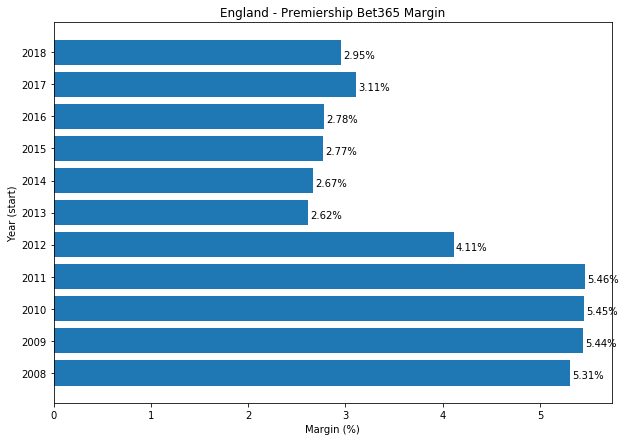

Margin for France - Championnat2008 is 0.06577310996448359
Margin for France - Championnat2009 is 0.06488025697451567
Margin for France - Championnat2010 is 0.06510789539928007
Margin for France - Championnat2011 is 0.06431904146042931
Margin for France - Championnat2012 is 0.06419203074142833
Margin for France - Championnat2013 is 0.06474715446538828
Margin for France - Championnat2014 is 0.05582978916378627
Margin for France - Championnat2015 is 0.051501172103991646
Margin for France - Championnat2016 is 0.05143072260302257
Margin for France - Championnat2017 is 0.05168975560651557
Margin for France - Championnat2018 is 0.05195406702138705
Margin for France - Championnat is 0.059222301296842104


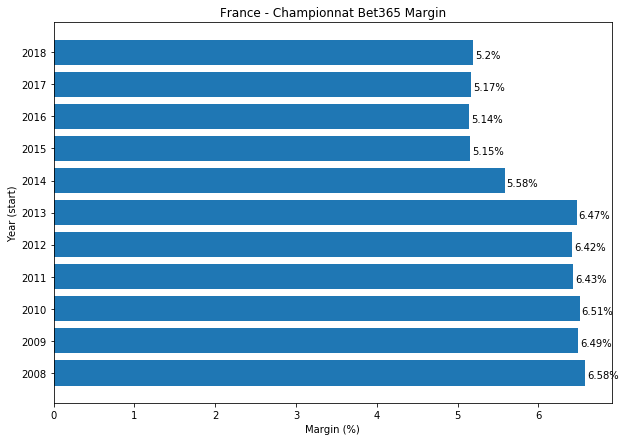

Margin for Germany - Bundesliga2008 is 0.06504961616721201
Margin for Germany - Bundesliga2009 is 0.06444209465214824
Margin for Germany - Bundesliga2010 is 0.0647859734549111
Margin for Germany - Bundesliga2011 is 0.06390434474480262
Margin for Germany - Bundesliga2012 is 0.06375172501705119
Margin for Germany - Bundesliga2013 is 0.06393851970141899
Margin for Germany - Bundesliga2014 is 0.05540355426761078
Margin for Germany - Bundesliga2015 is 0.05128824375918439
Margin for Germany - Bundesliga2016 is 0.050039105242136166
Margin for Germany - Bundesliga2017 is 0.05183992159395026
Margin for Germany - Bundesliga2018 is 0.05183992159395026
Margin for Germany - Bundesliga is 0.05875300183585256


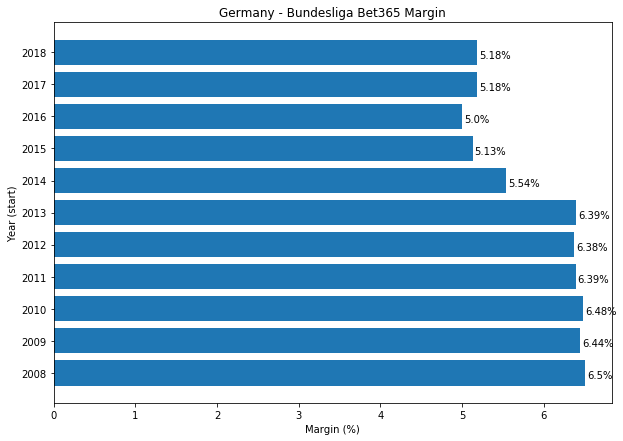

Margin for Italy - Serie A2008 is 0.06447751497902537
Margin for Italy - Serie A2009 is 0.06473166062521318
Margin for Italy - Serie A2010 is 0.0668698237604801
Margin for Italy - Serie A2011 is 0.06465552638192015
Margin for Italy - Serie A2012 is 0.06444090622726092
Margin for Italy - Serie A2013 is 0.06449774484775064
Margin for Italy - Serie A2014 is 0.055381366545412265
Margin for Italy - Serie A2015 is 0.05125866014034881
Margin for Italy - Serie A2016 is 0.05082428464523618
Margin for Italy - Serie A2017 is 0.052163321070884644
Margin for Italy - Serie A2018 is 0.052577164870582484
Margin for Italy - Serie A is 0.05925668155317649


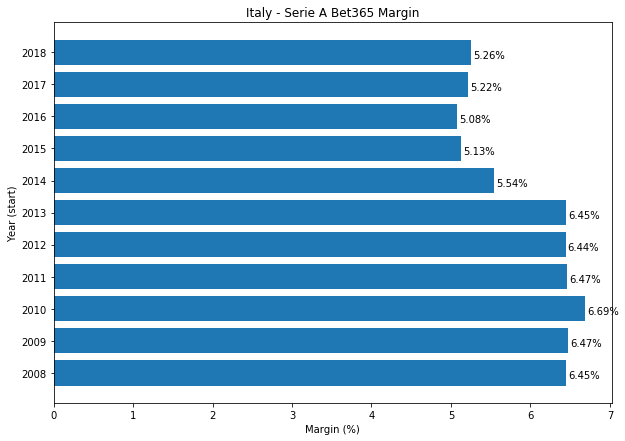

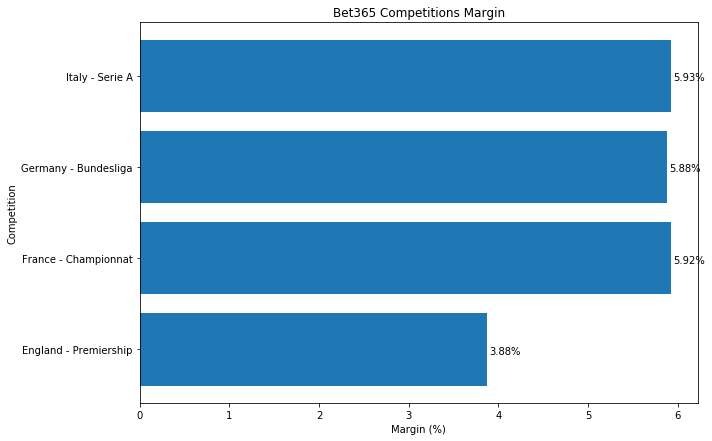

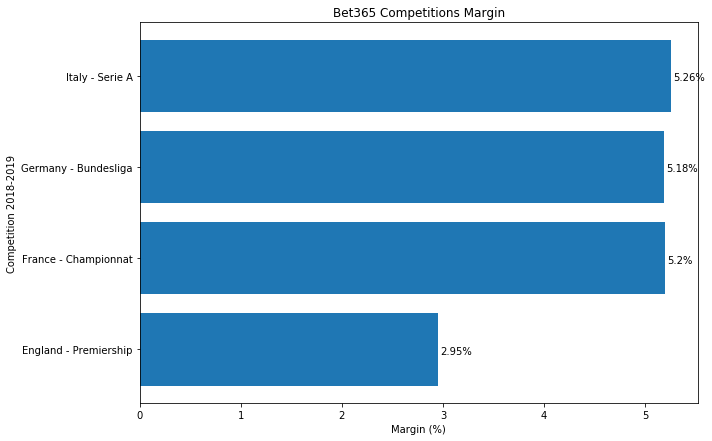

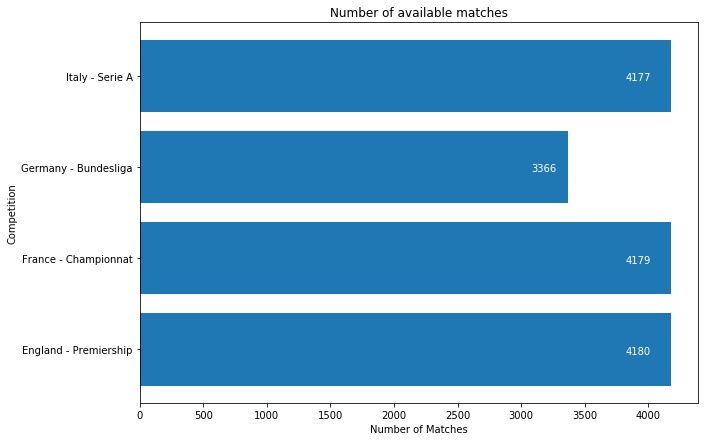

In [4]:
# Calculate Bet365 margin for every yeear
avg_competition_margin = {}
avg_2018_margin = {}
competition_matches = {}
for competition in competitions:
    competition_games = 0
    avg_competition_year_margin = {}
    for year in years:
        competition_year_games = 0
        competition_year = competition + str(year)
        for index, match in football_data[competition][year].iterrows():
            try:
                if math.isnan(match['B365H']) or math.isnan(match['B365D']) or math.isnan(match['B365A']):
                    continue
            except TypeError:
                continue
                
            if competition not in avg_competition_margin:
                avg_competition_margin[competition] = 0
            if competition_year not in avg_competition_year_margin:
                avg_competition_year_margin[competition_year] = 0
            if competition not in competition_matches:
                competition_matches[competition] = 0
                
            margin = (1/match['B365H'] + 1/match['B365D'] + 1/match['B365A']) - 1
            
            avg_competition_margin[competition] += margin
            avg_competition_year_margin[competition_year] += margin
            competition_matches[competition] += 1
            
            competition_games += 1
            competition_year_games += 1
        
        avg_competition_year_margin[competition_year] /= competition_year_games
        if year == 2018:
            avg_2018_margin[competition] = avg_competition_year_margin[competition_year]
        print("Margin for %s is %s" % (competition_year, avg_competition_year_margin[competition_year]))
        
    avg_competition_margin[competition] /= competition_games
    print("Margin for %s is %s" % (competition, avg_competition_margin[competition]))
    
    y = list(avg_competition_year_margin.values())
    y = [x*100 for x in y]
    fig, ax = plt.subplots(figsize=(10,7))
    plt.barh(years, y, align="center")
    for x, margin in zip(years, y):
        ax.text(margin + 0.025, x - 0.175, str(round(margin, 2)) + "%", color='black')
    ax.set_ylabel("Year (start)")
    ax.set_xlabel("Margin (%)")
    ax.set_yticks(years)
    ax.set_title(competition + " Bet365 Margin")
    plt.show()
    
# Plot average margins for competitions
y = list(avg_competition_margin.values())
y = [x*100 for x in y]
fig, ax = plt.subplots(figsize=(10,7))
plt.barh(range(len(competitions)), y, align="center")
for x, margin in zip(range(len(competitions)), y):
    ax.text(margin + 0.025, x - 0.05, str(round(margin, 2)) + "%", color='black')
ax.set_yticks(range(len(competitions)))
ax.set_yticklabels(competitions)
ax.set_ylabel("Competition")
ax.set_xlabel("Margin (%)")
ax.set_title("Bet365 Competitions Margin")
plt.show()

# Plot margins for 2018 competitions
y = list(avg_2018_margin.values())
y = [x*100 for x in y]
fig, ax = plt.subplots(figsize=(10,7))
plt.barh(range(len(competitions)), y, align="center")
for x, margin in zip(range(len(competitions)), y):
    ax.text(margin + 0.025, x - 0.05, str(round(margin, 2)) + "%", color='black')
ax.set_yticks(range(len(competitions)))
ax.set_yticklabels(competitions)
ax.set_ylabel("Competition 2018-2019")
ax.set_xlabel("Margin (%)")
ax.set_title("Bet365 Competitions Margin")
plt.show()

# Plot number of matches for all competitions
y = list(competition_matches.values())
fig, ax = plt.subplots(figsize=(10,7))
plt.barh(range(len(competitions)), y, align="center")
for x, matches in zip(range(len(competitions)), y):
    ax.text(matches - matches * 0.085, x - 0.05, str(matches), color='white')
ax.set_yticks(range(len(competitions)))
ax.set_yticklabels(competitions)
ax.set_ylabel("Competition")
ax.set_xlabel("Number of Matches")
ax.set_title("Number of available matches")
plt.show()

### Elo

Basic Elo Setup
Elo Class Min Games 10 | K Score <function <lambda> at 0x00000247F8769C18> | Draw Gap 0 | Home Advantage 0
Elo Class Min Games 10 | K Score <function <lambda> at 0x00000247F8769C18> | Draw Gap 0 | Home Advantage 0
Elo Class Min Games 10 | K Score <function <lambda> at 0x00000247F8769C18> | Draw Gap 0 | Home Advantage 0
Elo Class Min Games 10 | K Score <function <lambda> at 0x00000247F8769C18> | Draw Gap 0 | Home Advantage 0


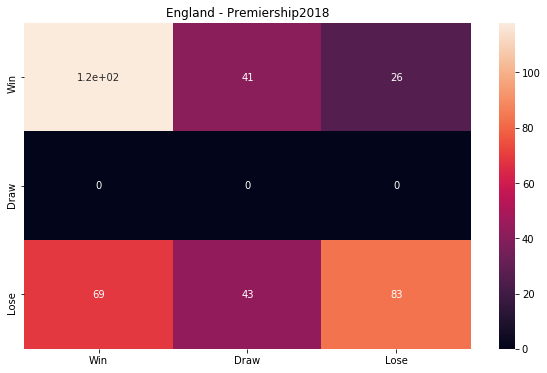

Accuracy: 52.89%
MAE: 0.52
RMSE: 0.61
Precision: 	Win 0.63 	Draw 0.00 	Lose 0.76 
Recall: 	Win 0.64 	Draw 0.00 	Lose 0.43 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.55 


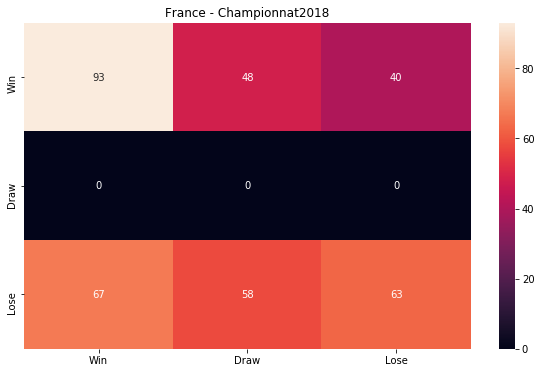

Accuracy: 42.28%
MAE: 0.60
RMSE: 0.67
Precision: 	Win 0.58 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.51 	Draw 0.00 	Lose 0.34 
F1: 	Win 0.55 	Draw 0.00 	Lose 0.43 


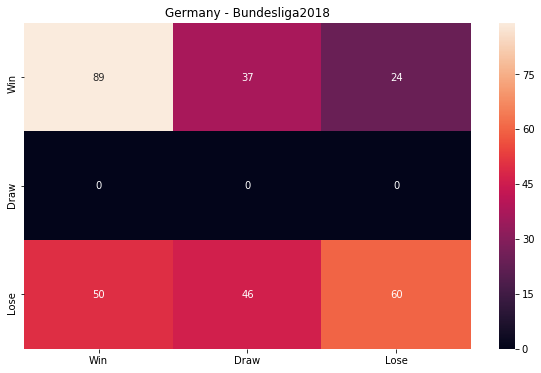

Accuracy: 48.69%
MAE: 0.59
RMSE: 0.65
Precision: 	Win 0.64 	Draw 0.00 	Lose 0.71 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.38 
F1: 	Win 0.62 	Draw 0.00 	Lose 0.50 


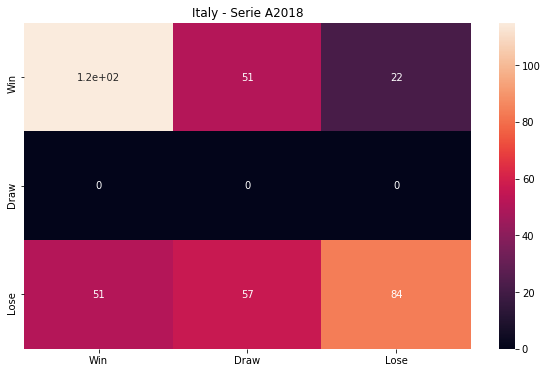

Accuracy: 52.37%
MAE: 0.56
RMSE: 0.65
Precision: 	Win 0.69 	Draw 0.00 	Lose 0.79 
Recall: 	Win 0.61 	Draw 0.00 	Lose 0.44 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.56 


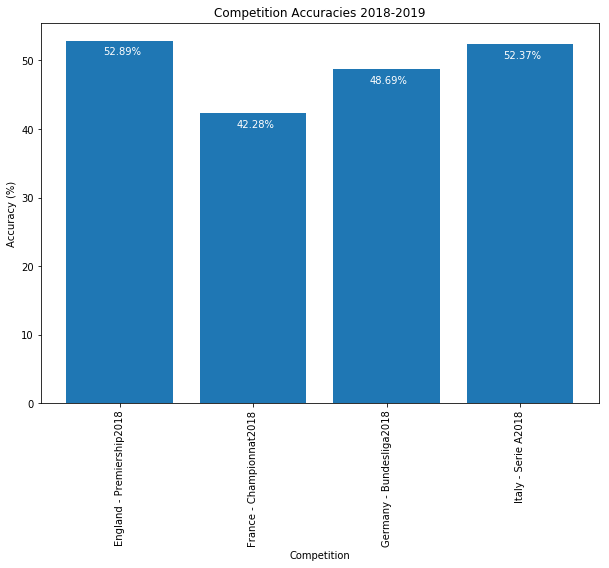

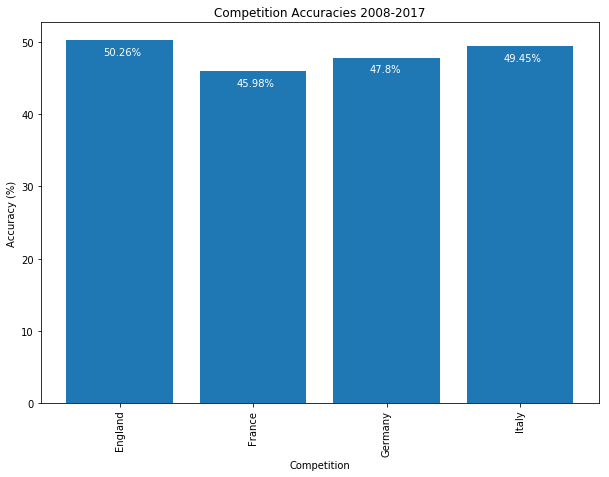

In [11]:
"""
Basic Elo Setup
"""
print("Basic Elo Setup")
comp_pred, bookie_comp_pred, \
    comp_year_pred, bookie_comp_year_pred = run_elo_training({"ALL": EloStats(min_games=10, 
                                                                              k_score=lambda x: 32, 
                                                                              draw_gap=0, 
                                                                              home_advantage=0)})
#get_accuracies(comp_pred, "Basic Elo", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Basic Elo", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022D72318> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AECA8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AED38> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AEDC8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AEE58> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AEEE8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211AEF78> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D0211C8048> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 

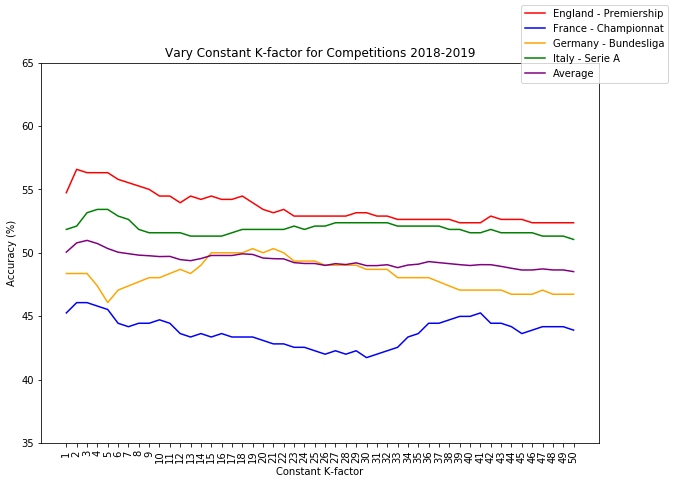

Max Average is 12 with value 48.81948009952589 (index 11)
Max England is 9 with value 50.75338429673794 (index 8)
Max France is 12 with value 46.77376912392906 (index 11)
Max Germany is 24 with value 48.15074689391567 (index 23)
Max Italy is 15 with value 49.95835572443699 (index 14)


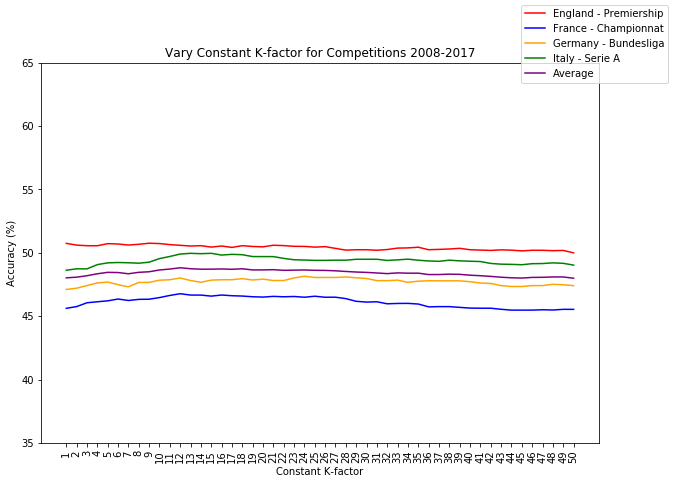

Max Average is 12 with value 48.89913662554733 (index 11)
Max England is 5 with value 51.2570548999487 (index 4)
Max France is 12 with value 46.58593146096367 (index 11)
Max Germany is 24 with value 48.208573256557905 (index 23)
Max Italy is 13 with value 50.153688524590166 (index 12)


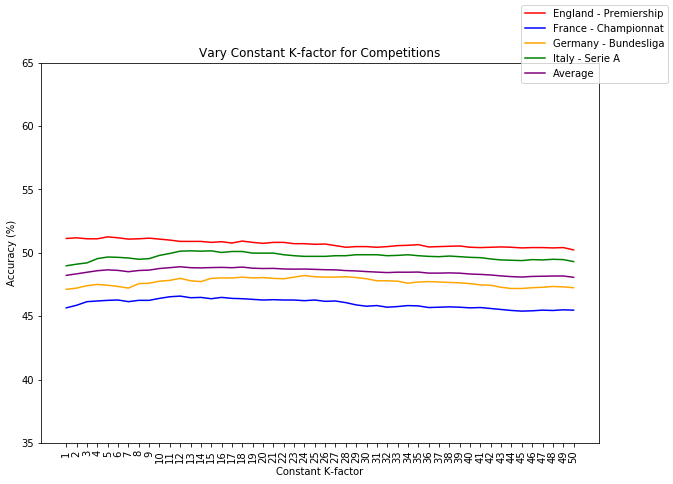

In [13]:
"""
Vary Constant K-factor
"""
k_factor_range = [lambda x: 1,
                 lambda x: 2,
                 lambda x: 3,
                 lambda x: 4,
                 lambda x: 5,
                 lambda x: 6,
                 lambda x: 7,
                 lambda x: 8,
                 lambda x: 9,
                 lambda x: 10,
                 lambda x: 11,
                 lambda x: 12,
                 lambda x: 13,
                 lambda x: 14,
                 lambda x: 15,
                 lambda x: 16,
                 lambda x: 17,
                 lambda x: 18,
                 lambda x: 19,
                 lambda x: 20,
                 lambda x: 21,
                 lambda x: 22,
                 lambda x: 23,
                 lambda x: 24,
                 lambda x: 25,
                 lambda x: 26,
                 lambda x: 27,
                 lambda x: 28,
                 lambda x: 29,
                 lambda x: 30,
                 lambda x: 31,
                 lambda x: 32,
                 lambda x: 33,
                 lambda x: 34,
                 lambda x: 35,
                 lambda x: 36,
                 lambda x: 37,
                 lambda x: 38,
                 lambda x: 39,
                 lambda x: 40,
                 lambda x: 41,
                 lambda x: 42,
                 lambda x: 43,
                 lambda x: 44,
                 lambda x: 45,
                 lambda x: 46,
                 lambda x: 47,
                 lambda x: 48,
                 lambda x: 49,
                 lambda x: 50]
k_factor_labels = [x * 1 for x in range(1, 51)]
elo_stats = [{"ALL": EloStats(min_games=10, 
                              k_score=k_score_factor, 
                              draw_gap=0, 
                              home_advantage=0)} for k_score_factor in k_factor_range]
accuracies = get_competition_accuracies(elo_stats, 
                                        k_factor_labels, 
                                        x_label="Constant K-factor", 
                                        title="Vary Constant K-factor for Competitions")

Best Constant K-Factor


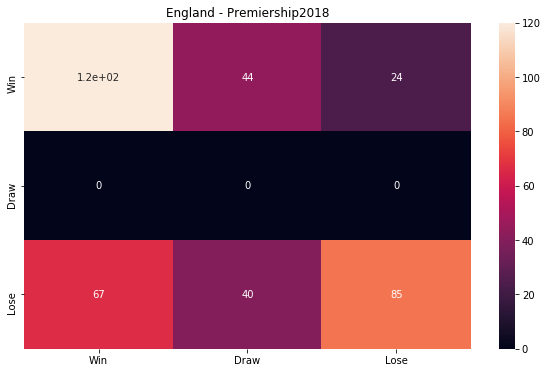

Accuracy: 53.95%
MAE: 0.35
RMSE: 0.37
Precision: 	Win 0.64 	Draw 0.00 	Lose 0.78 
Recall: 	Win 0.64 	Draw 0.00 	Lose 0.44 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.56 


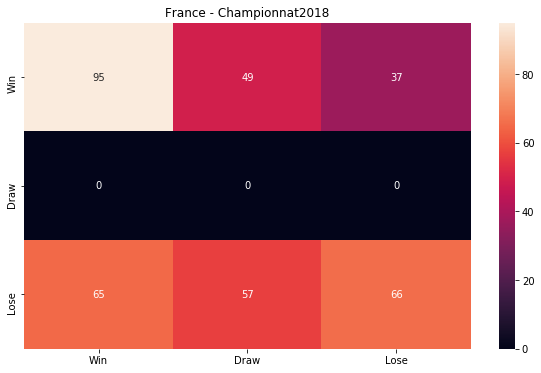

Accuracy: 43.63%
MAE: 0.38
RMSE: 0.39
Precision: 	Win 0.59 	Draw 0.00 	Lose 0.64 
Recall: 	Win 0.52 	Draw 0.00 	Lose 0.35 
F1: 	Win 0.56 	Draw 0.00 	Lose 0.45 


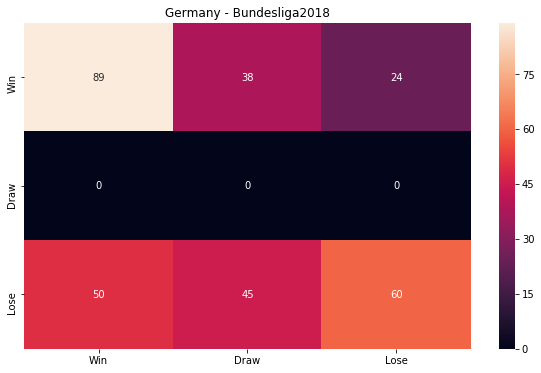

Accuracy: 48.69%
MAE: 0.38
RMSE: 0.39
Precision: 	Win 0.64 	Draw 0.00 	Lose 0.71 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.39 
F1: 	Win 0.61 	Draw 0.00 	Lose 0.50 


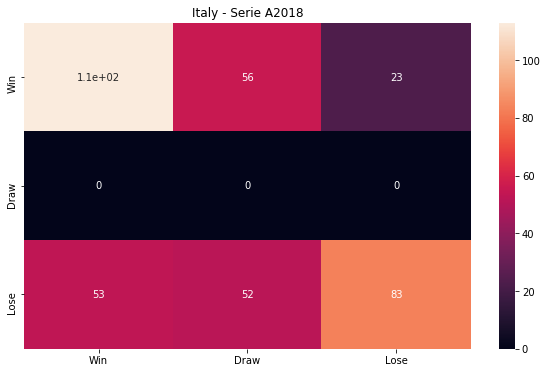

Accuracy: 51.58%
MAE: 0.34
RMSE: 0.36
Precision: 	Win 0.68 	Draw 0.00 	Lose 0.78 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.44 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.56 


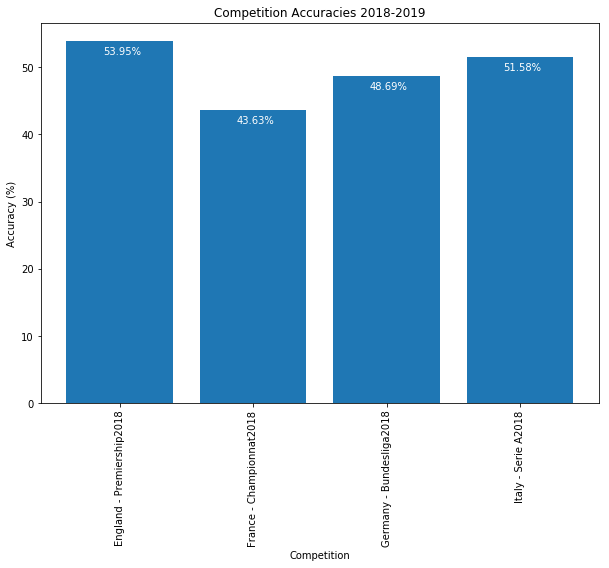

In [14]:
"""
Best Constant K-Factor
"""
print("Best Constant K-Factor")
comp_pred, \
bookie_comp_pred, \
comp_year_pred, \
bookie_comp_year_pred = run_elo_training({"ALL": EloStats(k_score=lambda x: 12, 
                                                          draw_gap=0, 
                                                          home_advantage=0)})
#get_accuracies(comp_pred, "Constant K-Factor", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Constant K-Factor", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022D72C18> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022CC9288> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022CC91F8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022CC9048> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022879E58> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022879D38> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022879C18> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000001D022879AF8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 

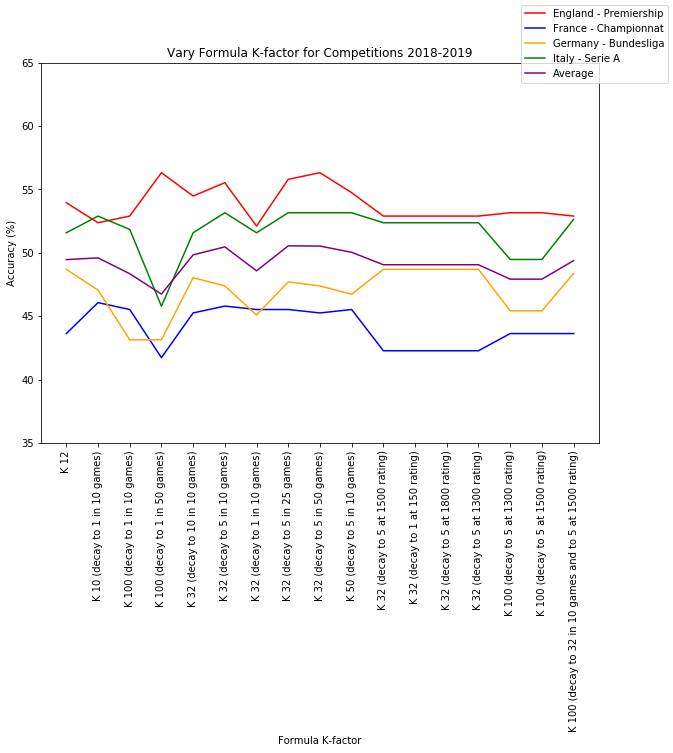

Max Average is K 12 with value 48.81948009952589 (index 0)
Max England is K 32 (decay to 5 in 50 games) with value 50.7810999572517 (index 8)
Max France is K 12 with value 46.77376912392906 (index 0)
Max Germany is K 12 with value 48.01357518067522 (index 0)
Max Italy is K 12 with value 49.902124467502624 (index 0)


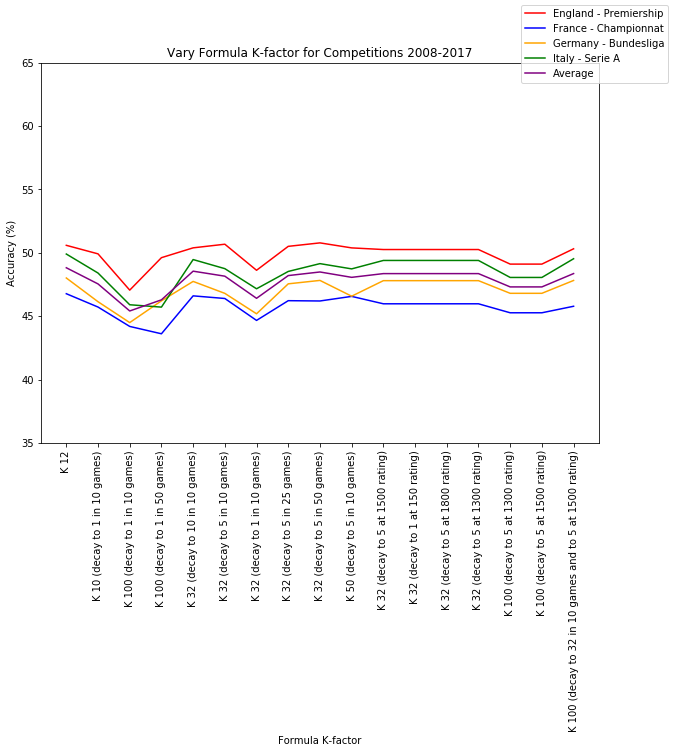

Max Average is K 12 with value 48.89913662554733 (index 0)
Max England is K 32 (decay to 5 in 50 games) with value 51.308363263211895 (index 8)
Max France is K 12 with value 46.58593146096367 (index 0)
Max Germany is K 12 with value 47.98464491362764 (index 0)
Max Italy is K 12 with value 50.128073770491795 (index 0)


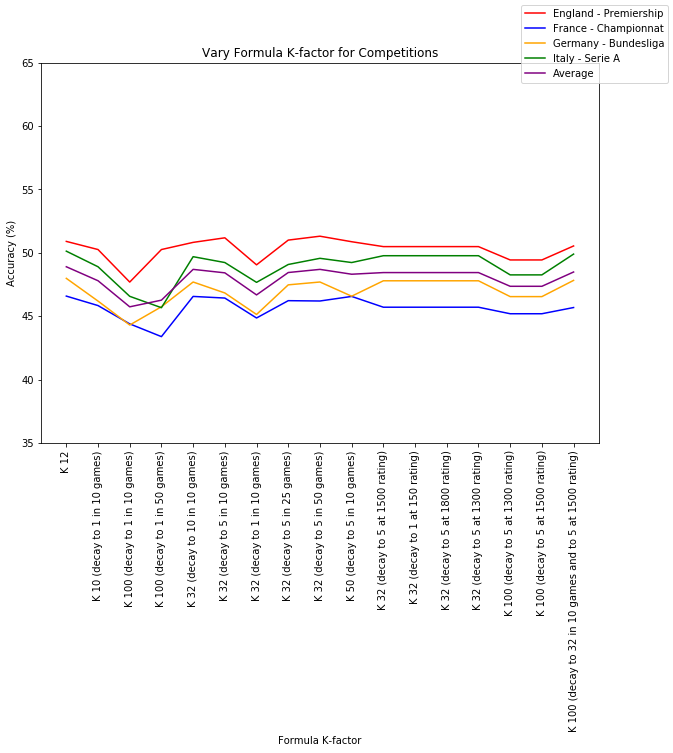

(([50.89789635710621,
   50.25654181631606,
   47.691123653155465,
   50.25654181631606,
   50.820933812211386,
   51.18009235505387,
   49.050795279630584,
   51.00051308363264,
   51.308363263211895,
   50.872242175474604,
   50.48742945100051,
   50.48742945100051,
   50.48742945100051,
   50.48742945100051,
   49.43560800410467,
   49.43560800410467,
   50.538737814263726],
  [46.58593146096367,
   45.838701365627415,
   44.3957742849781,
   43.390878639525894,
   46.56016490595207,
   46.4313321308941,
   44.85957227518681,
   46.22519969080134,
   46.19943313578975,
   46.56016490595207,
   45.70986859056944,
   45.70986859056944,
   45.70986859056944,
   45.70986859056944,
   45.194537490337545,
   45.194537490337545,
   45.68410203555784],
  [47.98464491362764,
   46.19321817018554,
   44.305822136916184,
   45.74536148432502,
   47.69673704414588,
   46.83301343570058,
   45.13755598208573,
   47.47280870121561,
   47.69673704414588,
   46.57709532949456,
   47.79270633397313,

In [15]:
"""
Vary K-factor by formula
"""

england_predictions = []
france_predictions = []
germany_predictions = []
italy_predictions = []
bookie_predictions = []

k_factor_range = [lambda x: 12, 
                  lambda x: 10 - 9 * min(10, x.games_played) / 10, 
                  lambda x: 100 - 99 * min(10, x.games_played) / 10,  
                  lambda x: 100 - 99 * min(50, x.games_played) / 50,
                  lambda x: 32 - 22 * min(10, x.games_played) / 10,
                  lambda x: 32 - 27 * min(10, x.games_played) / 10,
                  lambda x: 32 - 31 * min(10, x.games_played) / 10,
                  lambda x: 32 - 27 * min(25, x.games_played) / 25,
                  lambda x: 32 - 27 * min(50, x.games_played) / 50,
                  lambda x: 50 - 45 * min(10, x.games_played) / 10,
                  lambda x: 32 - min(0, 27 - (x.rating - 1200) / 300),
                  lambda x: 32 - min(0, 31 - (x.rating - 1200) / 300),
                  lambda x: 32 - min(0, 27 - (x.rating - 1200) / 500),
                  lambda x: 32 - min(0, 27 - (x.rating - 1200) / 100),
                  lambda x: 100 - min(0, 95 - (x.rating - 1200) / 100),
                  lambda x: 100 - min(0, 95 - (x.rating - 1200) / 300),
                  lambda x: 100 - 68 * min(10, x.games_played) / 10 - min(0, 27 - (x.rating - 1200) / 300)]
k_factor_labels = ["K 12", 
                   "K 10 (decay to 1 in 10 games)", 
                   "K 100 (decay to 1 in 10 games)", 
                   "K 100 (decay to 1 in 50 games)",
                   "K 32 (decay to 10 in 10 games)", 
                   "K 32 (decay to 5 in 10 games)", 
                   "K 32 (decay to 1 in 10 games)", 
                   "K 32 (decay to 5 in 25 games)", 
                   "K 32 (decay to 5 in 50 games)", 
                   "K 50 (decay to 5 in 10 games)", 
                   "K 32 (decay to 5 at 1500 rating)", 
                   "K 32 (decay to 1 at 150 rating)",
                   "K 32 (decay to 5 at 1800 rating)", 
                   "K 32 (decay to 5 at 1300 rating)", 
                   "K 100 (decay to 5 at 1300 rating)",
                   "K 100 (decay to 5 at 1500 rating)", 
                   "K 100 (decay to 32 in 10 games and to 5 at 1500 rating)"]
elo_stats = [{"ALL": EloStats(k_score=k_score_factor, 
                              draw_gap=0)} for k_score_factor in k_factor_range]
get_competition_accuracies(elo_stats, 
                           k_factor_labels, 
                           x_label="Formula K-factor", 
                           title="Vary Formula K-factor for Competitions")

Best Formula K-Factor


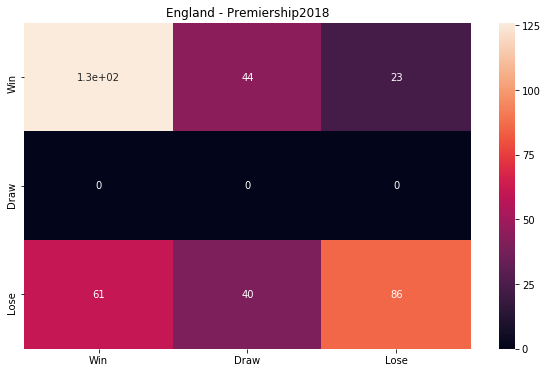

Accuracy: 55.79%
MAE: 0.37
RMSE: 0.39
Precision: 	Win 0.65 	Draw 0.00 	Lose 0.46 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.79 
F1: 	Win 0.66 	Draw 0.00 	Lose 0.58 


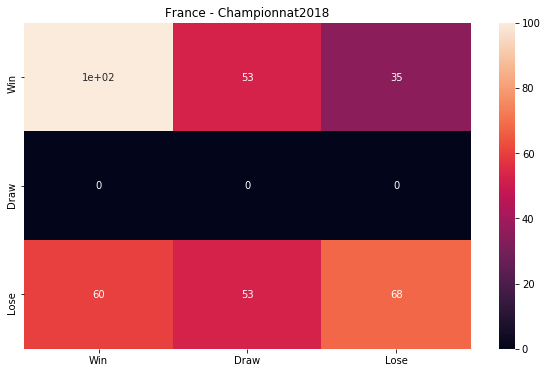

Accuracy: 45.53%
MAE: 0.40
RMSE: 0.41
Precision: 	Win 0.53 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.62 	Draw 0.00 	Lose 0.66 
F1: 	Win 0.57 	Draw 0.00 	Lose 0.48 


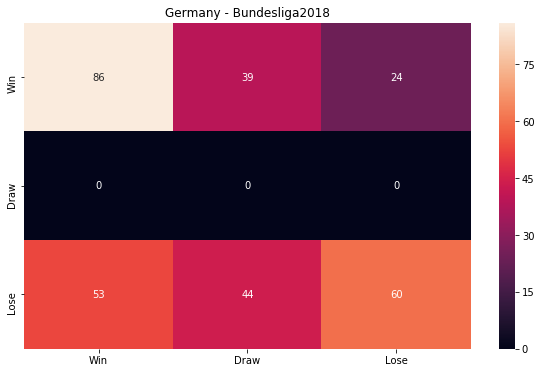

Accuracy: 47.71%
MAE: 0.40
RMSE: 0.41
Precision: 	Win 0.58 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.62 	Draw 0.00 	Lose 0.71 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.50 


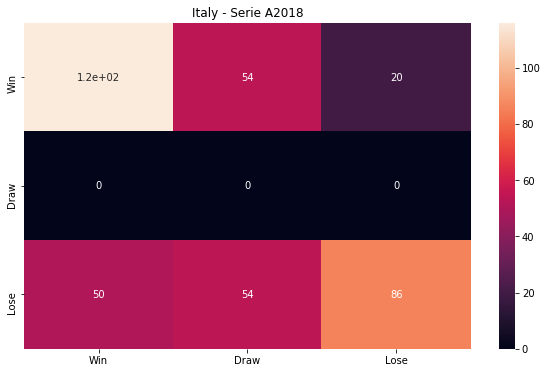

Accuracy: 53.16%
MAE: 0.37
RMSE: 0.38
Precision: 	Win 0.61 	Draw 0.00 	Lose 0.45 
Recall: 	Win 0.70 	Draw 0.00 	Lose 0.81 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.58 


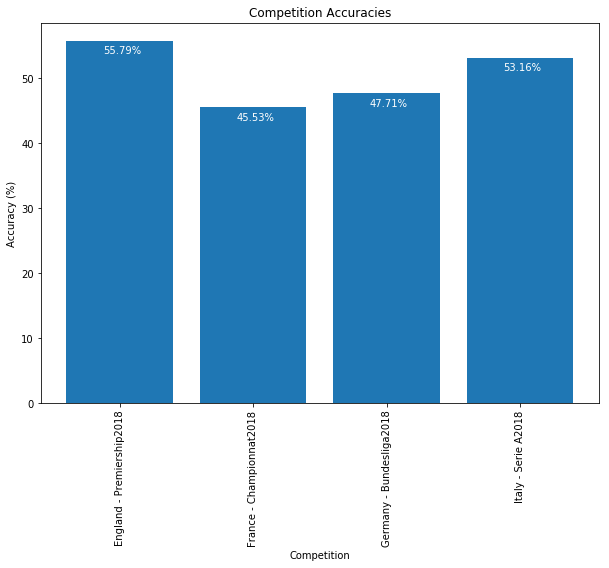

In [23]:
"""
Best Formula K-Factor
"""
print("Best Formula K-Factor")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_elo_training(EloStats(min_games=10, 
                                                                                               k_score=lambda x: 32 - 27 * min(25, x.games_played) / 25, 
                                                                                               draw_gap=0, 
                                                                                               home_advantage=0))
#get_accuracies(comp_pred, "Formula K-Factor Elo", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Formula K-Factor Elo", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F4288> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F4318> | Draw Gap 0.0001 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F43A8> | Draw Gap 0.00025 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F4438> | Draw Gap 0.0005 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F44C8> | Draw Gap 0.001 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F4558> | Draw Gap 0.0025 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x00000268645F45E8> | Draw Gap 0.005 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 

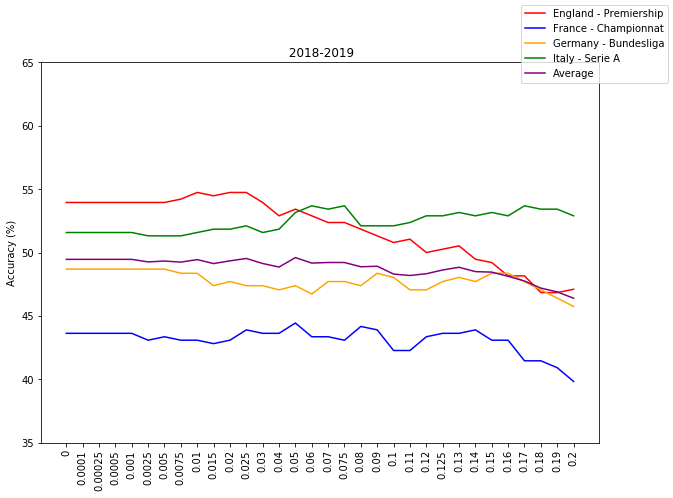

Max Average is 0 with value 48.81265374799803 (index 0)
Max England is 0 with value 50.58845162599664 (index 0)
Max France is 0 with value 46.747453334455365 (index 0)
Max Germany is 0 with value 48.01357518067522 (index 0)
Max Italy is 0 with value 49.901134850864885 (index 0)


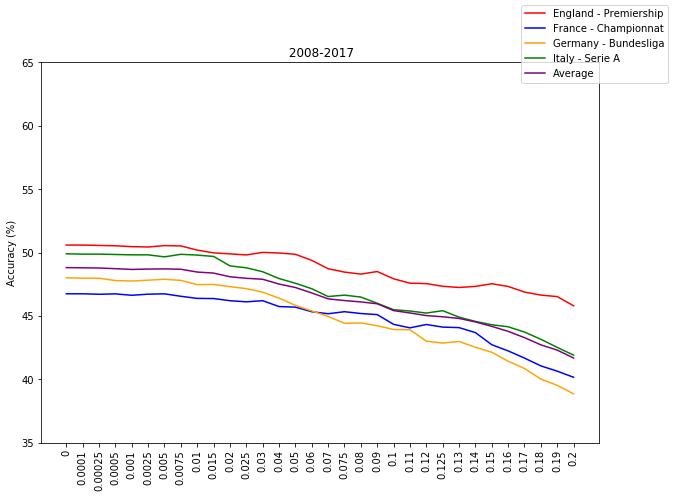

Max Average is 0 with value 48.89269498679443 (index 0)
Max England is 0 with value 50.89789635710621 (index 0)
Max France is 0 with value 46.56016490595207 (index 0)
Max Germany is 0 with value 47.98464491362764 (index 0)
Max Italy is 0 with value 50.128073770491795 (index 0)


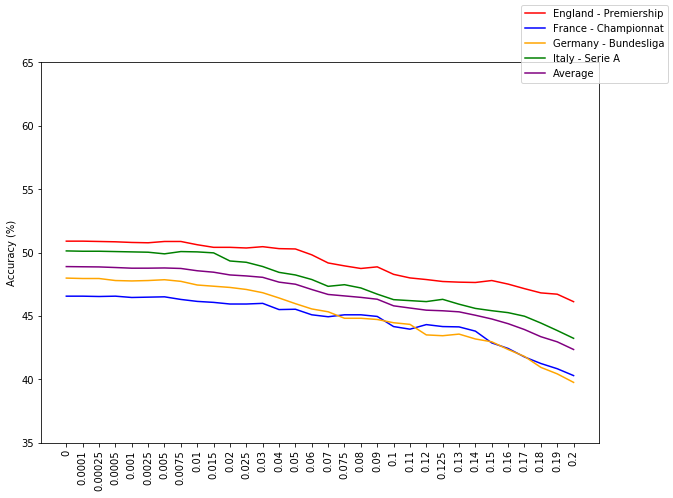

(([50.89789635710621,
   50.89789635710621,
   50.872242175474604,
   50.846587993842995,
   50.795279630579785,
   50.769625448948176,
   50.872242175474604,
   50.872242175474604,
   50.615700359158545,
   50.4104669061057,
   50.4104669061057,
   50.359158542842486,
   50.4617752693689,
   50.30785017957927,
   50.28219599794767,
   49.82042072857876,
   49.179066187788614,
   48.94817855310416,
   48.74294510005131,
   48.87121600820934,
   48.2811698306824,
   47.998973832734734,
   47.870702924576705,
   47.716777834787074,
   47.665469471523856,
   47.639815289892255,
   47.793740379681886,
   47.511544381734225,
   47.15238583889174,
   46.81888147768086,
   46.71626475115444,
   46.126218573627504],
  [46.56016490595207,
   46.56016490595207,
   46.53439835094048,
   46.56016490595207,
   46.4570986859057,
   46.482865240917285,
   46.508631795928885,
   46.302499355836126,
   46.14790002576655,
   46.070600360731774,
   45.941767585673794,
   45.941767585673794,
   45.9933006

In [4]:
"""
Vary Constant Draw Gap
"""

draw_gap_range = [0, 
                  0.0001,
                  0.00025,
                  0.0005,
                  0.001,
                  0.0025, 
                  0.005, 
                  0.0075, 
                  0.01, 
                  0.015, 
                  0.02, 
                  0.025, 
                  0.03, 
                  0.04, 
                  0.05, 
                  0.06, 
                  0.07, 
                  0.075, 
                  0.08, 
                  0.09, 
                  0.1, 
                  0.11, 
                  0.12, 
                  0.125, 
                  0.13, 
                  0.14, 
                  0.15, 
                  0.16, 
                  0.17, 
                  0.18, 
                  0.19, 
                  0.2]
elo_stats = [{"ALL": EloStats(min_games=10, 
                              k_score=lambda x: 12, 
                              draw_gap=draw_gap,
                              home_advantage = 0)} for draw_gap in draw_gap_range]
get_competition_accuracies(elo_stats, draw_gap_range)

In [ ]:
"""
Vary Constant K-factor and Draw Gap
"""
k_factor_range = [lambda x: 1,
                 lambda x: 2,
                 lambda x: 3,
                 lambda x: 4,
                 lambda x: 5,
                 lambda x: 6,
                 lambda x: 7,
                 lambda x: 8,
                 lambda x: 9,
                 lambda x: 10,
                 lambda x: 11,
                 lambda x: 12,
                 lambda x: 13,
                 lambda x: 14,
                 lambda x: 15,
                 lambda x: 16,
                 lambda x: 17,
                 lambda x: 18,
                 lambda x: 19,
                 lambda x: 20]
draw_gap_range = [0, 
                  0.0025, 
                  0.005, 
                  0.0075, 
                  0.01, 
                  0.015, 
                  0.02, 
                  0.025, 
                  0.03, 
                  0.04, 
                  0.05, 
                  0.06, 
                  0.07, 
                  0.075, 
                  0.08, 
                  0.09, 
                  0.1, 
                  0.11, 
                  0.12, 
                  0.125, 
                  0.13, 
                  0.14, 
                  0.15, 
                  0.16, 
                  0.17, 
                  0.18, 
                  0.19, 
                  0.2]
k_factor_labels = [x * 1 for x in range(1, 21)]
elo_stats = []
for draw_gap in draw_gap_range:
    for k_factor in k_factor_range:
        elo_stats.append({"ALL": EloStats(min_games=10, 
                                          k_score=k_factor, 
                                          draw_gap=draw_gap,
                                          home_advantage=0)})
accuracies = get_competition_accuracies(elo_stats, range(len(elo_stats)))
plot_stats(k_factor_labels, 
           draw_gap_range, 
           accuracies[0], 
           x_label="K Factor", 
           y_label="Draw Gap", 
           title="Elo Grid Search: K Factor vs. Draw Gap", 
           x_ticks=k_factor_range,
           y_ticks=k_factor_labels)
plot_stats(k_factor_labels, 
           draw_gap_range, 
           accuracies[1], 
           x_label="K Factor", 
           y_label="Draw Gap", 
           title="Elo Grid Search Test Set: K Factor vs. Draw Gap",
           x_ticks=k_factor_range,
           y_ticks=k_factor_labels)
plot_stats(k_factor_labels, 
           draw_gap_range, 
           accuracies[2],
           x_label="K Factor", 
           y_label="Draw Gap", 
           title="Elo Grid Search Train Set: K Factor vs. Draw Gap",
           x_ticks=k_factor_range,
           y_ticks=k_factor_labels)

In [52]:
"""
Vary Constant K-factor and Home Advantage
"""
k_factor_range = [lambda x: 1, 
                  lambda x: 2, 
                  lambda x: 3, 
                  lambda x: 4,
                  lambda x: 5, 
                  lambda x: 6, 
                  lambda x: 7, 
                  lambda x: 10, 
                  lambda x: 12, 
                  lambda x: 15,
                  lambda x: 17,
                  lambda x: 18,
                  lambda x: 20,
                  lambda x: 22, 
                  lambda x: 24,
                  lambda x: 25, 
                  lambda x: 27,
                  lambda x: 30]
home_advantages = [0,
                   0.01,
                   0.025,
                   0.05, 
                   0.06, 
                   0.07, 
                   0.075, 
                   0.08, 
                   0.09, 
                   0.1, 
                   0.11, 
                   0.12,  
                   0.13, 
                   0.14, 
                   0.15,
                   0.175,
                   0.2]
k_factor_labels = ["1",
                   "2",
                   "3",
                   "4",
                   "5",
                   "6",
                   "7",
                   "10",
                   "12",
                   "15",
                   "17",
                   "18",
                   "20",
                   "22",
                   "24",
                   "25",
                   "27",
                   "30"]
elo_stats = []
for home_advantage in home_advantages:
    for k_factor in k_factor_range:
        elo_stats.append({"ALL": EloStats(min_games=10, 
                                          k_score=k_factor, 
                                          draw_gap=0,
                                          home_advantage=home_advantage)})
accuracies = get_competition_accuracies(elo_stats, range(len(elo_stats)))
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[0], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search: K Factor vs. Home Advantage", 
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[1], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search Test Set: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[2], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search Train Set: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)

plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[2][0], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search England Premiership 2008 - 2017: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[2][1], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search France Championnat 2008 - 2017: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[2][2], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search Germany Bundesliga 2008 - 2017: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)
plot_stats(k_factor_range, 
           home_advantages, 
           accuracies[2][3], 
           x_label="K Factor", 
           y_label="Home Advantage", 
           title="Elo Grid Search Italy Serie A 2008 - 2017: K Factor vs. Home Advantage",
           x_ticks=k_factor_labels,
           y_ticks=home_advantages)

Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x0000026864B2B318> | Draw Gap 0 | Home Advantage 0}
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B2B318> | Draw Gap 0 | Home Advantage 0
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B2B318> | Draw Gap 0 | Home Advantage 0
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B2B318> | Draw Gap 0 | Home Advantage 0


KeyboardInterrupt: 

In [ ]:
"""
Dynamically calculate Draw chance
"""

comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_elo_training(EloStats(min_games=10, 
                                                                                               k_score=lambda x: 3, 
                                                                                               draw_gap=0), 
                                                                                      update_draw=True)
#get_accuracies(comp_pred, "Dynamic Draw Chance", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Dynamic Draw Chance", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEF9DC8> | Draw Gap 0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEF9E58> | Draw Gap 0 | Home Advantage 0.01}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEF9EE8> | Draw Gap 0 | Home Advantage 0.015}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEF9F78> | Draw Gap 0 | Home Advantage 0.02}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEFD048> | Draw Gap 0 | Home Advantage 0.025}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEFD0D8> | Draw Gap 0 | Home Advantage 0.03}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x000001769AEFD168> | Draw Gap 0 | Home Advantage 0.04}
Elo Stats: {'ALL': Min Games 10 | K Score <function <listcomp>.<lambda> at 0x0000017

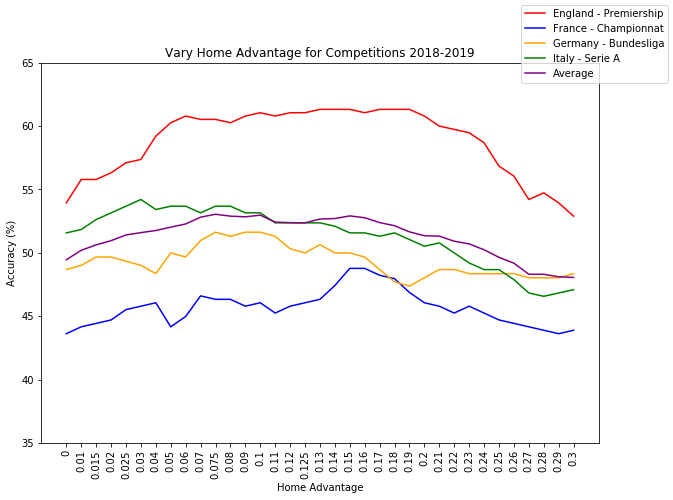

Max Average is 0.08 with value 51.29027299030377 (index 11)
Max England is 0.05 with value 53.19737273268612 (index 7)
Max France is 0.07 with value 49.878042752972604 (index 9)
Max Germany is 0.08 with value 50.10546738930395 (index 11)
Max Italy is 0.075 with value 52.57003639530508 (index 10)


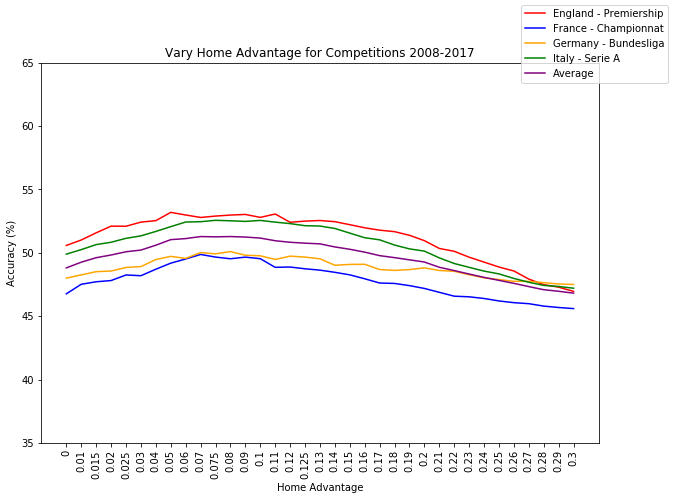

Max Average is 0.08 with value 51.50851913591154 (index 11)
Max England is 0.11 with value 53.848127244740894 (index 14)
Max France is 0.07 with value 49.703684617366655 (index 9)
Max Germany is 0.08 with value 50.25591810620601 (index 11)
Max Italy is 0.075 with value 52.76639344262295 (index 10)


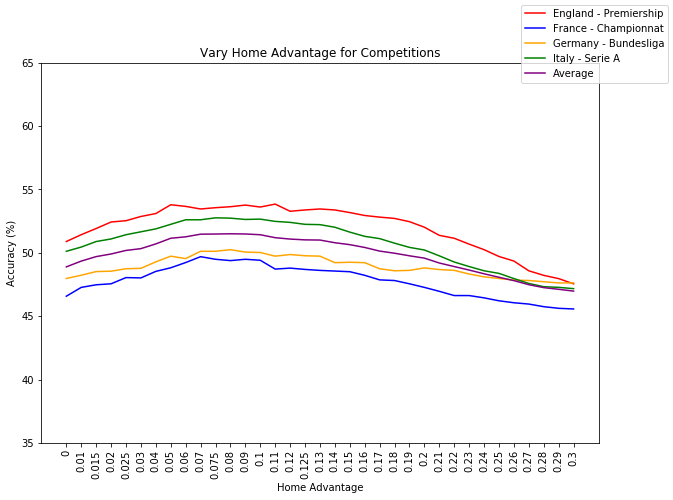

(([50.89789635710621,
   51.43663417136993,
   51.92406362237044,
   52.43714725500257,
   52.539763981528985,
   52.87326834273986,
   53.10415597742432,
   53.796818881477684,
   53.66854797331965,
   53.463314520266806,
   53.56593124679323,
   53.64289379168804,
   53.771164699846075,
   53.617239610056444,
   53.848127244740894,
   53.283735248845566,
   53.38635197537198,
   53.463314520266806,
   53.38635197537198,
   53.18111852231914,
   52.95023088763469,
   52.82195997947665,
   52.71934325295023,
   52.46280143663418,
   52.02668034889687,
   51.38532580810672,
   51.154438173422264,
   50.692662904053364,
   50.25654181631606,
   49.71780400205233,
   49.358645459209846,
   48.58902001026168,
   48.22986146741919,
   47.97331965110313,
   47.562852744997436],
  [46.58593146096367,
   47.281628446276734,
   47.48776088636949,
   47.56506055140427,
   48.054625096624584,
   48.02885854161298,
   48.54418964184489,
   48.827621746972426,
   49.239886627157944,
   49.703684617

In [4]:
"""
Vary Home Advantage for Elo
"""
home_advantages = [0, 0.01, 0.015, 0.02, 0.025, 0.03, 0.04, 0.05, 0.06, 0.07, 0.075, 0.08, 0.09, 0.1, 
                  0.11, 0.12, 0.125, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 
                  0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3]
elo_stats = [{"ALL": EloStats(min_games=10, 
                              k_score=lambda x: 12,
                              draw_gap=0,
                              home_advantage=home_advantage)} for home_advantage in home_advantages]
get_competition_accuracies(elo_stats, home_advantages, x_label="Home Advantage", title="Vary Home Advantage for Competitions")

Best Home Advantage


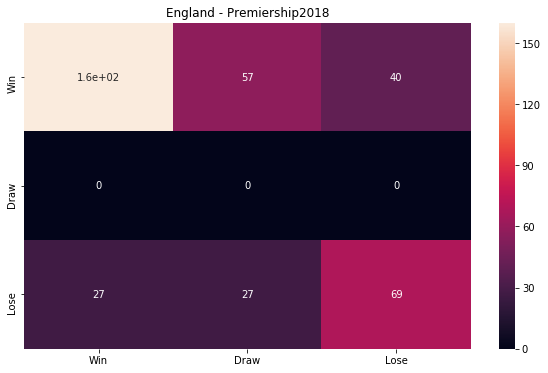

Accuracy: 60.26%
MAE: 0.33
RMSE: 0.35
Precision: 	Win 0.62 	Draw 0.00 	Lose 0.56 
Recall: 	Win 0.86 	Draw 0.00 	Lose 0.63 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.59 


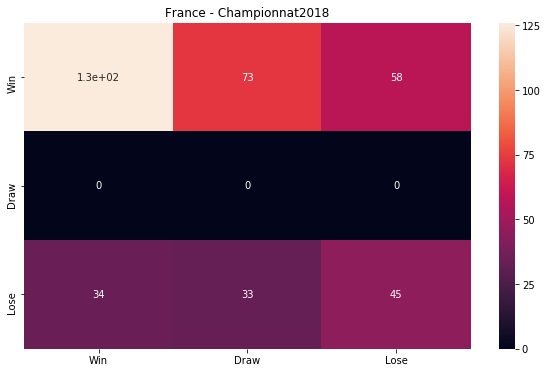

Accuracy: 46.34%
MAE: 0.36
RMSE: 0.38
Precision: 	Win 0.49 	Draw 0.00 	Lose 0.40 
Recall: 	Win 0.79 	Draw 0.00 	Lose 0.44 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.42 


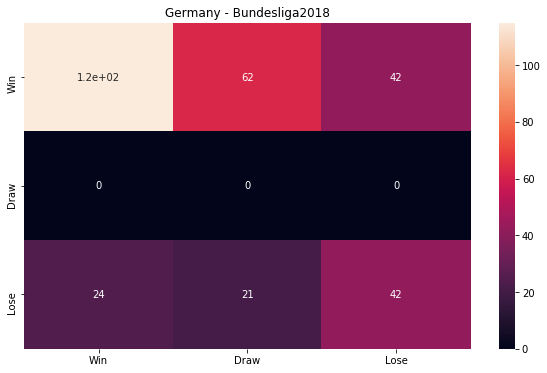

Accuracy: 51.31%
MAE: 0.36
RMSE: 0.38
Precision: 	Win 0.53 	Draw 0.00 	Lose 0.48 
Recall: 	Win 0.83 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.49 


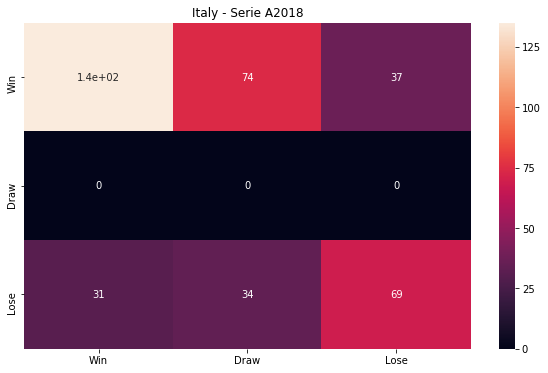

Accuracy: 53.68%
MAE: 0.33
RMSE: 0.35
Precision: 	Win 0.55 	Draw 0.00 	Lose 0.51 
Recall: 	Win 0.81 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.66 	Draw 0.00 	Lose 0.58 


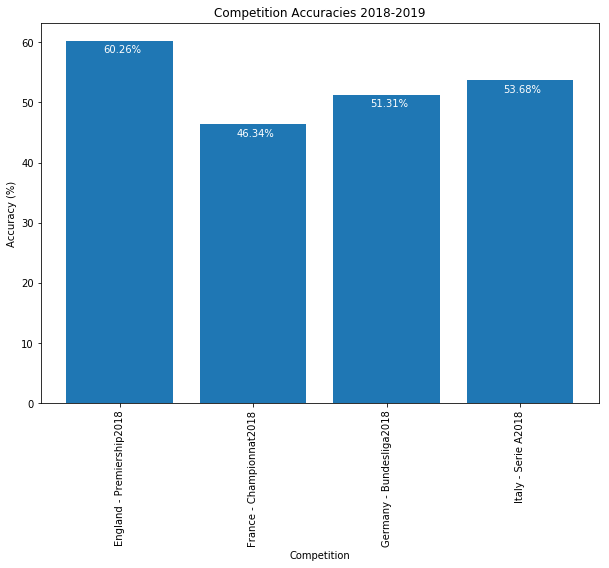

In [39]:
"""
Best Home Advantage
"""
print("Best Home Advantage")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_elo_training(EloStats(min_games=10, 
                                                                                               k_score=lambda x: 12, 
                                                                                               draw_gap=0, 
                                                                                               home_advantage=0.08))
#get_accuracies(comp_pred, "Home Advantage", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Home Advantage", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000002686452FF78> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000002686452FEE8> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x0000026863F90E58> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x0000026863F90EE8> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x0000026863F90F78> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000002686409F048> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000002686409F0D8> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x000002686409F168> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <funct

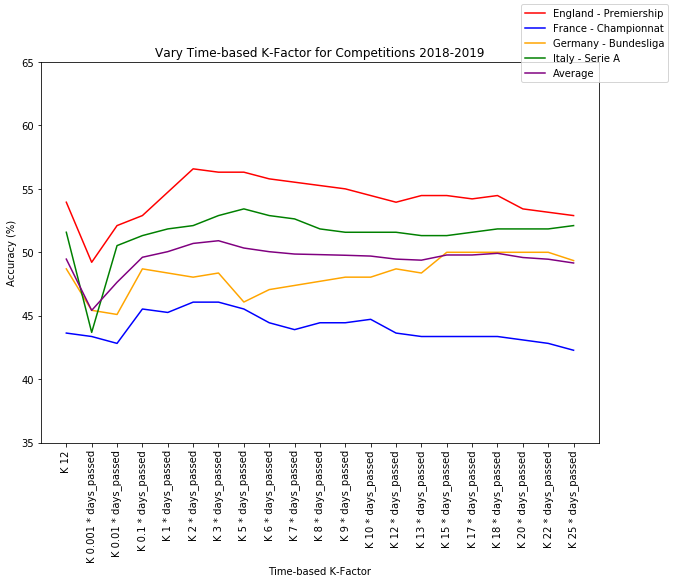

Max Average is K 12 with value 48.81265374799803 (index 0)
Max England is K 1 * days_passed with value 50.86406652742706 (index 4)
Max France is K 12 with value 46.747453334455365 (index 0)
Max Germany is K 25 * days_passed with value 48.052678525920236 (index 20)
Max Italy is K 15 * days_passed with value 49.95835572443699 (index 15)


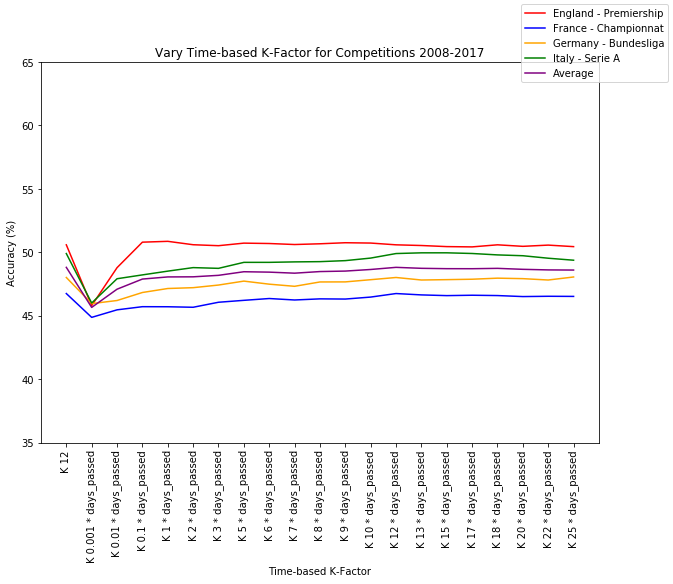

Max Average is K 12 with value 0.0 (index 0)
Max England is K 12 with value 0 (index 0)
Max France is K 12 with value 0 (index 0)
Max Germany is K 12 with value 0 (index 0)
Max Italy is K 12 with value 0 (index 0)


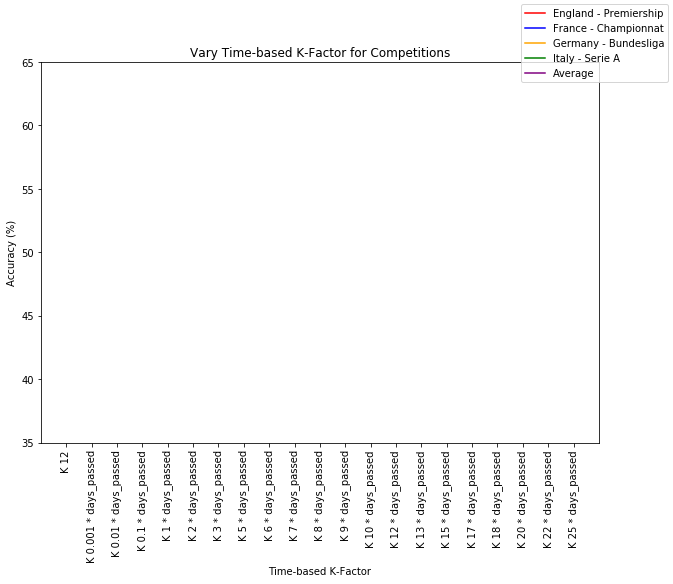

(([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 ([53.94736842105263,
   49.21052631578947,
   52.10526315789473,
   52.89473684210526,
   54.736842105263165,
   56.57894736842105,
   56.315789473684205,
   56.315789473684205,
   55.78947368421052,
   55.52631578947368,
   55.26315789473685,
   55.00000000000001,
   54.473684210526315,
   53.94736842105263,
   54.473684210526315,
   54.473684210526315,
   54.21052631578947,
   54.473684210526315,
   53.421052631578945,
   53.1578947368421,
   52.89473684210526],
  [43.63143631436314,
   43.360433604336045,
   42.81842818428184,
   45.52845528455284,
   45.25745257452575,
   46.070460704607044,
   46.070460704607044,
   45.52845528455284,
   44.44444444444444,
   43.90243902439025,
   44.44444444444444,
   44.4444444444

In [5]:
"""
Vary K-factor based on how much time has passed
"""
class EloWithDate(Elo):
    
    def play_match(team_a, team_b, result, match_date, update_draw=False):
        Elo.TOTAL_GAMES += 1
        if result[0] == result[1]:
            Elo.DRAWN_GAMES += 1
        Elo.DRAW_CHANCE = Elo.DRAWN_GAMES / Elo.TOTAL_GAMES / 2
        if update_draw:
            Elo.DRAW_GAP = Elo.DRAW_CHANCE
        
        team_a.games_played += 1
        team_b.games_played += 1
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
        outcome_a, outcome_b = Elo.get_outcome(result)
        
        upd_a_rating = team_a.rating + round(EloWithDate.__get_k_score(team_a, match_date) * (outcome_a - expected_a), 2)
        upd_b_rating = team_b.rating + round(EloWithDate.__get_k_score(team_b, match_date) * (outcome_b - expected_b), 2)
        
        team_a.last_game_date = match_date
        team_b.last_game_date = match_date
        
        return upd_a_rating, upd_b_rating
    
    def parse_predictions(expected_a, expected_b, draw=False):
        return expected_a + Elo.HOME_ADVANTAGE, 0, expected_b - Elo.HOME_ADVANTAGE
    
    def predict_match(team_a, team_b, predictors, score, odds, draw=False):
        if team_a.games_played > EloTeam.MIN_GAMES and team_b.games_played > EloTeam.MIN_GAMES:
            expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
            predictors[0].predict(Elo.parse_predictions(expected_a, expected_b, draw=draw), score, odds)
            predictors[1].predict(odds[::-1], score, odds)
            
    def __get_k_score(team, match_date):
        def convert_date(date):
            try:
                return datetime.strptime(date, "%d/%m/%y")
            except ValueError:
                return datetime.strptime(date, "%d/%m/%Y")
            
        try:
            day_diff = 1 if team.last_game_date is None else (convert_date(match_date) - convert_date(team.last_game_date)).days
        except TypeError:
            day_diff = 1
        
        if day_diff == 0:
            day_diff = 1
            
        return Elo.K_SCORE(day_diff)

    
k_factor_range = [lambda x: 12,
                  lambda x: 0.001 * x,
                  lambda x: 0.01 * x,
                  lambda x: 0.1 * x,
                  lambda x: 1 * x,
                  lambda x: 2 * x,
                  lambda x: 3 * x,
                  lambda x: 5 * x,
                  lambda x: 6 * x,
                  lambda x: 7 * x,
                  lambda x: 8 * x,
                  lambda x: 9 * x,
                  lambda x: 10 * x,
                  lambda x: 12 * x,
                  lambda x: 13 * x,
                  lambda x: 15 * x,
                  lambda x: 17 * x,
                  lambda x: 18 * x,
                  lambda x: 20 * x,
                  lambda x: 22 * x,
                  lambda x: 25 * x]
elo_stats = []
elo_stats_labels = ["K 12",
                    "K 0.001 * days_passed",
                    "K 0.01 * days_passed",
                    "K 0.1 * days_passed",
                    "K 1 * days_passed",
                    "K 2 * days_passed",
                    "K 3 * days_passed",
                    "K 5 * days_passed",
                    "K 6 * days_passed",
                    "K 7 * days_passed",
                    "K 8 * days_passed",
                    "K 9 * days_passed",
                    "K 10 * days_passed",
                    "K 12 * days_passed",
                    "K 13 * days_passed",
                    "K 15 * days_passed",
                    "K 17 * days_passed",
                    "K 18 * days_passed",
                    "K 20 * days_passed",
                    "K 22 * days_passed",
                    "K 25 * days_passed",]
for k_factor in k_factor_range:
    elo_stats.append({"ALL": EloStats(min_games=10, 
                                      k_score=k_factor, 
                                      draw_gap=0.00,
                                      home_advantage=0)})
get_competition_accuracies(elo_stats, 
                           elo_stats_labels, 
                           x_label="Time-based K-Factor", 
                           title="Vary Time-based K-Factor for Competitions", 
                           elo_classes={"ALL": EloWithDate})

Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645D2318> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645D2288> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B9948> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B99D8> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B9A68> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B9AF8> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B9B88> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <function <lambda> at 0x00000268645B9C18> | Draw Gap 0.0 | Home Advantage 0}
Elo Stats: {'ALL': Min Games 10 | K Score <funct

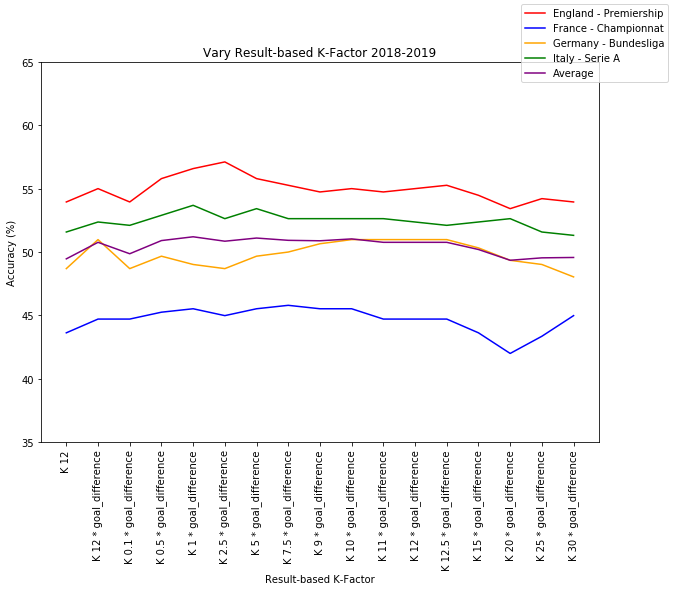

Max Average is K 12 * goal_difference with value 48.99161551980819 (index 1)
Max England is K 5 * goal_difference with value 51.656420422888424 (index 6)
Max France is K 12 with value 46.747453334455365 (index 0)
Max Germany is K 12 * goal_difference with value 48.026776485762184 (index 1)
Max Italy is K 12 * goal_difference with value 50.24026449528983 (index 1)


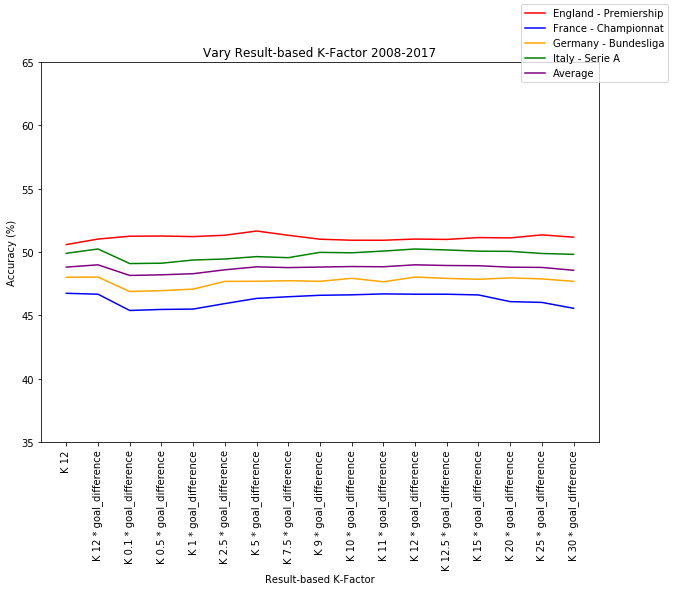

Max Average is K 12 with value 0.0 (index 0)
Max England is K 12 with value 0 (index 0)
Max France is K 12 with value 0 (index 0)
Max Germany is K 12 with value 0 (index 0)
Max Italy is K 12 with value 0 (index 0)


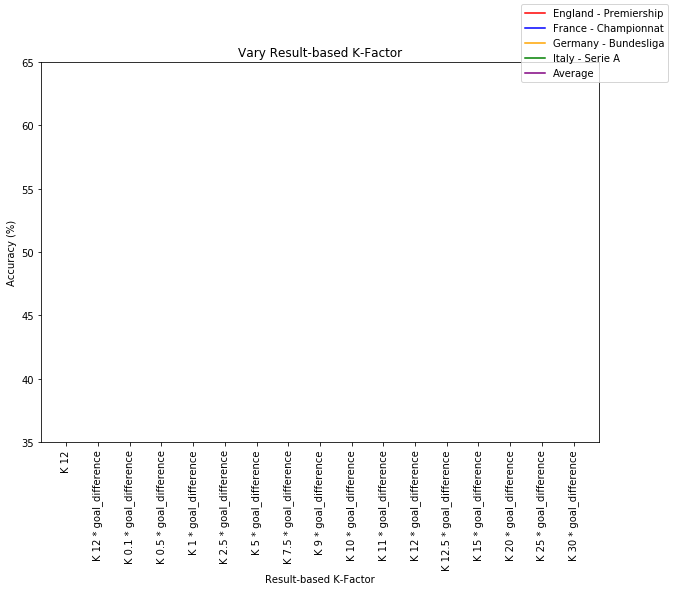

(([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 ([53.94736842105263,
   55.00000000000001,
   53.94736842105263,
   55.78947368421052,
   56.57894736842105,
   57.10526315789474,
   55.78947368421052,
   55.26315789473685,
   54.736842105263165,
   55.00000000000001,
   54.736842105263165,
   55.00000000000001,
   55.26315789473685,
   54.473684210526315,
   53.421052631578945,
   54.21052631578947,
   53.94736842105263],
  [43.63143631436314,
   44.71544715447154,
   44.71544715447154,
   45.25745257452575,
   45.52845528455284,
   44.986449864498645,
   45.52845528455284,
   45.799457994579946,
   45.52845528455284,
   45.52845528455284,
   44.71544715447154,
   44.71544715447154,
   44.71544715447154,
   43.63143631436314,
   42.00542005420054,
   43.360433604336045,
   44.986449864498645],
  [48.69281045751634,

In [6]:
"""
Multiply K-Factor depending on the number of goals scored (goal difference, non-binary results)
"""
class EloWithResultDiffs(Elo):
    
    def play_match(team_a, team_b, result, match_date, update_draw=False):
        Elo.TOTAL_GAMES += 1
        if result[0] == result[1]:
            Elo.DRAWN_GAMES += 1
        Elo.DRAW_CHANCE = Elo.DRAWN_GAMES / Elo.TOTAL_GAMES / 2
        if update_draw:
            Elo.DRAW_GAP = Elo.DRAW_CHANCE
        
        team_a.games_played += 1
        team_b.games_played += 1
        expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
        outcome_a, outcome_b = Elo.get_outcome(result)
        
        # Calculate result_diff as difference in goals. If draw - then 1
        result_diff = result[1] - result[0] if result[1] > result[0] else result[0] - result[1]
        result_diff = 1 if result_diff == 0 else result_diff
        
        upd_a_rating = team_a.rating + round(EloWithResultDiffs.__get_k_score(result_diff) * (outcome_a - expected_a), 2)
        upd_b_rating = team_b.rating + round(EloWithResultDiffs.__get_k_score(result_diff) * (outcome_b - expected_b), 2)
        
        team_a.last_game_date = match_date
        team_b.last_game_date = match_date
        
        return upd_a_rating, upd_b_rating
    
    def parse_predictions(expected_a, expected_b, draw=False):
        return expected_a + Elo.HOME_ADVANTAGE, 0, expected_b - Elo.HOME_ADVANTAGE
    
    def predict_match(team_a, team_b, predictors, score, odds, draw=False):
        valid_odds = True
        for odd in odds:
            try:
                valid_odds = valid_odds and not math.isnan(odd)
            except TypeError:
                valid_odds = False
        if team_a.games_played > EloTeam.MIN_GAMES and team_b.games_played > EloTeam.MIN_GAMES and valid_odds:
            expected_a, expected_b = Elo.expected_score(Elo.transform_score(team_a), Elo.transform_score(team_b))
            predictors[0].predict(Elo.parse_predictions(expected_a, expected_b, draw=draw), score, odds)
            predictors[1].predict(odds[::-1], score, odds)
            
    def __get_k_score(result_diff):
        return Elo.K_SCORE(result_diff)

    
k_factor_range = [lambda x: 12,
                  lambda x: 12 * x,
                  lambda x: 0.1 * x,
                  lambda x: 0.5 * x,
                  lambda x: 1 * x,
                  lambda x: 2.5 * x,
                  lambda x: 5 * x,
                  lambda x: 7.5 * x,
                  lambda x: 9 * x,
                  lambda x: 10 * x,
                  lambda x: 11 * x,
                  lambda x: 12 * x,
                  lambda x: 12.5 * x,
                  lambda x: 15 * x,
                  lambda x: 20 * x,
                  lambda x: 25 * x,
                  lambda x: 30 * x]
elo_stats = []
elo_stats_range = ["K 12",
                   "K 12 * goal_difference",
                   "K 0.1 * goal_difference",
                   "K 0.5 * goal_difference",
                   "K 1 * goal_difference",
                   "K 2.5 * goal_difference",
                   "K 5 * goal_difference",
                   "K 7.5 * goal_difference",
                   "K 9 * goal_difference",
                   "K 10 * goal_difference",
                   "K 11 * goal_difference",
                   "K 12 * goal_difference",
                   "K 12.5 * goal_difference",
                   "K 15 * goal_difference",
                   "K 20 * goal_difference",
                   "K 25 * goal_difference",
                   "K 30 * goal_difference"]
for k_factor in k_factor_range:
    elo_stats.append({"ALL": EloStats(min_games=10, 
                                      k_score=k_factor, 
                                      draw_gap=0.00,
                                      home_advantage=0)})
get_competition_accuracies(elo_stats, 
                           elo_stats_range, 
                           x_label="Result-based K-Factor", 
                           title="Vary Result-based K-Factor", 
                           elo_classes={"ALL": EloWithResultDiffs})

## Competition-best Hyperparameters

Competition-based Hyperparameters
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B909D8> | Draw Gap 0 | Home Advantage 0.09
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B904C8> | Draw Gap 0 | Home Advantage 0.08
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B90438> | Draw Gap 0 | Home Advantage 0.14
Elo Class Min Games 10 | K Score <function <lambda> at 0x0000026864B90558> | Draw Gap 0 | Home Advantage 0.08
England - Premiership2008
England - Premiership2009
England - Premiership2010
England - Premiership2011
England - Premiership2012
England - Premiership2013
England - Premiership2014
England - Premiership2015
England - Premiership2016
England - Premiership2017


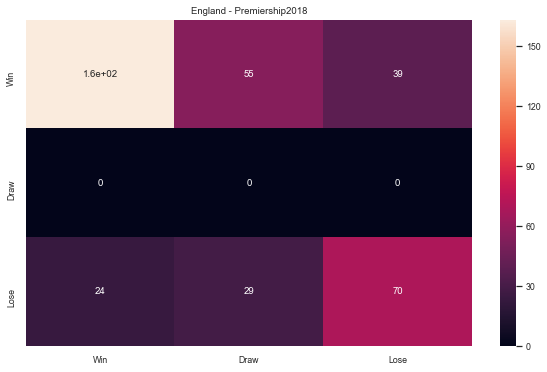

Accuracy: 61.32%
MAE: 0.32
RMSE: 0.34
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.64 
Recall: 	Win 0.63 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.60 
England - Premiership2018
France - Championnat2008
France - Championnat2009
France - Championnat2010
France - Championnat2011
France - Championnat2012
France - Championnat2013
France - Championnat2014
France - Championnat2015
France - Championnat2016
France - Championnat2017


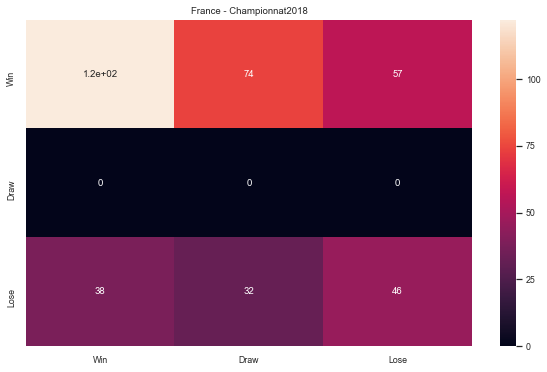

Accuracy: 45.53%
MAE: 0.35
RMSE: 0.37
Precision: 	Win 0.76 	Draw 0.00 	Lose 0.45 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.40 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.42 
France - Championnat2018
Germany - Bundesliga2008
Germany - Bundesliga2009
Germany - Bundesliga2010
Germany - Bundesliga2011
Germany - Bundesliga2012
Germany - Bundesliga2013
Germany - Bundesliga2014
Germany - Bundesliga2015
Germany - Bundesliga2016
Germany - Bundesliga2017


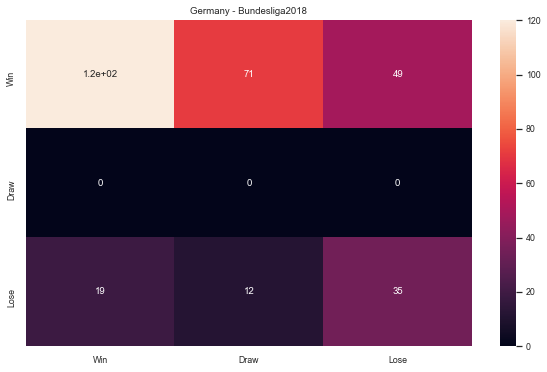

Accuracy: 50.65%
MAE: 0.32
RMSE: 0.35
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.42 
Recall: 	Win 0.50 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.47 
Germany - Bundesliga2018
Italy - Serie A2008
Italy - Serie A2009
Italy - Serie A2010
Italy - Serie A2011
Italy - Serie A2012
Italy - Serie A2013
Italy - Serie A2014
Italy - Serie A2015
Italy - Serie A2016
Italy - Serie A2017


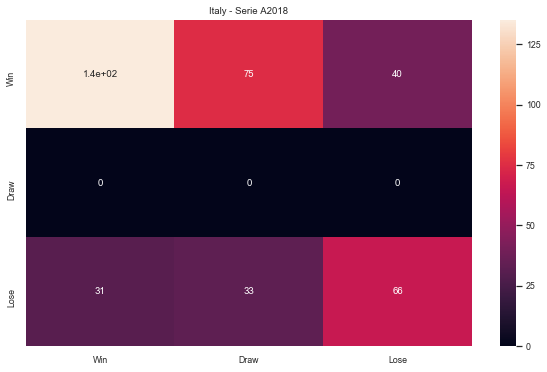

Accuracy: 52.89%
MAE: 0.33
RMSE: 0.35
Precision: 	Win 0.81 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.54 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.56 
Italy - Serie A2018


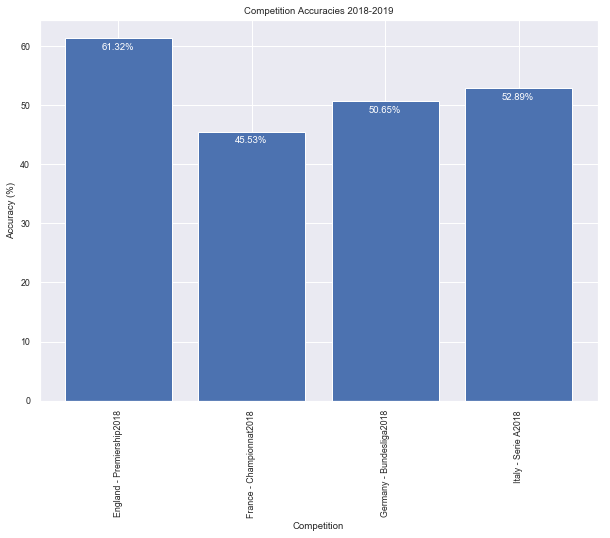

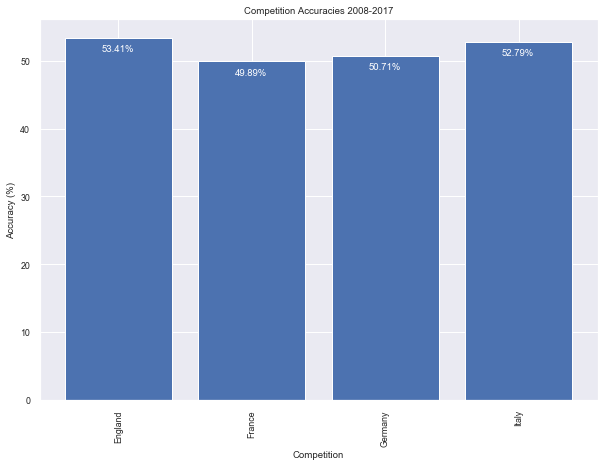

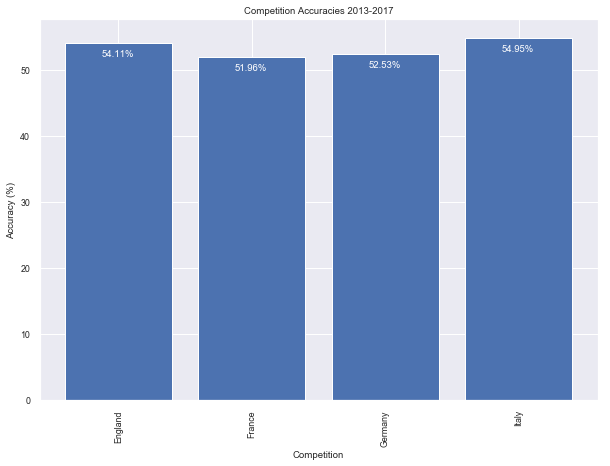

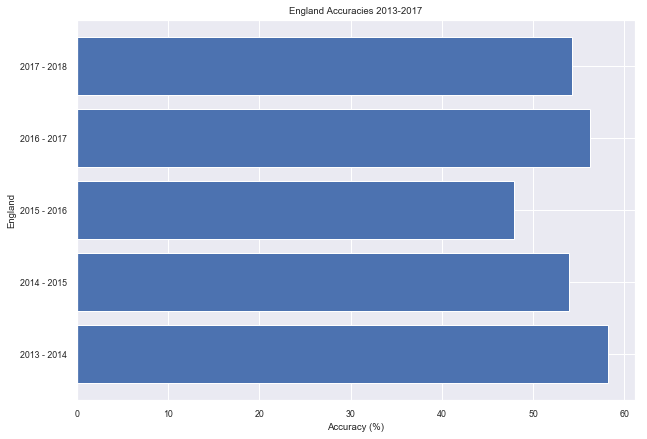

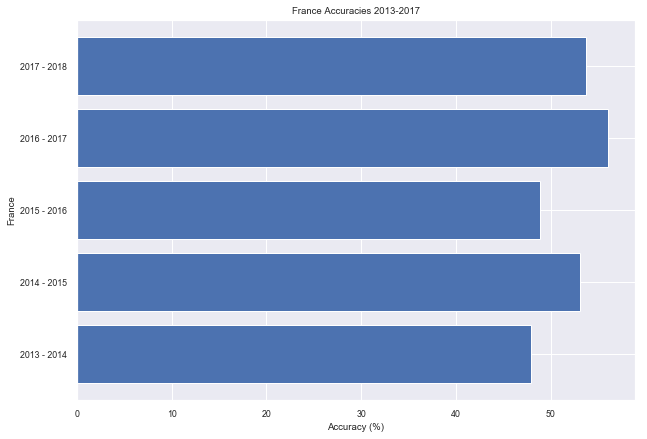

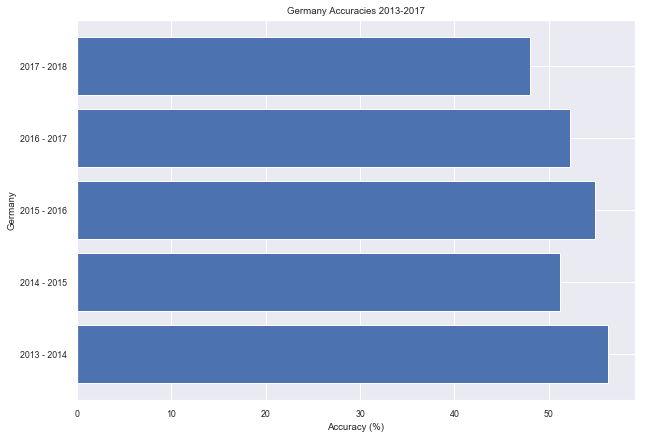

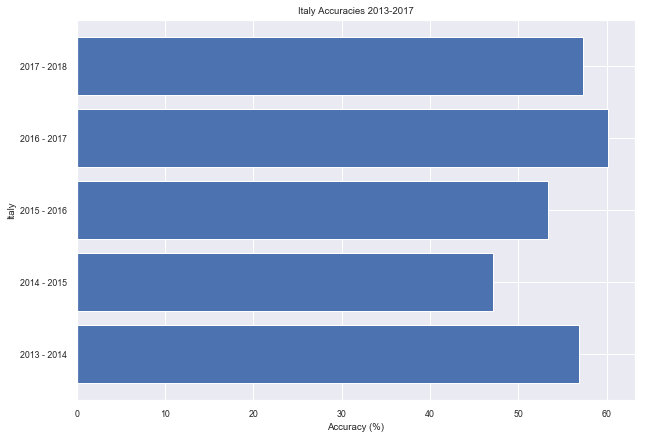

In [51]:
elo_stats = {"England - Premiership": EloStats(k_score=lambda x: 20,
                                               draw_gap=0,
                                               home_advantage=0.09),
            "France - Championnat": EloStats(k_score=lambda x: 20, 
                                             draw_gap=0,
                                             home_advantage=0.08),
            "Germany - Bundesliga": EloStats(k_score=lambda x: 27, 
                                             draw_gap=0,
                                             home_advantage=0.14),
            "Italy - Serie A": EloStats(k_score=lambda x: 10, 
                                        draw_gap=0,
                                        home_advantage=0.08)}
print("Competition-based Hyperparameters")
comp_pred, bookie_comp_pred, \
comp_year_pred, bookie_comp_year_pred = run_elo_training(elo_stats, 
                                                         elo_classes={"England - Premiership": Elo,
                                                                      "France - Championnat": Elo,
                                                                      "Germany - Bundesliga": Elo,
                                                                      "Italy - Serie A": Elo})
# get_accuracies(comp_pred, "Competition-based Hyperparameters", plot_cf=True, plot_accuracies=True, debug=False)
# get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Competition-based Hyperparameters", plot_cf=True, plot_accuracies=True, debug=False)
# get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

## Elo Best Average

Elo Average Best Hyperparameters


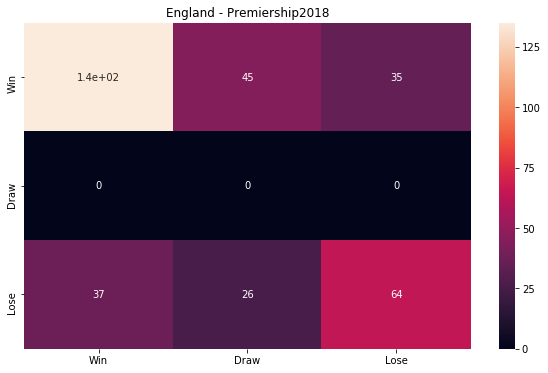

Accuracy: 58.19%
MAE: 0.29
RMSE: 0.32
Precision: 	Win 0.78 	Draw 0.00 	Lose 0.65 
Recall: 	Win 0.63 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.70 	Draw 0.00 	Lose 0.57 


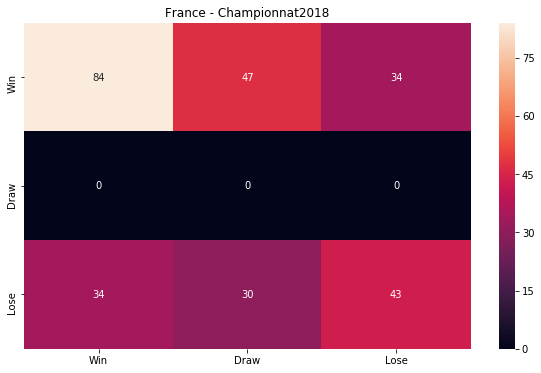

Accuracy: 46.69%
MAE: 0.31
RMSE: 0.34
Precision: 	Win 0.71 	Draw 0.00 	Lose 0.56 
Recall: 	Win 0.51 	Draw 0.00 	Lose 0.40 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.47 


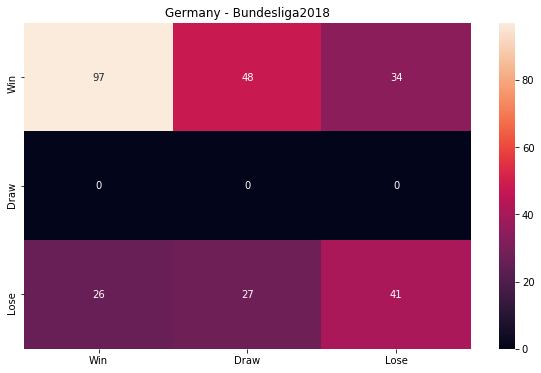

Accuracy: 50.55%
MAE: 0.32
RMSE: 0.34
Precision: 	Win 0.79 	Draw 0.00 	Lose 0.55 
Recall: 	Win 0.54 	Draw 0.00 	Lose 0.44 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.49 


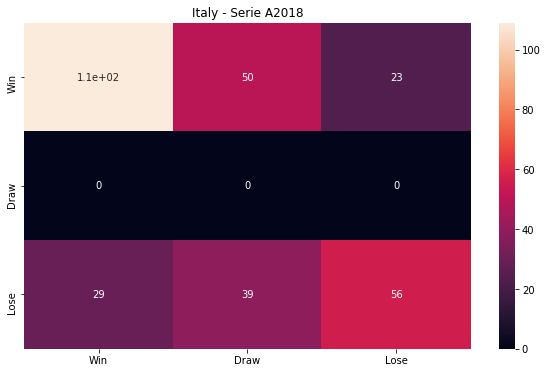

Accuracy: 53.92%
MAE: 0.27
RMSE: 0.31
Precision: 	Win 0.79 	Draw 0.00 	Lose 0.71 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.55 


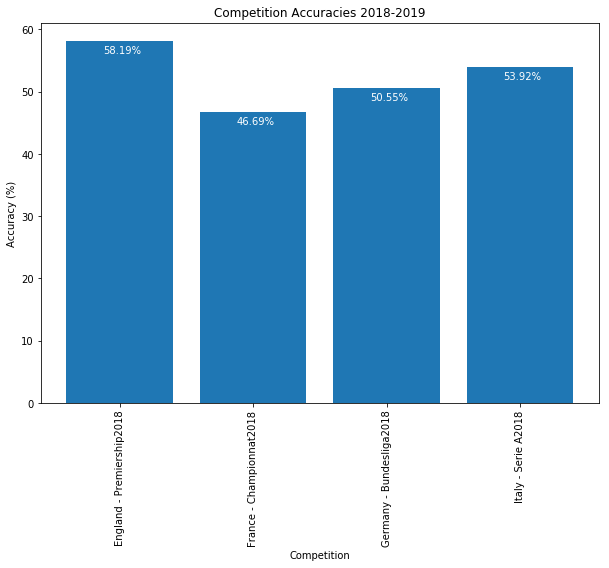

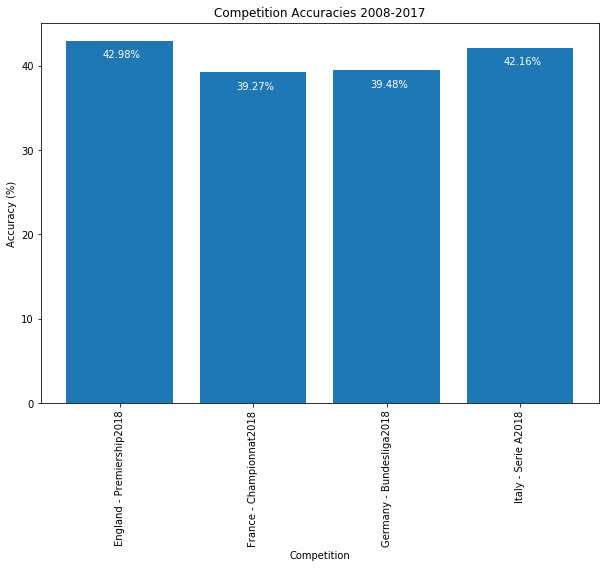

In [13]:
elo_stats = {"ALL": EloStats(k_score=lambda x: 12 * x,
                             draw_gap=0,
                             home_advantage=0.08)}
print("Elo Average Best Hyperparameters")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_elo_training(elo_stats, 
                                                                                      elo_classes={"ALL": EloWithResultDiffs})
# get_accuracies(comp_pred, "Competition-based Hyperparameters", plot_cf=True, plot_accuracies=True, debug=False)
# get_accuracies(bookie_comp_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Competition-based Hyperparameters", plot_cf=True, plot_accuracies=True, debug=False)
# get_accuracies(bookie_comp_year_pred, "BET365", plot_cf=True, plot_accuracies=True, debug=False)

# TrueSkill
## Class Definitions

In [5]:
"""
Define TrueSkill-related classes and functions
"""

class TrueSkill(object):
    
    HOME_ADVANTAGE = 0
    ENV = None

    def reset(ts_stats):
        TrueSkillTeam.MIN_GAMES = ts_stats.min_games
        TrueSkill.HOME_ADVANTAGE = ts_stats.home_advantage
        env = trueskill.TrueSkill(beta=ts_stats.beta, 
                                  draw_probability=ts_stats.draw_probability, 
                                  mu=ts_stats.mu, 
                                  sigma=ts_stats.sigma,
                                  tau=ts_stats.tau)
        env.make_as_global()
        trueskill.setup(beta=ts_stats.beta, 
                        draw_probability=ts_stats.draw_probability, 
                        mu=ts_stats.mu, 
                        sigma=ts_stats.sigma,
                        tau=ts_stats.tau)
        trueskill.BETA = ts_stats.beta
        trueskill.DRAW_PROBABILITY = ts_stats.draw_probability
        trueskill.MU = ts_stats.mu
        trueskill.SIGMA = ts_stats.sigma
        trueskill.TAU = ts_stats.tau
        TrueSkill.env = env

    def play_match(team_a, team_b, result):
        team_a.games_played += 1
        team_b.games_played += 1
        return TrueSkill.recalc_rating(team_a, team_b, result)

    def parse_predictions(win_odds, draw_odds, lose_odds):
        return win_odds + TrueSkill.HOME_ADVANTAGE, draw_odds, lose_odds - TrueSkill.HOME_ADVANTAGE

    def win_probability(team1, team2, *args):
        delta_mu = sum(r.mu for r in team1) - sum(r.mu for r in team2)
        sum_sigma = sum(r.sigma ** 2 for r in itertools.chain(team1, team2))
        size = len(team1) + len(team2)
        denom = math.sqrt(size * (trueskill.BETA * trueskill.BETA) + sum_sigma)
        ts = trueskill.global_env()
        return ts.cdf(delta_mu / denom)
    
    def predict_match(team_a, team_b, predictors, score, match_date, odds, ts_class):
        valid_odds = True
        for odd in odds: # TODO move this to whe reading data
            try:
                valid_odds = valid_odds and not math.isnan(odd)
            except TypeError:
                valid_odds = False
        if team_a.games_played > TrueSkillTeam.MIN_GAMES and team_b.games_played > TrueSkillTeam.MIN_GAMES and valid_odds:
            win_odds = ts_class.win_probability([team_a.rating], [team_b.rating], team_a.last_game_date, team_b.last_game_date, match_date)
            lose_odds = ts_class.win_probability([team_b.rating], [team_a.rating], team_b.last_game_date, team_a.last_game_date, match_date)
            draw_odds = trueskill.quality_1vs1(team_a.rating, team_b.rating)
            predictors[0].predict(TrueSkill.parse_predictions(win_odds, draw_odds, lose_odds), score, odds)
            predictors[1].predict(odds[::-1], score, odds)
            predictors[2].predict(TrueSkill.parse_predictions(win_odds, draw_odds, lose_odds), score, odds)
            predictors[3].predict(odds[::-1], score, odds)
        
    def recalc_rating(team_a, team_b, result):
        if result[0] > result[1]:
            return trueskill.rate_1vs1(team_a.rating, team_b.rating)
        elif result[1] > result[0]:
            return trueskill.rate_1vs1(team_b.rating, team_a.rating)[::-1]
        else:
            return trueskill.rate_1vs1(team_a.rating, team_b.rating, drawn=True)


class TrueSkillStats(object):

    def __init__(self, 
                 min_games=10, 
                 beta=4.167, 
                 draw_probability=0.1, 
                 home_advantage=0, 
                 tau=0.08334, 
                 mu=25.0, 
                 sigma=8.3334):
        self.min_games = min_games
        self.beta = beta
        self.draw_probability = draw_probability
        self.home_advantage = home_advantage
        self.tau = tau
        self.mu = mu
        self.sigma = sigma

    def __str__(self):
        return "Min Games " + str(self.min_games) \
                + " | Beta " + str(trueskill.BETA) \
                + " | Draw " + str(trueskill.DRAW_PROBABILITY) \
                + " | Home Advantage " + str(self.home_advantage) \
                + " | Tau " + str(self.tau)  \
                + " | Mu " + str(self.mu)  \
                + " | Sigma " + str(self.sigma)

    def __repr__(self):
        return "Min Games " + str(self.min_games) + " | Beta " + str(trueskill.BETA) + " | Draw " + str(trueskill.DRAW_PROBABILITY) + " | Home Advantage " + str(self.home_advantage)


class TrueSkillTeam(object):
    MIN_GAMES = 10

    def __init__(self):
        self.rating = trueskill.Rating()
        self.games_played = 0
        self.last_game_date = None

        
def train_ts(data, prediction_trackers, teams={}, ts_class=TrueSkill):
    for index, match in data.iterrows():
        if match['HomeTeam'] not in teams.keys():
            teams[match['HomeTeam']] = TrueSkillTeam()
        if match['AwayTeam'] not in teams.keys():
            teams[match['AwayTeam']] = TrueSkillTeam()

        # Predict match
        TrueSkill.predict_match(teams[match['HomeTeam']], 
                                teams[match['AwayTeam']],
                                prediction_trackers, 
                                (match['FTHG'], match['FTAG']), 
                                match['Date'],
                                (match['B365H'], match['B365D'], match['B365A']), 
                                ts_class=ts_class)

        teams[match['HomeTeam']].rating, teams[match['AwayTeam']].rating = TrueSkill.play_match(teams[match['HomeTeam']],
                                                                                                teams[match['AwayTeam']],
                                                                                                (match['FTHG'], match['FTAG']))
        teams[match['HomeTeam']].last_game_date = match['Date']
        teams[match['AwayTeam']].last_game_date = match['Date']
        
    return teams


def run_ts_training(ts_stats, verbose=False, rating=False, plot=False, ts_classes={"ALL": TrueSkill}):
    comp_pred = []
    bookie_comp_pred = []
    comp_year_pred = []
    bookie_comp_year_pred = []
    for competition in football_data:
        ts_class = ts_classes[competition] if competition in ts_classes else ts_classes["ALL"]
        if competition in ts_stats:
            ts_class.reset(ts_stats[competition])
            print("TrueSkill Class %s" % ts_stats[competition])
        else:
            try:
                ts_class.reset(ts_stats["ALL"])
                print("TrueSkill Class %s" % ts_stats["ALL"])
            except KeyError as ex:
                print("'ALL' TsStats not present. If you don't specify the competition key,\
                      you must provide a default under ALL")
                raise ex
        comp_pred.append(PredictionTracker(competition))
        bookie_comp_pred.append(PredictionTracker(competition))
            
        if verbose:
            print("Processing competition %s | got %s matches" % (competition, len(football_data[competition])))
        
        trained_teams = {}
        for year in years:
            comp_year_pred.append(PredictionTracker(competition + str(year)))
            bookie_comp_year_pred.append(PredictionTracker(competition + str(year)))
            trained_teams = train_ts(football_data[competition][year], 
                                     [comp_year_pred[-1], bookie_comp_year_pred[-1], comp_pred[-1], bookie_comp_pred[-1]],
                                     ts_class=ts_class)
        if plot:
            display_teams_rating(trained_teams)
        if rating:
            plot_teams_rating(trained_teams)
            
    return comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred


def get_competition_accuracies_ts(ts_stats, 
                                  labels, 
                                  x_label="",
                                  title="", 
                                  verbose=False, 
                                  update_draw=False, 
                                  plot=False, 
                                  ts_class={"ALL": TrueSkill}):
    
    def plot_predictions(england, france, germany, italy, add_title=""):
        average = []
        for england_pred, france_pred, germany_pred, italy_pred in zip(england, 
                                                                       france, 
                                                                       germany, 
                                                                       italy):
            average.append((england_pred + france_pred + germany_pred + italy_pred) / 4)

        def print_max(array, label):
            print("Max %s is %s with value %s (index %s)" % (label,
                                                             labels[array.index(max(array))], 
                                                             max(array),
                                                             array.index(max(array))))
        print_max(average, "Average")
        print_max(england, "England")
        print_max(france, "France")
        print_max(germany, "Germany")
        print_max(italy, "Italy")
            
        fig, ax = plt.subplots(figsize=(10,7))
        plt.plot(range(len(ts_stats)), england, color="red", label = "England - Premiership")
        plt.plot(range(len(ts_stats)), france, color="blue", label = "France - Championnat")
        plt.plot(range(len(ts_stats)), germany, color="orange", label = "Germany - Bundesliga")
        plt.plot(range(len(ts_stats)), italy, color="green", label = "Italy - Serie A")
        plt.plot(range(len(ts_stats)), average, color="purple", label = "Average")
        plt.xticks(range(len(ts_stats)), labels, rotation='vertical')
        ax.set_ylabel("Accuracy (%)")
        ax.set_xlabel(x_label)
        ax.set_title(title + add_title)
        ax.set_ylim(0, 100)
        fig.legend(loc='upper right', ncol=1)
        plt.show()
        
    england_predictions = []
    france_predictions = []
    germany_predictions = []
    italy_predictions = []
    
    england_predictions_2018 = []
    france_predictions_2018 = []
    germany_predictions_2018 = []
    italy_predictions_2018 = []
    
    england_predictions_08_17 = []
    france_predictions_08_17 = []
    germany_predictions_08_17 = []
    italy_predictions_08_17 = []

    for ts_stat in ts_stats:
        comp_predictions, _, comp_year_predictions, _ = run_ts_training(ts_stat, 
                                                                        verbose=verbose, 
                                                                        plot=plot, 
                                                                        ts_classes=ts_class)
        for prediction_tracker in comp_year_predictions:
            if "2018" in prediction_tracker.competition_name:
                if "Premiership" in prediction_tracker.competition_name:
                    england_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Championnat" in prediction_tracker.competition_name:
                    france_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Bundesliga" in prediction_tracker.competition_name:
                    germany_predictions_2018.append(prediction_tracker.prediction_accuracy())
                elif "Serie A" in prediction_tracker.competition_name:
                    italy_predictions_2018.append(prediction_tracker.prediction_accuracy())
            else:
                if "Premiership" in prediction_tracker.competition_name:
                    england_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Championnat" in prediction_tracker.competition_name:
                    france_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Bundesliga" in prediction_tracker.competition_name:
                    germany_predictions_08_17.append(prediction_tracker.prediction_accuracy())
                elif "Serie A" in prediction_tracker.competition_name:
                    italy_predictions_08_17.append(prediction_tracker.prediction_accuracy())
            
        for prediction_tracker in comp_predictions:
            if "Premiership" in prediction_tracker.competition_name:
                england_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, prediction_tracker.prediction_accuracy()))
            elif "Championnat" in prediction_tracker.competition_name:
                france_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, prediction_tracker.prediction_accuracy()))
            elif "Bundesliga" in prediction_tracker.competition_name:
                germany_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, prediction_tracker.prediction_accuracy()))
            elif "Serie A" in prediction_tracker.competition_name:
                italy_predictions.append(prediction_tracker.prediction_accuracy())
                if verbose:
                    print("Overall accuracy for {} is {:.2f}%".format(prediction_tracker.competition_name, prediction_tracker.prediction_accuracy()))            
    
    def get_prediction_years(predictions, num_of_years=10):
        """
        Predictions should contain individual predictions for a single predictor, sequantially
        For example, one TsStats was used to get predictions. To get the actual accuracy of that
        TsStats for X years, you would want to get all predictions for that TsStats.
        This function would group them for num_of_years years that are contained in predictions.
        """
        return [predictions[i:i+num_of_years] for i in range(0, len(predictions), num_of_years)]
    
    england_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(england_predictions_08_17)]
    france_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(france_predictions_08_17)]
    germany_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(germany_predictions_08_17)]
    italy_predictions_08_17 = [sum(x) / len(x) for x in get_prediction_years(italy_predictions_08_17)]
                    
    plot_predictions(england_predictions_2018, 
                     france_predictions_2018, 
                     germany_predictions_2018, 
                     italy_predictions_2018,
                     add_title=" 2018-2019")
    
    plot_predictions(england_predictions_08_17, 
                     france_predictions_08_17, 
                     germany_predictions_08_17, 
                     italy_predictions_08_17,
                     add_title=" 2008-2017")
    
    plot_predictions(england_predictions, 
                     france_predictions, 
                     germany_predictions, 
                     italy_predictions)
   
    return (england_predictions, france_predictions, germany_predictions, italy_predictions), \
            (england_predictions_2018, france_predictions_2018, germany_predictions_2018, italy_predictions_2018),\
            (england_predictions_08_17, france_predictions_08_17, germany_predictions_08_17, italy_predictions_08_17)

In [12]:
# Test the TrueSkill class

class TestTrueSkill(unittest.TestCase):

    def test_ts_stats(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        self.assertEqual(10, ts_stats.min_games)
        self.assertEqual(4.167, ts_stats.beta)
        self.assertEqual(0.1, ts_stats.draw_probability)
        self.assertEqual(0, ts_stats.home_advantage)
        self.assertEqual(0.08334, ts_stats.tau)
        self.assertEqual(25.0, ts_stats.mu)
        self.assertEqual(8.3334, ts_stats.sigma)
        
        self.assertEqual(10, TrueSkillTeam.MIN_GAMES)
        self.assertEqual(0, TrueSkill.HOME_ADVANTAGE)
        self.assertEqual(4.167, trueskill.BETA)
        self.assertEqual(0.1, trueskill.DRAW_PROBABILITY)
        self.assertEqual(25.0, trueskill.MU)
        self.assertEqual(8.3334, trueskill.SIGMA)
        self.assertEqual(0.08334, trueskill.TAU)
        
    def test_ts_team(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        ts_team = TrueSkillTeam()
        self.assertEqual(25.0, ts_team.rating.mu)
        self.assertEqual(8.3334, ts_team.rating.sigma)
        
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=1.5, 
                                  sigma=5)
        TrueSkill.reset(ts_stats)
        
        ts_team = TrueSkillTeam()
        self.assertEqual(1.5, ts_team.rating.mu)
        self.assertEqual(5, ts_team.rating.sigma)
        self.assertEqual(0, ts_team.games_played)
        
    def test_recalc_rating(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        ts_team_a = TrueSkillTeam()
        ts_team_b = TrueSkillTeam()
        
        actual_team_a, actual_team_b = trueskill.rate_1vs1(ts_team_a.rating, ts_team_b.rating)
        upd_team_a, upd_team_b = TrueSkill.recalc_rating(ts_team_a, ts_team_b, (1, 0))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        
        actual_team_b, actual_team_a = trueskill.rate_1vs1(ts_team_b.rating, ts_team_a.rating)
        upd_team_a, upd_team_b = TrueSkill.recalc_rating(ts_team_a, ts_team_b, (0, 1))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        
        actual_team_a, actual_team_b = trueskill.rate_1vs1(ts_team_a.rating, ts_team_b.rating, drawn=True)
        upd_team_a, upd_team_b = TrueSkill.recalc_rating(ts_team_a, ts_team_b, (3, 3))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        
    def test_play_match(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        ts_team_a = TrueSkillTeam()
        ts_team_b = TrueSkillTeam()
        
        self.assertEqual(0, ts_team_a.games_played)
        self.assertEqual(0, ts_team_b.games_played)
        
        actual_team_a, actual_team_b = trueskill.rate_1vs1(ts_team_a.rating, ts_team_b.rating)
        upd_team_a, upd_team_b = TrueSkill.play_match(ts_team_a, ts_team_b, (1, 0))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        self.assertEqual(1, ts_team_a.games_played)
        self.assertEqual(1, ts_team_b.games_played)
        
        actual_team_b, actual_team_a = trueskill.rate_1vs1(ts_team_b.rating, ts_team_a.rating)
        upd_team_a, upd_team_b = TrueSkill.play_match(ts_team_a, ts_team_b, (0, 1))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        self.assertEqual(2, ts_team_a.games_played)
        self.assertEqual(2, ts_team_b.games_played)
        
        actual_team_a, actual_team_b = trueskill.rate_1vs1(ts_team_a.rating, ts_team_b.rating, drawn=True)
        upd_team_a, upd_team_b = TrueSkill.play_match(ts_team_a, ts_team_b, (3, 3))
        self.assertEqual(actual_team_a, upd_team_a)
        self.assertEqual(actual_team_b, upd_team_b)
        self.assertEqual(3, ts_team_a.games_played)
        self.assertEqual(3, ts_team_b.games_played)
        
    def test_parse_predictions(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        win, draw, lose = TrueSkill.parse_predictions(0.9, 0.05, 0.05)
        self.assertEqual(0.9, win)
        self.assertEqual(0.05, draw)
        self.assertEqual(0.05, lose)
        
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0.1, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        win, draw, lose = TrueSkill.parse_predictions(0.6, 0.1, 0.3)
        self.assertEqual(0.7, round(win, 1))
        self.assertEqual(0.1, round(draw, 1))
        self.assertEqual(0.2, round(lose, 1))
        
    def test_predict_match(self):
        ts_stats = TrueSkillStats(min_games=10, 
                                  beta=4.167, 
                                  draw_probability=0.1, 
                                  home_advantage=0, 
                                  tau=0.08334, 
                                  mu=25.0, 
                                  sigma=8.3334)
        TrueSkill.reset(ts_stats)
        
        ts_team_a = TrueSkillTeam()
        ts_team_b = TrueSkillTeam()
        ts = trueskill.global_env()
        
        win_chance = TrueSkill.win_probability([ts_team_a.rating], [ts_team_b.rating])
        lose_chance = TrueSkill.win_probability([ts_team_b.rating], [ts_team_a.rating])
        self.assertEquals(ts.cdf(0), win_chance)
        self.assertEquals(ts.cdf(0), lose_chance)
        
        ts_team_a.rating = trueskill.Rating(mu=50, sigma=1)
        ts_team_b.rating = trueskill.Rating(mu=25, sigma=1)
        win_chance = TrueSkill.win_probability([ts_team_a.rating], [ts_team_b.rating])
        lose_chance = TrueSkill.win_probability([ts_team_b.rating], [ts_team_a.rating])
        self.assertEquals(ts.cdf(25.0 / math.sqrt(2 * 4.167 * 4.167 + 2)), win_chance)
        self.assertEquals(ts.cdf(-25.0 / math.sqrt(2 * 4.167 * 4.167 + 2)), lose_chance)
        
        
unittest.main(argv=[''], verbosity=2, exit=False)

test_parse_predictions (__main__.TestTrueSkill) ... ok
test_play_match (__main__.TestTrueSkill) ... ok
test_predict_match (__main__.TestTrueSkill) ... C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\ipykernel_launcher.py:169: DeprecationWarning: Please use assertEqual instead.
ok
test_recalc_rating (__main__.TestTrueSkill) ... ok
test_ts_stats (__main__.TestTrueSkill) ... ok
test_ts_team (__main__.TestTrueSkill) ... ok

----------------------------------------------------------------------
Ran 6 tests in 0.012s

OK


###  Basic TrueSkill

Basic TrueSkill Setup
TrueSkill Class Min Games 10 | Beta 4.167 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 4.167 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 4.167 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 4.167 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334


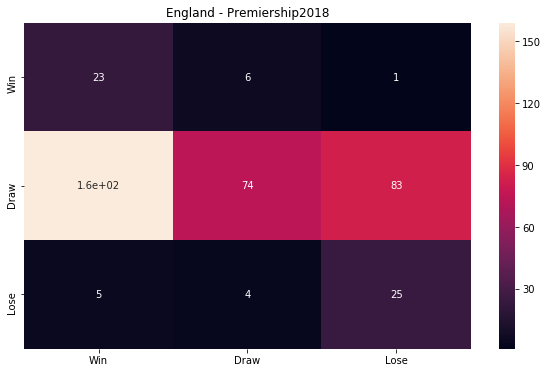

Accuracy: 32.11%
MAE: 0.35
RMSE: 0.42
Precision: 	Win 0.12 	Draw 0.88 	Lose 0.23 
Recall: 	Win 0.77 	Draw 0.23 	Lose 0.74 
F1: 	Win 0.21 	Draw 0.37 	Lose 0.35 


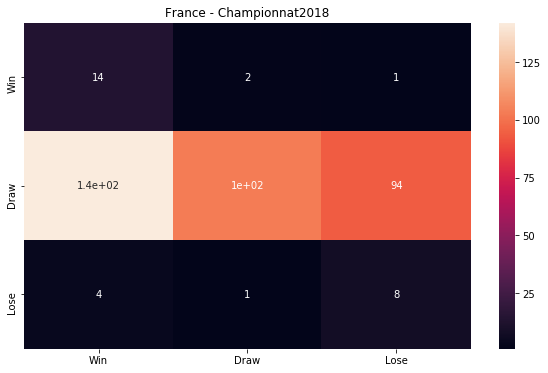

Accuracy: 33.88%
MAE: 0.35
RMSE: 0.41
Precision: 	Win 0.09 	Draw 0.97 	Lose 0.08 
Recall: 	Win 0.82 	Draw 0.30 	Lose 0.62 
F1: 	Win 0.16 	Draw 0.46 	Lose 0.14 


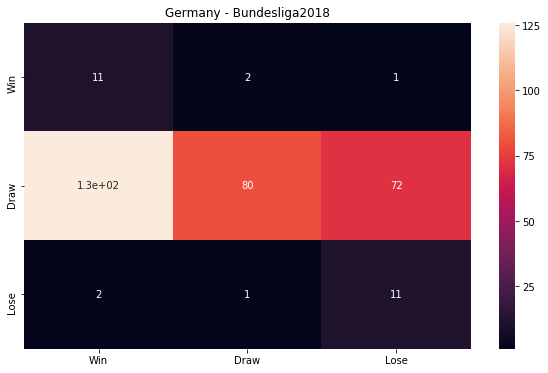

Accuracy: 33.33%
MAE: 0.34
RMSE: 0.41
Precision: 	Win 0.08 	Draw 0.96 	Lose 0.13 
Recall: 	Win 0.79 	Draw 0.29 	Lose 0.79 
F1: 	Win 0.14 	Draw 0.44 	Lose 0.22 


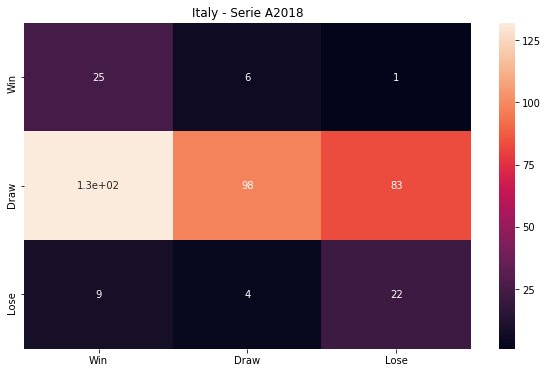

Accuracy: 38.16%
MAE: 0.33
RMSE: 0.41
Precision: 	Win 0.15 	Draw 0.91 	Lose 0.21 
Recall: 	Win 0.78 	Draw 0.31 	Lose 0.63 
F1: 	Win 0.25 	Draw 0.47 	Lose 0.31 


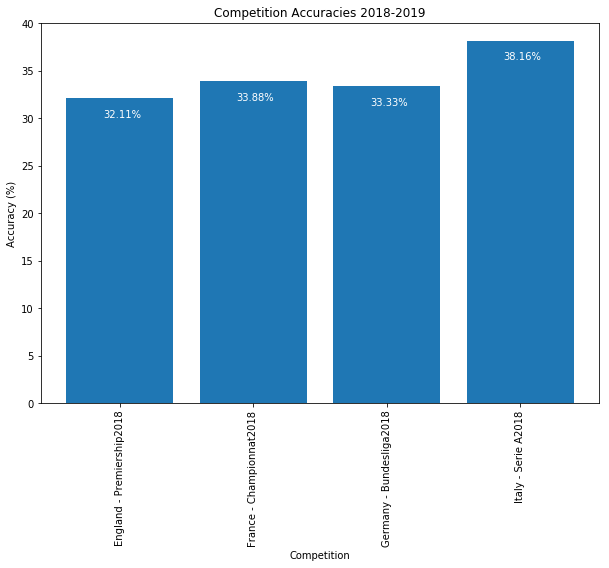

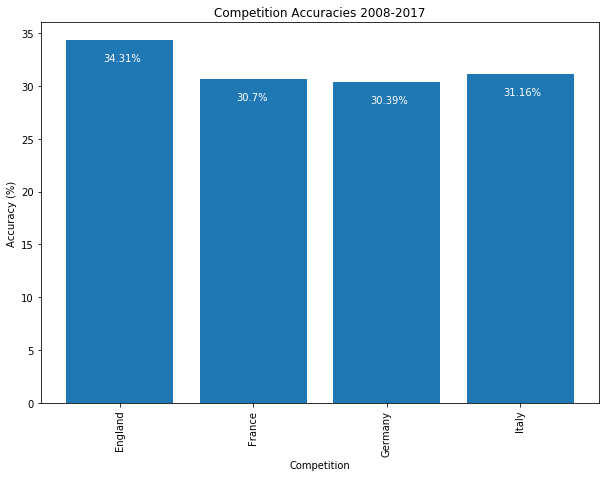

In [38]:
"""
Basic TrueSkill Setup
"""
Elo.DRAW_GAP = 0
print("Basic TrueSkill Setup")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_ts_training({"ALL": TrueSkillStats()})

#get_accuracies(comp_pred, "Basic TrueSkill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Basic TrueSKill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)

### Beta

TrueSkill Class Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.02 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.02 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.02 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.02 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill 

TrueSkill Class Min Games 10 | Beta 0.19 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.3 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.3 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.3 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.3 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Mi

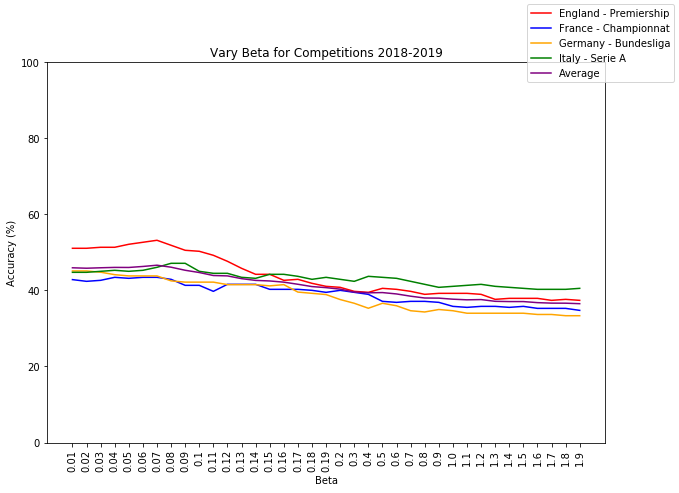

Max Average is 0.07 with value 45.03829860880148 (index 6)
Max England is 0.07 with value 45.71052631578947 (index 6)
Max France is 0.06 with value 43.59054298014165 (index 5)
Max Germany is 0.01 with value 45.50492946045442 (index 0)
Max Italy is 0.07 with value 45.480058986516426 (index 6)


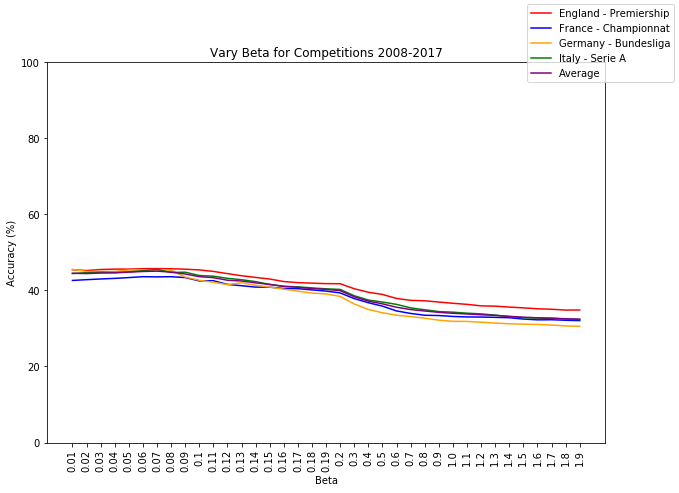

Max Average is 0.07 with value 45.181521192550754 (index 6)
Max England is 0.07 with value 46.38755980861244 (index 6)
Max France is 0.06 with value 43.575017946877246 (index 5)
Max Germany is 0.01 with value 45.297504798464495 (index 0)
Max Italy is 0.07 with value 45.535073018913096 (index 6)


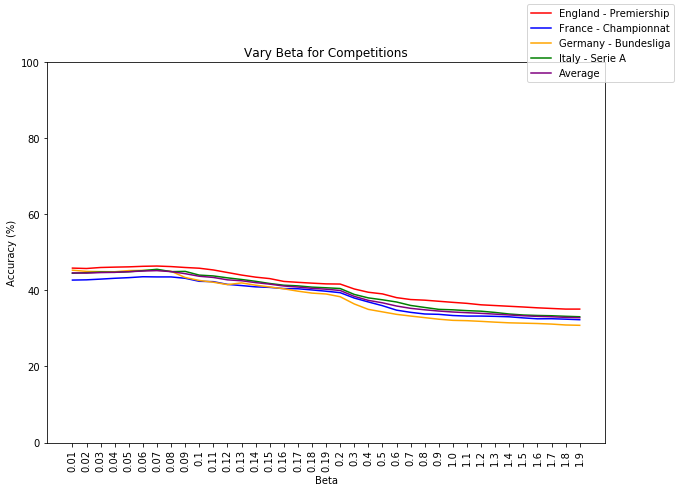

(([45.84402257567984,
   45.74162679425837,
   46.004784688995215,
   46.10047846889952,
   46.172248803827756,
   46.31578947368421,
   46.38755980861244,
   46.24401913875598,
   46.004784688995215,
   45.8133971291866,
   45.35885167464115,
   44.688995215311,
   44.01913875598086,
   43.4688995215311,
   43.08612440191388,
   42.3444976076555,
   42.10526315789473,
   41.88995215311005,
   41.698564593301434,
   41.65071770334928,
   40.35885167464115,
   39.49760765550239,
   39.066985645933016,
   38.08612440191387,
   37.58373205741627,
   37.41626794258373,
   37.12918660287081,
   36.84210526315789,
   36.578947368421055,
   36.196172248803826,
   36.004784688995215,
   35.813397129186605,
   35.62200956937799,
   35.406698564593306,
   35.239234449760765,
   35.07177033492823,
   35.07177033492823],
  [42.69518165421283,
   42.761426178511606,
   42.95285953577411,
   43.168222062694426,
   43.33572625029912,
   43.575017946877246,
   43.527159607561615,
   43.527159607561615

In [51]:
"""
Vary TrueSkill by beta
"""
beta_range = [x / 100.0 for x in range(1, 20)]
beta_range.extend([x / 10.0 for x in range(2, 20)])
ts_stats = [{"ALL": TrueSkillStats(beta=beta)} for beta in beta_range]
get_competition_accuracies_ts(ts_stats, beta_range, x_label="Beta", title="Vary Beta for Competitions")

Best TrueSkill Beta


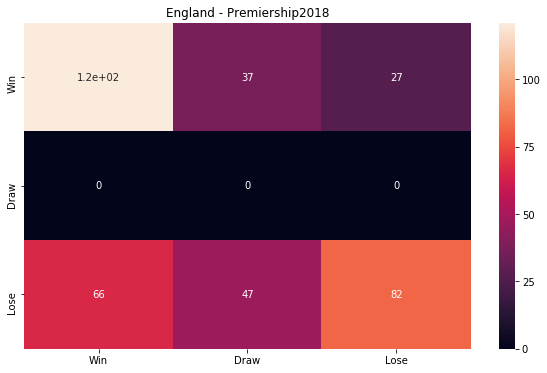

Accuracy: 53.42%
MAE: 0.25
RMSE: 0.29
Precision: 	Win 0.65 	Draw 0.00 	Lose 0.42 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.75 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.54 


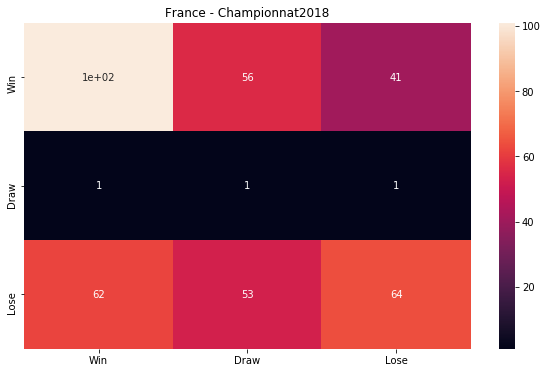

Accuracy: 43.68%
MAE: 0.27
RMSE: 0.30
Precision: 	Win 0.51 	Draw 0.33 	Lose 0.36 
Recall: 	Win 0.62 	Draw 0.01 	Lose 0.60 
F1: 	Win 0.56 	Draw 0.02 	Lose 0.45 


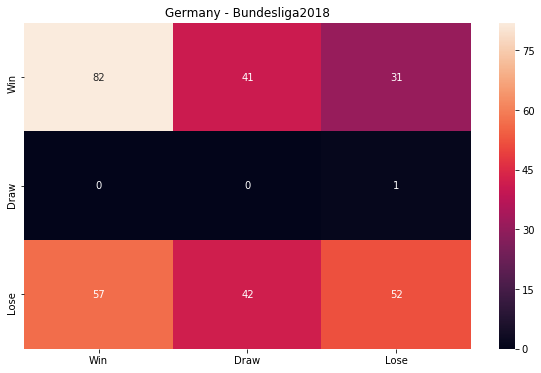

Accuracy: 43.79%
MAE: 0.27
RMSE: 0.30
Precision: 	Win 0.53 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.56 	Draw 0.00 	Lose 0.44 


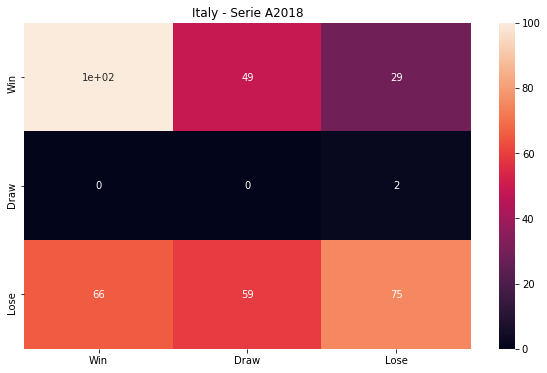

Accuracy: 46.05%
MAE: 0.25
RMSE: 0.29
Precision: 	Win 0.56 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.71 
F1: 	Win 0.58 	Draw 0.00 	Lose 0.49 


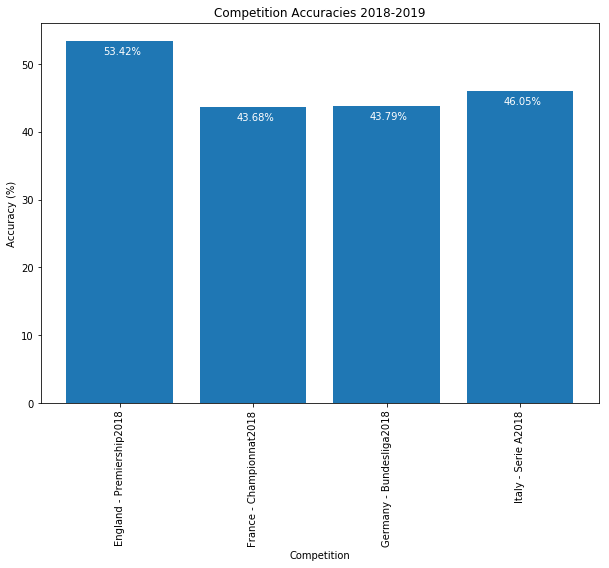

In [20]:
"""
Best TrueSkill Beta
"""
print("Best TrueSkill Beta")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_ts_training(TrueSkillStats(min_games=10, 
                                                                                                    beta=0.07))

#get_accuracies(comp_pred, "Beta TrueSkill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Beta TrueSKill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)

TrueSkill Stats: Min Games 10 | Beta 0.0001 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.00025 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.0005 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.00075 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.001 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.0025 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.005 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.015 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 |

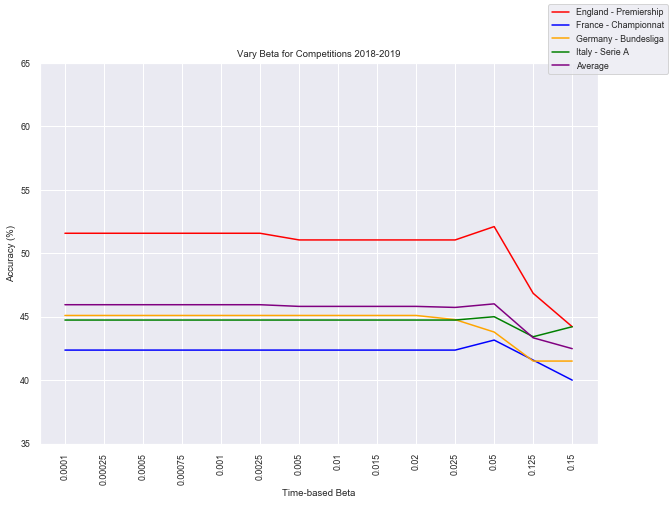

Max Average is 0.05 with value 44.7851165424123 (index 11)
Max England is 0.05 with value 45.578947368421055 (index 11)
Max France is 0.05 with value 43.3273850854048 (index 11)
Max Germany is 0.05 with value 45.359477124183 (index 11)
Max Italy is 0.0001 with value 44.92749684236978 (index 0)


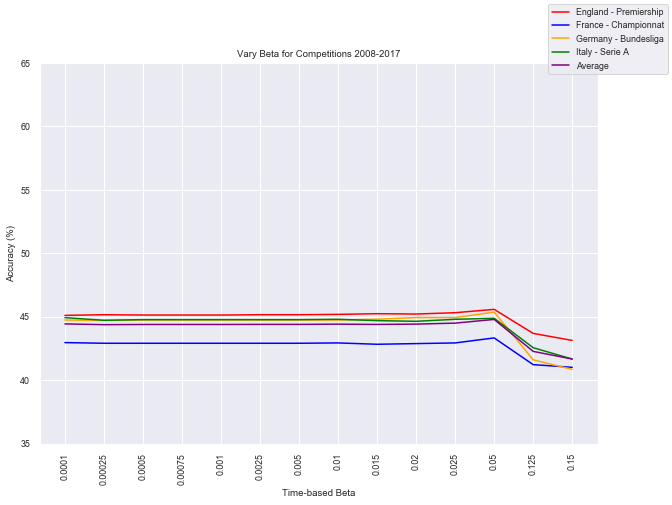

Max Average is 0.05 with value 44.897399149105446 (index 11)
Max England is 0.05 with value 46.172248803827756 (index 11)
Max France is 0.05 with value 43.3117970806413 (index 11)
Max Germany is 0.05 with value 45.21687462863934 (index 11)
Max Italy is 0.0001 with value 44.91261671055782 (index 0)


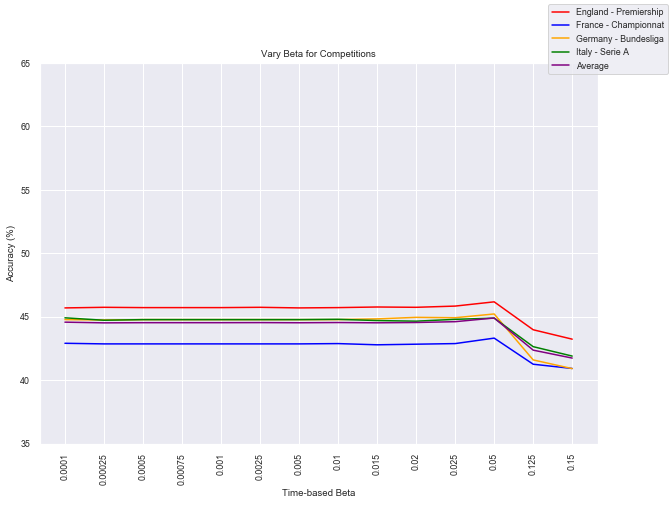

(([45.69377990430622,
   45.74162679425837,
   45.717703349282296,
   45.717703349282296,
   45.717703349282296,
   45.74162679425837,
   45.69377990430622,
   45.717703349282296,
   45.76555023923445,
   45.74162679425837,
   45.83732057416268,
   46.172248803827756,
   43.97129186602871,
   43.229665071770334],
  [42.90500119645848,
   42.857142857142854,
   42.857142857142854,
   42.857142857142854,
   42.857142857142854,
   42.857142857142854,
   42.857142857142854,
   42.88107202680067,
   42.78535534816942,
   42.83321368748504,
   42.88107202680067,
   43.3117970806413,
   41.25388849006939,
   40.91888011486001],
  [44.771241830065364,
   44.741532976827095,
   44.771241830065364,
   44.771241830065364,
   44.771241830065364,
   44.771241830065364,
   44.771241830065364,
   44.771241830065364,
   44.83065953654189,
   44.94949494949495,
   44.919786096256686,
   45.21687462863934,
   41.592394533571,
   40.909090909090914],
  [44.91261671055782,
   44.72109169260234,
   44.7689

In [24]:
"""
Vary TrueSkill by beta depending on how much time has passed
"""

class TrueSkillWithDate(TrueSkill):
    
    def win_probability(team1, team2, a_last_match_date, b_last_match_date, match_date):
        def get_day_diff(last_game_date, match_date):
            def convert_date(date):
                try:
                    return datetime.strptime(date, "%d/%m/%y")
                except ValueError:
                    return datetime.strptime(date, "%d/%m/%Y")
            try:
                day_diff = 1 if last_game_date is None else (convert_date(match_date) - convert_date(last_game_date)).days
            except TypeError:
                day_diff = 1
                
            return 1 if day_diff == 0 else day_diff
                
        delta_mu = sum(r.mu for r in team1) - sum(r.mu for r in team2)
        sum_sigma = sum(r.sigma ** 2 for r in itertools.chain(team1, team2))
        size = len(team1) + len(team2)
        
        beta = round(trueskill.BETA * trueskill.BETA * get_day_diff(a_last_match_date, match_date) * get_day_diff(b_last_match_date, match_date), 2)
        
        denom = math.sqrt(size * beta + sum_sigma)
        ts = trueskill.global_env()
        return ts.cdf(delta_mu / denom)
    
    
beta_range = [0.0001, 0.00025, 0.0005, 0.00075, 0.001, 0.0025, 0.005, 0.01, 0.015, 0.02, 0.025, 0.05, 0.125, 0.15]
ts_stats = [TrueSkillStats(beta=beta) for beta in beta_range]
get_competition_accuracies_ts(ts_stats, beta_range, x_label="Time-based Beta", title="Vary Beta for Competitions", ts_class={"ALL": TrueSkillWithDate})

### Home Advantage

TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition England - Premiership | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 46.48%
Overall accuracy for France - Championnat is 43.48%
Overall accuracy for Germany - Bundesliga is 45.16%
Overall accuracy for Italy - Serie A is 45.63%
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Pro

TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 48.30%
Overall accuracy for France - Championnat is 44.80%
Overall accuracy for Germany - Bundesliga is 45.69%
Overall accuracy for Italy - Serie A is 46.54%
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition England - Premiership | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Si

TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 49.45%
Overall accuracy for France - Championnat is 45.78%
Overall accuracy for Germany - Bundesliga is 46.35%
Overall accuracy for Italy - Serie A is 47.93%
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition England - Premiership | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigm

TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 49.40%
Overall accuracy for France - Championnat is 46.23%
Overall accuracy for Germany - Bundesliga is 46.97%
Overall accuracy for Italy - Serie A is 49.15%
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition England - Premiership | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigm

Overall accuracy for England - Premiership is 49.55%
Overall accuracy for France - Championnat is 46.57%
Overall accuracy for Germany - Bundesliga is 47.36%
Overall accuracy for Italy - Serie A is 49.37%
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.375 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition England - Premiership | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.375 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.375 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.375 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 49.19%
Overall accuracy for France - Championnat is 46

TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.6 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition France - Championnat | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.6 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Germany - Bundesliga | got 11 matches
TrueSkill Class Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.6 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
Processing competition Italy - Serie A | got 11 matches
Overall accuracy for England - Premiership is 46.20%
Overall accuracy for France - Championnat is 45.03%
Overall accuracy for Germany - Bundesliga is 45.60%
Overall accuracy for Italy - Serie A is 46.13%
Max Average is 0.3 with value 48.66099071207431 (index 34)
Max England is 0.21 with value 55.00000000000001 (index 25)
Max France is 0.325 with value 47.368421052631575 (index 35)
Max Germany is 0.35 with value 45.42483660130719 (index 36)
Max Italy is 0.28 with value 50.0 (index 3

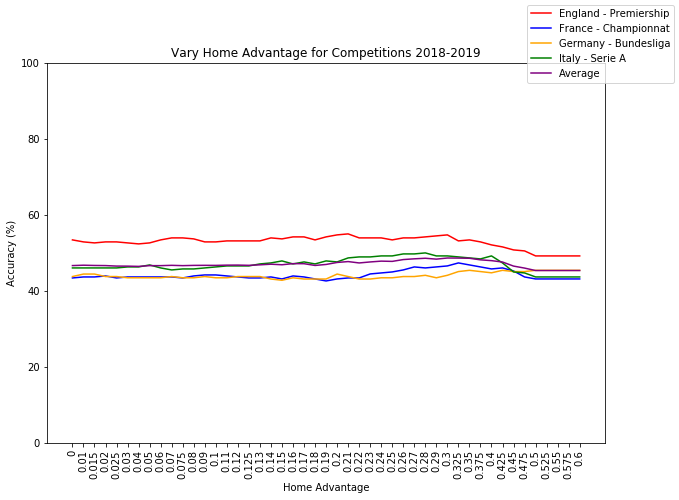

Max Average is 0.325 with value 48.282811611737536 (index 35)
Max England is 0.325 with value 49.3421052631579 (index 35)
Max France is 0.375 with value 47.03798083599501 (index 37)
Max Germany is 0.27 with value 47.87581699346405 (index 31)
Max Italy is 0.29 with value 49.906885360572346 (index 33)


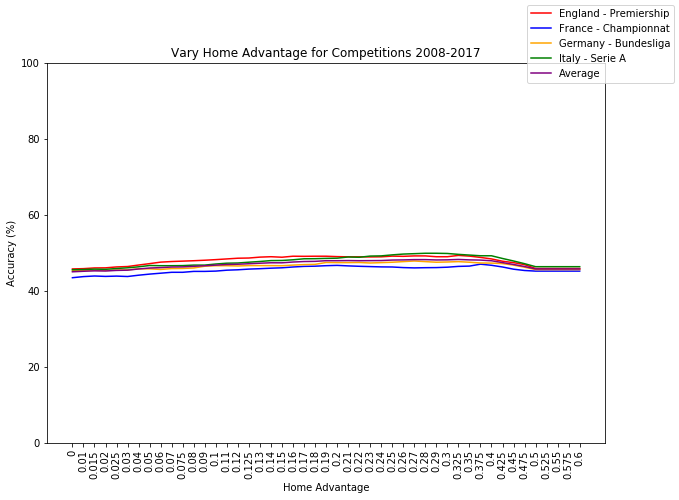

Max Average is 0.325 with value 48.315769017620624 (index 35)
Max England is 0.325 with value 49.688995215311 (index 35)
Max France is 0.375 with value 46.97296003828667 (index 37)
Max Germany is 0.27 with value 47.504456327985736 (index 31)
Max Italy is 0.28 with value 49.91620780464448 (index 32)


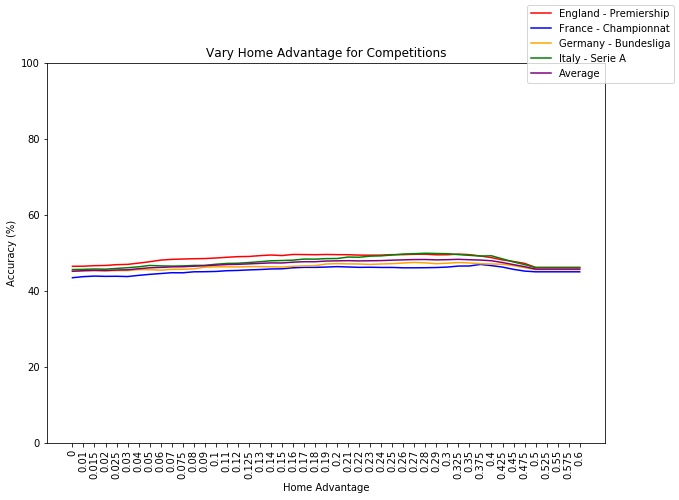

(([46.483253588516746,
   46.50717703349282,
   46.65071770334928,
   46.698564593301434,
   46.91387559808612,
   46.985645933014354,
   47.32057416267942,
   47.67942583732057,
   48.110047846889955,
   48.30143540669856,
   48.397129186602875,
   48.4688995215311,
   48.516746411483254,
   48.66028708133972,
   48.85167464114832,
   49.01913875598086,
   49.066985645933016,
   49.282296650717704,
   49.44976076555024,
   49.30622009569378,
   49.5933014354067,
   49.569377990430624,
   49.52153110047847,
   49.5933014354067,
   49.54545454545455,
   49.52153110047847,
   49.42583732057416,
   49.40191387559808,
   49.42583732057416,
   49.54545454545455,
   49.54545454545455,
   49.641148325358856,
   49.665071770334926,
   49.49760765550239,
   49.52153110047847,
   49.688995215311,
   49.54545454545455,
   49.186602870813395,
   48.75598086124402,
   48.1578947368421,
   47.751196172248804,
   47.248803827751196,
   46.196172248803826,
   46.196172248803826,
   46.196172248803826,

In [53]:
"""
Vary Home Advantage for TrueSkill
"""
home_advantages = [0, 0.01, 0.015, 0.02, 0.025, 0.03, 0.04, 0.05, 0.06, 0.07, 0.075, 0.08, 0.09, 0.1, 
                   0.11, 0.12, 0.125, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 
                   0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.325, 0.35, 0.375, 0.4, 0.425, 0.45, 0.475,
                   0.5, 0.525, 0.55, 0.575, 0.6]
ts_stats = [{"ALL": TrueSkillStats(min_games=10, 
                                   beta=0.07, 
                                   home_advantage=home_advantage)} for home_advantage in home_advantages]
get_competition_accuracies_ts(ts_stats, 
                              home_advantages, 
                              x_label="Home Advantage", 
                              title="Vary Home Advantage for Competitions", 
                              verbose=True)

Best TrueSkill Home Advantage


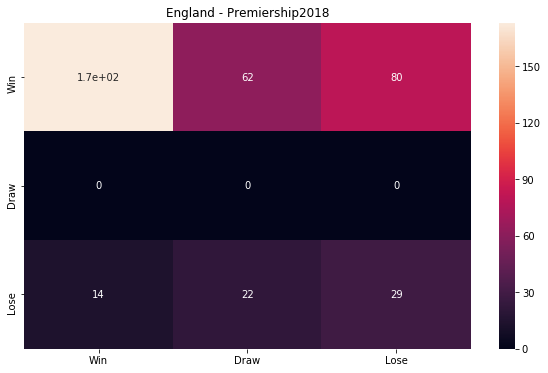

Accuracy: 53.16%
MAE: 0.26
RMSE: 0.30
Precision: 	Win 0.55 	Draw 0.00 	Lose 0.45 
Recall: 	Win 0.93 	Draw 0.00 	Lose 0.27 
F1: 	Win 0.69 	Draw 0.00 	Lose 0.33 


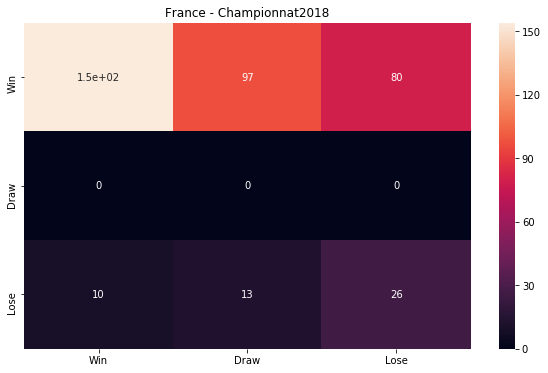

Accuracy: 47.37%
MAE: 0.24
RMSE: 0.27
Precision: 	Win 0.47 	Draw 0.00 	Lose 0.53 
Recall: 	Win 0.94 	Draw 0.00 	Lose 0.25 
F1: 	Win 0.62 	Draw 0.00 	Lose 0.34 


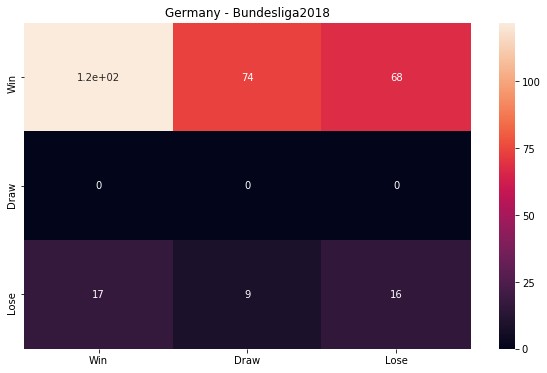

Accuracy: 45.10%
MAE: 0.25
RMSE: 0.29
Precision: 	Win 0.46 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.88 	Draw 0.00 	Lose 0.19 
F1: 	Win 0.61 	Draw 0.00 	Lose 0.25 


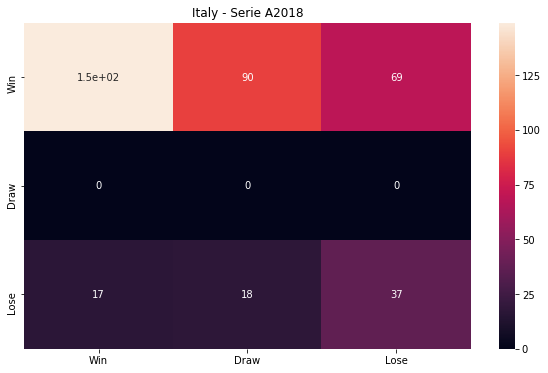

Accuracy: 48.95%
MAE: 0.26
RMSE: 0.29
Precision: 	Win 0.48 	Draw 0.00 	Lose 0.51 
Recall: 	Win 0.90 	Draw 0.00 	Lose 0.35 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.42 


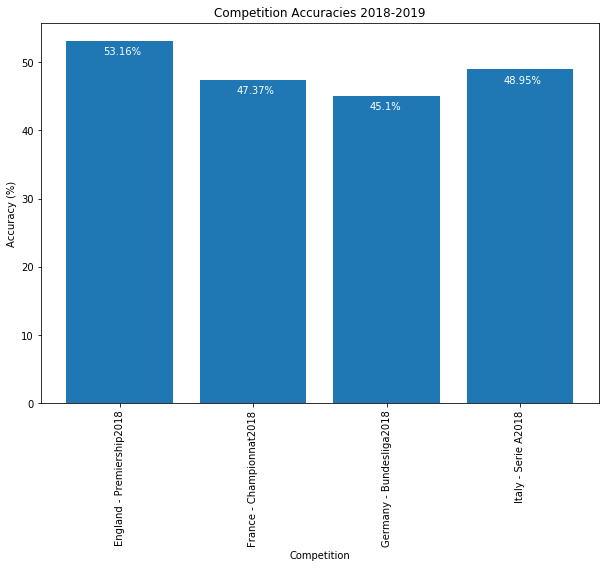

In [27]:
"""
Best TrueSkill Home Advantage
"""
print("Best TrueSkill Home Advantage")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_ts_training(TrueSkillStats(beta=0.07,
                                                                                                    home_advantage=0.325))

#get_accuracies(comp_pred, "Home Advantage TrueSkill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)
get_accuracies(comp_year_pred, "Home Advantage TrueSKill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)

### Tau

TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Adva

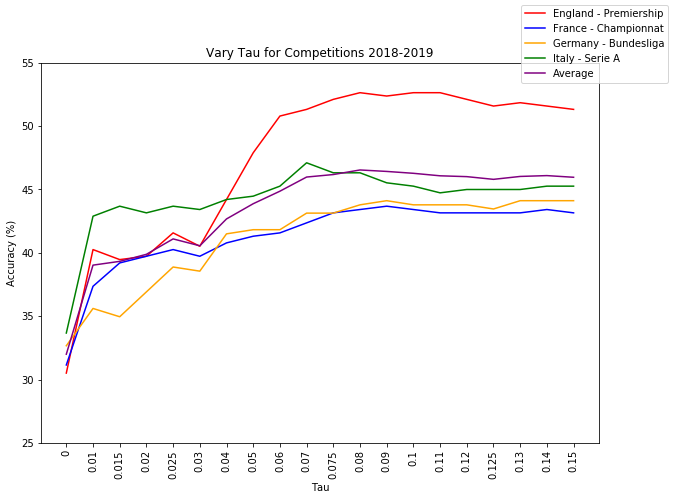

Max average is 0.09 with value 44.9840934012822 (index 12)


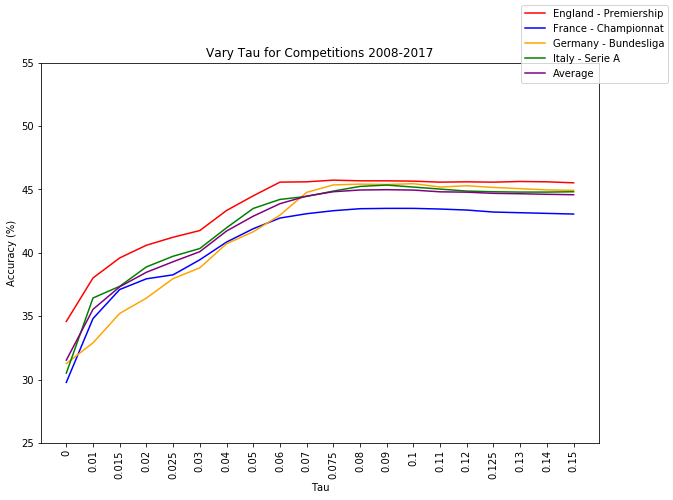

Max average is 0.09 with value 45.11570164989692 (index 12)


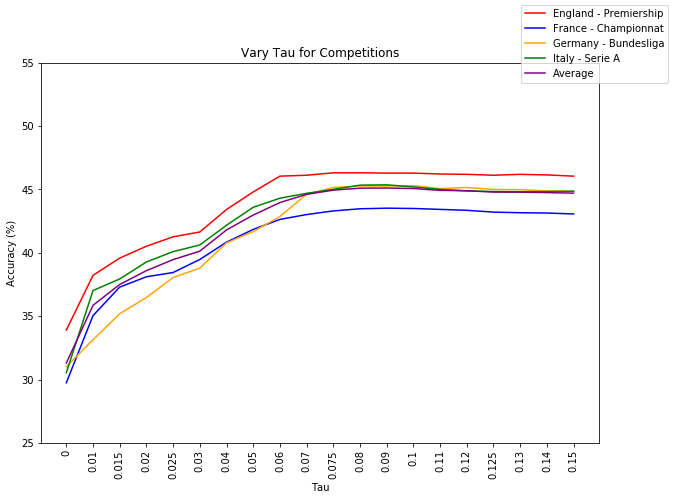

(([33.91482811698307,
   38.229665071770334,
   39.593301435406694,
   40.526315789473685,
   41.26794258373206,
   41.65071770334928,
   43.42105263157895,
   44.80861244019139,
   46.05263157894737,
   46.124401913875595,
   46.31578947368421,
   46.31578947368421,
   46.291866028708135,
   46.291866028708135,
   46.2200956937799,
   46.196172248803826,
   46.124401913875595,
   46.196172248803826,
   46.14832535885168,
   46.05263157894737],
  [29.76037103839217,
   35.05623354869586,
   37.30557549653027,
   38.11916726489591,
   38.454175640105284,
   39.48312993539124,
   40.84709260588657,
   41.85211773151472,
   42.64178033022254,
   43.024647044747546,
   43.3117970806413,
   43.47930126824599,
   43.527159607561615,
   43.50323043790381,
   43.431442928930366,
   43.35965541995693,
   43.21608040201005,
   43.168222062694426,
   43.144292893036614,
   43.07250538406318],
  [31.03007037747921,
   33.155080213903744,
   35.20499108734403,
   36.48247177658943,
   38.0570409982

In [32]:
"""
Vary Tau for TrueSkill
"""
taus = [0, 0.01, 0.015, 0.02, 0.025, 0.03, 0.04, 
        0.05, 0.06, 0.07, 0.075, 0.08, 0.09, 0.1, 
        0.11, 0.12, 0.125, 0.13, 0.14, 0.15]
ts_stats = [TrueSkillStats(min_games=10, beta=0.07, home_advantage=0, tau=tau) for tau in taus]
get_competition_accuracies_ts(ts_stats, home_advantages, x_label="Tau", title="Vary Tau for Competitions")

### Mu and Sigma

TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 10 | Sigma 3.3333333333333335
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 15 | Sigma 5.0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 20 | Sigma 6.666666666666667
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25 | Sigma 8.333333333333334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 30 | Sigma 10.0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 35 | Sigma 11.666666666666666
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 40 | Sigma 13.333333333333334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 45 | Sigma 15.0
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0 | Tau

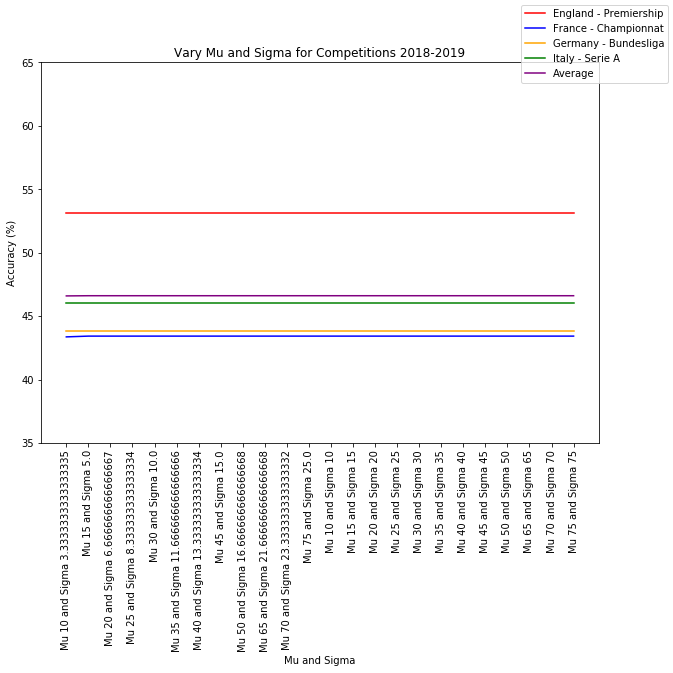

Max average is Mu 20 and Sigma 6.666666666666667 with value 45.01191320083713 (index 2)


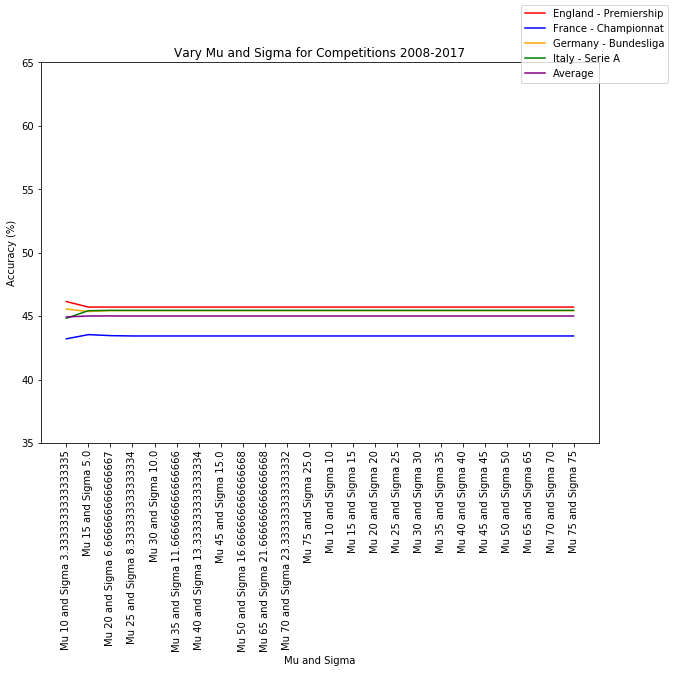

Max average is Mu 20 and Sigma 6.666666666666667 with value 45.157589158496286 (index 2)


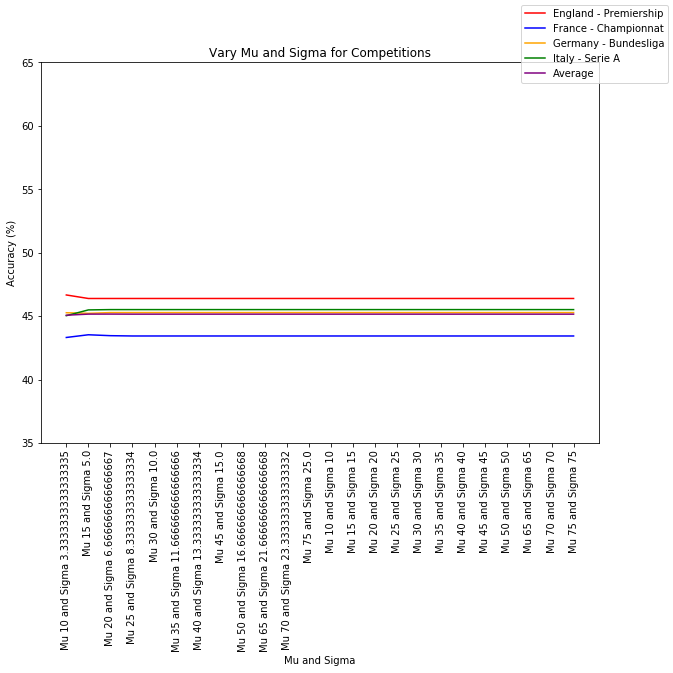

(([46.66495638789122,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244,
   46.38755980861244],
  [43.313578974491115,
   43.527159607561615,
   43.45537209858818,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442928930366,
   43.431442

In [46]:
"""
Vary Mu and Sigma for TrueSkill
"""
mus = [10, 15, 20, 25, 30, 35, 40, 45, 50, 65, 70, 75]
labels = ["Mu " + str(mu) + " and Sigma " + str(mu/3) for mu in mus]
ts_stats = [TrueSkillStats(min_games=10, beta=0.07, home_advantage=0, mu=mu, sigma=mu/3) for mu in mus]
labels.extend(["Mu " + str(mu) + " and Sigma " + str(mu) for mu in mus])
ts_stats.extend([TrueSkillStats(min_games=1, beta=0.07, home_advantage=0, mu=mu, sigma=mu) for mu in mus])

get_competition_accuracies_ts(ts_stats, labels, x_label="Mu and Sigma", title="Vary Mu and Sigma for Competitions")

TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.01 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 |

TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.08 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.03 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334

TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.08 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.12 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.13 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.05 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334

TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.12 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.13 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.17 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.18 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.07 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334

TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.17 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.18 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.22 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.09 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 

TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.22 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.11 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 

TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 |

TrueSkill Stats: Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.16 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.16 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.16 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.16 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu

TrueSkill Stats: Min Games 10 | Beta 0.17 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.18 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | M

TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.08 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.2 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.

TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.08 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.12 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.13 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.4 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.13 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.17 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.18 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.6 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.18 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.22 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 0.8 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.0 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 1.2 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.2 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.2 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.2 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.2 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.3 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.3 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.3 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.3 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu 25.0 | S

TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.5 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 

TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.05 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.06 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.07 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.075 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.08 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.7 | Draw 0.1 | Home Advantage 0.12 | Tau 0.08334 | Mu 25.

TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.09 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.1 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.11 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.12 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.13 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 1.9 | Draw 0.1 | Home Advantage 0.17 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.14 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.15 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.16 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.17 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.18 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.1 | Draw 0.1 | Home Advantage 0.22 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.19 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.2 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.21 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.22 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.23 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.3 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0

TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.24 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.25 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.5 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 | Mu 25.0 

TrueSkill Stats: Min Games 10 | Beta 2.7 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.7 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.7 | Draw 0.1 | Home Advantage 0.35 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.7 | Draw 0.1 | Home Advantage 0.4 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.8 | Draw 0.1 | Home Advantage 0 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.8 | Draw 0.1 | Home Advantage 0.01 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.8 | Draw 0.1 | Home Advantage 0.02 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.8 | Draw 0.1 | Home Advantage 0.03 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Stats: Min Games 10 | Beta 2.8 | Draw 0.1 | Home Advantage 0.04 | Tau 0.08334 | Mu 25.0 | S

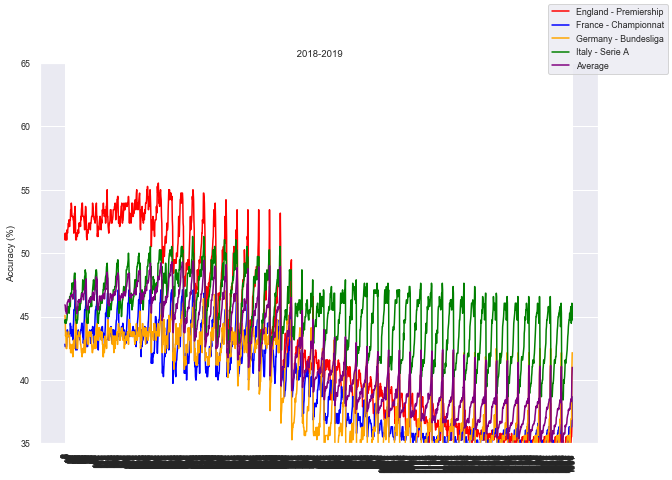

Max Average is 366 with value 48.711691434122756 (index 366)
Max England is 438 with value 50.13157894736842 (index 438)
Max France is 507 with value 47.19622274684072 (index 507)
Max Germany is 365 with value 48.13725490196079 (index 365)
Max Italy is 367 with value 50.407650612899886 (index 367)


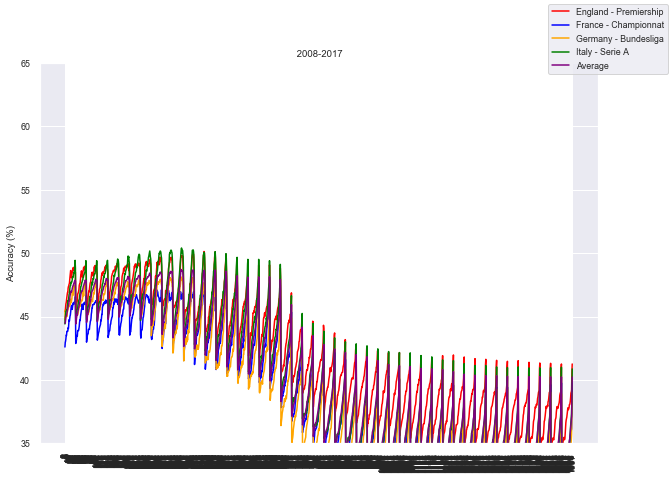

Max Average is 404 with value 48.74344175117122 (index 404)
Max England is 438 with value 50.526315789473685 (index 438)
Max France is 507 with value 47.09260588657573 (index 507)
Max Germany is 365 with value 47.83125371360665 (index 365)
Max Italy is 367 with value 50.41896097677759 (index 367)


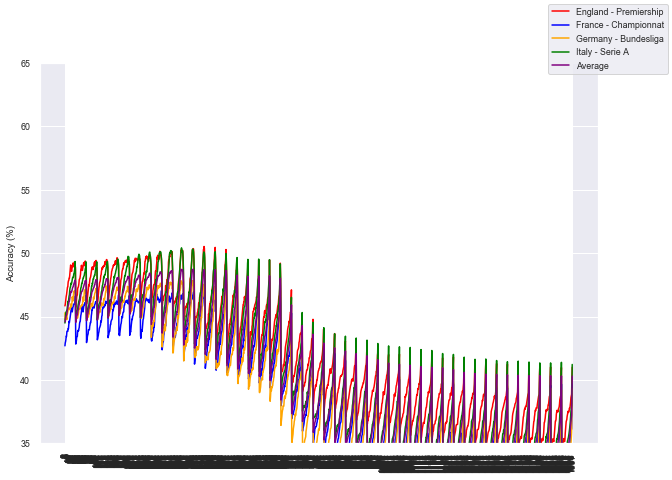

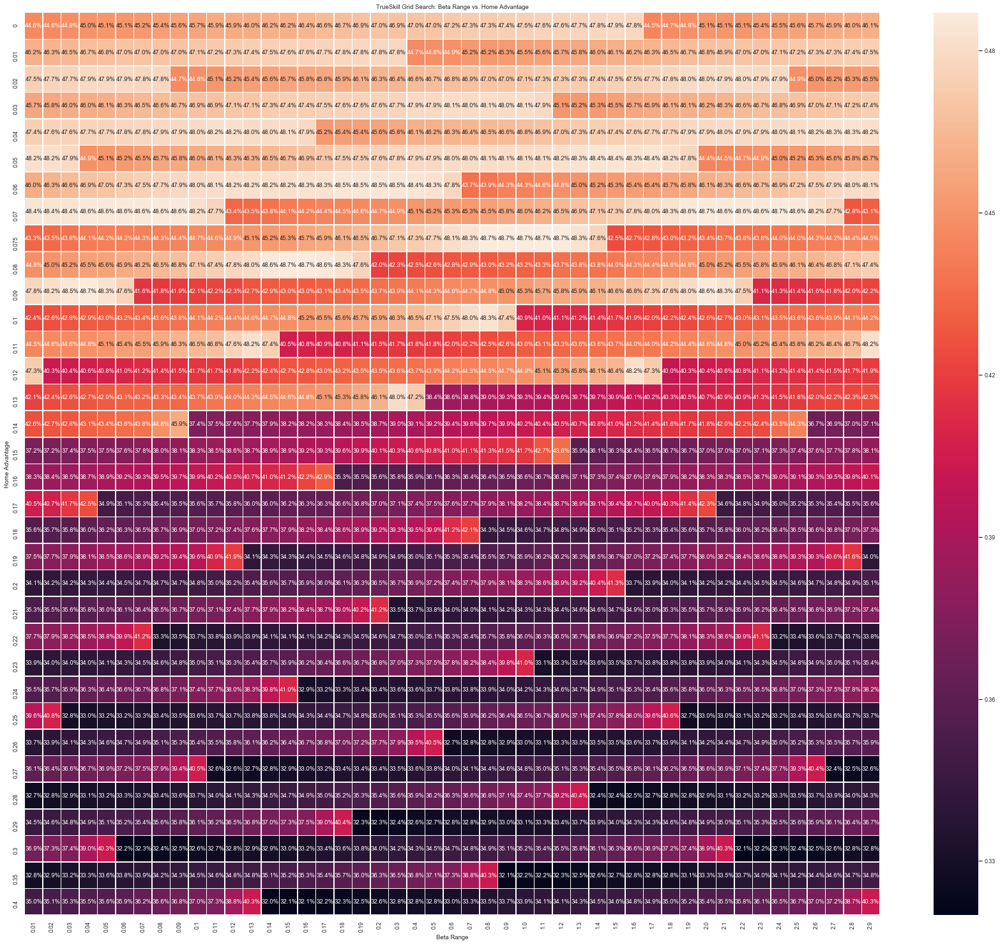

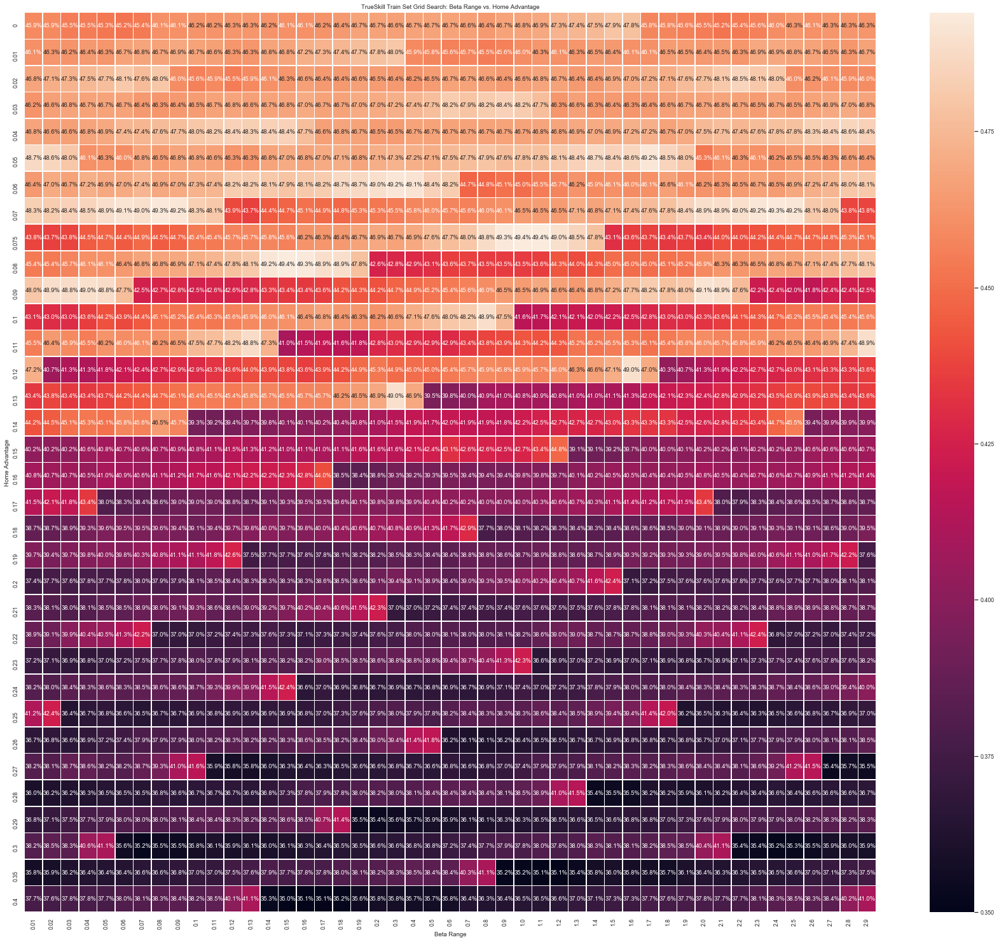

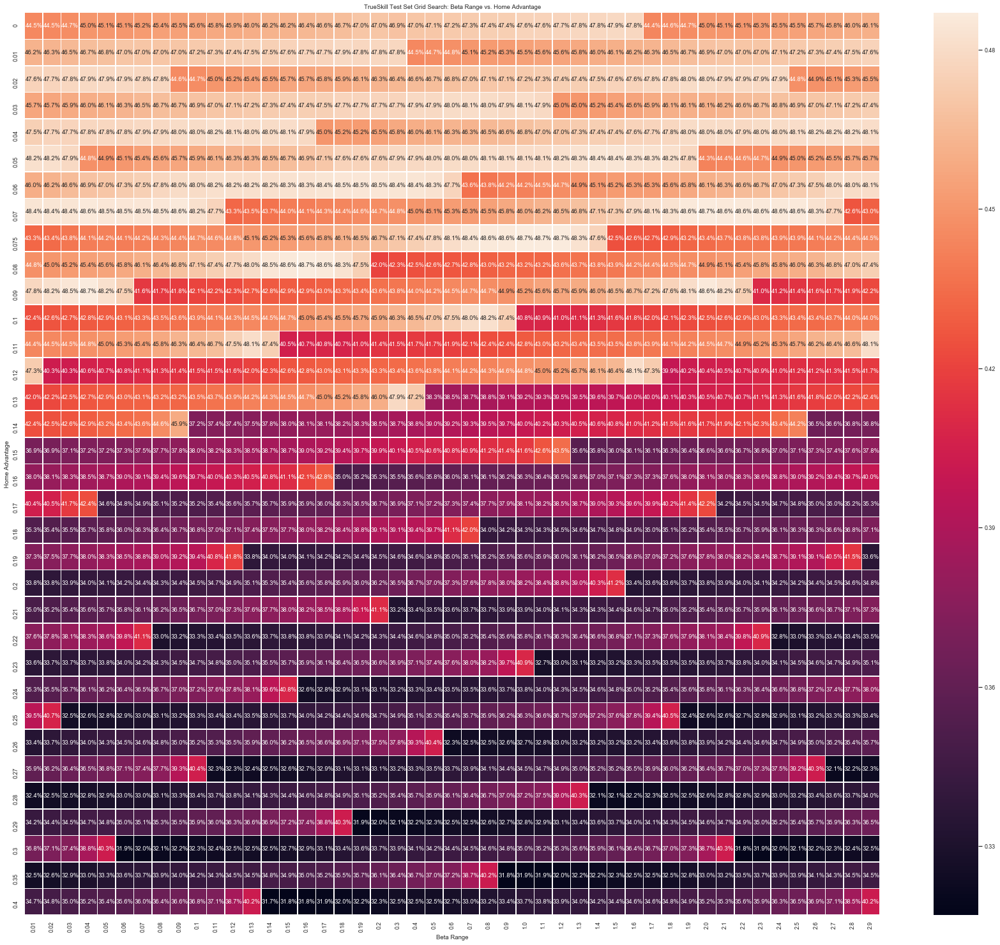

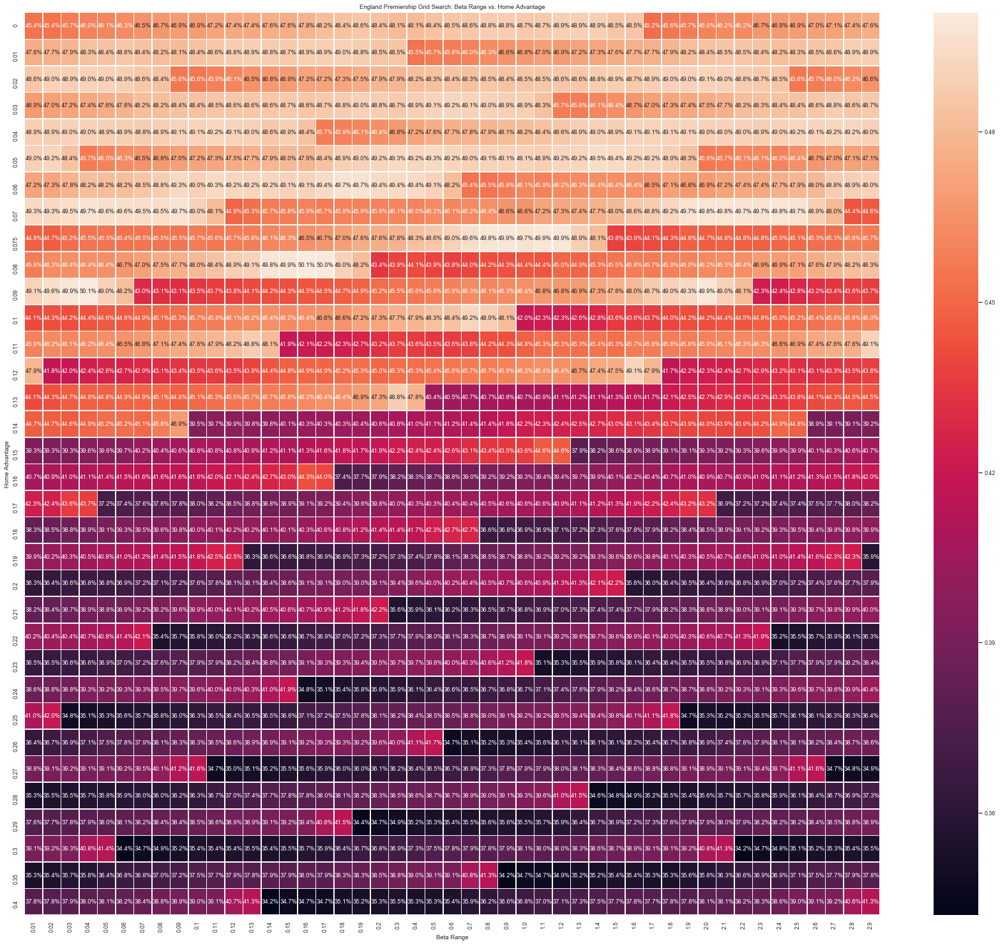

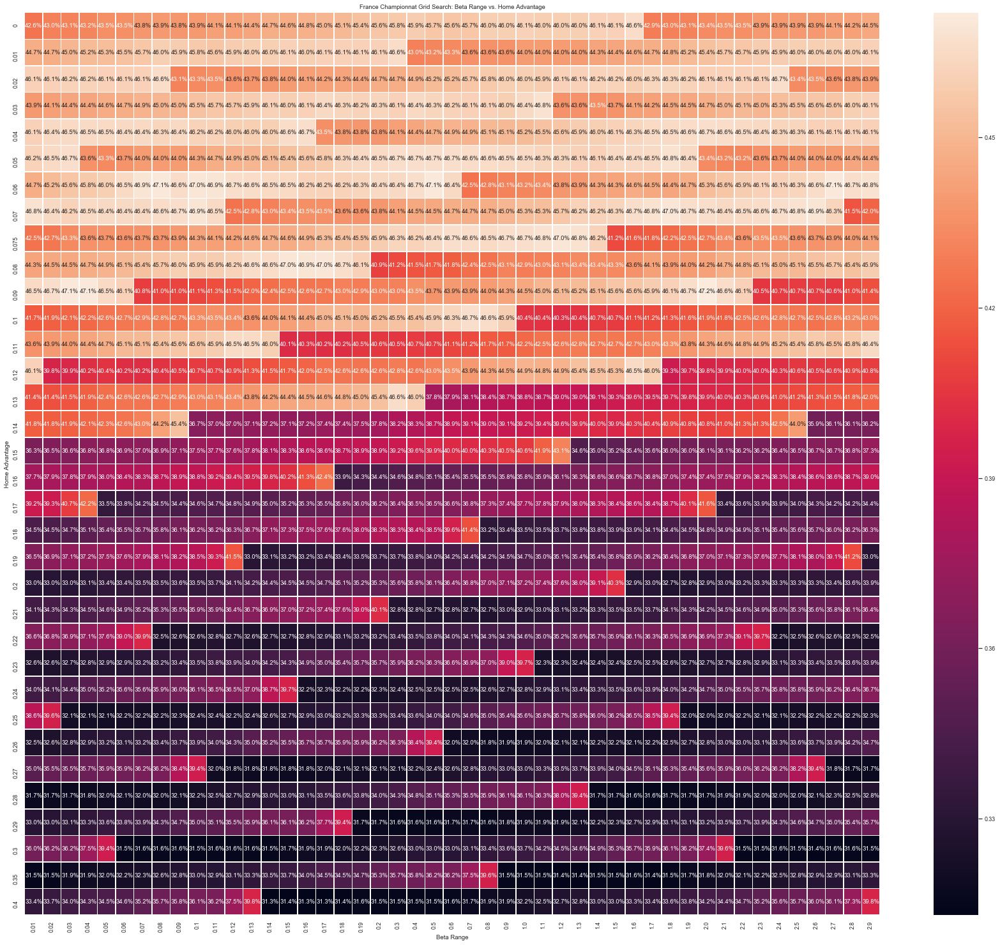

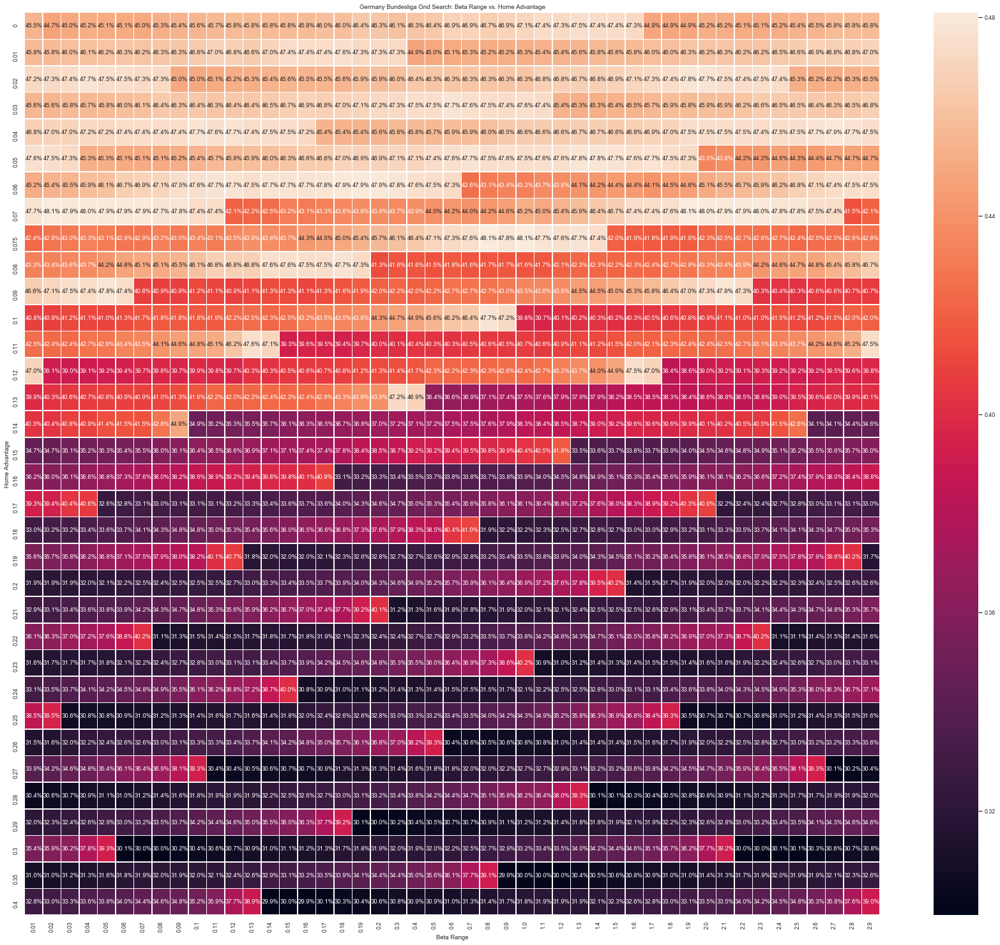

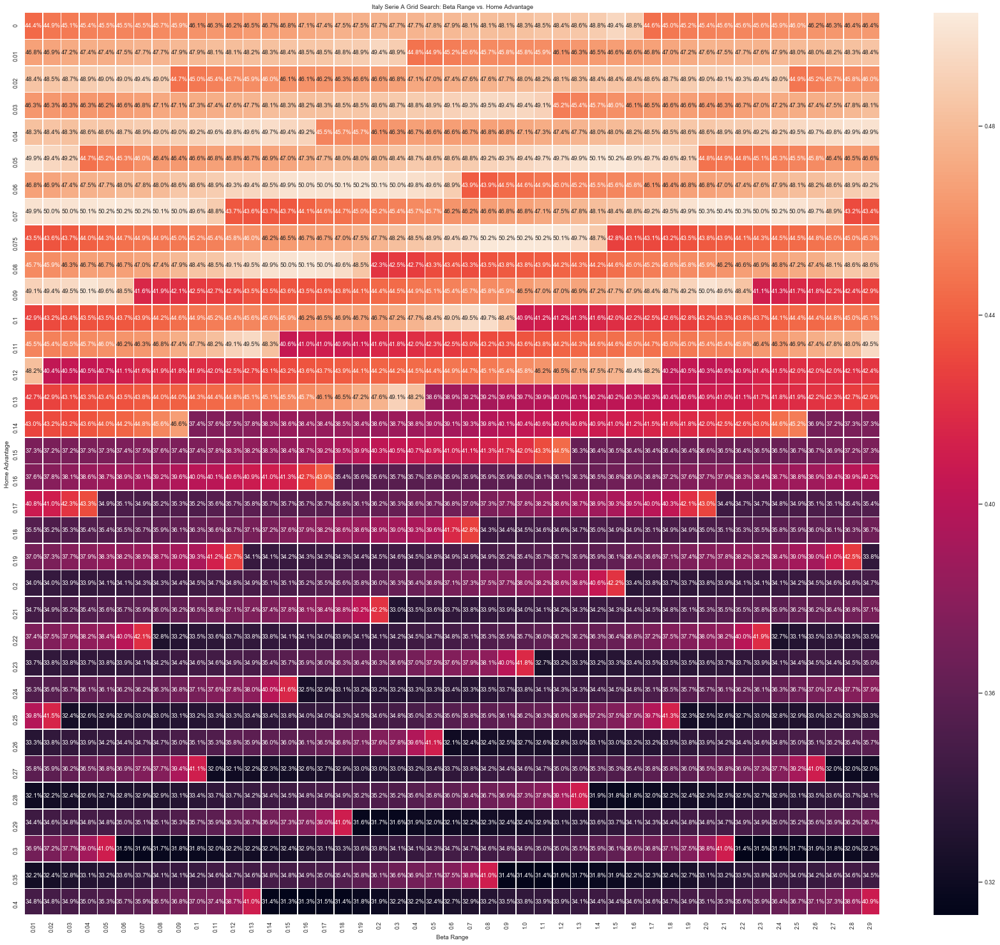

In [37]:
"""
Vary Home Advantage and BETA
"""
beta_range = [x / 100.0 for x in range(1, 20)]
beta_range.extend([x / 10.0 for x in range(2, 30)])
home_advantages = [0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.075, 0.08, 0.09, 0.1, 
                   0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 
                   0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.35, 0.4]
ts_stats = []
for beta in beta_range:
    for home_advantage in home_advantages:
        ts_stats.append(TrueSkillStats(beta=beta, home_advantage=home_advantage))
accuracies = get_competition_accuracies_ts(ts_stats, range(len(ts_stats)))
plot_stats(beta_range, 
           home_advantages, 
           accuracies[0], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="TrueSkill Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)
plot_stats(beta_range, 
           home_advantages, 
           accuracies[1], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="TrueSkill Train Set Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)
plot_stats(beta_range, 
           home_advantages, 
           accuracies[2], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="TrueSkill Test Set Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)

plot_stats(beta_range, 
           home_advantages, 
           accuracies[2][0], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="England Premiership Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)
plot_stats(beta_range, 
           home_advantages, 
           accuracies[2][1], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="France Championnat Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)
plot_stats(beta_range, 
           home_advantages, 
           accuracies[2][2], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="Germany Bundesliga Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)
plot_stats(beta_range, 
           home_advantages, 
           accuracies[2][3], 
           x_label="Beta Range", 
           y_label="Home Advantage", 
           title="Italy Serie A Grid Search: Beta Range vs. Home Advantage", 
           x_ticks=beta_range,
           y_ticks=home_advantages,
           figsize=(30, 26),
           round_to=1)

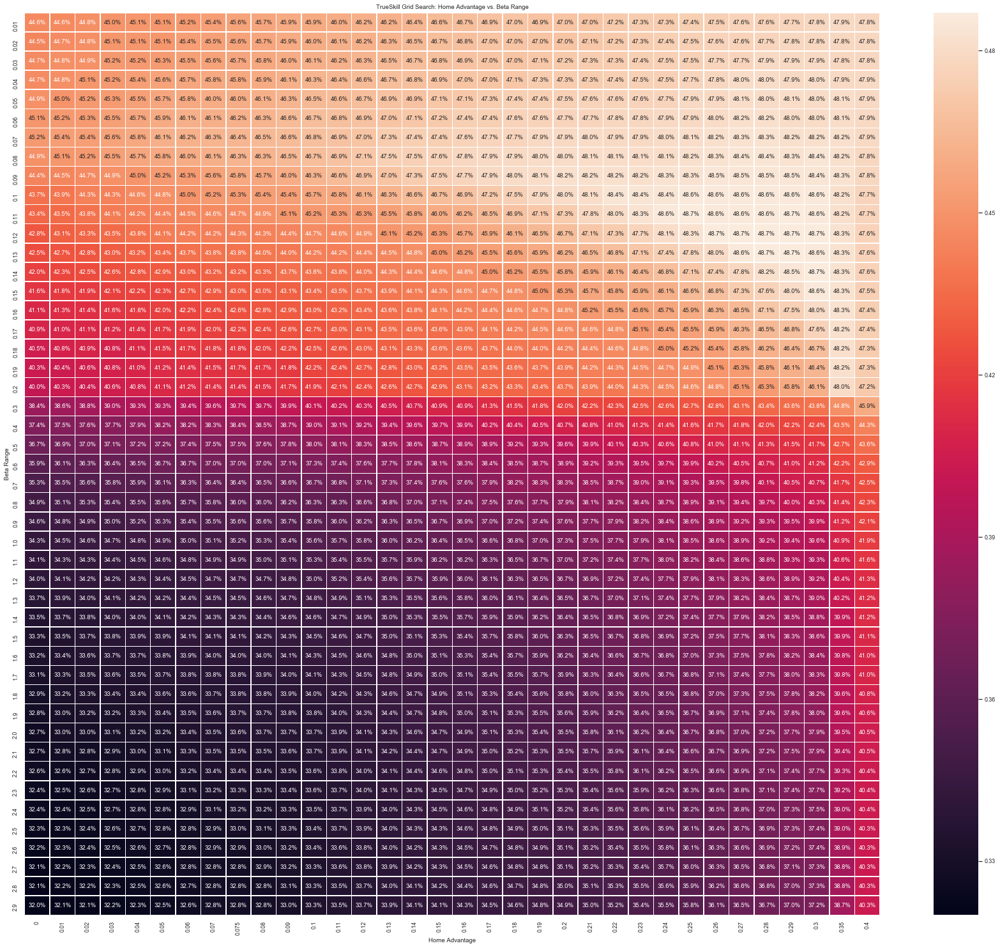

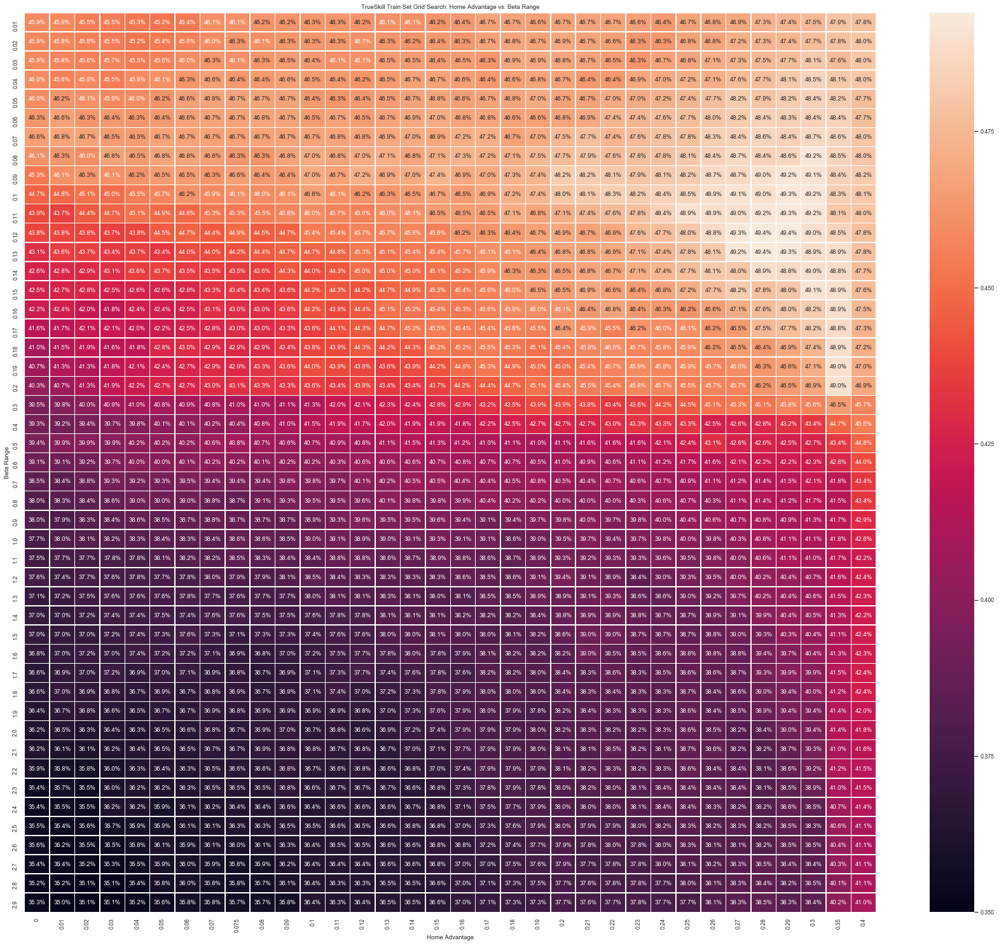

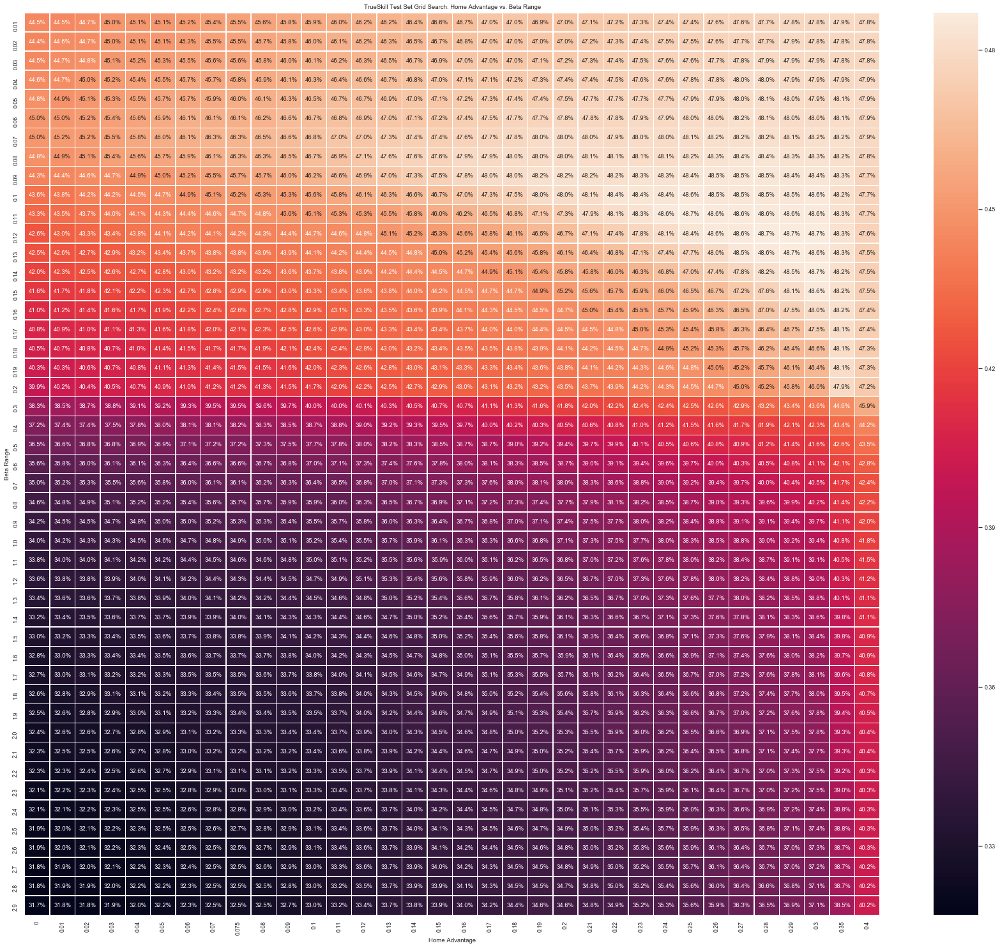

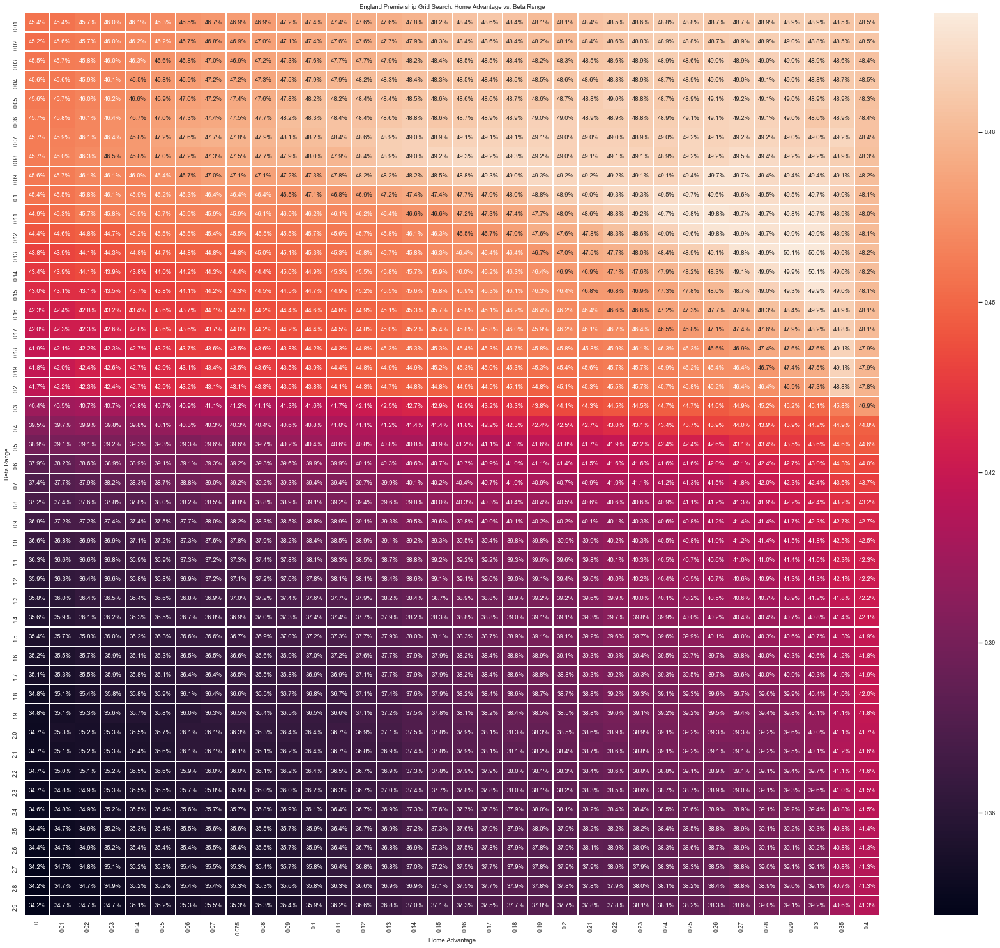

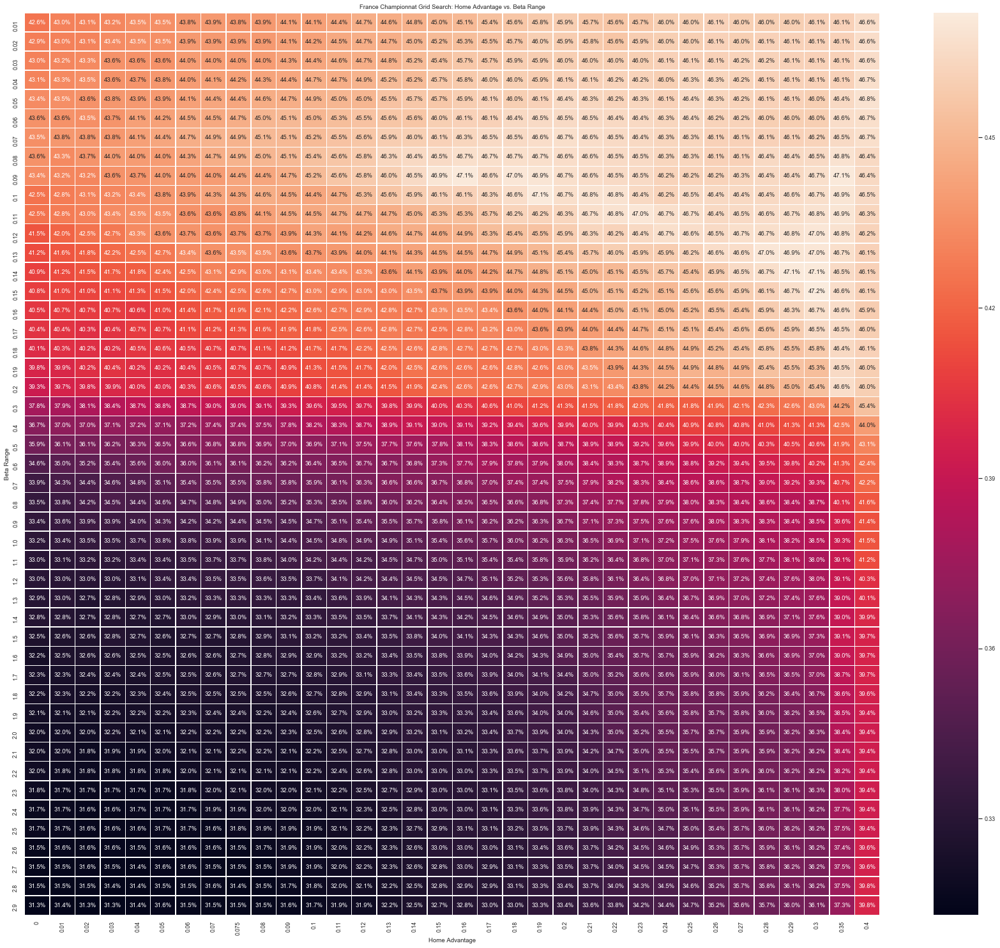

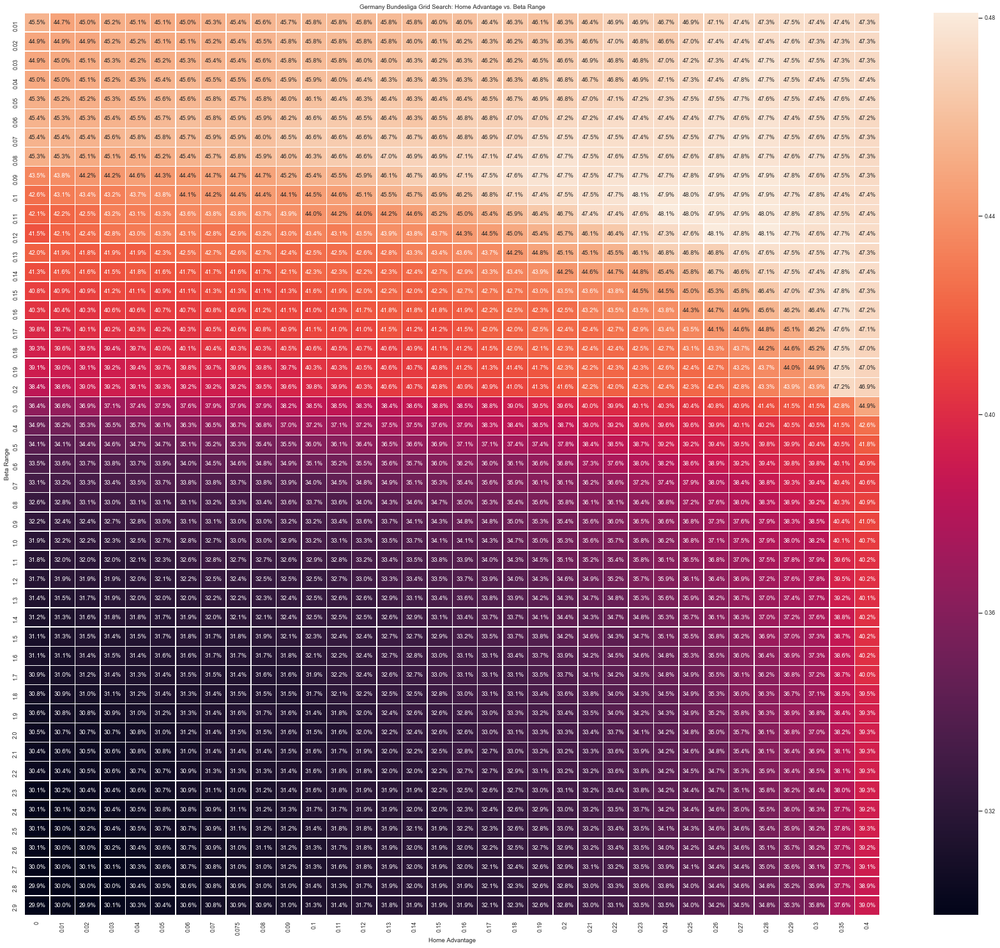

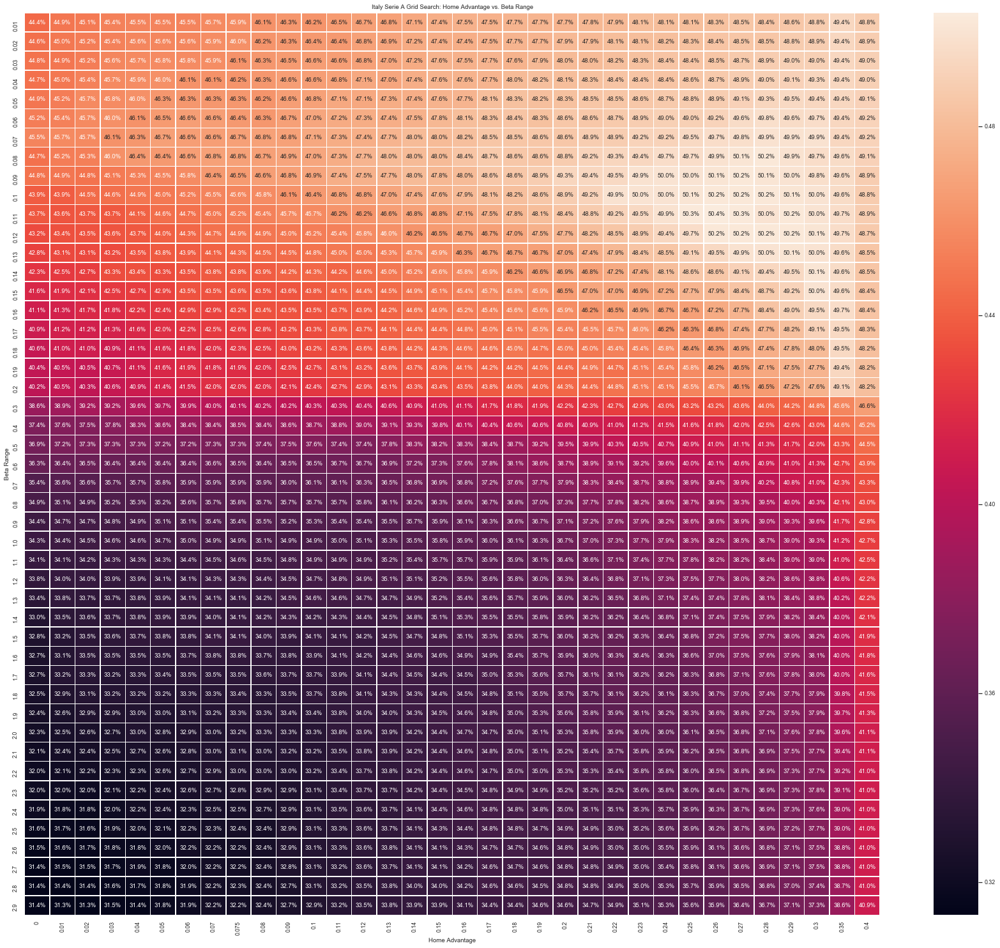

In [39]:
plot_stats(home_advantages, 
           beta_range, 
           accuracies[0], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="TrueSkill Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)
plot_stats(home_advantages, 
           beta_range, 
           accuracies[1], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="TrueSkill Train Set Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)
plot_stats(home_advantages, 
           beta_range, 
           accuracies[2], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="TrueSkill Test Set Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)

plot_stats(home_advantages, 
           beta_range, 
           accuracies[2][0], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="England Premiership Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)
plot_stats(home_advantages, 
           beta_range, 
           accuracies[2][1], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="France Championnat Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)
plot_stats(home_advantages, 
           beta_range, 
           accuracies[2][2], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="Germany Bundesliga Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)
plot_stats(home_advantages, 
           beta_range, 
           accuracies[2][3], 
           x_label="Home Advantage", 
           y_label="Beta Range", 
           title="Italy Serie A Grid Search: Home Advantage vs. Beta Range", 
           x_ticks=home_advantages,
           y_ticks=beta_range,
           figsize=(30, 26),
           round_to=1)

## Best Average TrueSkill

Best TrueSkill Average
TrueSkill Class Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.13 | Draw 0.1 | Home Advantage 0.28 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334


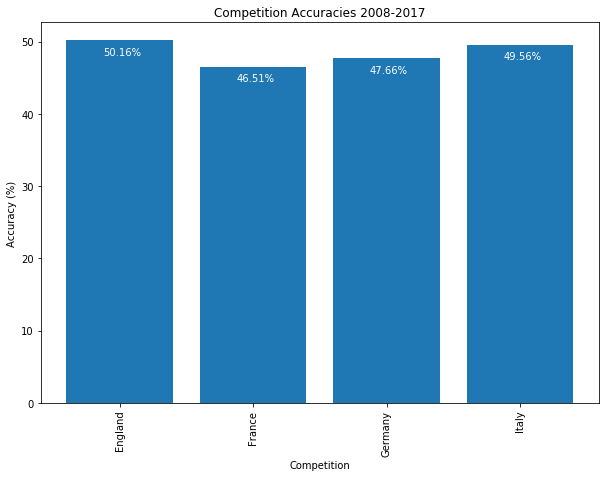

In [17]:
"""
Best Average TrueSkill
"""
print("Best TrueSkill Average")
comp_pred, bookie_comp_pred, \
comp_year_pred, bookie_comp_year_pred = run_ts_training({"ALL": TrueSkillStats(beta=0.13,
                                                                               home_advantage=0.28)})

get_accuracies(comp_pred, "Home Advantage TrueSkill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(comp_year_pred, "Home Advantage TrueSKill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)

## Best per-competition TrueSkill

Per-competition TrueSkill
TrueSkill Class Min Games 10 | Beta 0.14 | Draw 0.1 | Home Advantage 0.29 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.15 | Draw 0.1 | Home Advantage 0.3 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.12 | Draw 0.1 | Home Advantage 0.26 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334
TrueSkill Class Min Games 10 | Beta 0.12 | Draw 0.1 | Home Advantage 0.27 | Tau 0.08334 | Mu 25.0 | Sigma 8.3334


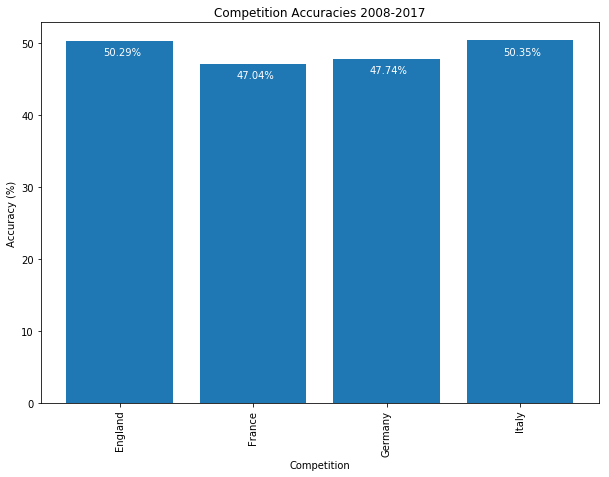

In [18]:
ts_stats = {"England - Premiership": TrueSkillStats(beta=0.14,
                                                    home_advantage=0.29),
            "France - Championnat": TrueSkillStats(beta=0.15,
                                                   home_advantage=0.3),
            "Germany - Bundesliga": TrueSkillStats(beta=0.12,
                                                   home_advantage=0.26),
            "Italy - Serie A": TrueSkillStats(beta=0.12,
                                              home_advantage=0.27)}

print("Per-competition TrueSkill")
comp_pred, bookie_comp_pred, comp_year_pred, bookie_comp_year_pred = run_ts_training(ts_stats)

get_accuracies(comp_pred, "Home Advantage TrueSkill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(comp_year_pred, "Home Advantage TrueSKill", plot_cf=True, plot_accuracies=True, debug=False)
#get_accuracies(bookie_comp_year_pred, "Bet365", plot_cf=True, plot_accuracies=True, debug=False)

# Neural Networks
## First, we start by formatting the data

In [3]:
class Team(object):
    
    def __init__(self):
        self.games_played = 0
        
        # Total Goals Scored/Conceded home away
        self.total_g_home = 0
        self.total_c_home = 0
        self.total_g_away = 0
        self.total_c_away = 0
        # Averages values above
        self.avg_g_home = 0
        self.avg_c_home = 0
        self.avg_g_away = 0
        self.avg_c_away = 0
        
        # Total games won, lost and drawn home/away
        self.won_home = 0
        self.draw_home = 0
        self.lost_home = 0
        self.won_away = 0
        self.draw_away = 0
        self.lost_away = 0
        # Averages values above
        self.avg_won_home = 0
        self.avg_won_away = 0
        self.avg_drawn_home = 0
        self.avg_drawn_away = 0
        self.avg_lost_home = 0
        self.avg_lost_away = 0
        
        # Results of past matches
        self.won_home_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        self.won_away_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        self.drawn_home_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        self.drawn_away_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        self.lose_home_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        self.lose_away_arr = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
        # Sums 1s in the above lists
        self.won_home_10 = 0
        self.won_away_10 = 0
        self.drawn_home_10 = 0
        self.drawn_away_10 = 0
        self.lost_home_10 = 0
        self.lost_away_10 = 0
        self.won_home_20 = 0
        self.won_away_20 = 0
        self.drawn_home_20 = 0
        self.drawn_away_20 = 0
        self.lost_home_20 = 0
        self.lost_away_20 = 0
        
        # { team_name : [[result], [result], [result], [result], [result]]  }
        self.team_history = {}
        
    def played_home(self, scored, conceded, away_team):
        self.games_played += 1
        
        if away_team not in self.team_history:
            self.team_history = [[0, 0, 0], 
                                 [0, 0, 0], 
                                 [0, 0, 0], 
                                 [0, 0, 0], 
                                 [0, 0, 0]]
        
        if scored > conceded:
            self.won_home += 1
            self.won_home_arr.insert(1, 0)
            self.drawn_home_arr.insert(0, 0)
            self.lose_home_arr.insert(0, 0)
            
            self.team_history[away_team].insert(0, [1, 0, 0])
        elif scored < conceded:
            self.lost_home += 1
            self.lose_home_arr.insert(1, 0)
            self.won_home_arr.insert(0, 0)
            self.drawn_home_arr.insert(0, 0)
            
            self.team_history[away_team].insert(0, [0, 0, 1])
        else:
            self.draw_home += 1
            self.drawn_home_arr.insert(1, 0)
            self.won_home_arr.insert(0, 0)
            self.lose_home_arr.insert(0, 0)
            
            self.team_history[away_team].insert(0, [0, 1, 0])
            
        self.won_home_arr = self.won_home_arr[:20]
        self.drawn_home_arr = self.drawn_home_arr[:20]
        self.lose_home_arr = self.lose_home_arr[:20]
        self.team_history[away_team] = self.team_history[away_team][:5]
            
        self.total_g_home += scored
        self.total_c_home += conceded
        self.update()
        
    def played_away(self, conceded, scored, home_team):
        self.games_played += 1
        
        if home_team not in self.team_history:
            self.team_history[home_team] = [[0, 0, 0], 
                                            [0, 0, 0], 
                                            [0, 0, 0], 
                                            [0, 0, 0], 
                                            [0, 0, 0]]
        
        if scored > conceded:
            self.won_away += 1
            self.won_away_arr.insert(0, 1)
            self.drawn_away_arr.insert(0, 0)
            self.lose_away_arr.insert(0, 0)
            
            self.team_history[home_team].insert(0, [1, 0, 0])
        elif scored < conceded:
            self.lost_away += 1
            self.lose_away_arr.insert(0, 1)
            self.won_away_arr.insert(0, 0)
            self.drawn_away_arr.insert(0, 0)
            
            self.team_history[home_team].insert(0, [0, 0, 1])
        else:
            self.draw_away += 1
            self.drawn_away_arr.insert(0, 1)
            self.won_away_arr.insert(0, 0)
            self.lose_away_arr.insert(0, 0)
            
            self.team_history[home_team].insert(0, [0, 1, 0])
            
        self.won_away_arr = self.won_away_arr[:20]
        self.drawn_away_arr = self.drawn_away_arr[:20]
        self.lose_away_arr = self.lose_away_arr[:20]
        self.team_history[home_team] = self.team_history[home_team][:5]
        
        self.total_g_away += scored
        self.total_c_away += conceded
        self.update()
        
    def update(self):
        self.avg_g_home = self.total_g_home / self.games_played
        self.avg_c_home = self.total_c_home / self.games_played
        self.avg_g_away = self.total_g_away / self.games_played
        self.avg_c_away = self.total_c_away / self.games_played
        
        self.avg_won_home = self.won_home / self.games_played
        self.avg_won_away = self.won_away / self.games_played
        self.avg_drawn_home = self.draw_home / self.games_played
        self.avg_drawn_away = self.draw_away / self.games_played
        self.avg_lost_home = self.lost_home / self.games_played
        self.avg_lost_away = self.lost_away / self.games_played
        
        self.won_home_20 = len([x for x in self.won_home_arr if x == 1])
        self.won_away_20 = len([x for x in self.won_away_arr if x == 1])
        self.drawn_home_20 = len([x for x in self.drawn_home_arr if x == 1])
        self.drawn_away_20 = len([x for x in self.drawn_away_arr if x == 1])
        self.lost_home_20 = len([x for x in self.lose_home_arr if x == 1])
        self.lost_away_20 = len([x for x in self.lose_away_arr if x == 1])
        
        
class NnParams(object):
    
    def __init__(self, 
                 batch_size=128,
                 epochs=30,
                 optimizer="Adam",
                 learn_rate=0.1,
                 init_mode="glorot_uniform",
                 neurons_1=30,
                 neurons_2=0,
                 neurons_3=0,
                 activation="relu",
                 dropout=0,
                 out_neurons=3,
                 out_function='softmax'):
        self.batch_size = batch_size
        self.epochs = epochs
        self.optimizer = optimizer
        self.learn_rate = learn_rate
        self.init_mode = init_mode
        self.neurons_1 = neurons_1
        self.neurons_2 = neurons_2
        self.neurons_3 = neurons_3
        self.activation = activation
        self.dropout = dropout
        self.out_neurons = out_neurons
        self.out_function = out_function
        
    def get_optimizer(self):
        keras_optimizer = None
        if self.optimizer == "Adam":
            keras_optimizer = keras.optimizers.Adam(learning_rate=self.learn_rate)
        elif self.optimizer == "SGD":
            keras_optimizer = keras.optimizers.SGD(lr=self.learn_rate)
        elif self.optimizer == "Nadam":
            keras_optimizer = keras.optimizers.Nadam(learning_rate=self.learn_rate)
        elif self.optimizer == "RMSprop":
            keras_optimizer = keras.optimizers.RMSprop(learning_rate=self.learn_rate)
        elif self.optimizer == "Adamax":
            keras_optimizer = keras.optimizers.Adamax(learning_rate=self.learn_rate)
        else:
            keras_optimizer = keras.optimizers.Adam(learning_rate=self.learn_rate)
        
        return keras_optimizer
    
    def get_first_layer(self):
        return keras.layers.Dense(self.neurons_1, 
                                  activation=self.activation, 
                                  kernel_initializer=self.init_mode)
    
    def has_second_layer(self):
        return self.neurons_2 > 0
    
    def get_second_layer(self):
        return keras.layers.Dense(self.neurons_2, 
                                  activation=self.activation, 
                                  kernel_initializer=self.init_mode)
    
    def has_third_layer(self):
        return self.neurons_3 > 0
    
    def get_third_layer(self):
        return keras.layers.Dense(self.neurons_3, 
                                  activation=self.activation, 
                                  kernel_initializer=self.init_mode)
    
    def has_dropout(self):
        return self.dropout > 0
    
    def get_dropout(self):
        return keras.layers.Dropout(self.dropout)
    
    def get_out_layer(self):
        return keras.layers.Dense(self.out_neurons, 
                                  activation=self.out_function, 
                                  kernel_initializer=self.init_mode)

In [4]:
def run_nn(train_data, 
           train_lbls, 
           test_data, 
           test_lbls, 
           competitions, 
           nn_params, 
           num_of_iterations=50, 
           num_of_models=1, 
           verbose=0):
    histories = {}
    avg_acc = {}
    avg_loss = {}
    for i in range(num_of_iterations):
        for competition in competitions:
            if competition not in avg_acc:
                avg_acc[competition] = []
            if competition not in avg_loss:
                avg_loss[competition] = []

            prediction_tracker = PredictionTracker(competition)
            if verbose > 1:
                start_time = datetime.now()
            nn_param = competition_stats[competition] if competition in competition_stats else competition_stats["ALL"]
            models = []

            test = test_data[competition]
            test_lbl = test_lbls[competition]

            train = train_data[competition]
            train_lbl = train_lbls[competition]

            for m in range(num_of_models):
                layers = []
                layers.append(nn_param.get_first_layer())
                
                if nn_param.has_second_layer():
                    layers.append(nn_param.get_second_layer())
                    
                if nn_param.has_third_layer():
                    layers.append(nn_param.get_third_layer())

                if nn_param.has_dropout():
                    layers.append(nn_param.get_dropout())

                layers.append(nn_param.get_out_layer())

                model = keras.Sequential(layers)

                optimizer = nn_param.get_optimizer()

                model.compile(optimizer=optimizer,
                              loss='sparse_categorical_crossentropy',
                              metrics=['accuracy'])

                histories[competition] = model.fit(train, 
                                                   np.array(train_lbl), 
                                                   epochs=nn_param.epochs, 
                                                   batch_size=nn_param.batch_size,
                                                   verbose=0)
                                                   #validation_split=0.2)
                models.append(model)
                
                if verbose > 2:
                    fig, ax = plt.subplots()
                    ax.plot(range(len(histories[competition].history['accuracy'])), 
                            histories[competition].history['accuracy'],
                            label="Train")
                    if 'val_accuracy' in histories[competition].history:
                        ax.plot(range(len(histories[competition].history['val_accuracy'])), 
                                histories[competition].history['val_accuracy'], 
                                color="red",
                                label="Validation")
                    fig = plt.legend()
                    plt.title("Accuracy for " + str(competition))
                    plt.xlabel("Epochs")
                    plt.ylabel("Accuracy")
                    plt.show()

                    fig, ax = plt.subplots()
                    ax.plot(range(len(histories[competition].history['loss'])), 
                            histories[competition].history['loss'],
                            label="Train")
                    if 'val_loss' in histories[competition].history:
                        ax.plot(range(len(histories[competition].history['val_loss'])), 
                                histories[competition].history['val_loss'], 
                                color="red",
                                label="Validation")
                    fig = plt.legend()
                    plt.title("Loss for " + str(competition))
                    plt.xlabel("Epochs")
                    plt.ylabel("Loss")
                    plt.legend(loc="upper left")
                    plt.show()

                    test_loss, test_acc = model.evaluate(test, test_lbl, verbose=0)
                    print("\nTESTING THE MODEL:\n%s - test loss \t|\t %s - test accuracy" % (test_loss, test_acc*100))
                    avg_loss[competition].append(test_loss)

            assembled_predictions = []
            for model in models:
                ypred = model.predict_classes(test)
                for index, pred in enumerate(ypred):
                    try:
                        assembled_predictions[index].append(pred)
                    except IndexError:
                        assembled_predictions.append([pred])

            final_predictions = []
            for pred in assembled_predictions:
                count_win = len([x for x in pred if x == 0])
                count_lose = len([x for x in pred if x == 1])
                count_draw = len([x for x in pred if x == 2])

                if count_win >= count_lose and count_win >= count_draw:
                    final_predictions.append(0)
                elif count_lose >= count_win and count_lose >= count_draw:
                    final_predictions.append(1)
                else:
                    final_predictions.append(2)

            accuracy = []
            for index, prediction in enumerate(final_predictions):
                # 0 - win; 1 - lose; 2 - draw
                if prediction == 0:
                    if test_lbl[index] == 0:
                        prediction_tracker.correct_win(test[index][0])
                        accuracy.append(1)
                    elif test_lbl[index] == 1:
                        prediction_tracker.incorrect_win_as_lose(test[index][0])
                        accuracy.append(0)
                    else:
                        prediction_tracker.incorrect_win_as_draw(test[index][0])
                        accuracy.append(0)
                elif prediction == 1:
                    if test_lbl[index] == 0:
                        prediction_tracker.incorrect_lose_as_win(test[index][2])
                        accuracy.append(0)
                    elif test_lbl[index] == 1:
                        prediction_tracker.correct_lose(test[index][2])
                        accuracy.append(1)
                    else:
                        prediction_tracker.incorrect_lose_as_draw(test[index][2])
                        accuracy.append(0)
                elif prediction == 2:
                    if test_lbl[index] == 0:
                        prediction_tracker.incorrect_draw_as_win(test[index][1])
                        accuracy.append(0)
                    elif test_lbl[index] == 1:
                        prediction_tracker.incorrect_draw_as_lose(test[index][1])
                        accuracy.append(0)
                    else:
                        prediction_tracker.correct_draw(test[index][1])
                        accuracy.append(1)
            accuracy = sum(accuracy) / float(len(accuracy))
            accuracy = accuracy * 100.0
            try:
                avg_acc[competition].append(accuracy)
            except KeyError:
                avg_acc[competition] = [accuracy]
            if verbose > 0:
                prediction_tracker.display_confusion_matrix()
                print("Accuracy: " + str(round(accuracy, 2)) + "%")
                print("Precision: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_precision(), 
                                                                                    prediction_tracker.draw_precision(),
                                                                                    prediction_tracker.lose_precision()))
                print("Recall: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_recall(), 
                                                                                 prediction_tracker.draw_recall(),
                                                                                 prediction_tracker.lose_recall()))
                print("F1: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_f1(), 
                                                                             prediction_tracker.draw_f1(),
                                                                             prediction_tracker.lose_f1()))

        if verbose > 1:
            time_diff = datetime.now() - start_time
            print("Iteration %s COMPLETE (%s/%s)" % (i,
                                                     i+1,
                                                     num_of_iterations))
            print("Time remaining: %s seconds (%s min)" % ((num_of_iterations - i) * time_diff.total_seconds(),
                                                           (num_of_iterations - i) * time_diff.total_seconds()/60))


    def plot_bar(data, labels, title, xlab, ylab):
        fig, ax = plt.subplots(figsize=(10,7))
        plt.bar(range(len(data)), data, align="center")
        plt.xticks(range(len(labels)), labels, rotation='vertical')
        ax.set_ylabel(ylab)
        ax.set_xlabel(xlab)
        plt.title(title)
        for i, v in enumerate(data):
            ax.text(i-0.075, v - (v * 0.075), str(round(v, 2)), color='white')
        plt.show()

    avg_accuracies = []
    std_accuracies = []
    avg_losses = []
    std_losses = []
    for competition in competitions:
        avg_accuracies.append(sum(avg_acc[competition]) / num_of_iterations)
        std_accuracies.append(np.std(avg_acc[competition]))
        if verbose > 1:
            print("\n" + str(competition) + \
                  "\nModel Summary after " + str(num_of_iterations) + " iterations:" + \
                  str(sum(avg_acc[competition]) / num_of_iterations) + " - test accuracy \n" + \
                  str(np.std(avg_acc[competition])) + " - acc std")
            
        if verbose > 2:
            avg_losses.append(sum(avg_loss[competition]) / num_of_iterations)
            std_losses.append(np.std(avg_loss[competition]))
            print(str(sum(avg_loss[competition]) / num_of_iterations) + " - test loss \n" + \
                  str(np.std(avg_loss[competition])) + " - loss std")

    if verbose > 0:
        # Plot Accuracies
        plot_bar(avg_accuracies, competitions, "Competition Accuracies", "Competition", "Accuracy (%)")

        # Plot Accuracies Std
        plot_bar(std_accuracies, competitions, "Competition Accuracies Stds", "Competition", "Accuracy Std")
        
    if verbose > 2:
        # Plot Losses
        plot_bar(avg_losses, competitions, "Competition Losses", "Competition", "Loss")

        # Plot Losses Std
        plot_bar(std_losses, competitions, "Competition Losses Stds", "Competition", "Loss Std")
        
    return avg_accuracies, std_accuracies

In [5]:
def calc_extra_attributes(data, 
                          home_team='Home Team', 
                          away_team='Away Team', 
                          home_score='Home Score', 
                          away_score='Away Score'):
    teams = {}
    for competition in data:
        for year in years:
            for index, match in data[competition][year].iterrows():
                competition_year = data[competition][year]
                if match[home_team] not in teams.keys():
                    teams[match[home_team]] = Team()
                if match[away_team] not in teams.keys():
                    teams[match[away_team]] = Team()

                if match[away_team] not in teams[match[home_team]].team_history.keys():
                    teams[match[home_team]].team_history[match[away_team]] = [[0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0]]
                if match[home_team] not in teams[match[away_team]].team_history.keys():
                    teams[match[away_team]].team_history[match[home_team]] = [[0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0], 
                                                                              [0, 0, 0]]    
            
                competition_year.loc[competition_year.index[index], 'h_won_home'] = teams[match[home_team]].avg_won_home
                competition_year.loc[competition_year.index[index], 'h_won_away'] = teams[match[home_team]].avg_won_away
                competition_year.loc[competition_year.index[index], 'h_drawn_home'] = teams[match[home_team]].avg_drawn_home
                competition_year.loc[competition_year.index[index], 'h_drawn_away'] = teams[match[home_team]].avg_drawn_away
                competition_year.loc[competition_year.index[index], 'h_lost_home'] = teams[match[home_team]].avg_lost_home
                competition_year.loc[competition_year.index[index], 'h_lost_away'] = teams[match[home_team]].avg_lost_away
                competition_year.loc[competition_year.index[index], 'h_avg_g_home'] = teams[match[home_team]].avg_g_home
                competition_year.loc[competition_year.index[index], 'h_avg_c_home'] = teams[match[home_team]].avg_c_home
                competition_year.loc[competition_year.index[index], 'h_avg_g_away'] = teams[match[home_team]].avg_g_away
                competition_year.loc[competition_year.index[index], 'h_avg_c_away'] = teams[match[home_team]].avg_g_away
                competition_year.loc[competition_year.index[index], 'h_won_h_20'] = teams[match[home_team]].won_home_20
                competition_year.loc[competition_year.index[index], 'h_drawn_h_20'] = teams[match[home_team]].drawn_home_20
                competition_year.loc[competition_year.index[index], 'h_lost_h_20'] = teams[match[home_team]].lost_home_20
                competition_year.loc[competition_year.index[index], 'h_won_a_20'] = teams[match[home_team]].won_away_20
                competition_year.loc[competition_year.index[index], 'h_drawn_a_20'] = teams[match[home_team]].drawn_away_20
                competition_year.loc[competition_year.index[index], 'h_lost_a_20'] = teams[match[home_team]].lost_away_20
                competition_year.loc[competition_year.index[index], 'h_history1_w'] = teams[match[home_team]].team_history[match[away_team]][0][0]
                competition_year.loc[competition_year.index[index], 'h_history1_d'] = teams[match[home_team]].team_history[match[away_team]][0][1]
                competition_year.loc[competition_year.index[index], 'h_history1_a'] = teams[match[home_team]].team_history[match[away_team]][0][2]
                competition_year.loc[competition_year.index[index], 'h_history2_w'] = teams[match[home_team]].team_history[match[away_team]][1][0]
                competition_year.loc[competition_year.index[index], 'h_history2_d'] = teams[match[home_team]].team_history[match[away_team]][1][1]
                competition_year.loc[competition_year.index[index], 'h_history2_a'] = teams[match[home_team]].team_history[match[away_team]][1][2]
                competition_year.loc[competition_year.index[index], 'h_history3_w'] = teams[match[home_team]].team_history[match[away_team]][2][0]
                competition_year.loc[competition_year.index[index], 'h_history3_d'] = teams[match[home_team]].team_history[match[away_team]][2][1]
                competition_year.loc[competition_year.index[index], 'h_history3_a'] = teams[match[home_team]].team_history[match[away_team]][2][2]
                competition_year.loc[competition_year.index[index], 'h_history4_w'] = teams[match[home_team]].team_history[match[away_team]][3][0]
                competition_year.loc[competition_year.index[index], 'h_history4_d'] = teams[match[home_team]].team_history[match[away_team]][3][1]
                competition_year.loc[competition_year.index[index], 'h_history4_a'] = teams[match[home_team]].team_history[match[away_team]][3][2]
                competition_year.loc[competition_year.index[index], 'h_history5_w'] = teams[match[home_team]].team_history[match[away_team]][4][0]
                competition_year.loc[competition_year.index[index], 'h_history5_d'] = teams[match[home_team]].team_history[match[away_team]][4][1]
                competition_year.loc[competition_year.index[index], 'h_history5_a'] = teams[match[home_team]].team_history[match[away_team]][4][2]

                competition_year.loc[competition_year.index[index], 'a_won_home'] = teams[match[away_team]].avg_won_home
                competition_year.loc[competition_year.index[index], 'a_won_away'] = teams[match[away_team]].avg_won_away
                competition_year.loc[competition_year.index[index], 'a_drawn_home'] = teams[match[away_team]].avg_drawn_home
                competition_year.loc[competition_year.index[index], 'a_drawn_away'] = teams[match[away_team]].avg_drawn_away
                competition_year.loc[competition_year.index[index], 'a_lost_home'] = teams[match[away_team]].avg_lost_home
                competition_year.loc[competition_year.index[index], 'a_lost_away'] = teams[match[away_team]].avg_lost_away
                competition_year.loc[competition_year.index[index], 'a_avg_g_home'] = teams[match[away_team]].avg_g_home
                competition_year.loc[competition_year.index[index], 'a_avg_c_home'] = teams[match[away_team]].avg_c_home
                competition_year.loc[competition_year.index[index], 'a_avg_g_away'] = teams[match[away_team]].avg_g_away
                competition_year.loc[competition_year.index[index], 'a_avg_c_away'] = teams[match[away_team]].avg_c_away
                competition_year.loc[competition_year.index[index], 'a_won_h_20'] = teams[match[away_team]].won_home_20
                competition_year.loc[competition_year.index[index], 'a_drawn_h_20'] = teams[match[away_team]].drawn_home_20
                competition_year.loc[competition_year.index[index], 'a_lost_h_20'] = teams[match[away_team]].lost_home_20
                competition_year.loc[competition_year.index[index], 'a_won_a_20'] = teams[match[away_team]].won_away_20
                competition_year.loc[competition_year.index[index], 'a_drawn_a_20'] = teams[match[away_team]].drawn_away_20
                competition_year.loc[competition_year.index[index], 'a_lost_a_20'] = teams[match[away_team]].lost_away_20
                competition_year.loc[competition_year.index[index], 'a_history1_w'] = teams[match[away_team]].team_history[match[home_team]][0][0]
                competition_year.loc[competition_year.index[index], 'a_history1_d'] = teams[match[away_team]].team_history[match[home_team]][0][1]
                competition_year.loc[competition_year.index[index], 'a_history1_a'] = teams[match[away_team]].team_history[match[home_team]][0][2]
                competition_year.loc[competition_year.index[index], 'a_history2_w'] = teams[match[away_team]].team_history[match[home_team]][1][0]
                competition_year.loc[competition_year.index[index], 'a_history2_d'] = teams[match[away_team]].team_history[match[home_team]][1][1]
                competition_year.loc[competition_year.index[index], 'a_history2_a'] = teams[match[away_team]].team_history[match[home_team]][1][2]
                competition_year.loc[competition_year.index[index], 'a_history3_w'] = teams[match[away_team]].team_history[match[home_team]][2][0]
                competition_year.loc[competition_year.index[index], 'a_history3_d'] = teams[match[away_team]].team_history[match[home_team]][2][1]
                competition_year.loc[competition_year.index[index], 'a_history3_a'] = teams[match[away_team]].team_history[match[home_team]][2][2]
                competition_year.loc[competition_year.index[index], 'a_history4_w'] = teams[match[away_team]].team_history[match[home_team]][3][0]
                competition_year.loc[competition_year.index[index], 'a_history4_d'] = teams[match[away_team]].team_history[match[home_team]][3][1]
                competition_year.loc[competition_year.index[index], 'a_history4_a'] = teams[match[away_team]].team_history[match[home_team]][3][2]
                competition_year.loc[competition_year.index[index], 'a_history5_w'] = teams[match[away_team]].team_history[match[home_team]][4][0]
                competition_year.loc[competition_year.index[index], 'a_history5_d'] = teams[match[away_team]].team_history[match[home_team]][4][1]
                competition_year.loc[competition_year.index[index], 'a_history5_a'] = teams[match[away_team]].team_history[match[home_team]][4][2]

                competition_year.loc[competition_year.index[index], 'h_games_played'] = teams[match[home_team]].games_played
                competition_year.loc[competition_year.index[index], 'a_games_played'] = teams[match[away_team]].games_played

                teams[match[home_team]].played_home(match[home_score], match[away_score], match[away_team])
                teams[match[away_team]].played_away(match[home_score], match[away_score], match[home_team])
            
    return data


def extract_columns(data, columns, home='Home Score', away='Away Score'):
    data_labels = {}
    for competition in data:
        data_labels[competition] = {}
        for year in years:
            data_labels[competition][year] = []
            min_max_scaler = preprocessing.MinMaxScaler()
            comp_year = data[competition][year]

            # Filter by number of games
            comp_year = comp_year.loc[(comp_year['h_games_played'] >= 20) & (comp_year['a_games_played'] >= 20)]
            for index, match in comp_year.iterrows():
                games_threshold = match['h_games_played'] >= 20 and match['a_games_played'] >= 20
                if match[home] > match[away] and games_threshold:
                    data_labels[competition][year].append(0)
                elif match[home] < match[away] and games_threshold:
                    data_labels[competition][year].append(1)
                elif games_threshold:
                    data_labels[competition][year].append(2)

            # Select features and normalize
            try:
                comp_year = comp_year[[*columns]]
                data[competition][year] = min_max_scaler.fit_transform(comp_year.values)
                print("Processed %s" % year)
            except ValueError:
                data[competition][year] = None
                data_labels[competition][year] = None
                print("Not enough data for year %s" % year)
                continue

    return data, data_labels


def get_train_test(data, years, data_labels, test_year=2018):
    data_train = {}
    data_train_labels = {}
    data_test = {}
    data_test_labels = {}
    
    
    if isinstance(test_year, int):
        test_year = [test_year]

    for competition in data:
        data_train[competition] = []
        data_test[competition] = []
        data_train_labels[competition] = []
        data_test_labels[competition] = []
        
        for year in years:
            add_to_test = False
            for x in test_year:
                add_to_test = year == x or add_to_test
                
            if add_to_test:
                data_test[competition].extend(data[competition][year])
                data_test_labels[competition].extend(data_labels[competition][year])
            else:
                if data[competition][year] is not None:
                    data_train[competition].extend(data[competition][year])
                    data_train_labels[competition].extend(data_labels[competition][year])

    for competition in data:
        data_train[competition] = np.array(data_train[competition])
        data_test[competition] = np.array(data_test[competition])
        
    return (data_train, data_train_labels), (data_test, data_test_labels)


def get_bookie_accuracy(competitions, test_data, test_labels, draw=False):
    for competition in competitions:
        accuracy = []
        prediction_tracker = PredictionTracker(competition)
        for match, result in zip(test_data[competition], test_labels[competition]):
            prediction_tracker.num_predictions += 1
            # If have Draw odds, should set draw to True and structure feature vector as
            # [ HOME_ODDS, DRAW_ODDS, LOSE_ODDS, ... ]
            # otherwise, [ HOME_ODDS, LOSE_ODDS, ... ]
            if draw:
                predict_home = match[0] <= match[2] and match[0] <= match[1]
                predict_away = match[0] >= match[2] and match[1] >= match[2]
            else:
                predict_home = match[0] < match[1]
                predict_away = match[0] > match[1]
                
            if result == 0:
                if predict_home:
                    prediction_tracker.correct_win(match[0])
                    prediction_tracker.corr_predictions += 1
                elif predict_away:
                    prediction_tracker.incorrect_win_as_lose(match[1])
                else:
                    prediction_tracker.incorrect_win_as_draw(0)
            elif result == 1:
                if predict_home:
                    prediction_tracker.incorrect_lose_as_win(match[0])
                elif predict_away:
                    prediction_tracker.correct_lose(match[1])
                    prediction_tracker.corr_predictions += 1
                else:
                    prediction_tracker.incorrect_lose_as_draw(0)
            elif result == 2:
                if predict_home:
                    prediction_tracker.incorrect_draw_as_win(match[0])
                elif predict_away:
                    prediction_tracker.incorrect_draw_as_lose(match[1])
                else:
                    prediction_tracker.correct_draw(0)
                    prediction_tracker.corr_predictions += 1

    prediction_tracker.display_confusion_matrix()
    print("Accuracy %s" % round(prediction_tracker.prediction_accuracy(), 2))
    print("MAE %s" % prediction_tracker.get_mae())
    print("RMSE %s" % prediction_tracker.get_rmse())
    print("Precision: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_precision(), 
                                                                        prediction_tracker.draw_precision(),
                                                                        prediction_tracker.lose_precision()))
    print("Recall: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_recall(), 
                                                                     prediction_tracker.draw_recall(),
                                                                     prediction_tracker.lose_recall()))
    print("F1: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_f1(), 
                                                                 prediction_tracker.draw_f1(),
                                                                 prediction_tracker.lose_f1()))

In [6]:
competition_paths = ['Data/England - Premiership/Premier', 
                     'Data/France - Championnat/Championnat',
                     'Data/Germany - Bundesliga/Bundesliga', 
                     'Data/Italy - Serie A/SerieA']
competition_names = ['England - Premiership',
                     'France - Championnat',
                     'Germany - Bundesliga',
                     'Italy - Serie A']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in football data
football_data = get_sport_data(competition_names, 
                               years, 
                               competition_paths, 
                               lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                               required_fields=[("B365H", float), 
                                                ("B365D", float), 
                                                ("B365A", float), 
                                                ("FTHG", int),
                                                ("FTAG", int)],
                               reverse=False)

# Calculate extra fields required for the NN
football_data = calc_extra_attributes(football_data,
                                      home_team='HomeTeam', 
                                      away_team='AwayTeam', 
                                      home_score='FTHG', 
                                      away_score='FTAG')

columns = ['B365H', 
           'B365D', 
           'B365A', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away', 
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20']

# Want to only get columns that NN uses
football_data, football_labels = extract_columns(football_data, columns, home='FTHG', away='FTAG')
# Retrieve train and test data/labels
train, test = get_train_test(football_data, years, football_labels, test_year=2018)

Got data for Data/England - Premiership/Premier2008-2009.csv (380)
Got data for Data/England - Premiership/Premier2009-2010.csv (380)
Got data for Data/England - Premiership/Premier2010-2011.csv (380)
Got data for Data/England - Premiership/Premier2011-2012.csv (380)
Got data for Data/England - Premiership/Premier2012-2013.csv (380)
Got data for Data/England - Premiership/Premier2013-2014.csv (380)
Got data for Data/England - Premiership/Premier2014-2015.csv (380)
Dropped 1 matches
Got data for Data/England - Premiership/Premier2015-2016.csv (380)
Got data for Data/England - Premiership/Premier2016-2017.csv (380)
Got data for Data/England - Premiership/Premier2017-2018.csv (380)
Got data for Data/England - Premiership/Premier2018-2019.csv (380)
Got data for Data/France - Championnat/Championnat2008-2009.csv (380)
Got data for Data/France - Championnat/Championnat2009-2010.csv (380)
Got data for Data/France - Championnat/Championnat2010-2011.csv (380)
Got data for Data/France - Champion

## Plot Ensemble Stds

In [19]:
competition_stats = {'England - Premiership': NnParams(batch_size=64,
                                                       epochs=30,
                                                       optimizer="Adamax",
                                                       learn_rate=0.001,
                                                       init_mode="glorot_uniform",
                                                       neurons_1=20,
                                                       neurons_2=20,
                                                       neurons_3=0,
                                                       activation="tanh",
                                                       dropout=0),
                     'France - Championnat': NnParams(batch_size=128,
                                                      epochs=70,
                                                      optimizer="Adam",
                                                      learn_rate=0.00025,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=30,
                                                      neurons_2=5,
                                                      neurons_3=5,
                                                      activation="relu",
                                                      dropout=0),
                     'Germany - Bundesliga': NnParams(batch_size=64,
                                                      epochs=10,
                                                      optimizer="Adagrad",
                                                      learn_rate=0.005,
                                                      init_mode="normal",
                                                      neurons_1=25,
                                                      neurons_2=25,
                                                      neurons_3=0,
                                                      activation="relu",
                                                      dropout=0),
                     'Italy - Serie A': NnParams(batch_size=128,
                                                 epochs=40,
                                                 optimizer="Adagrad",
                                                 learn_rate=0.0005,
                                                 init_mode="glorot_uniform",
                                                 neurons_1=20,
                                                 neurons_2=20,
                                                 neurons_3=10,
                                                 activation="tanh",
                                                 dropout=0)}     

total_accuracies = []
total_stds = []
for i in [1, 5, 10, 15, 20, 30, 40, 50]:
    avg_accuracies, std_accuracies = run_nn(train[0], 
                                            train[1], 
                                            test[0], 
                                            test[1], 
                                            competition_names, 
                                            competition_stats, 
                                            num_of_iterations=25, 
                                            num_of_models=i, 
                                            verbose=0)
    total_accuracies.append(avg_accuracies)
    total_stds.append(std_accuracies)
    print("Completed iteration with %s models" % i)

Completed iteration with 1 models
Completed iteration with 5 models
Completed iteration with 10 models
Completed iteration with 15 models
Completed iteration with 20 models
Completed iteration with 30 models
Completed iteration with 40 models
Completed iteration with 50 models


[[59.53684210526317, 46.34444444444444, 49.00653594771241, 55.77894736842103], [59.726315789473674, 46.13333333333333, 49.07189542483659, 55.85263157894737], [59.92631578947368, 46.144444444444446, 49.124183006535944, 55.69473684210526], [59.56842105263158, 46.12222222222222, 49.15032679738562, 55.715789473684225], [59.75789473684209, 46.077777777777776, 49.17647058823529, 55.7578947368421], [59.66315789473684, 46.04444444444445, 48.862745098039206, 55.49473684210527], [59.77894736842105, 46.01111111111111, 48.614379084967304, 55.6], [59.66315789473684, 46.06666666666667, 48.980392156862735, 55.694736842105264]]
[[0.9423257607298972, 0.6463573143221764, 0.5427592024059277, 0.9130630923032163], [0.467681260874171, 0.4964068423041923, 0.5673865206329607, 0.511799822363922], [0.4112005259920986, 0.5737035841522484, 0.6317932535212857, 0.44584881230625617], [0.5256838311235283, 0.38070759331137394, 0.5918552377867603, 0.35322024706447164], [0.3484830601525675, 0.3362832433427024, 0.4987917

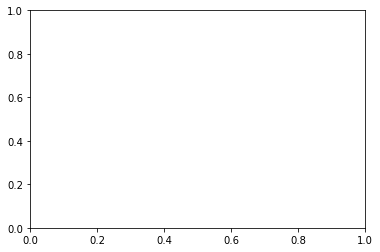

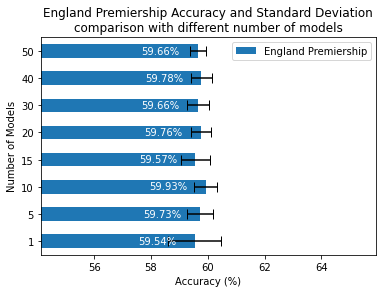

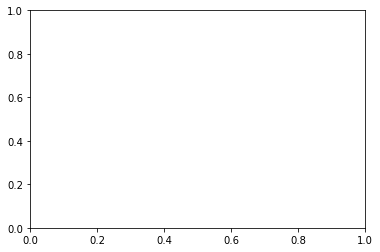

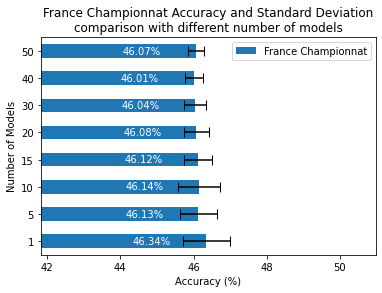

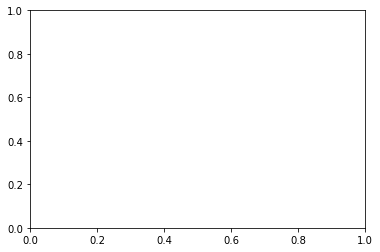

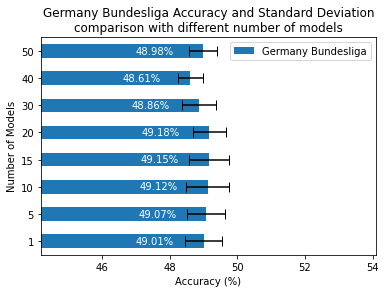

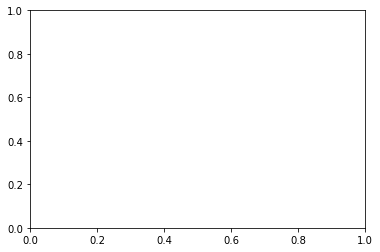

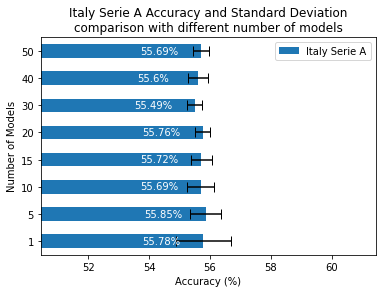

In [50]:
print(total_accuracies)
print(total_stds)
england_acc = []
france_acc = []
germany_acc = []
italy_acc = []
england_std = []
france_std = []
germany_std = []
italy_std = []

def plot_acc_stds(accuracies, stds, title="", competition=""):
    fig, ax = plt.subplots()
    df = pd.DataFrame({competition:accuracies})
    ax = df.plot.barh(xerr=[stds], capsize=5)

    for i, v in enumerate(accuracies):
        ax.text(v - 2, i - 0.1, str(round(v, 2)) + "%", color='white')

    ax.set_xlabel("Accuracy (%)")
    ax.set_ylabel("Number of Models")
    ax.set_yticklabels(["1", "5", "10", "15", "20", "30", "40", "50"])
    ax.set_title(title)
    ax.set_xlim([min(accuracies) / 1.1, max(accuracies) * 1.1])
    

for accuracy, std in zip(total_accuracies, total_stds):
    england_acc.append(accuracy[0])
    france_acc.append(accuracy[1])
    germany_acc.append(accuracy[2])
    italy_acc.append(accuracy[3])
    
    england_std.append(std[0])
    france_std.append(std[1])
    germany_std.append(std[2])
    italy_std.append(std[3])
    
plot_acc_stds(england_acc, 
              england_std, 
              'England Premiership Accuracy and Standard Deviation\ncomparison with different number of models',
              'England Premiership')
plot_acc_stds(france_acc, 
              france_std, 
              'France Championnat Accuracy and Standard Deviation\ncomparison with different number of models',
              'France Championnat')
plot_acc_stds(germany_acc, 
              germany_std, 
              'Germany Bundesliga Accuracy and Standard Deviation\ncomparison with different number of models',
              'Germany Bundesliga')
plot_acc_stds(italy_acc, 
              italy_std, 
              'Italy Serie A Accuracy and Standard Deviation\ncomparison with different number of models',
              'Italy Serie A')

## Competition-based NN

Hyperparameter tuning and other sports are further down

In [6]:
competition_stats = {'England - Premiership': NnParams(batch_size=64,
                                                       epochs=30,
                                                       optimizer="Adamax",
                                                       learn_rate=0.001,
                                                       init_mode="glorot_uniform",
                                                       neurons_1=20,
                                                       neurons_2=20,
                                                       neurons_3=0,
                                                       activation="tanh",
                                                       dropout=0),
                     'France - Championnat': NnParams(batch_size=128,
                                                      epochs=70,
                                                      optimizer="Adam",
                                                      learn_rate=0.00025,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=30,
                                                      neurons_2=5,
                                                      neurons_3=5,
                                                      activation="relu",
                                                      dropout=0),
                     'Germany - Bundesliga': NnParams(batch_size=64,
                                                      epochs=10,
                                                      optimizer="Adagrad",
                                                      learn_rate=0.005,
                                                      init_mode="normal",
                                                      neurons_1=25,
                                                      neurons_2=25,
                                                      neurons_3=0,
                                                      activation="relu",
                                                      dropout=0),
                     'Italy - Serie A': NnParams(batch_size=128,
                                                 epochs=40,
                                                 optimizer="Adagrad",
                                                 learn_rate=0.0005,
                                                 init_mode="glorot_uniform",
                                                 neurons_1=20,
                                                 neurons_2=20,
                                                 neurons_3=10,
                                                 activation="tanh",
                                                 dropout=0)}     

run_nn(train[0], 
       train[1], 
       test[0], 
       test[1], 
       competition_names, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=2)

NameError: name 'PredictionTracker' is not defined

## Average NN

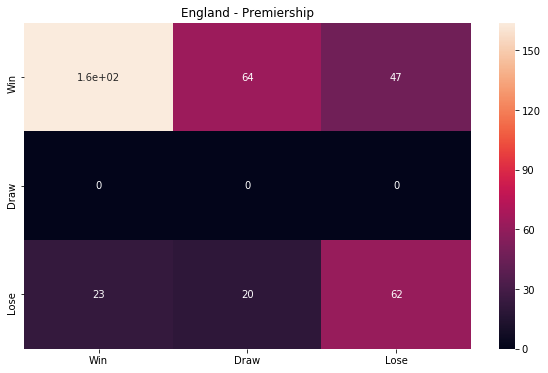

Accuracy: 59.47%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.57 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


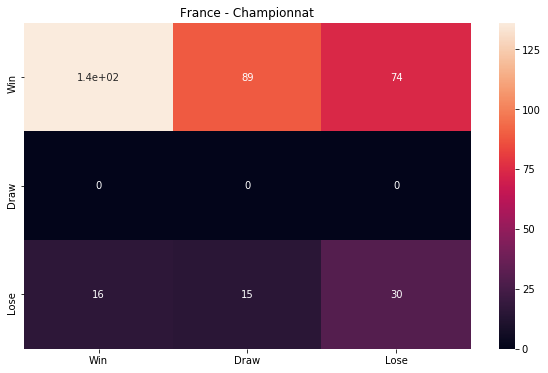

Accuracy: 46.11%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


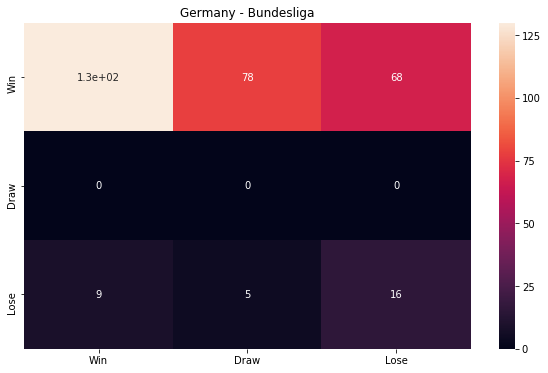

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


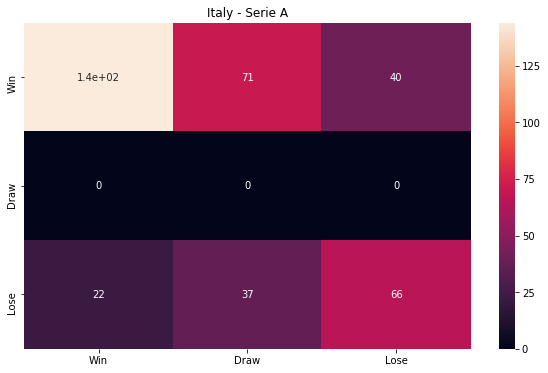

Accuracy: 55.26%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


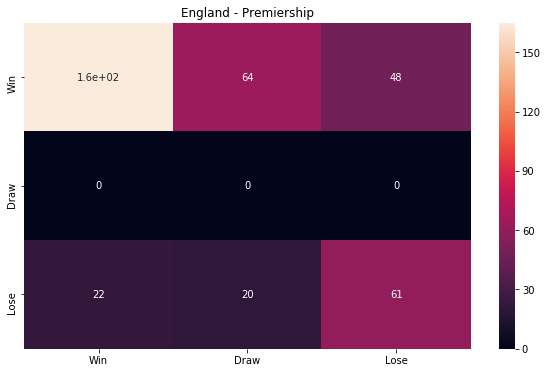

Accuracy: 59.47%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.56 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


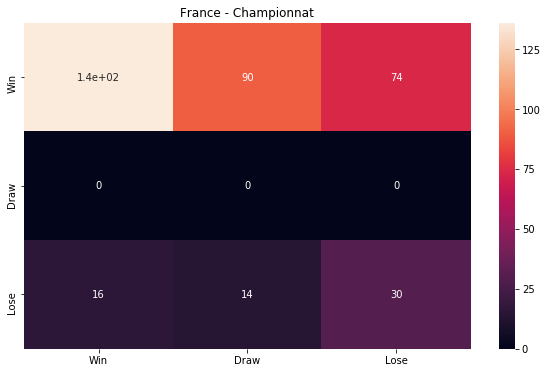

Accuracy: 46.11%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.37 


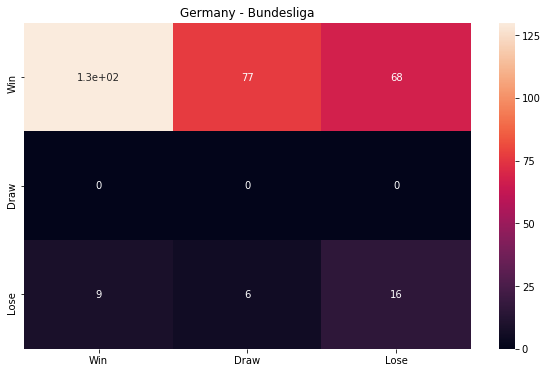

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


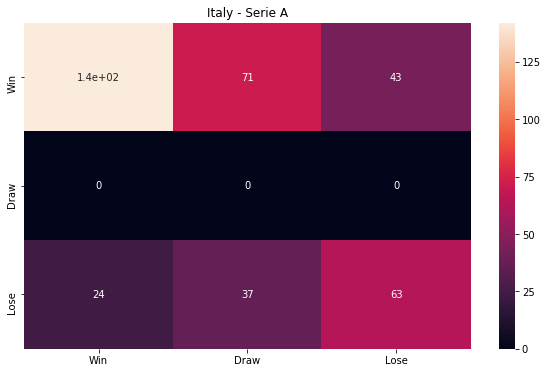

Accuracy: 53.95%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.55 


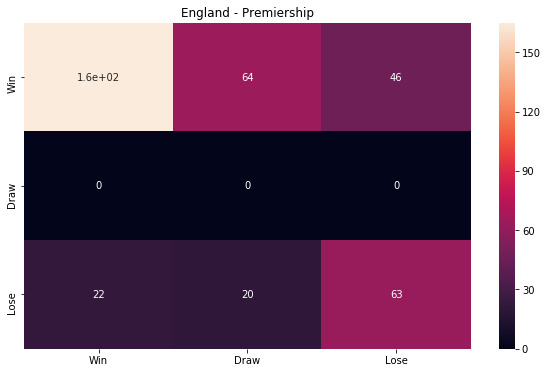

Accuracy: 60.0%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.59 


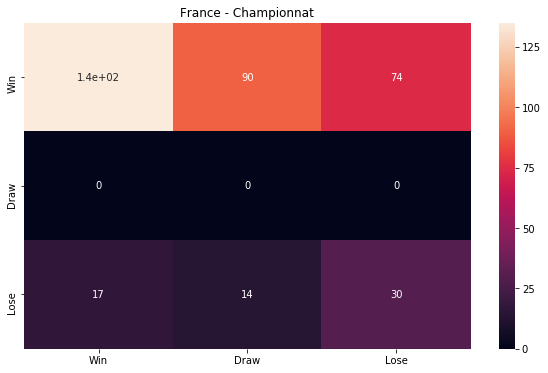

Accuracy: 45.83%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


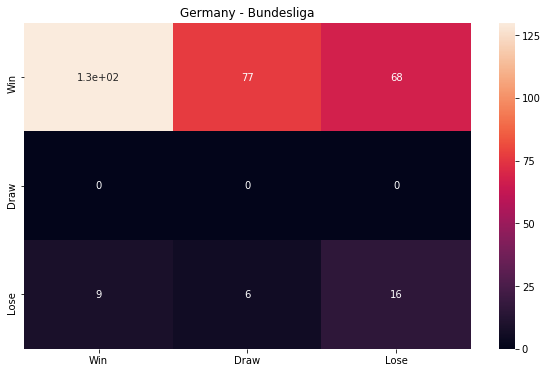

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


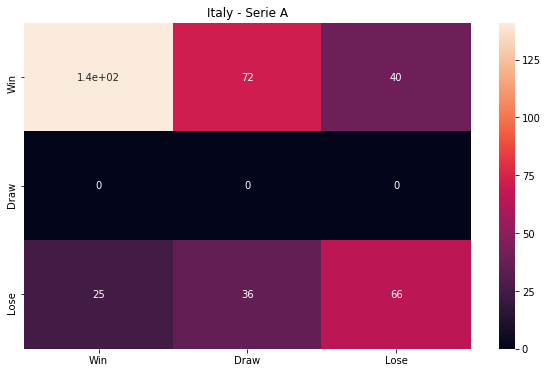

Accuracy: 54.47%
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.57 


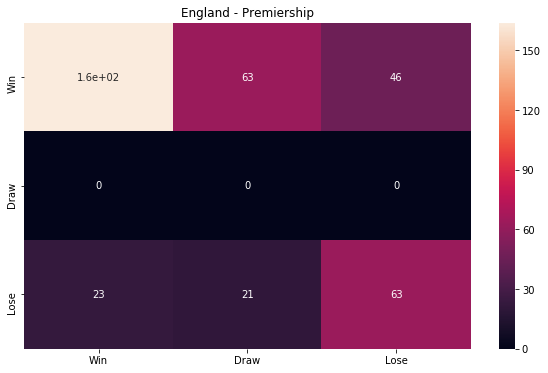

Accuracy: 59.74%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


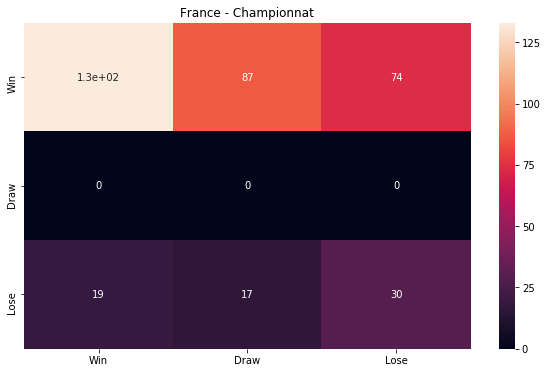

Accuracy: 45.28%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.35 


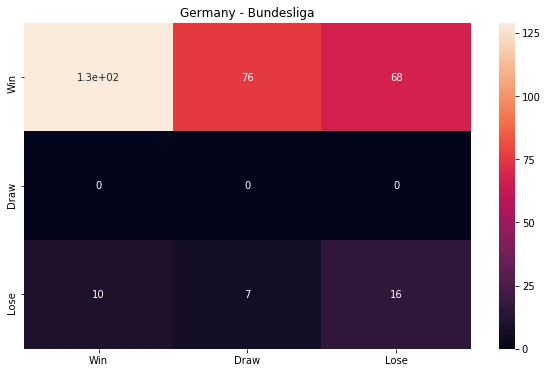

Accuracy: 47.39%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.27 


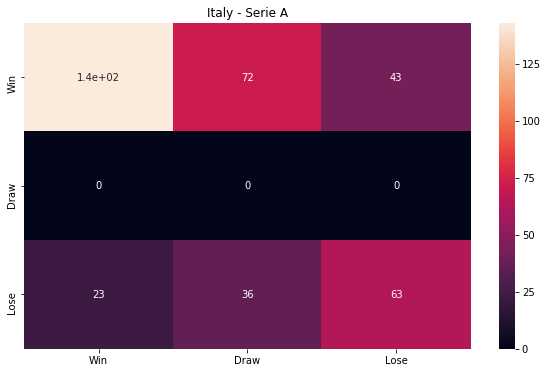

Accuracy: 54.21%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.55 


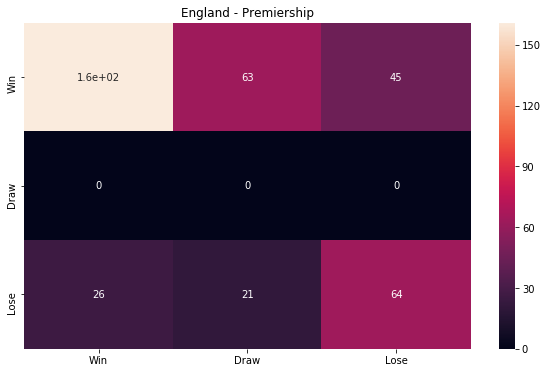

Accuracy: 59.21%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


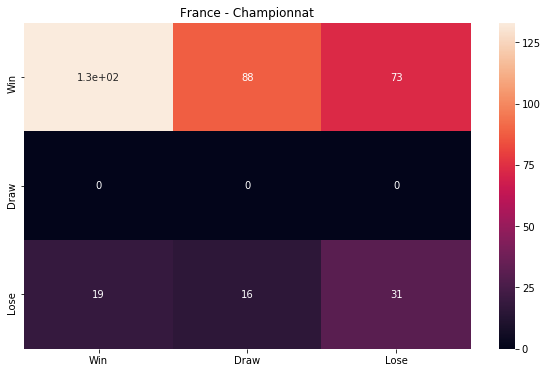

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.47 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


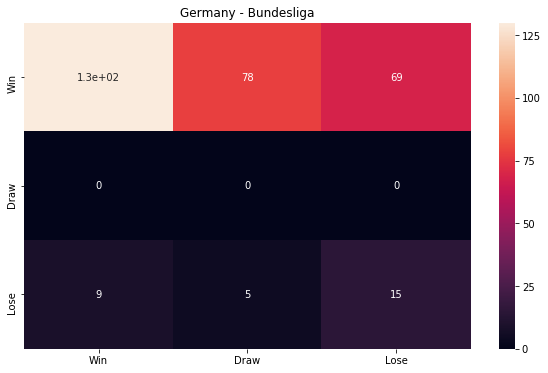

Accuracy: 47.39%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.62 	Draw 0.00 	Lose 0.27 


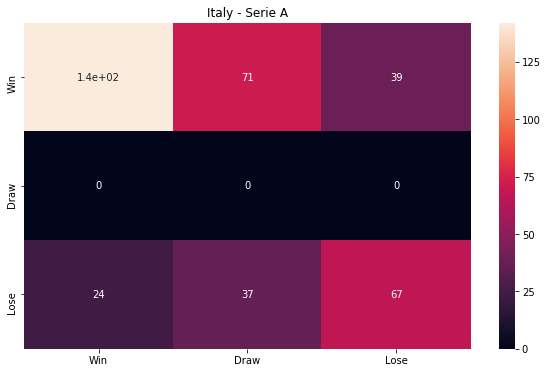

Accuracy: 55.0%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.63 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


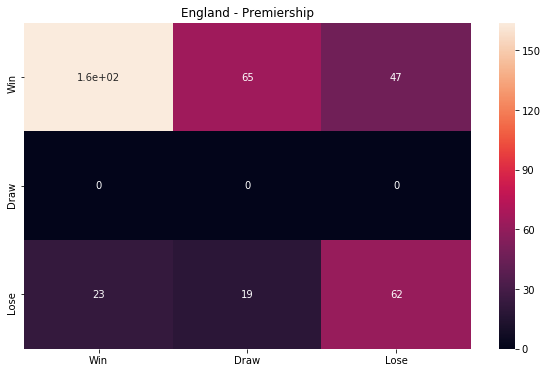

Accuracy: 59.47%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.57 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


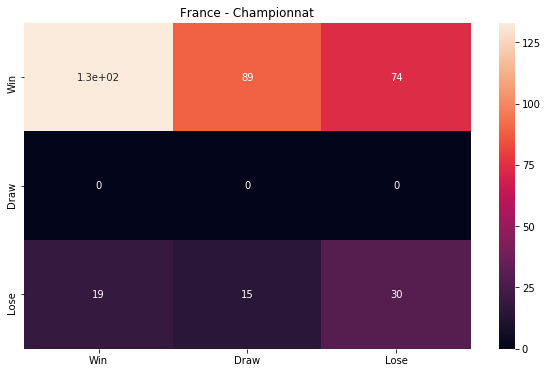

Accuracy: 45.28%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.47 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.36 


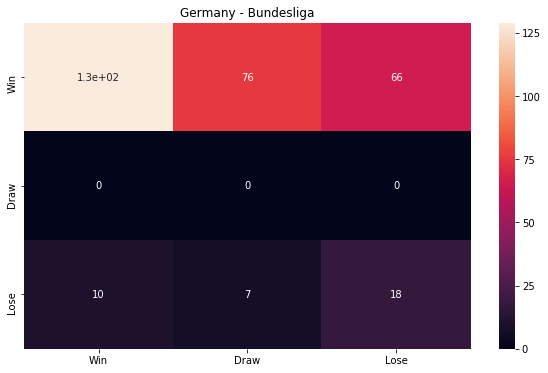

Accuracy: 48.04%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.21 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.30 


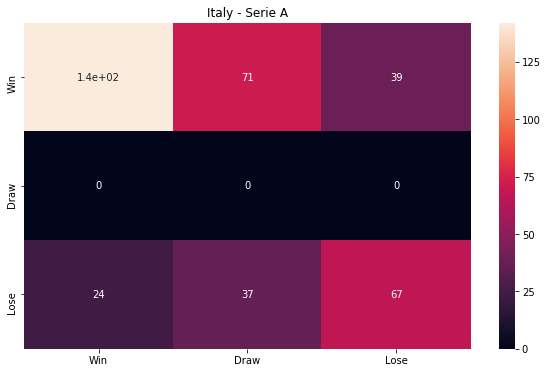

Accuracy: 55.0%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.63 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


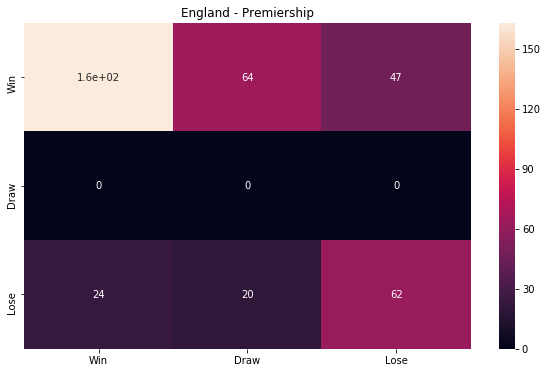

Accuracy: 59.21%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.57 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


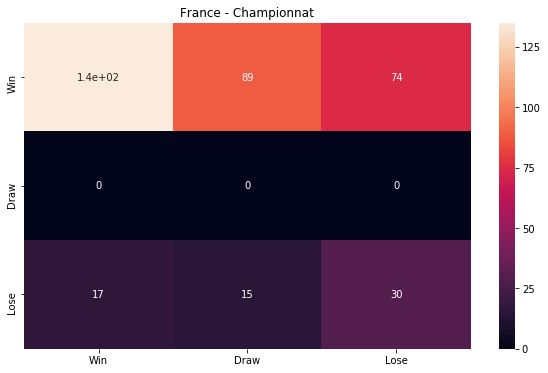

Accuracy: 45.83%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


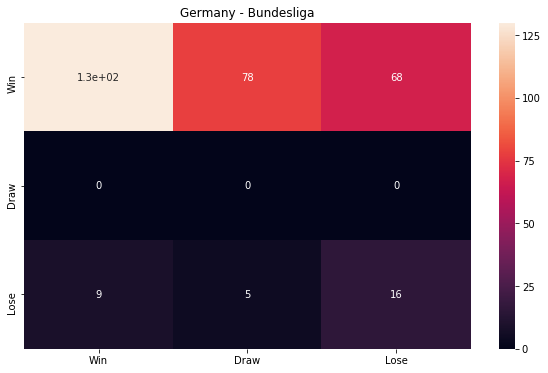

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


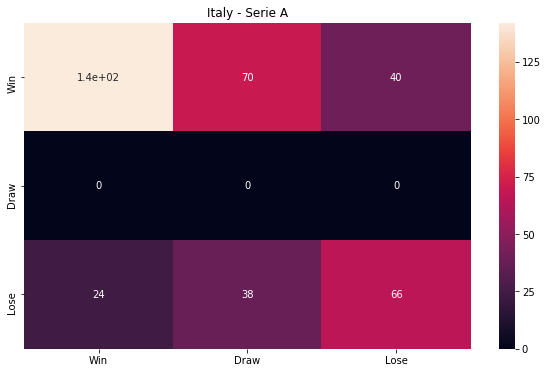

Accuracy: 54.74%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.56 


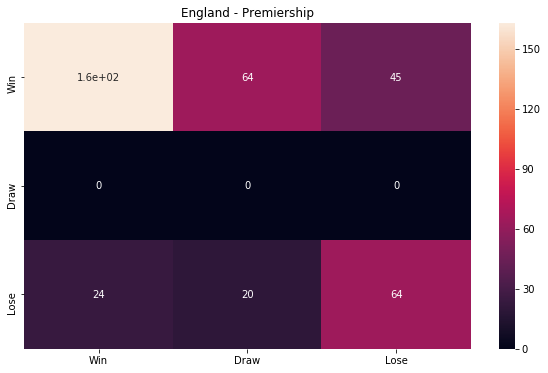

Accuracy: 59.74%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.59 


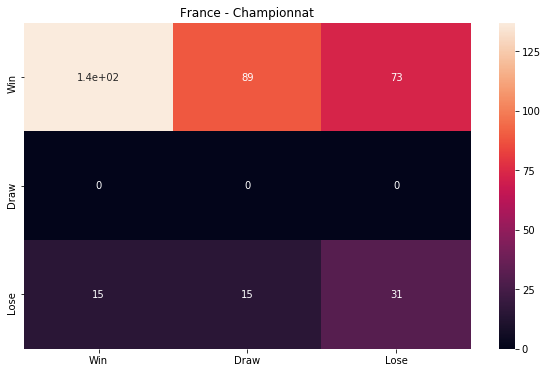

Accuracy: 46.67%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.46 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.61 	Draw 0.00 	Lose 0.38 


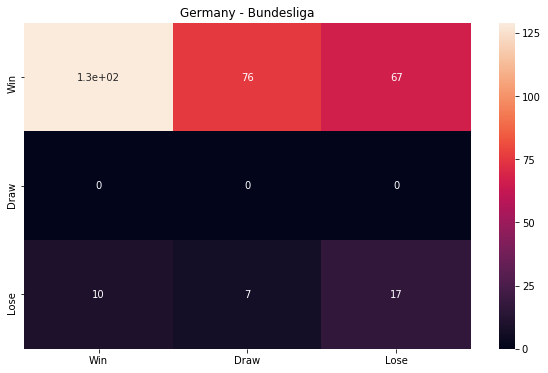

Accuracy: 47.71%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.29 


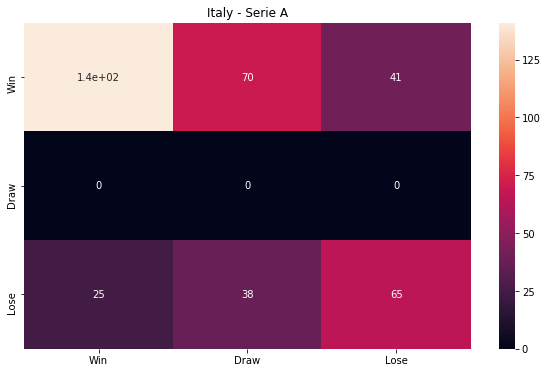

Accuracy: 54.21%
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.56 


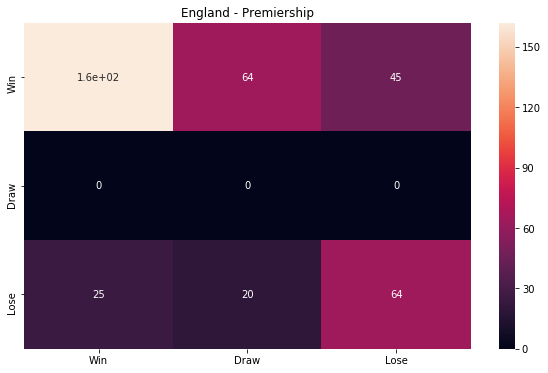

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.59 


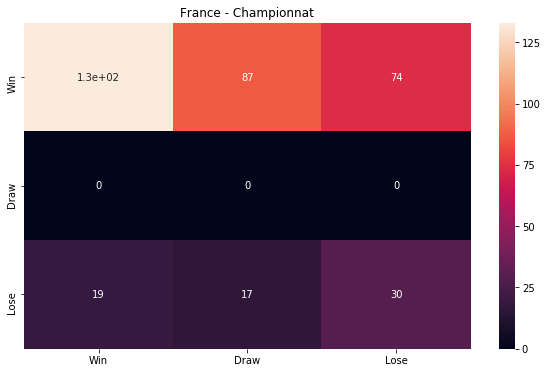

Accuracy: 45.28%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.35 


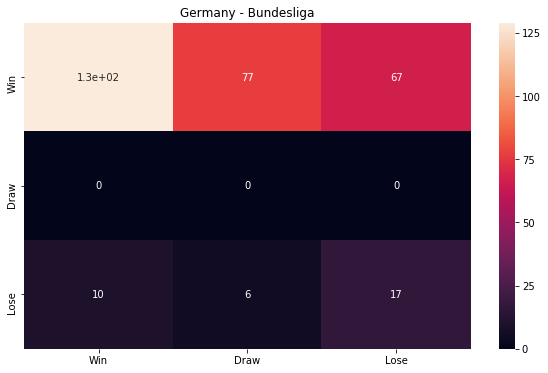

Accuracy: 47.71%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.29 


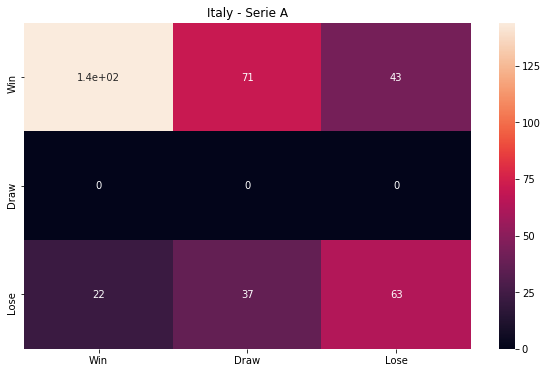

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.55 


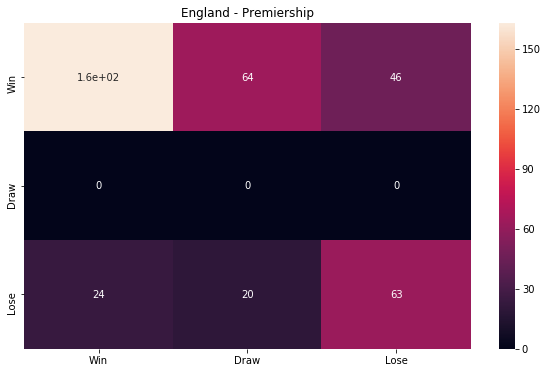

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


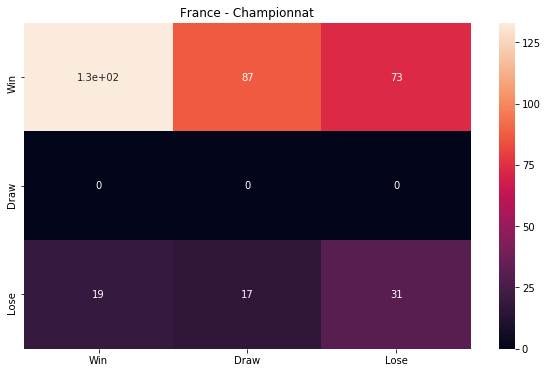

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.46 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


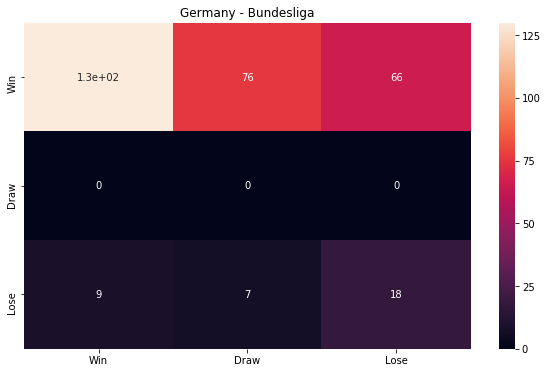

Accuracy: 48.37%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.21 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.31 


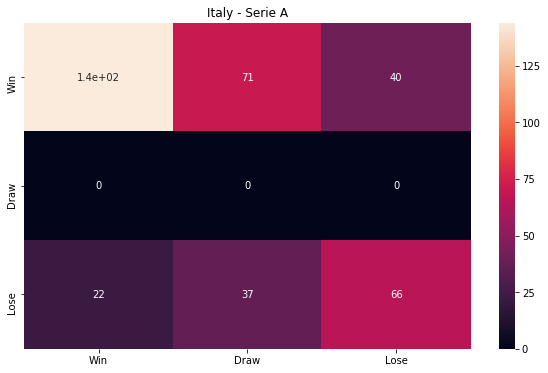

Accuracy: 55.26%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


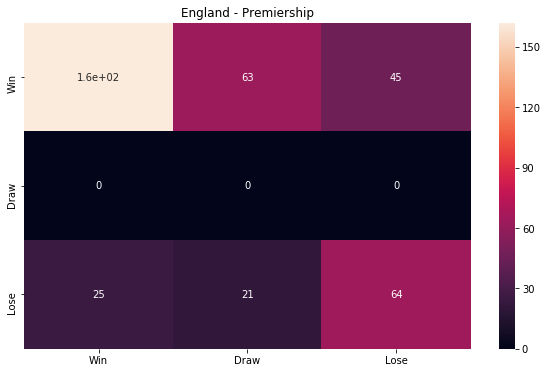

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


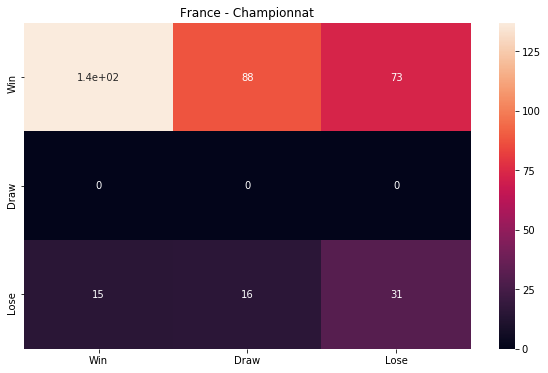

Accuracy: 46.67%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.46 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.61 	Draw 0.00 	Lose 0.37 


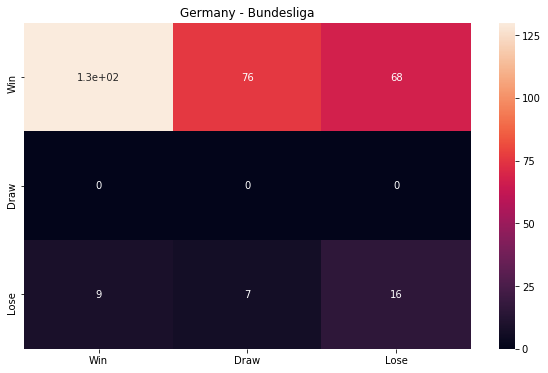

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


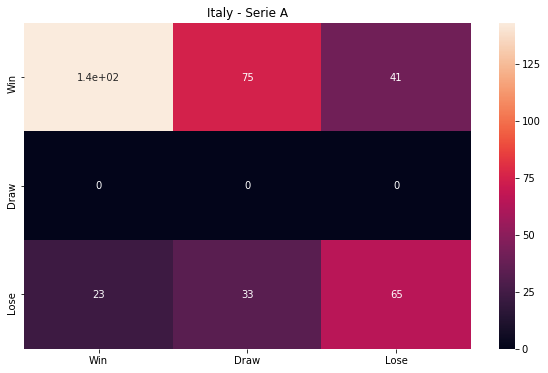

Accuracy: 54.74%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.54 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.57 


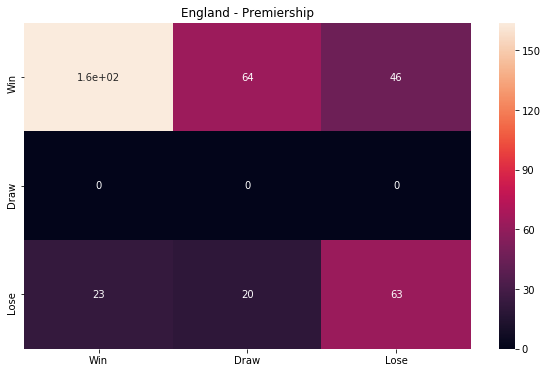

Accuracy: 59.74%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.59 


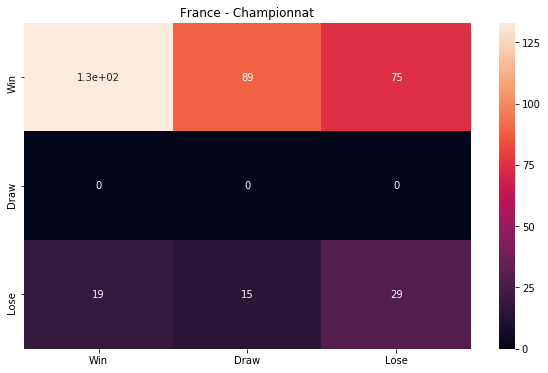

Accuracy: 45.0%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.28 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.46 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.35 


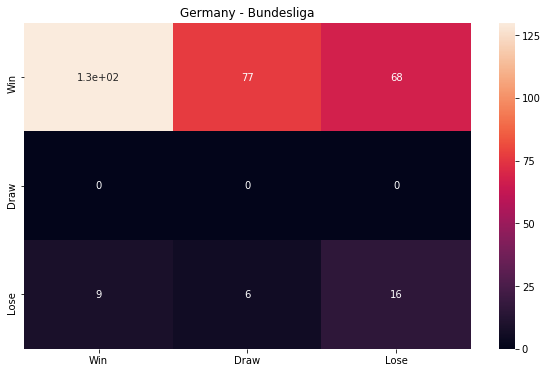

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


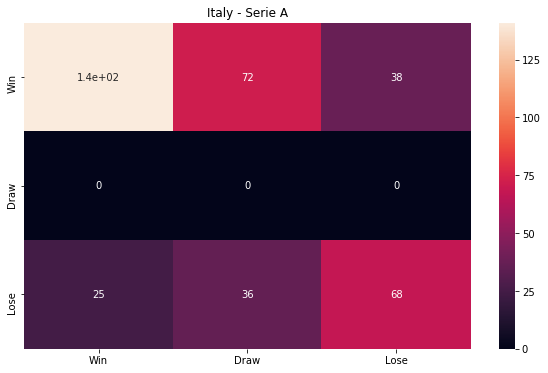

Accuracy: 55.0%
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.64 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.58 


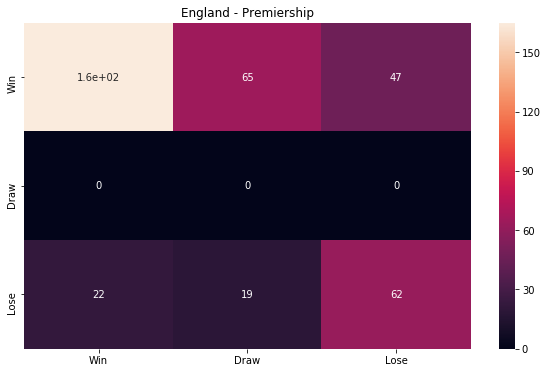

Accuracy: 59.74%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.57 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


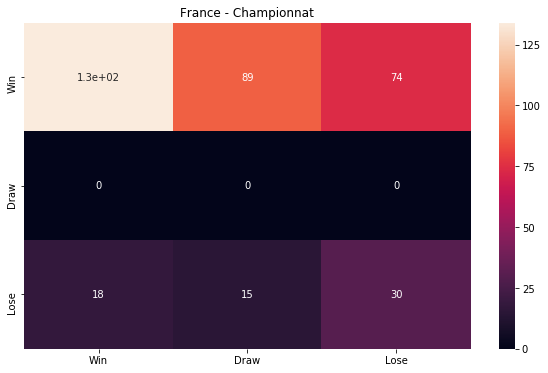

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


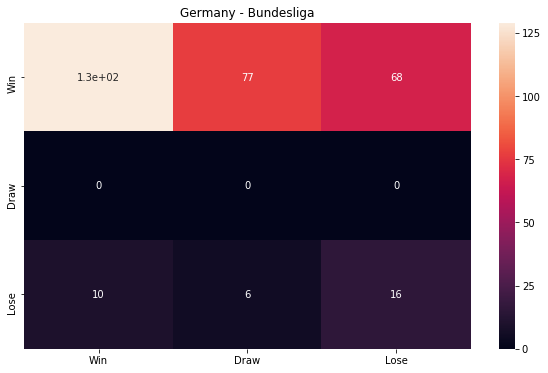

Accuracy: 47.39%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.62 	Draw 0.00 	Lose 0.28 


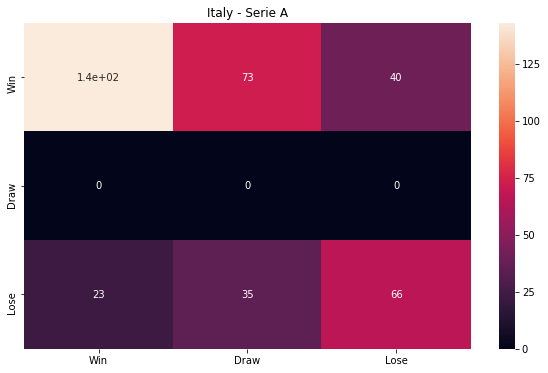

Accuracy: 55.0%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


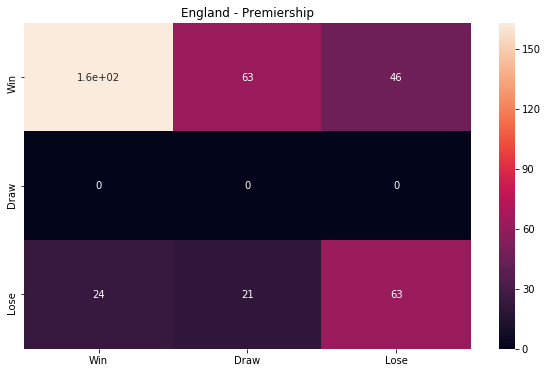

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


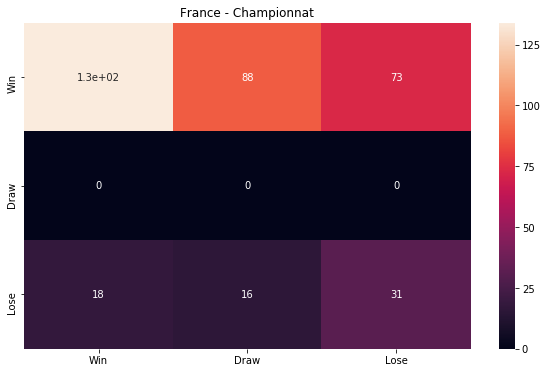

Accuracy: 45.83%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.37 


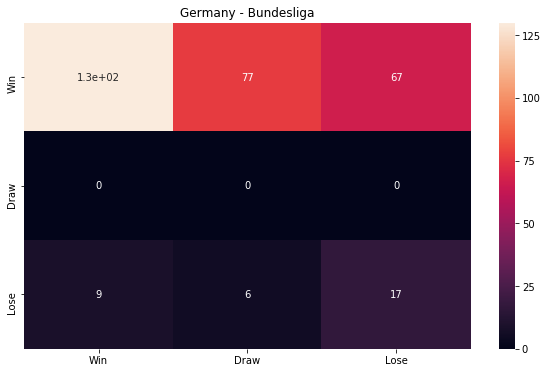

Accuracy: 48.04%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.29 


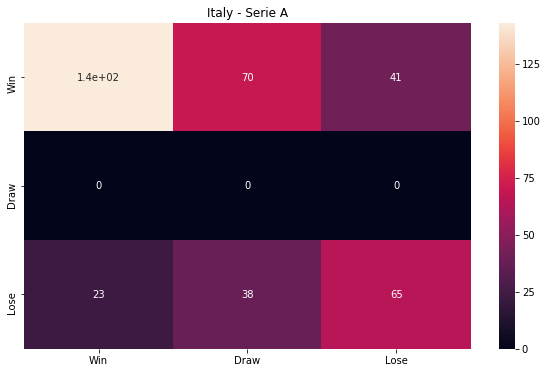

Accuracy: 54.74%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.56 


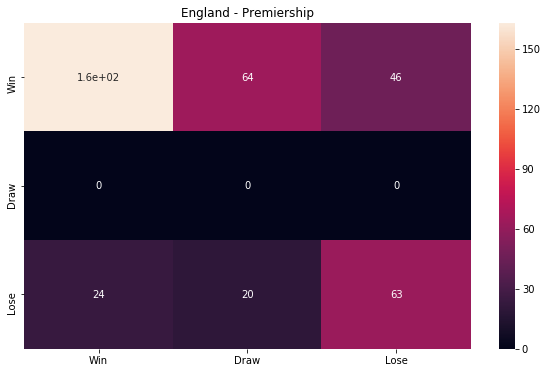

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


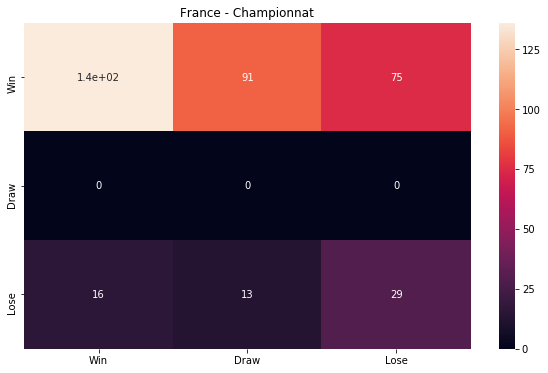

Accuracy: 45.83%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.28 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


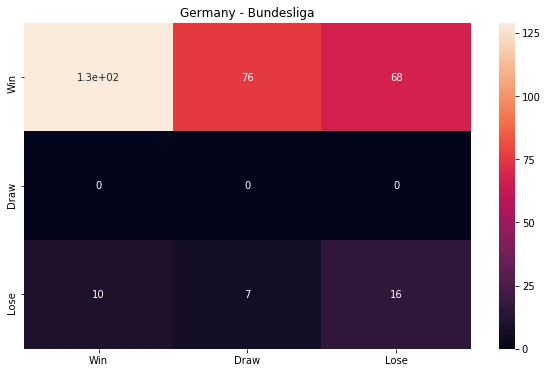

Accuracy: 47.39%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.27 


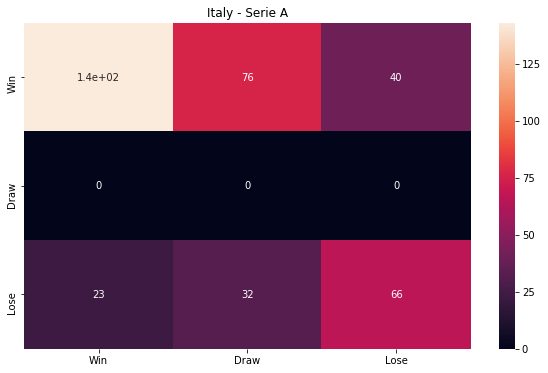

Accuracy: 55.0%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.55 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.58 


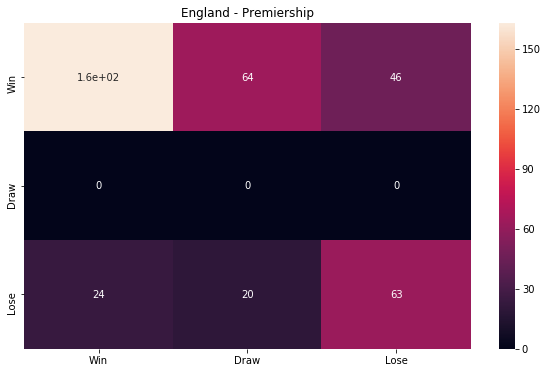

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


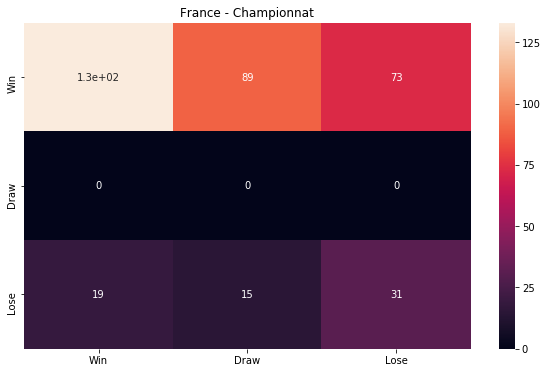

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.37 


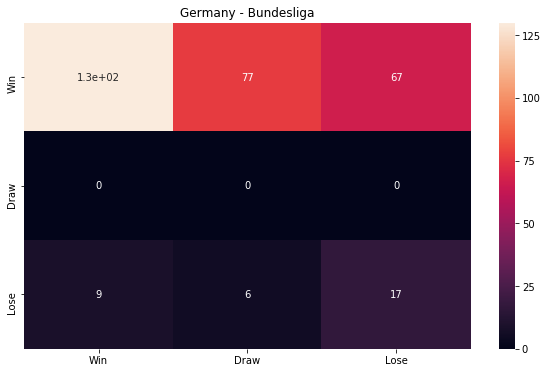

Accuracy: 48.04%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.29 


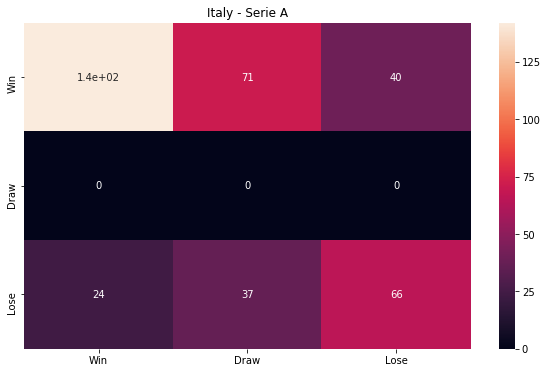

Accuracy: 54.74%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


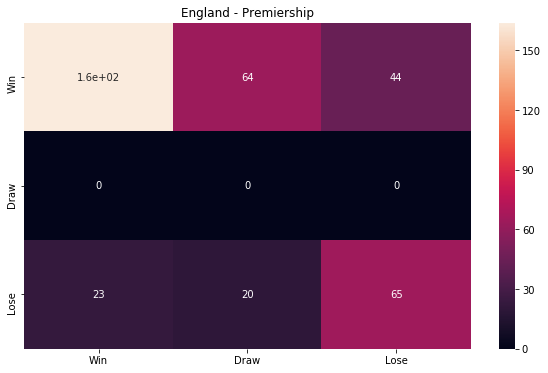

Accuracy: 60.26%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.60 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.60 


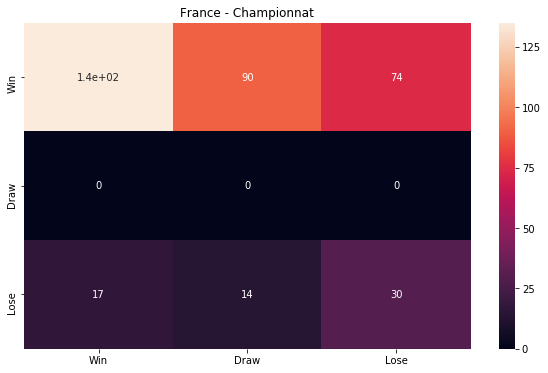

Accuracy: 45.83%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


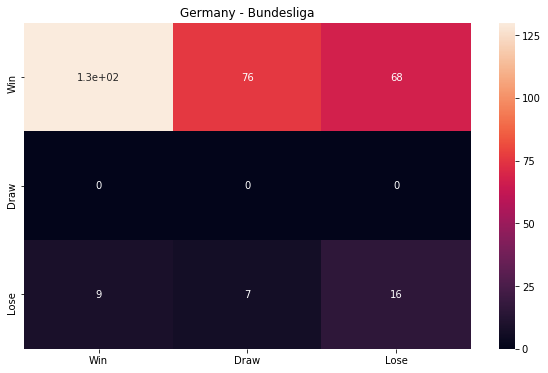

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


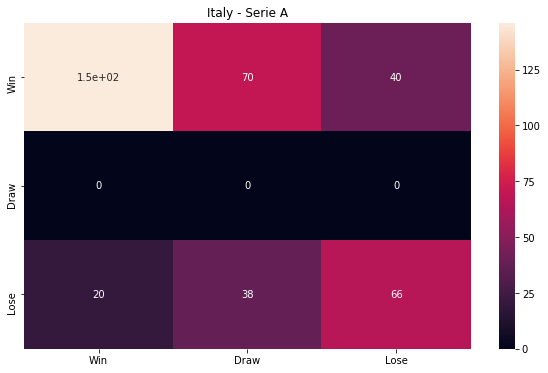

Accuracy: 55.79%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.57 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.69 	Draw 0.00 	Lose 0.57 


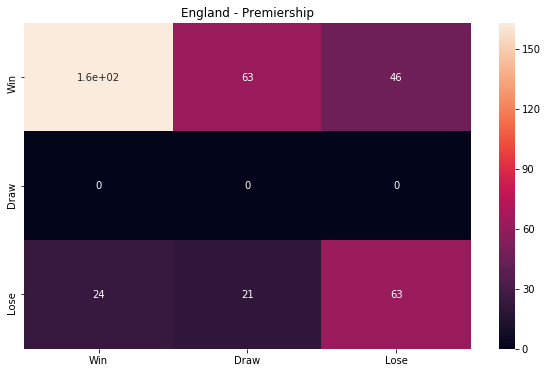

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


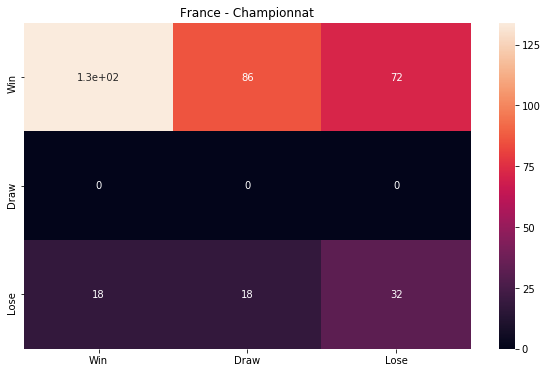

Accuracy: 46.11%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.46 	Draw 0.00 	Lose 0.47 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.37 


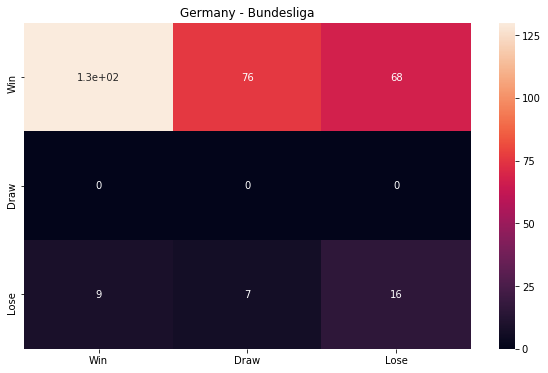

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


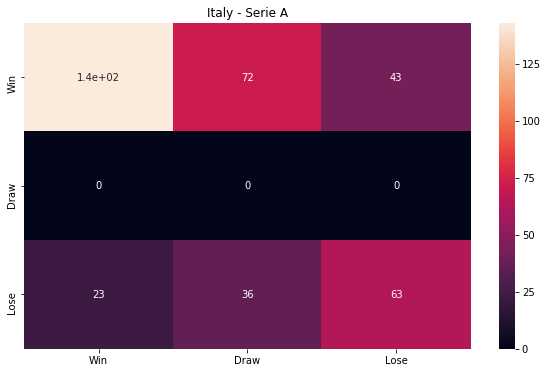

Accuracy: 54.21%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.55 


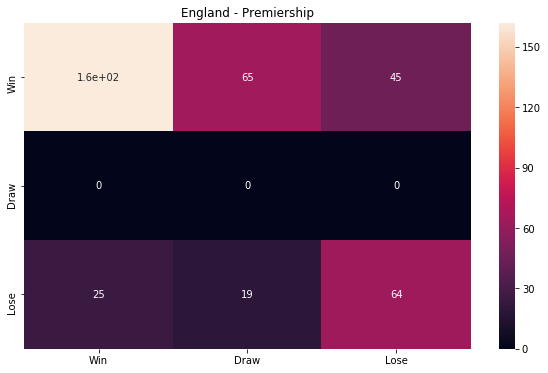

Accuracy: 59.47%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.59 


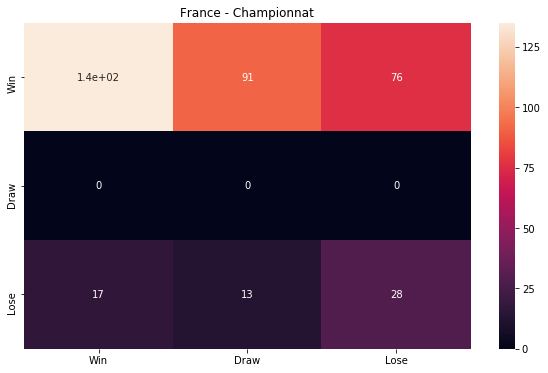

Accuracy: 45.28%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.27 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.35 


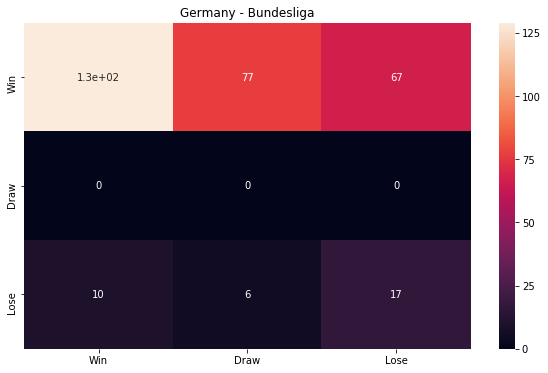

Accuracy: 47.71%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.29 


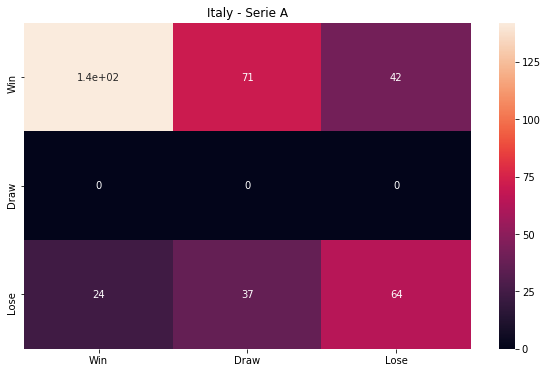

Accuracy: 54.21%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.60 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.55 


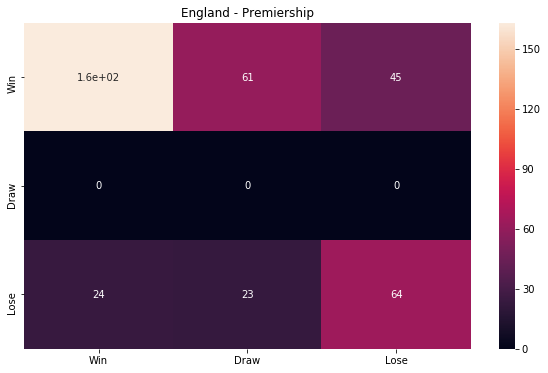

Accuracy: 59.74%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.61 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


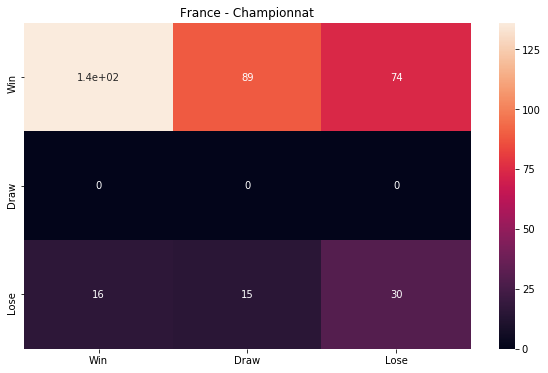

Accuracy: 46.11%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


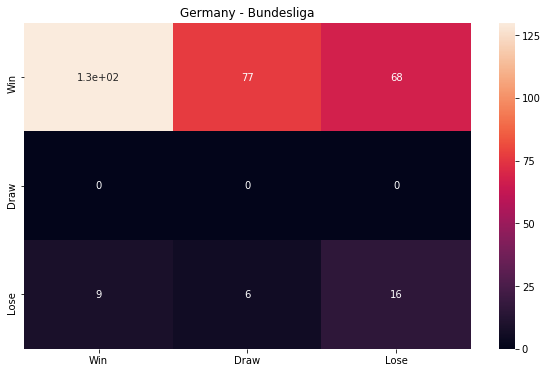

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


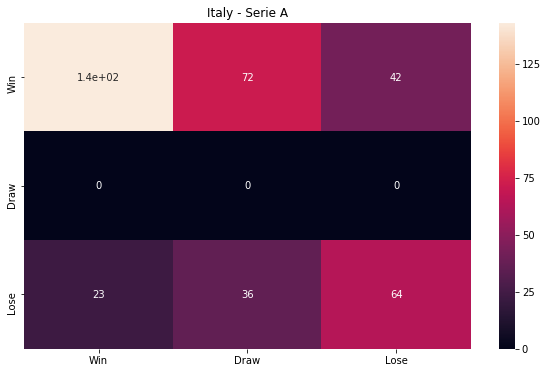

Accuracy: 54.47%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.60 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.56 


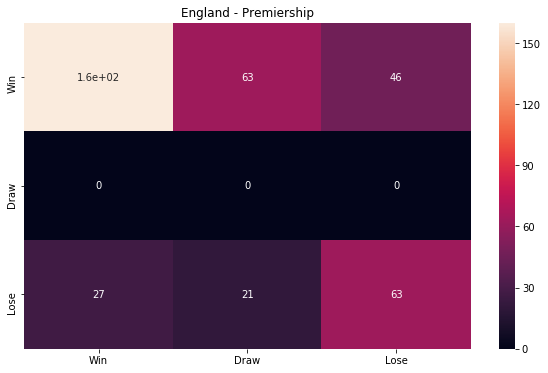

Accuracy: 58.68%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.70 	Draw 0.00 	Lose 0.57 


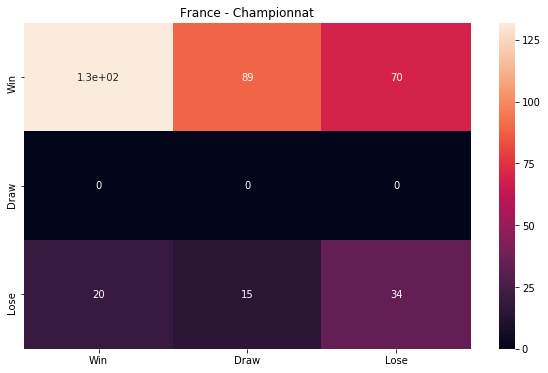

Accuracy: 46.11%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.39 


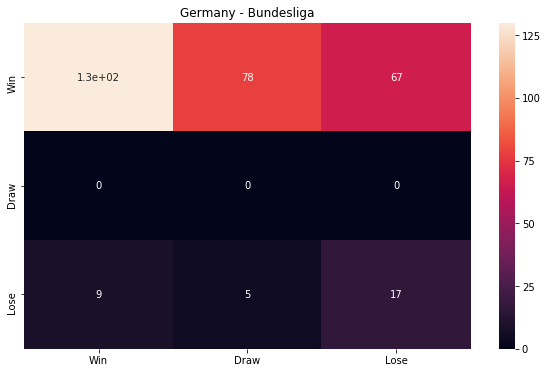

Accuracy: 48.04%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.20 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.55 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.30 


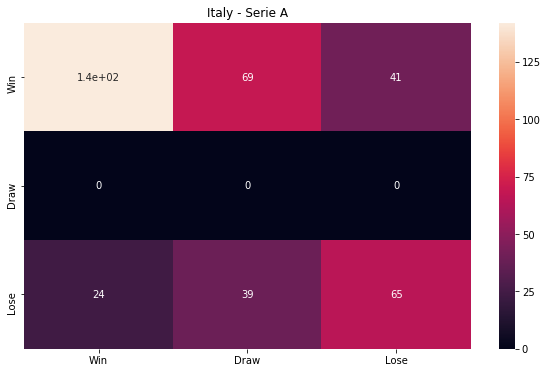

Accuracy: 54.47%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.56 


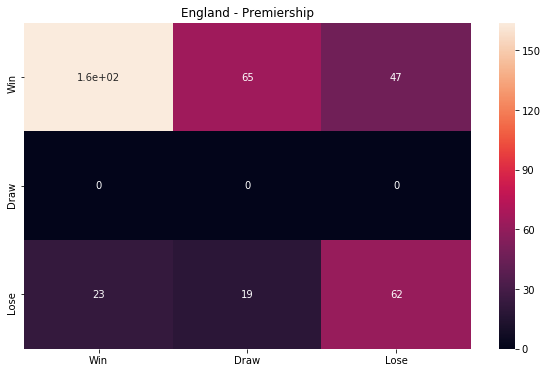

Accuracy: 59.47%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.57 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.00 	Lose 0.58 


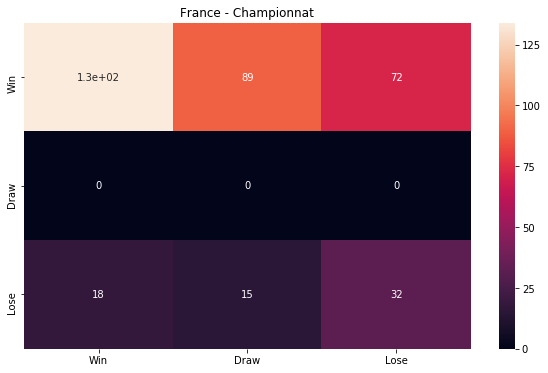

Accuracy: 46.11%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.38 


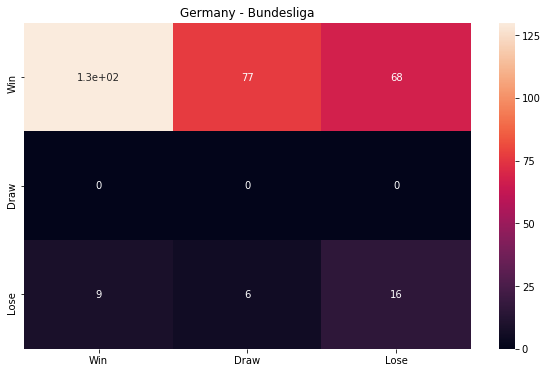

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


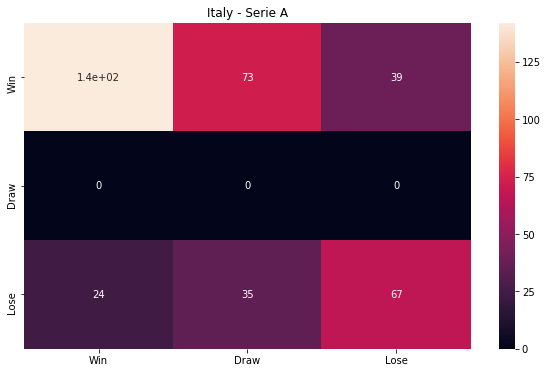

Accuracy: 55.0%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.63 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.58 


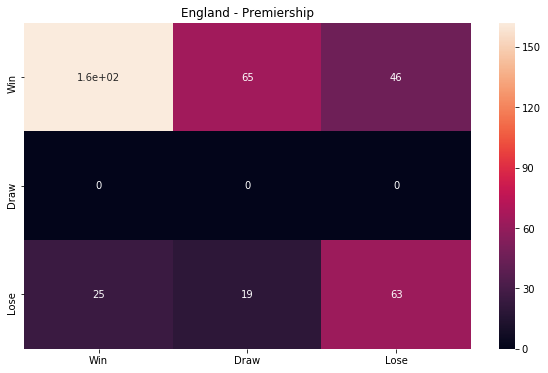

Accuracy: 59.21%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.70 	Draw 0.00 	Lose 0.58 


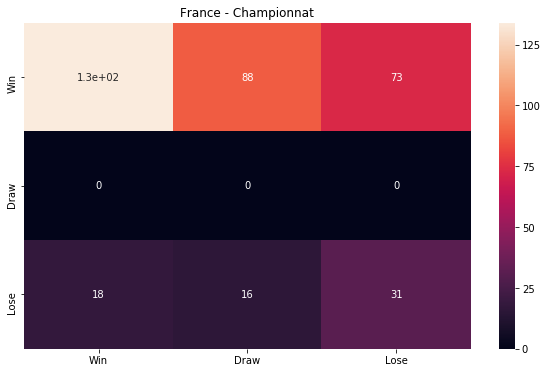

Accuracy: 45.83%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.30 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.37 


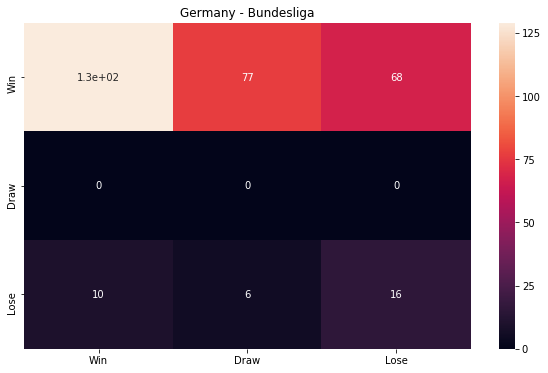

Accuracy: 47.39%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.62 	Draw 0.00 	Lose 0.28 


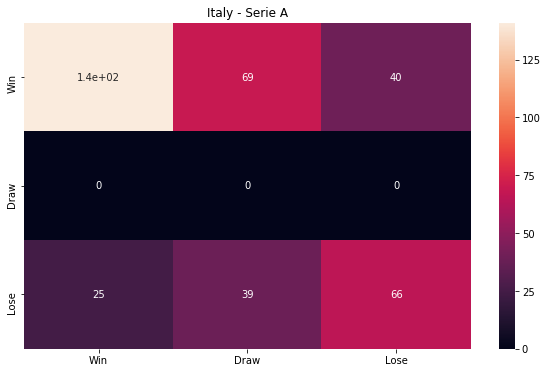

Accuracy: 54.47%
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.56 


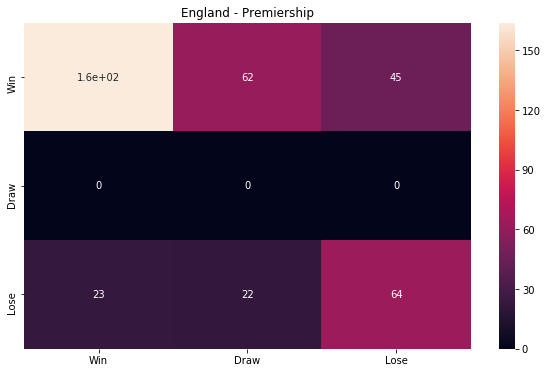

Accuracy: 60.0%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.59 
Recall: 	Win 0.61 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.59 


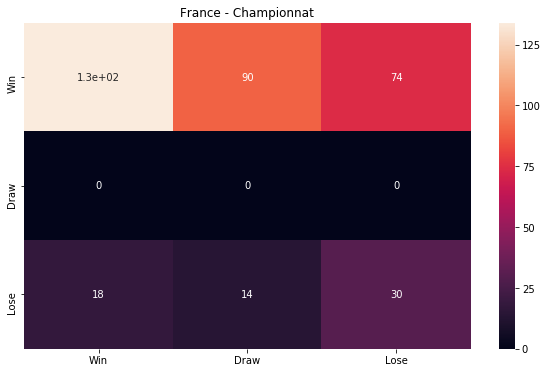

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


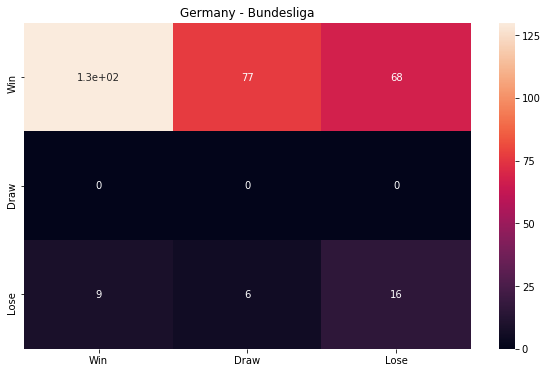

Accuracy: 47.71%
Precision: 	Win 0.94 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.28 


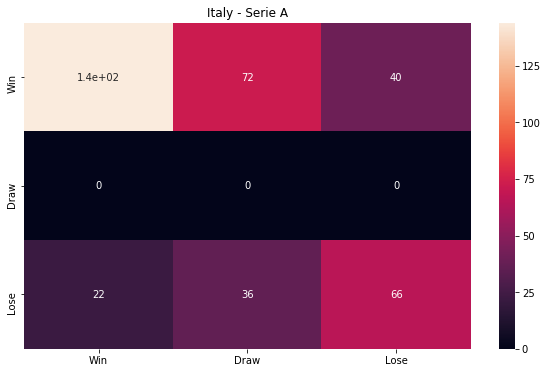

Accuracy: 55.26%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


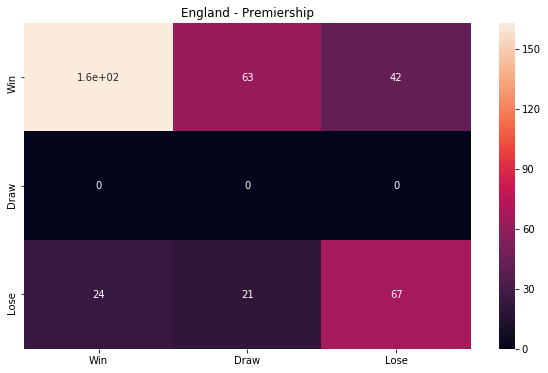

Accuracy: 60.53%
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.61 


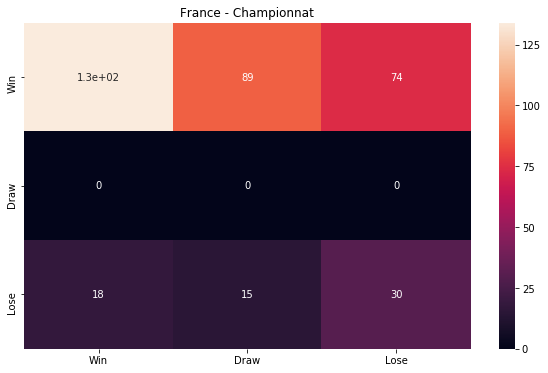

Accuracy: 45.56%
Precision: 	Win 0.88 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.36 


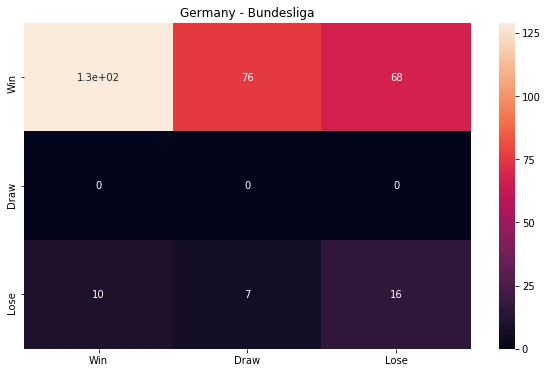

Accuracy: 47.39%
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.63 	Draw 0.00 	Lose 0.27 


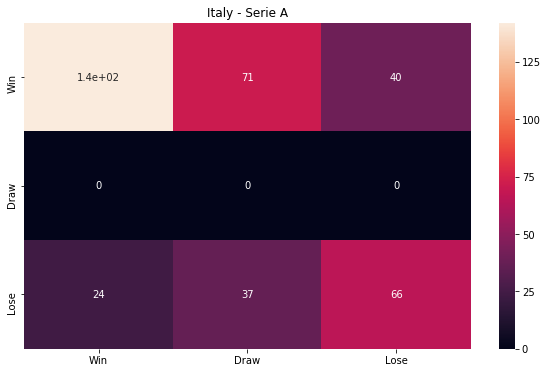

Accuracy: 54.74%
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.62 
Recall: 	Win 0.56 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.00 	Lose 0.57 


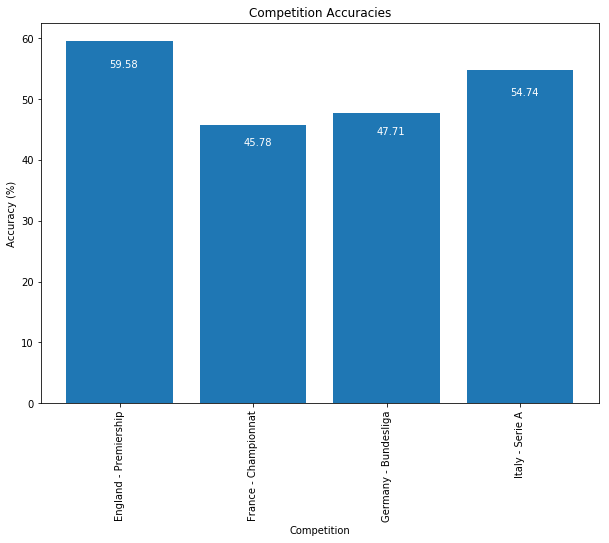

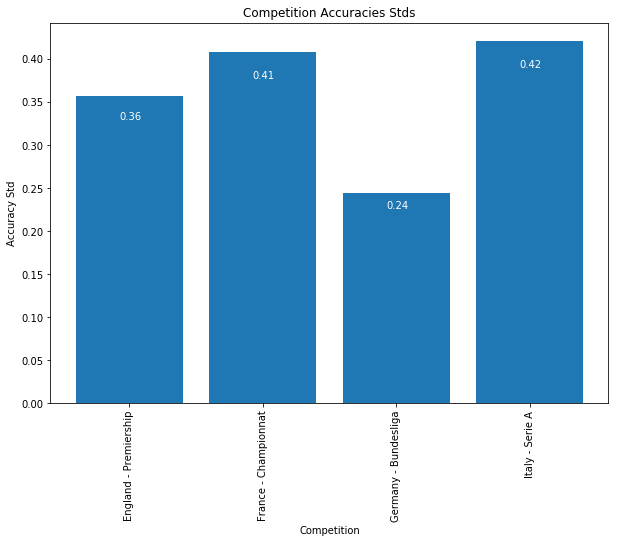

In [10]:
competition_stats = {'England - Premiership': NnParams(batch_size=128,
                                                       epochs=40,
                                                       optimizer="Adamax",
                                                       learn_rate=0.001,
                                                       init_mode="glorot_uniform",
                                                       neurons_1=10,
                                                       neurons_2=10,
                                                       neurons_3=0,
                                                       activation="softsign",
                                                       dropout=0),
                     'France - Championnat': NnParams(batch_size=128,
                                                      epochs=40,
                                                      optimizer="Adamax",
                                                      learn_rate=0.001,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=10,
                                                      neurons_2=10,
                                                      neurons_3=0,
                                                      activation="softsign",
                                                      dropout=0),
                     'Germany - Bundesliga': NnParams(batch_size=128,
                                                      epochs=40,
                                                      optimizer="Adamax",
                                                      learn_rate=0.001,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=10,
                                                      neurons_2=10,
                                                      neurons_3=0,
                                                      activation="softsign",
                                                      dropout=0),
                     'Italy - Serie A': NnParams(batch_size=128,
                                                 epochs=40,
                                                 optimizer="Adamax",
                                                 learn_rate=0.001,
                                                 init_mode="glorot_uniform",
                                                 neurons_1=10,
                                                 neurons_2=10,
                                                 neurons_3=0,
                                                 activation="softsign",
                                                 dropout=0)}     

run_nn(train[0], 
       train[1], 
       test[0], 
       test[1], 
       competition_names, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=1)

In [ ]:
### stds1 = [5.19, 2.93, 3.33, 4.64] # overall
stds2 = [4.38, 1.95, 2.64, 4.1] # per-competition
acc1 = [53.66, 46.75, 45.72, 48.24]
acc2 = [57.47, 45.53, 49.22, 48.5]
data1 = stds1
data2 = stds2
df = pd.DataFrame({'New':data2[::-1], 'Old':data1[::-1]}, index=competitions[::-1])
#ax = df.plot.barh(xerr=[stds2[::-1], stds1[::-1]], capsize=5)
ax = df.plot.barh()

for i, v in enumerate(data1[::-1]):
    ax.text(v - 0.75, i+0.05, str(round(v, 2)) + "%", color='black')
for i, v in enumerate(data2[::-1]):
    ax.text(v - 0.75, i-0.2, str(round(v, 2)) + "%", color='white')

ax.set_xlabel("Standard Deviation (%)")
ax.set_ylabel("Competition")
ax.set_title("NN Compare Accuracies Stds of different models")
plt.show()

"""
width = 0.5
fig, ax = plt.subplots(figsize=(10,7))
ax.barh(range(len(stds1)), stds1, width, color='red', label='Old')
ax.barh(range(len(stds2)) + width, stds2, width, color='green', label='New')
ax.legend()
plt.show()
"""
"""
plt.xticks(range(len(labels)), labels, rotation='vertical')
ax.set_ylabel(ylab)
ax.set_xlabel(xlab)
plt.title(title)
for i, v in enumerate(data):
    ax.text(i-0.075, v - (v * 0.075), str(round(v, 2)), color='white')
plt.show()
"""

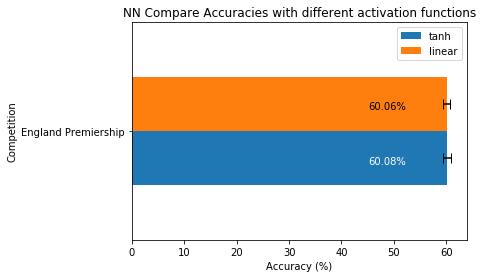

In [16]:
stds1 = [0.66]
stds2 = [0.76]
acc1 = [60.06]
acc2 = [60.08]
labels = ["England Premiership"]
df = pd.DataFrame({'tanh':acc2[::-1], 'linear':acc1[::-1]}, index=labels)
ax = df.plot.barh(xerr=[stds2[::-1], stds1[::-1]], capsize=5)

for i, v in enumerate(acc1[::-1]):
    ax.text(v - (v * 0.25), i+0.1, str(round(v, 2)) + "%", color='black')
for i, v in enumerate(acc2[::-1]):
    ax.text(v - (v * 0.25), i-0.15, str(round(v, 2)) + "%", color='white')

ax.set_xlabel("Accuracy (%)")
ax.set_ylabel("Competition")
ax.set_title("NN Compare Accuracies with different activation functions")
plt.show()

## Tune NN Hyper-parameters
### First, define all necessary functions

In [2]:
def build_model(optimizer='adam', 
                learn_rate=0.01, 
                momentum=0, 
                beta_1=0.9, 
                beta_2=0.999,
                init_mode='glorot_uniform', 
                activation='relu', 
                dropout_rate=0.0, 
                neurons_1=37,
                neurons_2=0,
                neurons_3=0):
    model = keras.Sequential()
    model.add(keras.layers.Dense(neurons_1, 
                                 kernel_initializer=init_mode,
                                 activation=activation))

    if neurons_2 > 0:
        model.add(keras.layers.Dense(neurons_2, 
                                     kernel_initializer=init_mode,
                                     activation=activation))
    if neurons_3 > 0:
        model.add(keras.layers.Dense(neurons_3, 
                                     kernel_initializer=init_mode,
                                     activation=activation))
    if dropout_rate > 0:
        model.add(keras.layers.Dropout(dropout_rate))
    
    model.add(keras.layers.Dense(3, 
                                 kernel_initializer=init_mode, 
                                 activation='softmax'))
    if optimizer == "Adam":
        optimizer = keras.optimizers.Adam(learning_rate=learn_rate, beta_1=beta_1, beta_2=beta_2)
    elif optimizer == "SGD":
        optimizer = keras.optimizers.SGD(lr=learn_rate, momentum=momentum)
    elif optimizer == "Nadam":
        optimizer = keras.optimizers.Nadam(learning_rate=learn_rate, beta_1=beta_1, beta_2=beta_2)
    elif optimizer == "RMSprop":
        optimizer = keras.optimizers.RMSprop(learning_rate=learn_rate)
    elif optimizer == "Adamax":
        optimizer = keras.optimizers.Adamax(learning_rate=learn_rate, beta_1=beta_1, beta_2=beta_2)
    elif optimizer == "Adagrad":
        optimizer = keras.optimizers.Adagrad(learning_rate=learn_rate)
        
    model.compile(optimizer=optimizer,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])
    return model


def build_grid_result(model, x, y, **kwargs):
    
    param_grid = {}
    for arg in kwargs:
        param_grid.update( { arg : kwargs[arg] } )
    
    grid = GridSearchCV(estimator=model, 
                        param_grid=param_grid, 
                        n_jobs=1,
                        cv=10)
    grid_result = grid.fit(x, y)
    
    return grid_result
    
    
def print_grid_summary(grid_result):
    print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
    means = grid_result.cv_results_['mean_test_score']
    stds = grid_result.cv_results_['std_test_score']
    params = grid_result.cv_results_['params']
    for mean, stdev, param in zip(means, stds, params):
        print("%f (%f) with: %r" % (mean, stdev, param))
        

def plot_grid_summary(grid_result, labels, x_lab="", title=""):
    # Grid results must be of length 4: 1 for each competition
    means = [x for x in grid_result.cv_results_['mean_test_score']]
    stds = [x for x in grid_result.cv_results_['std_test_score']]
                                                
    print("Best is %s with value of %s (index %s)" % (labels[means.index(max(means))], 
                                                      max(means),
                                                      means.index(max(means))))
    
    
    
    fig, ax = plt.subplots(figsize=(18,10))
    plt.bar(range(len(means)), means, align="center")
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    ax.set_ylabel("Means")
    ax.set_xlabel(x_lab)
    plt.title(title + " Means")
    for i, v in enumerate(means):
        ax.text(i-0.125, v - (v * 0.05), str(round(v, 2)), color='white')
    plt.show()
    
    fig, ax = plt.subplots(figsize=(18,10))
    plt.bar(range(len(stds)), stds, align="center")
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    ax.set_ylabel("Stds")
    ax.set_xlabel(x_lab)
    plt.title(title + " Stds")
    for i, v in enumerate(stds):
        ax.text(i-0.075, v - (v * 0.075), str(round(v, 4)), color='white')
    plt.show()
    
    
def plot_grid_summaries(grid_results, labels, x_lab="", title=""):
    # Grid results must be of length 4: 1 for each competition
    england_means = [x for x in grid_results[0].cv_results_['mean_test_score']]
    france_means = [x for x in grid_results[1].cv_results_['mean_test_score']]
    germany_means = [x for x in grid_results[2].cv_results_['mean_test_score']]
    italy_means = [x for x in grid_results[3].cv_results_['mean_test_score']]
    
    average = [(x+y+w+z) / 4 for x, y, w, z in zip(england_means, france_means, germany_means, italy_means)]
    
    print("Best Average is %s with value of %s (index %s)" % (labels[average.index(max(average))], 
                                                              max(average),
                                                              average.index(max(average))))
    
    england_stds = [x for x in grid_results[0].cv_results_['std_test_score']]
    france_stds = [x for x in grid_results[1].cv_results_['std_test_score']]
    germany_stds = [x for x in grid_results[2].cv_results_['std_test_score']]
    italy_stds = [x for x in grid_results[3].cv_results_['std_test_score']]
    
    fig, ax = plt.subplots(figsize=(10,7))
    ax.title.set_text('Mean Test Score')
    plt.plot(range(len(england_means)), england_means, color="red", label = "England - Premiership")
    plt.plot(range(len(france_means)), france_means, color="blue", label = "France - Championnat")
    plt.plot(range(len(germany_means)), germany_means, color="orange", label = "Germany - Bundesliga")
    plt.plot(range(len(italy_means)), italy_means, color="green", label = "Italy - Serie A")
    plt.plot(range(len(average)), average, color="purple", label = "Average")
    ax.set_ylabel("Accuracy (%)")
    ax.set_xlabel(x_lab)
    plt.title(title)
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    fig.legend(loc='upper right', ncol=1)
    plt.show()
    
    avg_means = [(x+y+z+k)/4.0 for x, y, z, k in zip(england_means, france_means, germany_means, italy_means)]
    avg_stds = [(x+y+z+k)/4.0 for x, y, z, k in zip(england_stds, france_stds, germany_stds, italy_stds)]
    
    fig, ax = plt.subplots(figsize=(10,7))
    plt.bar(range(len(avg_means)), avg_means, align="center")
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    ax.set_ylabel("Average Mean")
    ax.set_xlabel(x_lab)
    plt.title(title + " Average Means")
    for i, v in enumerate(avg_means):
        ax.text(i-0.125, v - (v * 0.05), str(round(v, 2)), color='white')
    plt.show()
    
    fig, ax = plt.subplots(figsize=(18,10))
    plt.plot(range(len(england_stds)), england_stds, color="red", label = "England - Premiership")
    plt.plot(range(len(france_stds)), france_stds, color="blue", label = "France - Championnat")
    plt.plot(range(len(germany_stds)), germany_stds, color="orange", label = "Germany - Bundesliga")
    plt.plot(range(len(italy_stds)), italy_stds, color="green", label = "Italy - Serie A")
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    ax.set_ylabel("Std Test Score")
    ax.set_xlabel(x_lab)
    plt.title(title + " Std Test Scores")
    fig.legend(loc='upper right', ncol=1)
    plt.show()
    
    fig, ax = plt.subplots(figsize=(18,10))
    plt.bar(range(len(avg_stds)), avg_stds, align="center")
    plt.xticks(range(len(labels)), labels, rotation='vertical')
    ax.set_ylabel("Average Std")
    ax.set_xlabel(x_lab)
    plt.title(title + " Average Stds")
    for i, v in enumerate(avg_stds):
        ax.text(i-0.075, v - (v * 0.075), str(round(v, 2)), color='white')
    plt.show()
        

def grid_search(x, y, *args, **kwargs):
    model = KerasClassifier(build_fn=build_model, verbose=0)
    
    grid_result = build_grid_result(model, x, y, **kwargs)
    print_grid_summary(grid_result)
    
    return grid_result
    
    
def run_grid_search(data, data_labels, labels, competitions, x_lab, title, **kwargs):
    print("Running Grid Search")
    grid_results = []
    for competition in competitions:
        print("Competition %s" % competition)
        grid_results.append(grid_search(data[competition], data_labels[competition], **kwargs))
        
    plot_grid_summaries(grid_results, labels, x_lab=x_lab, title=title)
    
    
def run_separate_grid_search(data, data_labels, labels, competitions, x_lab, title, settings, **kwargs):
    print("Running Separate Grid Search")
    for competition in competitions:
        print("Competition %s" % competition)
        for key, value in settings[competition].items():
            kwargs[key] = value
            
        plot_grid_summary(grid_search(data[competition], 
                                      data_labels[competition], 
                                      **kwargs), 
                          labels, 
                          x_lab=x_lab, 
                          title=competition + " " + title)
        
        
def plot_bar_err(accuracies, stds, legend, labels, x_lab, y_lab, title):    
    accuracies = [x * 100 for x in accuracies]
    stds = [x * 100 for x in stds]
    
    df = pd.DataFrame({legend:accuracies}, index=labels)
    ax = df.plot.barh(xerr=stds, capsize=5)
    ax.get_legend().remove()
    for i, v in enumerate(accuracies):
        ax.text(v - (v * 0.25), i-0.1, str(round(v, 2)) + "%", color='white')

    ax.set_xlabel(x_lab)
    ax.set_ylabel(y_lab)
    ax.set_title(title)
    plt.show()

### Batch Size and Epochs

In [25]:
competitions = list(nn_data.keys())

batch_size = [32, 64, 128, 256, 512]
epochs = [5, 10, 20, 30, 40, 50]
labels = []

for batch in batch_size:
    for epoch in epochs:
        labels.append("Batch %s - Epoch %s" % (batch, epoch))

Running Grid Search
Competition England - Premiership
Best: 0.542414 using {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.531164 (0.028364) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.536333 (0.033428) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.537853 (0.033608) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.540590 (0.034380) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.535117 (0.034531) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.538766 (0.033858) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.523563 (0.023577) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.542414 (0.028745) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.535117 (0.031452) with: {'batch_size': 64,

Best: 0.536970 using {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.521515 (0.036802) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.528182 (0.030426) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.528788 (0.030432) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.536970 (0.037232) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.526364 (0.033854) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.530000 (0.029705) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.503333 (0.038723) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.527273 (0.036465) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.529394 (0.034658) with: {'batch_size': 64, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adam

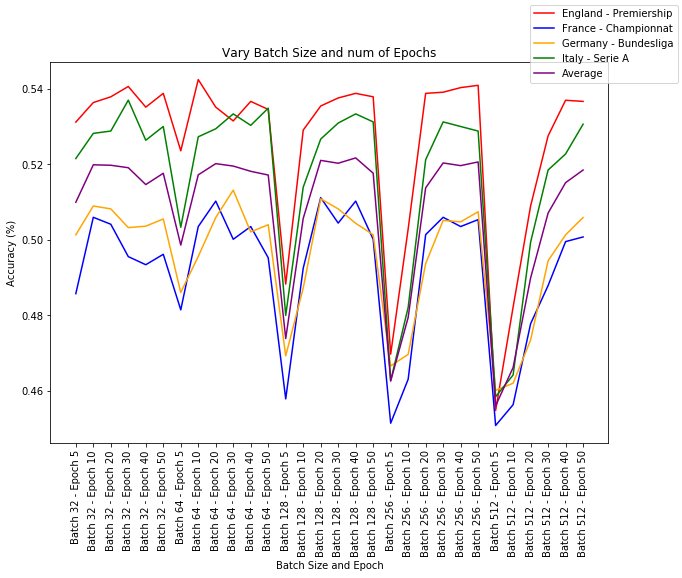

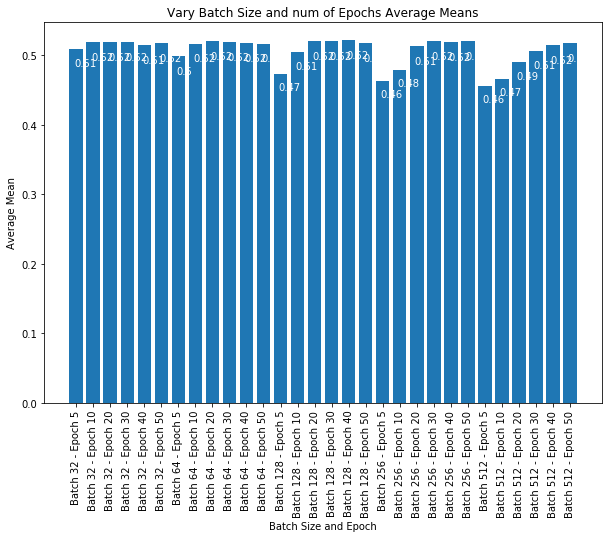

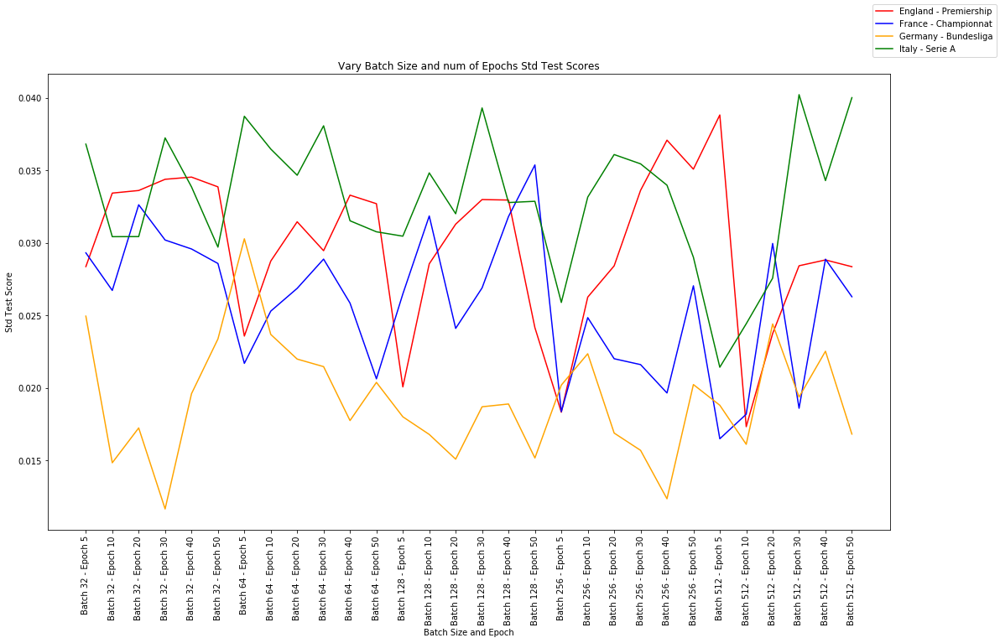

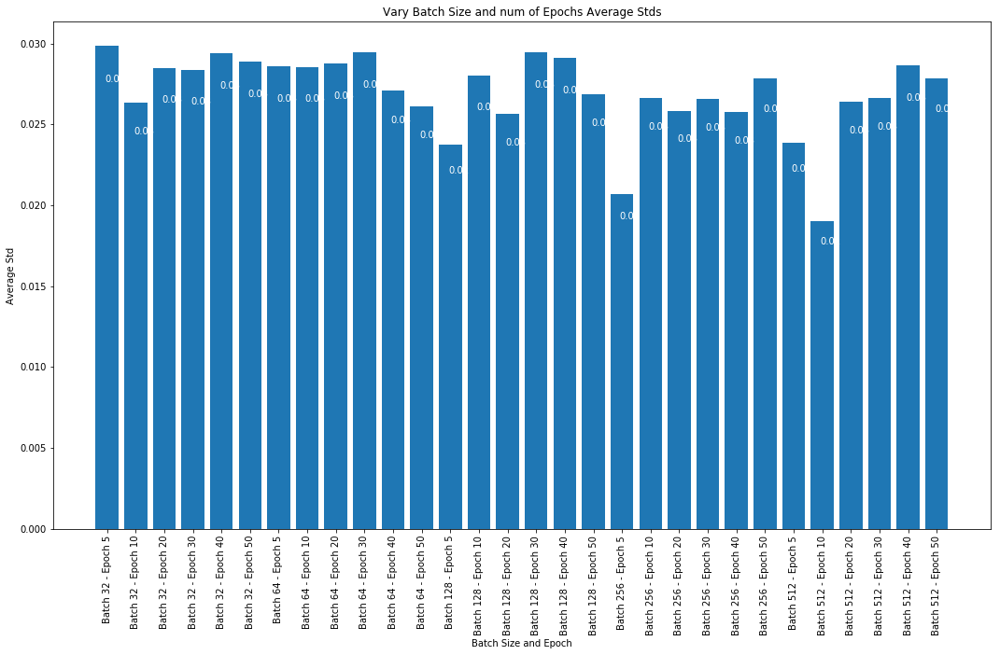

In [26]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls, 
                labels, 
                competitions, 
                "Batch Size and Epoch",
                "Vary Batch Size and num of Epochs",
                batch_size=batch_size, 
                epochs=epochs,
                learn_rate=[0.001],
                optimizer=["Adam"])

Running Separate Grid Search
Competition England - Premiership
Best: 0.544542 using {'batch_size': 128, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.497112 (0.033352) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.528428 (0.021215) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.537245 (0.030666) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.537549 (0.029896) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.540286 (0.033570) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.537853 (0.029132) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.479173 (0.020171) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.515962 (0.025008) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.539070 (0.0311

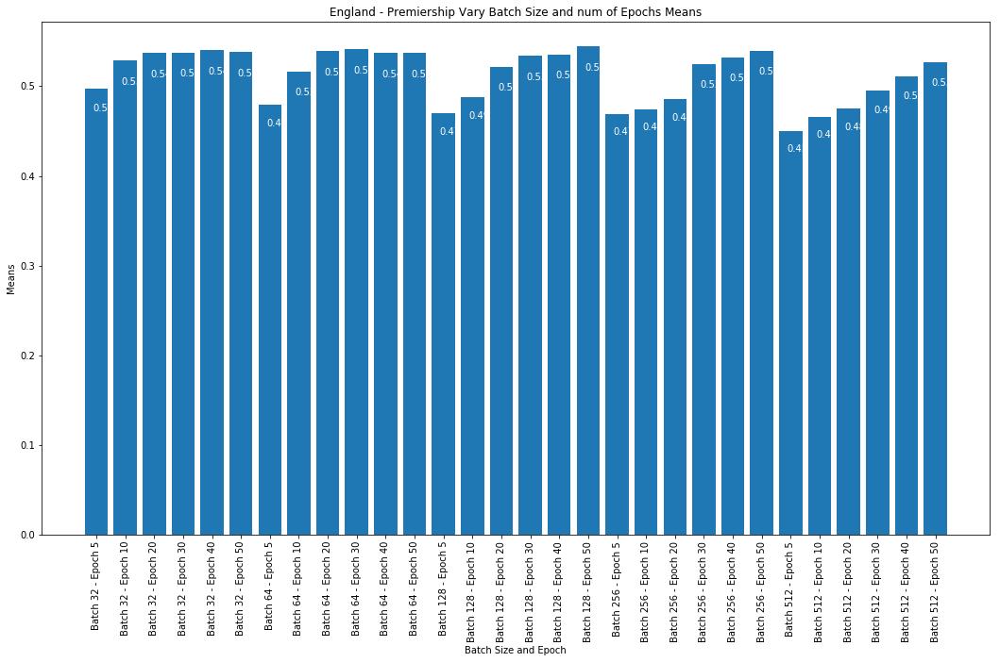

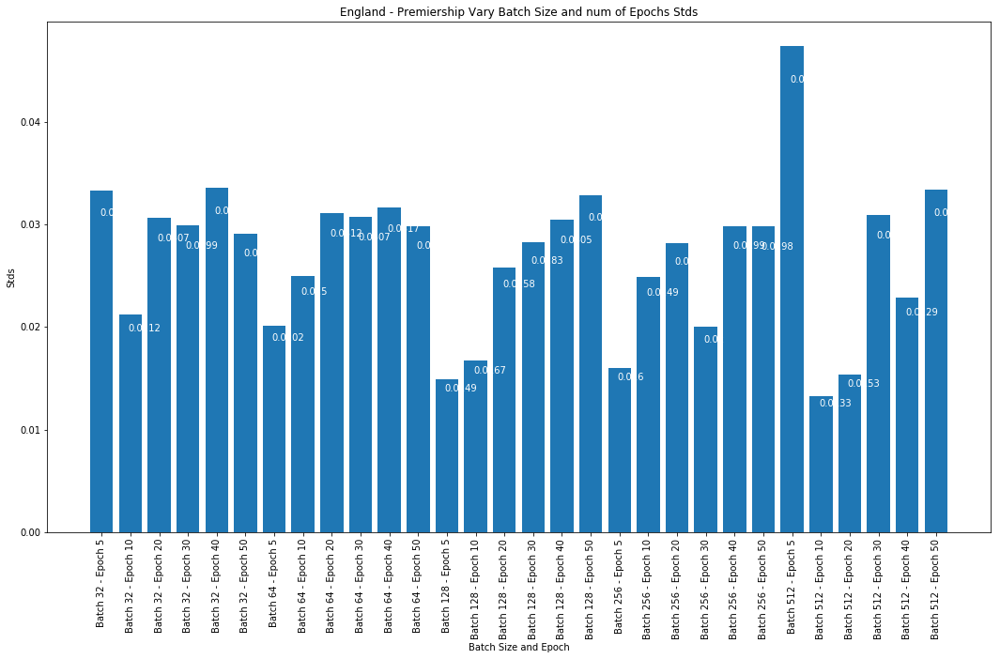

Competition France - Championnat
Best: 0.509948 using {'batch_size': 128, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.463728 (0.021419) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.481175 (0.025842) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.503826 (0.024174) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.508111 (0.025112) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.501990 (0.029739) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.505663 (0.021844) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.457300 (0.021116) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.473217 (0.018927) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.492195 (0.027309) with: {'batch_size': 64, '

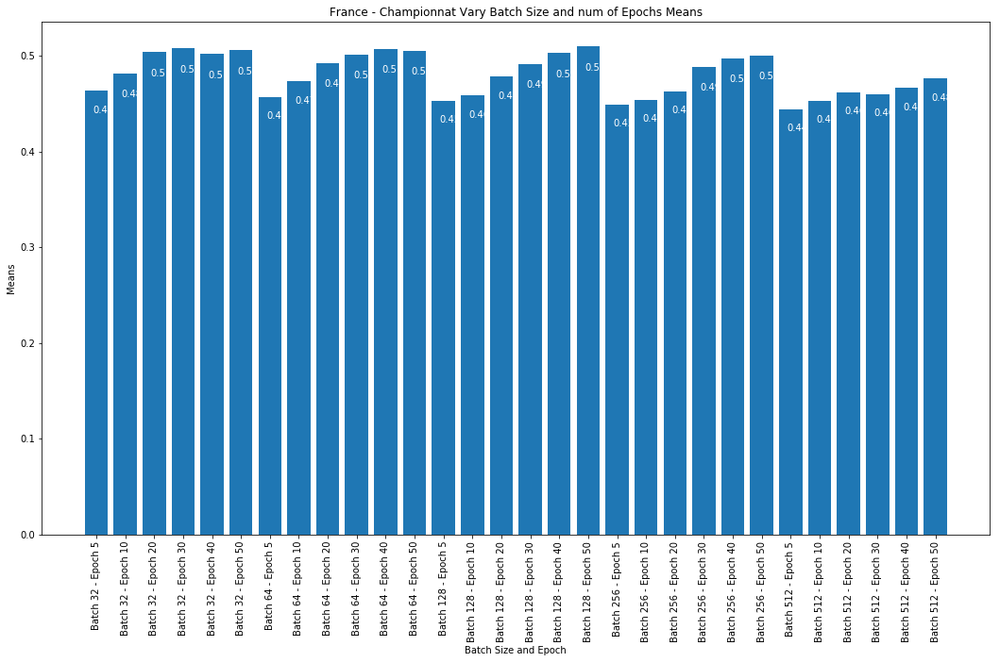

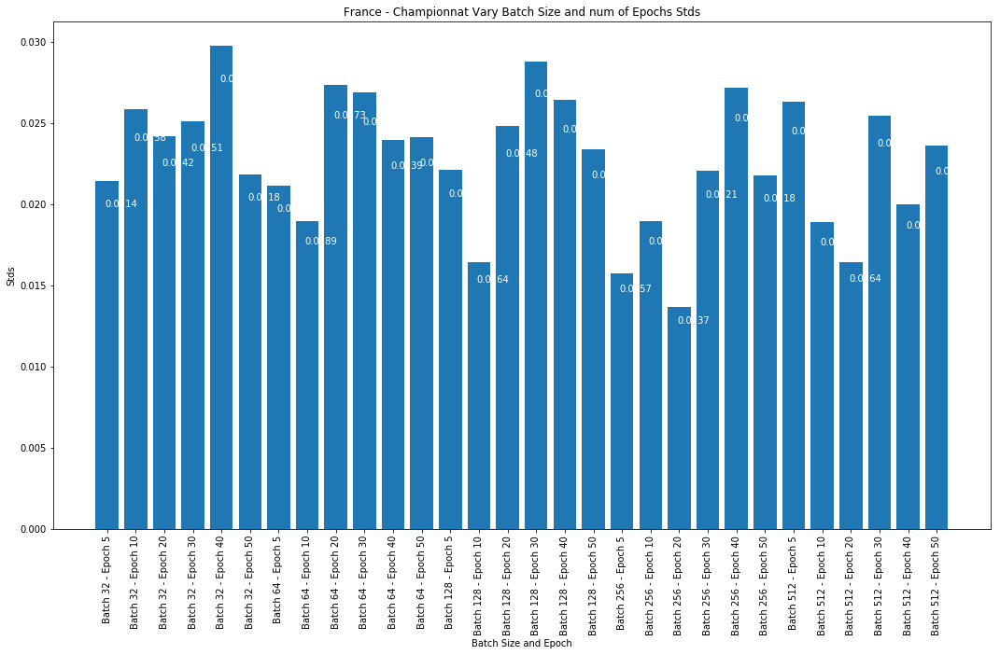

Competition Germany - Bundesliga
Best: 0.510865 using {'batch_size': 64, 'epochs': 50, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.500953 (0.015400) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.504003 (0.019986) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.505909 (0.016211) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.508959 (0.013673) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.505147 (0.014992) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.506672 (0.017057) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.492566 (0.028820) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.502859 (0.013384) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.504384 (0.020519) with: {'b

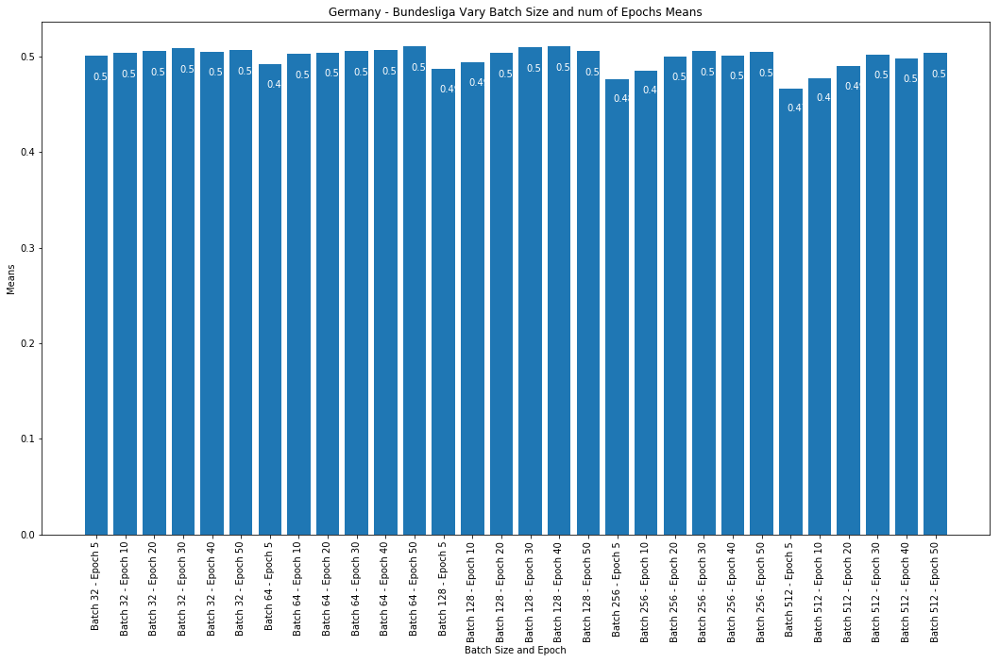

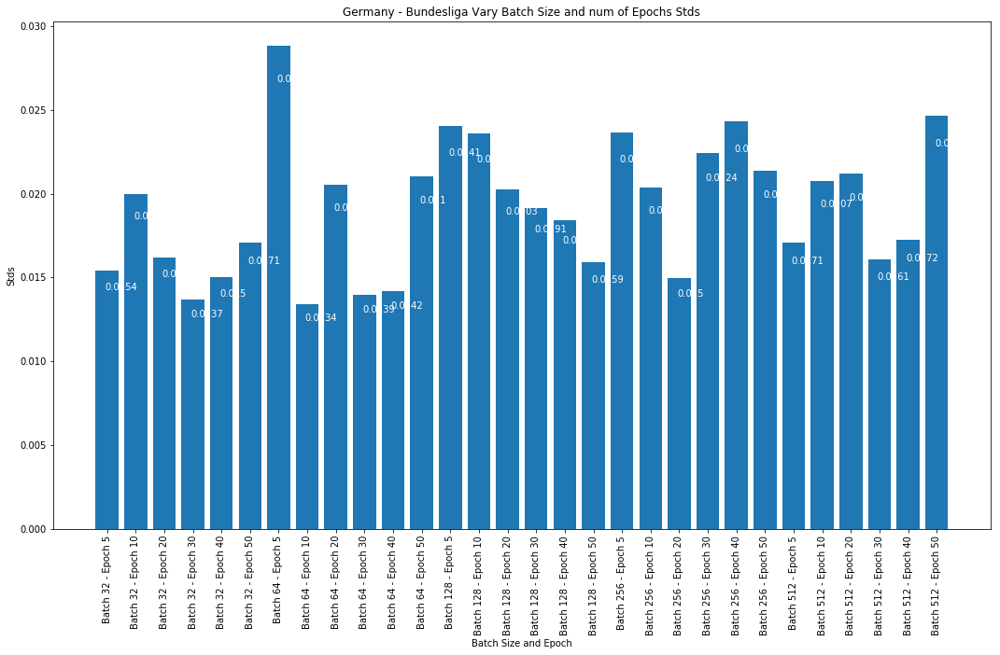

Competition Italy - Serie A
Best: 0.537273 using {'batch_size': 64, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.520606 (0.037673) with: {'batch_size': 32, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.520909 (0.032566) with: {'batch_size': 32, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.525758 (0.032020) with: {'batch_size': 32, 'epochs': 20, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.526667 (0.030838) with: {'batch_size': 32, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.529697 (0.032093) with: {'batch_size': 32, 'epochs': 40, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.534848 (0.034344) with: {'batch_size': 32, 'epochs': 50, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.510909 (0.031116) with: {'batch_size': 64, 'epochs': 5, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.523636 (0.032940) with: {'batch_size': 64, 'epochs': 10, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.532121 (0.033831) with: {'batch_size': 64

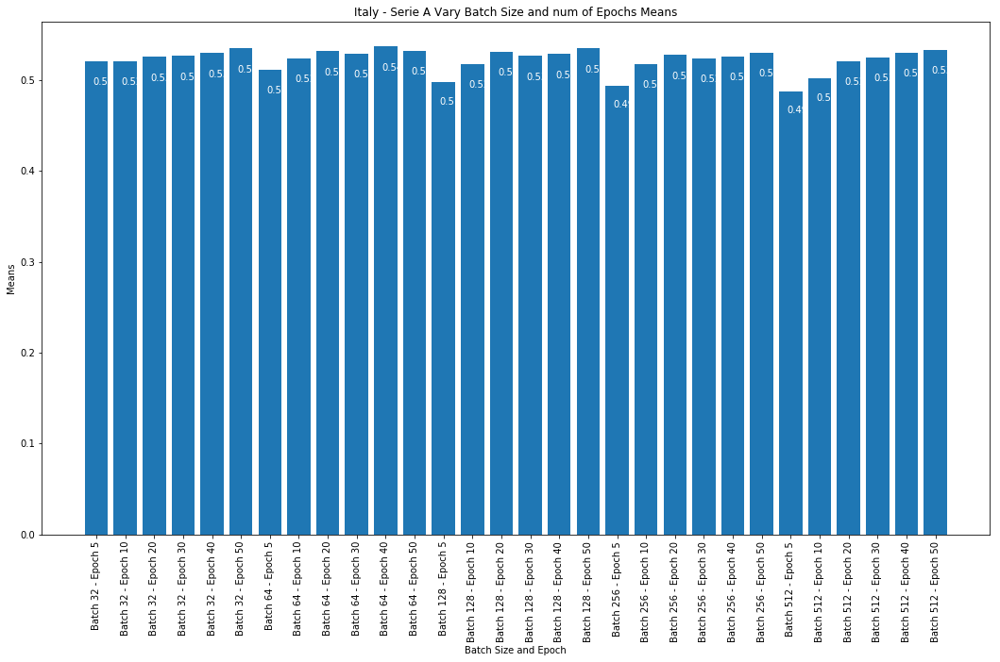

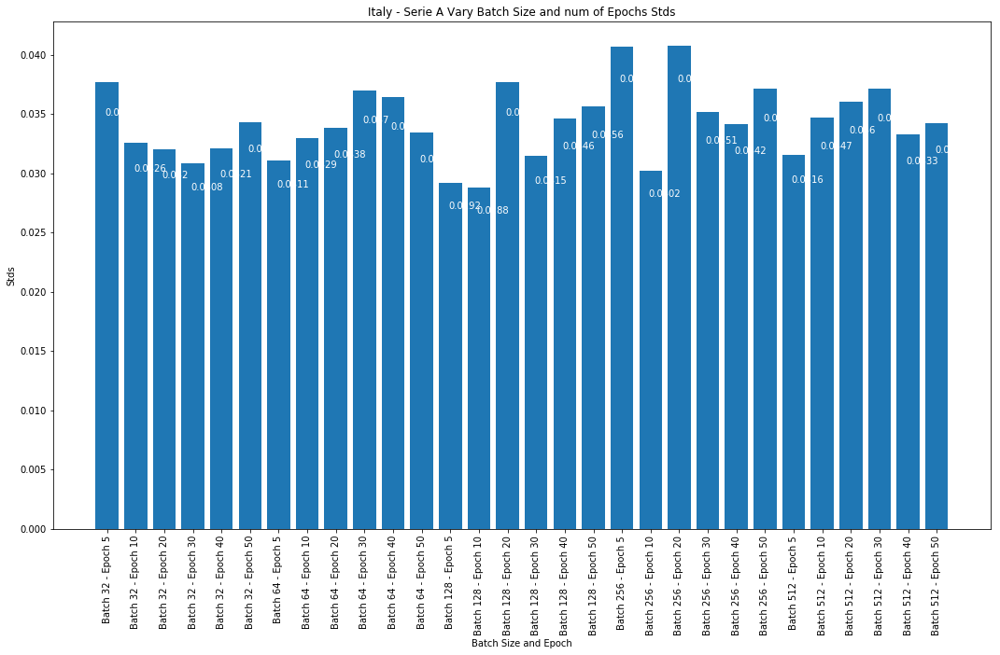

In [27]:
settings = {'England - Premiership': dict(learn_rate=[0.001],
                                          optimizer=["Adamax"]),
             'France - Championnat': dict(learn_rate=[0.001],
                                          optimizer=["Adamax"]),
             'Germany - Bundesliga': dict(learn_rate=[0.0005],
                                          optimizer=["Adagrad"]),
             'Italy - Serie A': dict(learn_rate=[0.001],
                                     optimizer=["Adagrad"])}
run_separate_grid_search(nn_08_17, 
                         nn_08_17_lbls,
                         labels, 
                         competitions, 
                         "Batch Size and Epoch",
                         "Vary Batch Size and num of Epochs",
                         settings,
                         batch_size=batch_size, 
                         epochs=epochs)

### Optimizer

In [60]:
optimizer = ['SGD', 'RMSprop', 'Adagrad', 'Adadelta', 'Adam', 'Adamax', 'Nadam']

Running Grid Search
Competition England - Premiership
Best: 0.541806 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.462147 (0.015662) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'SGD'}
0.536029 (0.034072) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'RMSprop'}
0.541806 (0.030353) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.535725 (0.026961) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adadelta'}
0.537549 (0.029441) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.533901 (0.023484) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.538157 (0.031447) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Nadam'}
Competition France - Championnat
Best: 0.507805 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer'

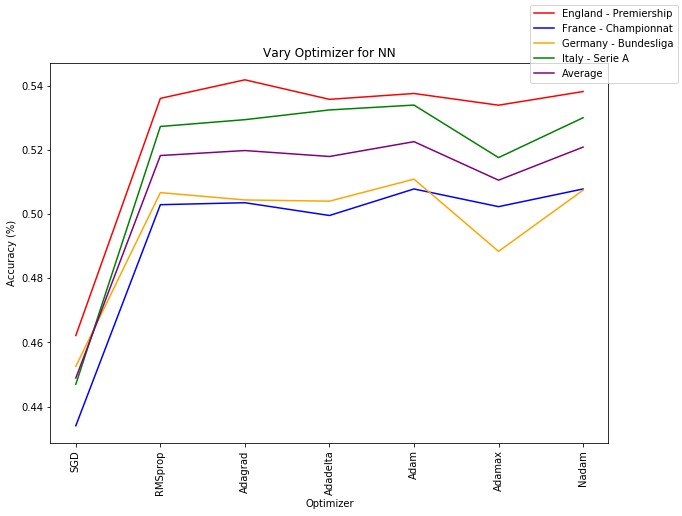

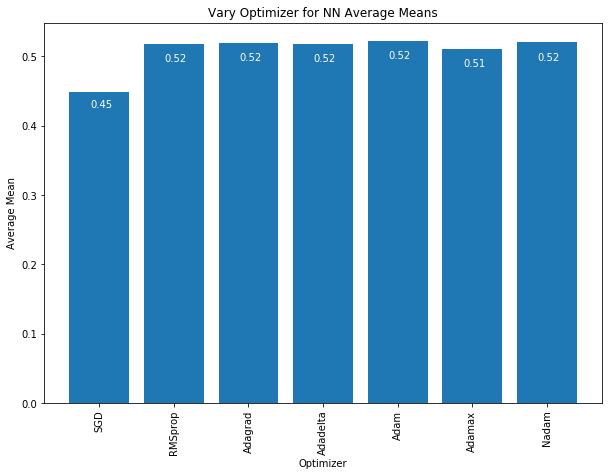

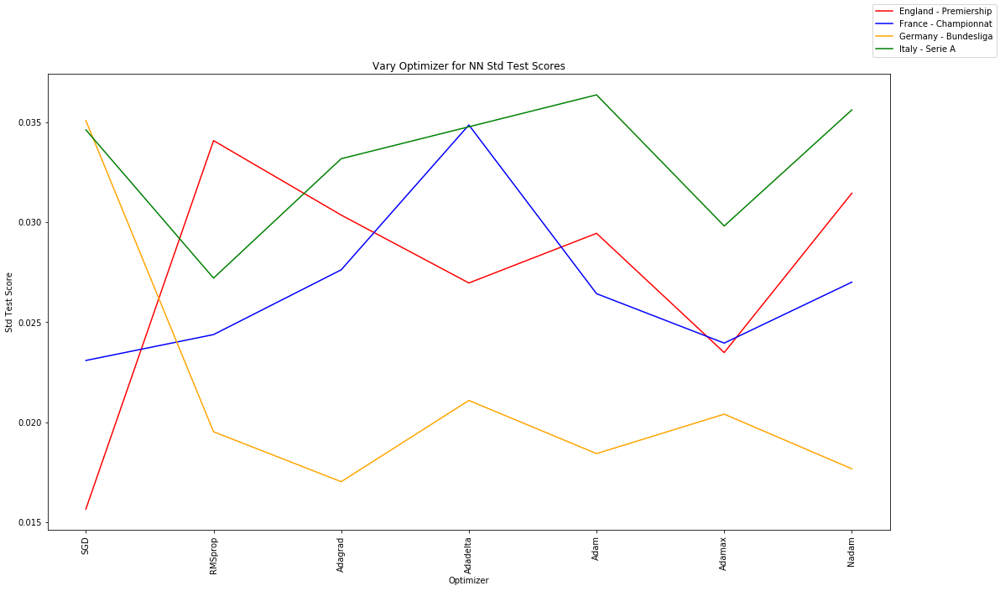

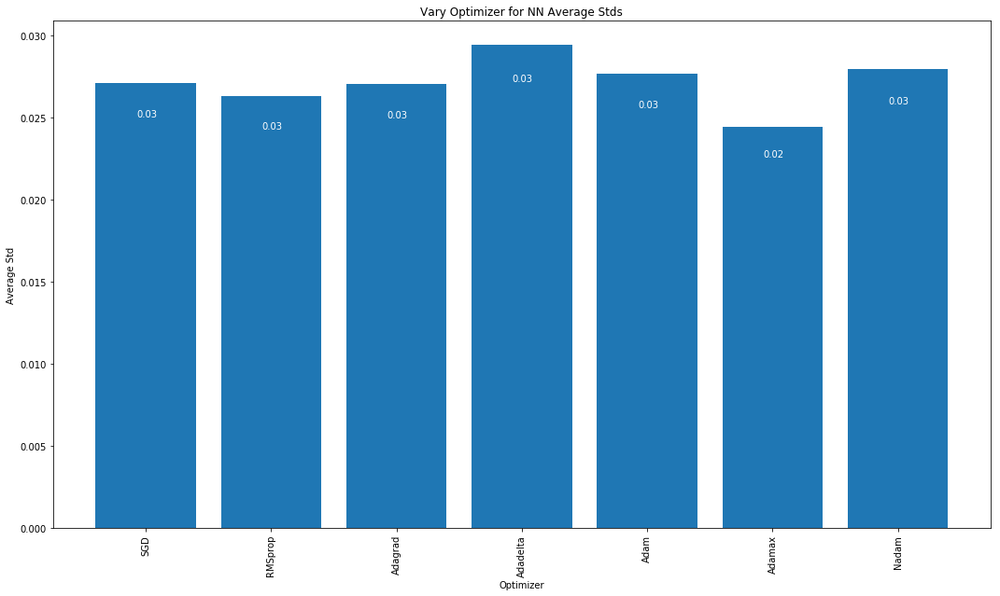

In [61]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls, 
                optimizer, 
                competitions, 
                "Optimizer",
                "Vary Optimizer for NN",
                optimizer=optimizer,
                batch_size=[128],
                epochs=[30],
                learn_rate=[0.001])

Running Separate Grid Search
Competition England - Premiership
Best: 0.545925 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adagrad'}
0.544563 (0.036823) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'SGD'}
0.537204 (0.052025) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'RMSprop'}
0.545925 (0.038088) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adagrad'}
0.544563 (0.039998) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adadelta'}
0.539929 (0.044059) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.535841 (0.033254) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adamax'}
0.535841 (0.042696) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Nadam'}
Best is Adagrad with value of 0.5459253295512835 (index 2)


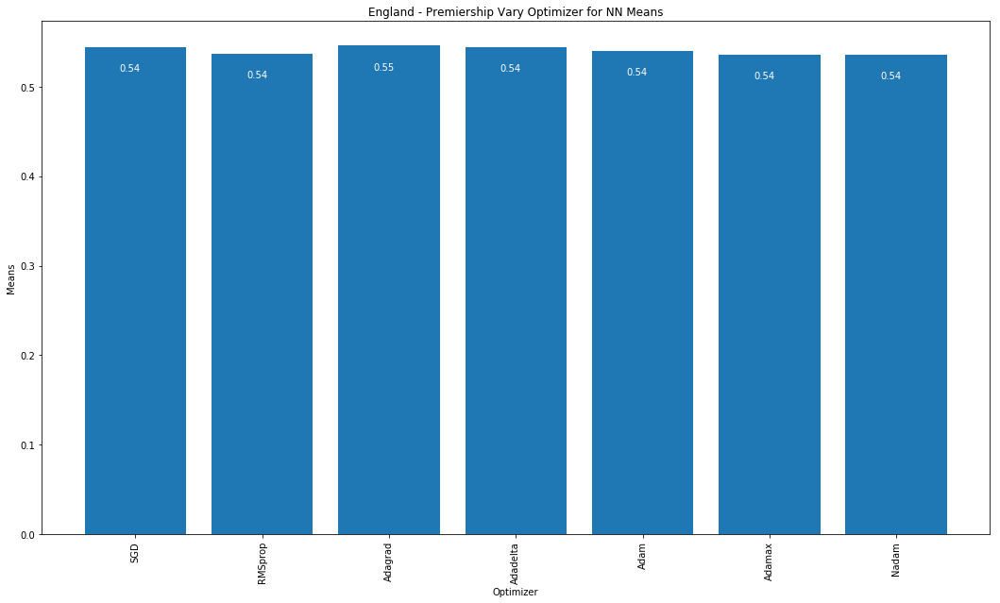

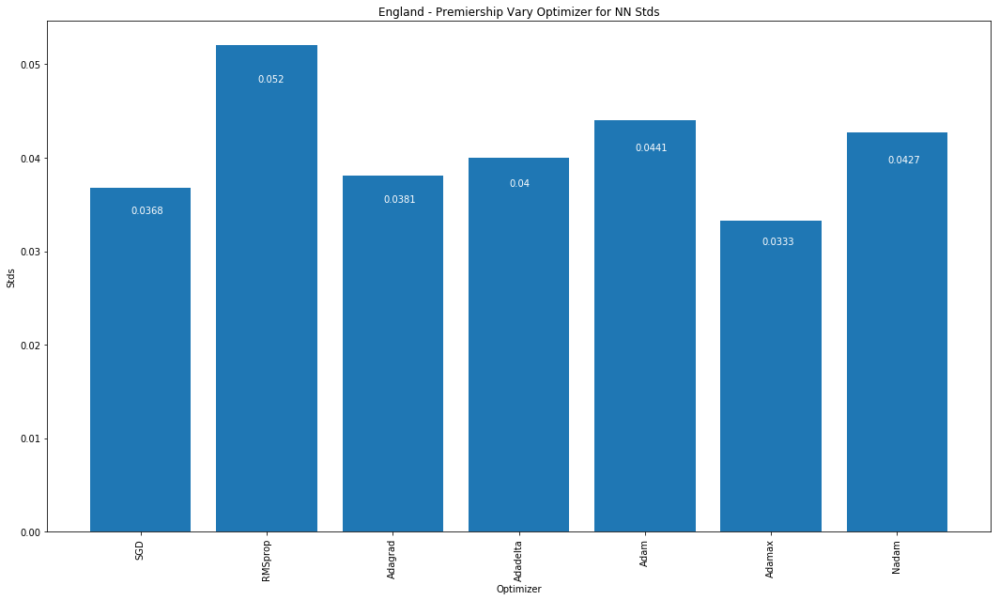

Competition France - Championnat
Best: 0.506479 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'RMSprop'}
0.442514 (0.021204) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'SGD'}
0.506479 (0.024912) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'RMSprop'}
0.503171 (0.028934) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.500689 (0.029720) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adadelta'}
0.502895 (0.029277) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.494624 (0.021173) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.499586 (0.028363) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Nadam'}
Best is RMSprop with value of 0.5064791832822789 (index 1)


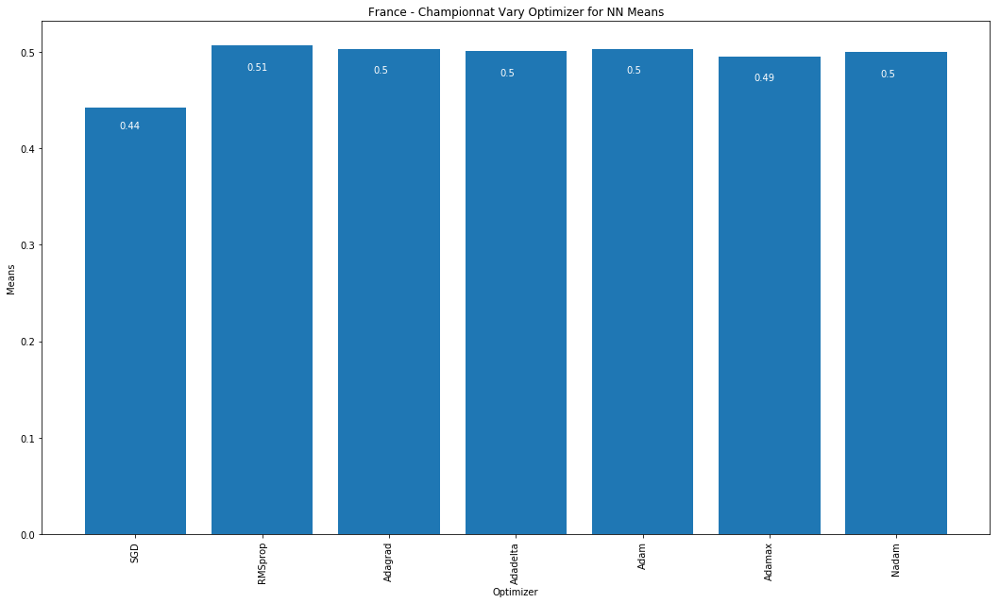

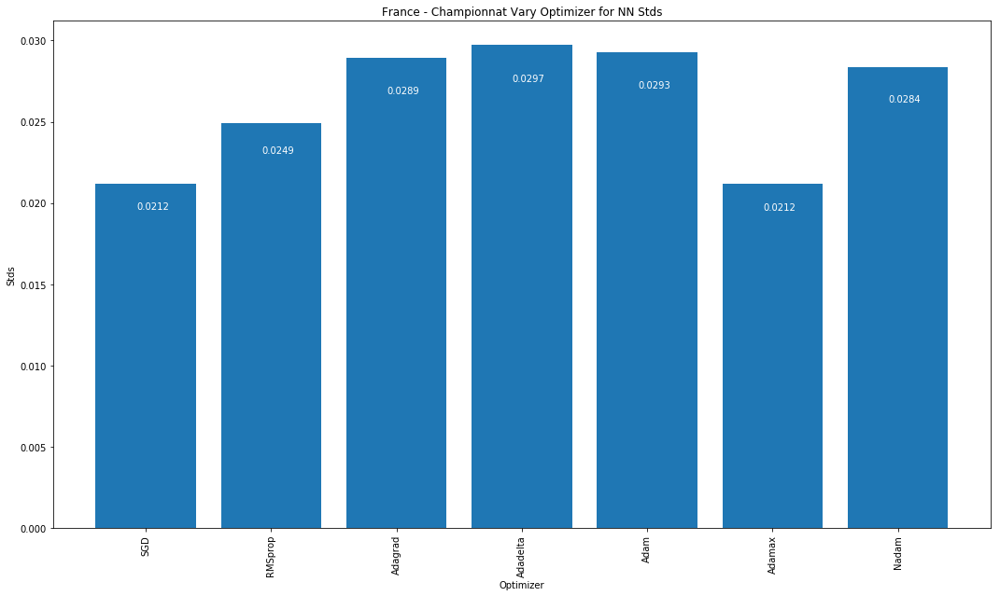

Competition Germany - Bundesliga
Best: 0.508023 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adadelta'}
0.463298 (0.011716) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'SGD'}
0.493684 (0.021181) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'RMSprop'}
0.498464 (0.012275) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adagrad'}
0.508023 (0.018697) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adadelta'}
0.497098 (0.020231) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.505975 (0.015962) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adamax'}
0.502561 (0.017023) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Nadam'}
Best is Adadelta with value of 0.5080232173560544 (index 3)


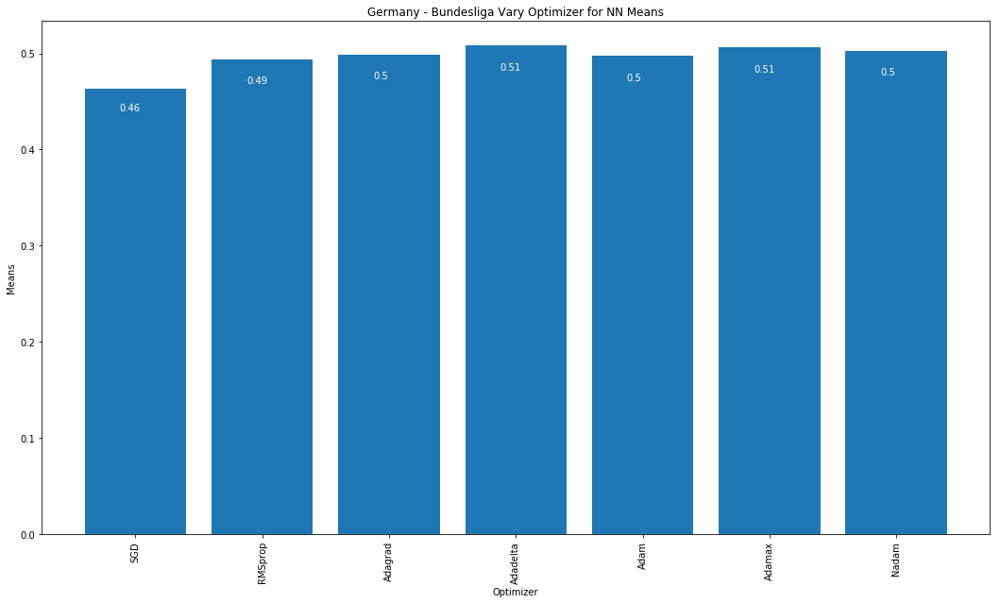

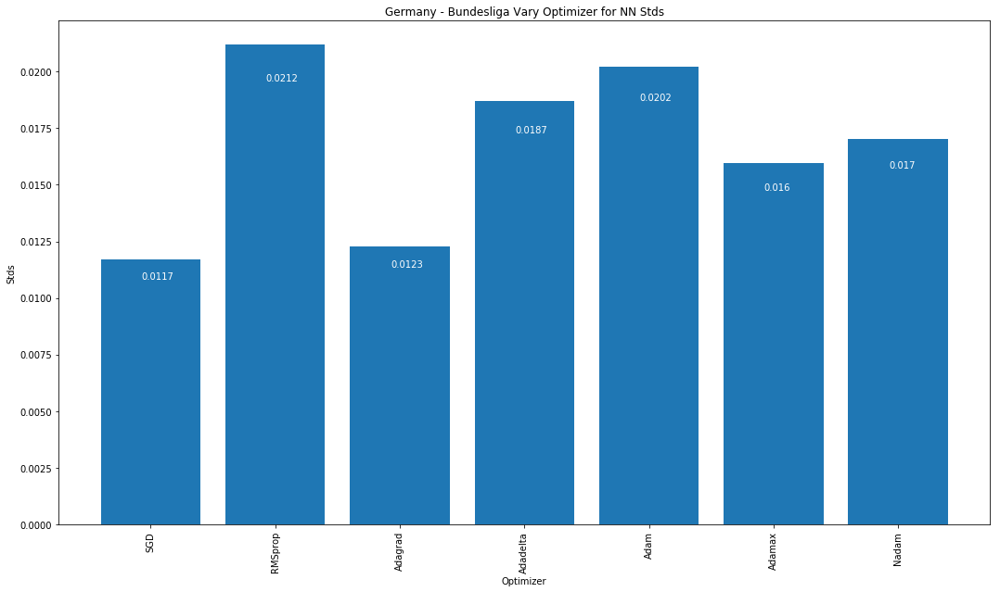

Competition Italy - Serie A
Best: 0.532880 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adadelta'}
0.512772 (0.032131) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'SGD'}
0.520109 (0.032111) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'RMSprop'}
0.530163 (0.027240) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adagrad'}
0.532880 (0.032002) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adadelta'}
0.530707 (0.045471) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.523641 (0.030552) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adamax'}
0.526902 (0.035294) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Nadam'}
Best is Adadelta with value of 0.532880425453186 (index 3)


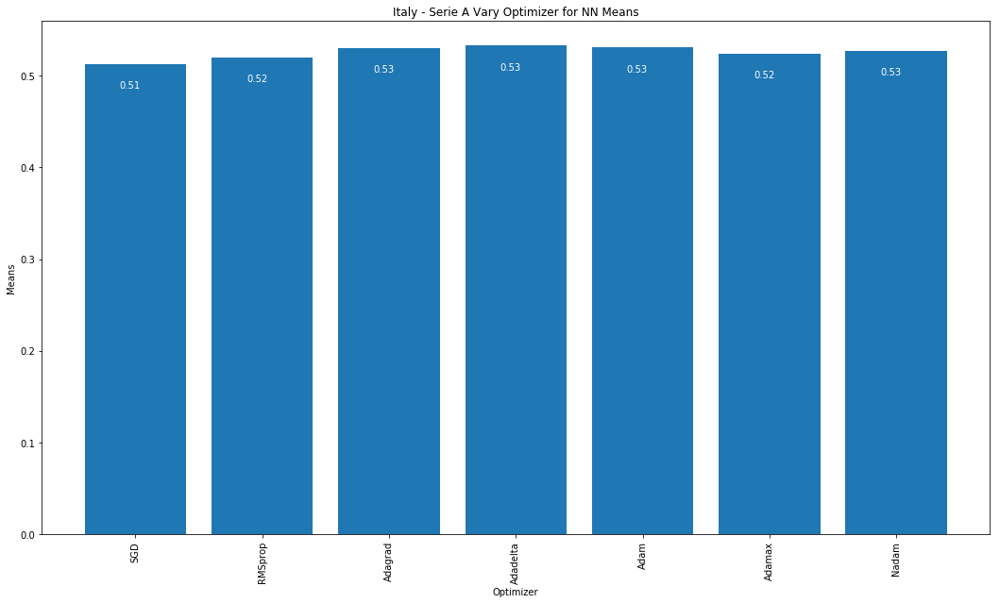

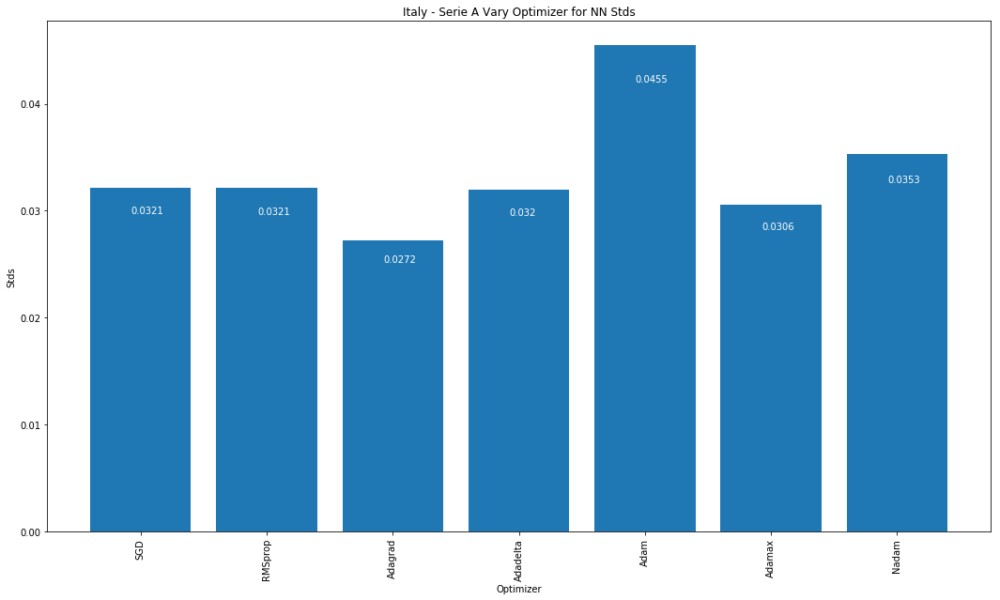

In [62]:
settings = {'England - Premiership': dict(batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.05]),
             'France - Championnat': dict(batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001]),
             'Germany - Bundesliga': dict(batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.005]),
             'Italy - Serie A': dict(batch_size=[128],
                                     epochs=[30],
                                     learn_rate=[0.05])}
run_separate_grid_search(nn_all, 
                         nn_all_lbls, 
                         optimizer, 
                         competitions, 
                         "Optimizer",
                         "Vary Optimizer for NN",
                         settings,
                         optimizer=optimizer)

### Vary Optimizer parameters

In [32]:
learn_rate = [0.0001, 0.0005, 0.00075, 0.001, 0.0025, 0.005, 0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4]
# beta_1 = [0.5, 0.6, 0.7, 0.8, 0.9, 0.1, 0.11, 0.125, 0.15]
labels = []

for lr in learn_rate:
    labels.append("Learning Rate %s" % (lr))

"""
for lr in learn_rate:
    for b1 in beta_1:
        labels.append("Learning Rate %s - Beta 1 %s" % (lr, b1))
"""        


'\nfor lr in learn_rate:\n    for b1 in beta_1:\n        labels.append("Learning Rate %s - Beta 1 %s" % (lr, b1))\n'

Running Grid Search
Competition England - Premiership
Best: 0.542382 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.542382 (0.039671) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.538294 (0.039679) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.540474 (0.038249) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.01, 'optimizer': 'Adam'}
0.538021 (0.045754) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.520305 (0.050216) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.1, 'optimizer': 'Adam'}
0.491142 (0.053190) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.15, 'optimizer': 'Adam'}
0.479967 (0.035562) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.2, 'optimizer': 'Adam'}
0.449441 (0.071196) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.25, 'optimizer': 'Adam'}
0.369583 (0.102753) with: {'batch_size': 

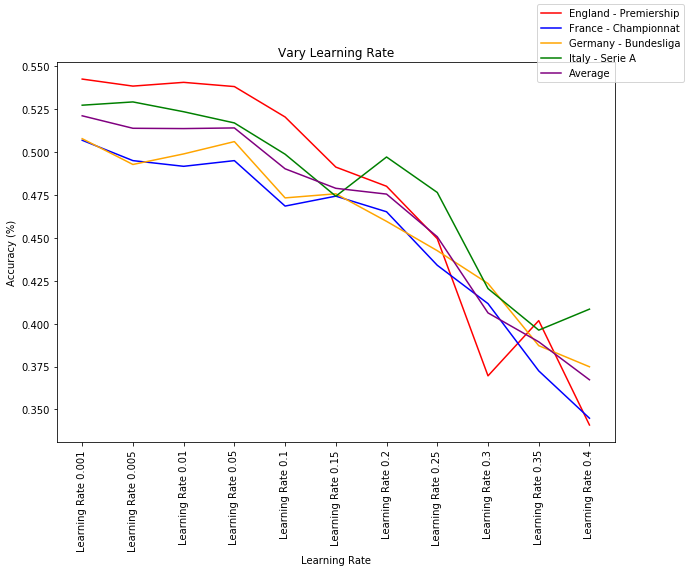

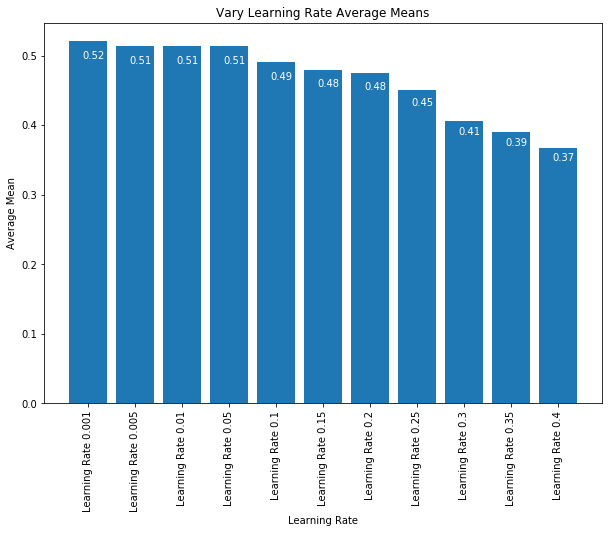

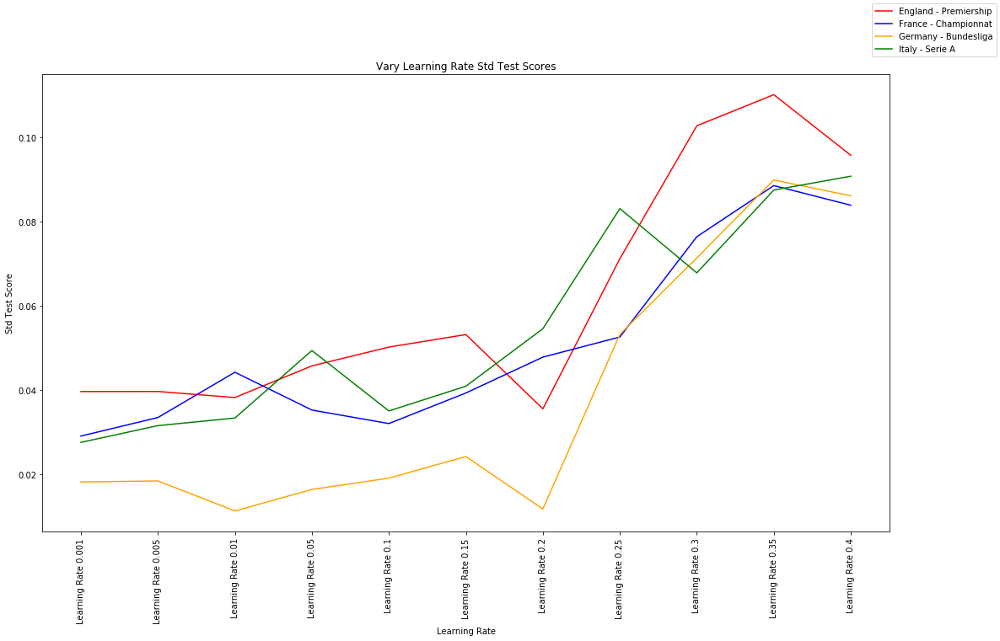

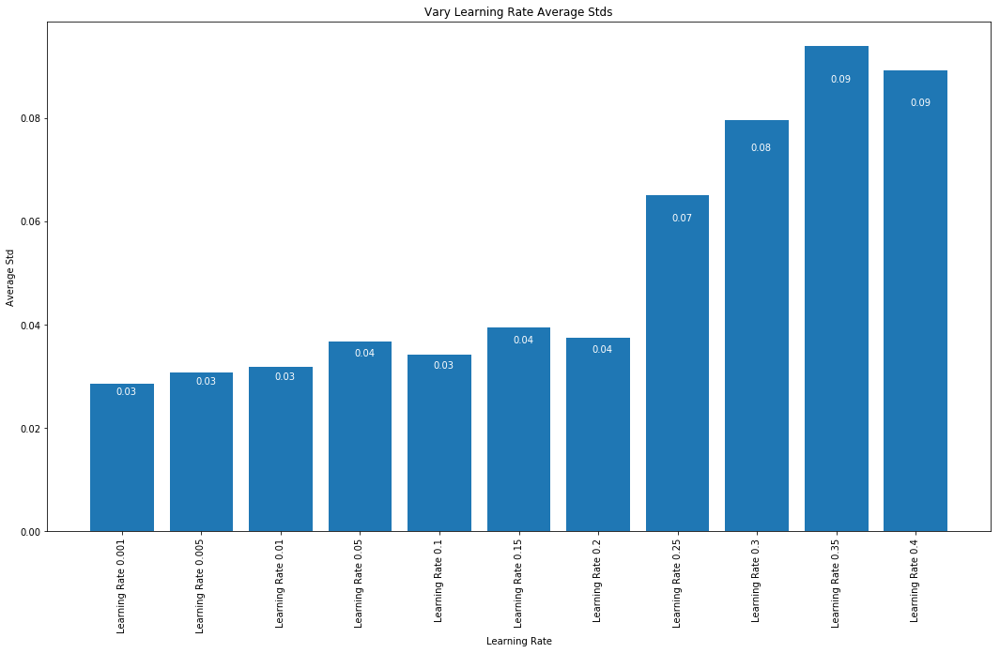

In [58]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls, 
                labels, 
                competitions, 
                "Learning Rate",
                "Vary Learning Rate",
                learn_rate=learn_rate,
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"])

Running Separate Grid Search
Competition England - Premiership
Best: 0.541198 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.537549 (0.033599) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.533597 (0.033342) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.535117 (0.030837) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.01, 'optimizer': 'Adam'}
0.541198 (0.029754) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.487078 (0.042093) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.1, 'optimizer': 'Adam'}
0.513530 (0.039118) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.15, 'optimizer': 'Adam'}
0.490119 (0.059991) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.2, 'optimizer': 'Adam'}
0.392825 (0.114257) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.25, 'optimizer': 'Adam'}
0.416236 (0.090045) with: {'batch

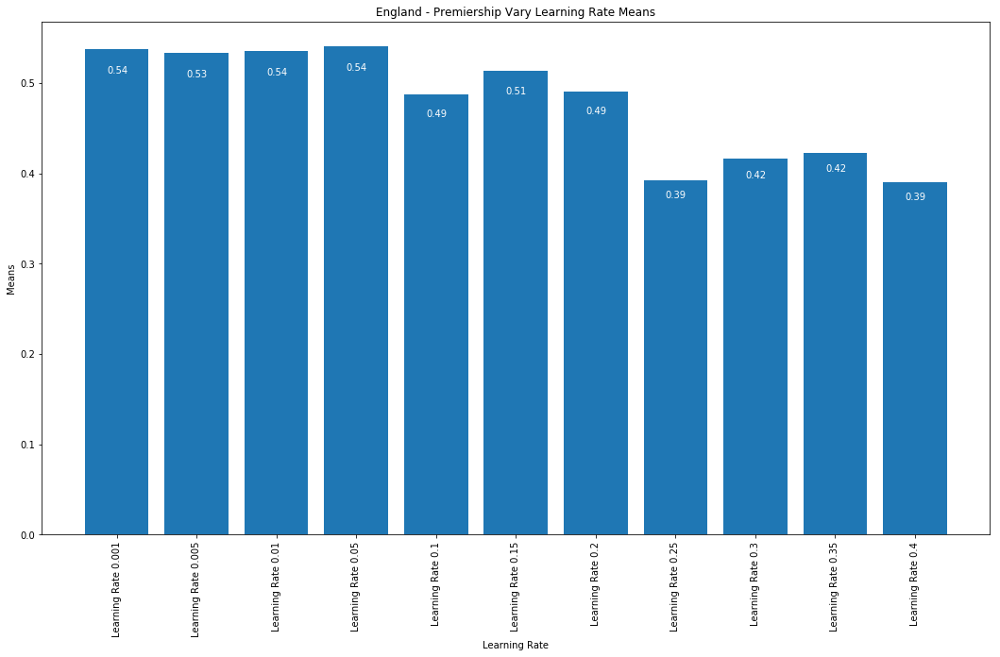

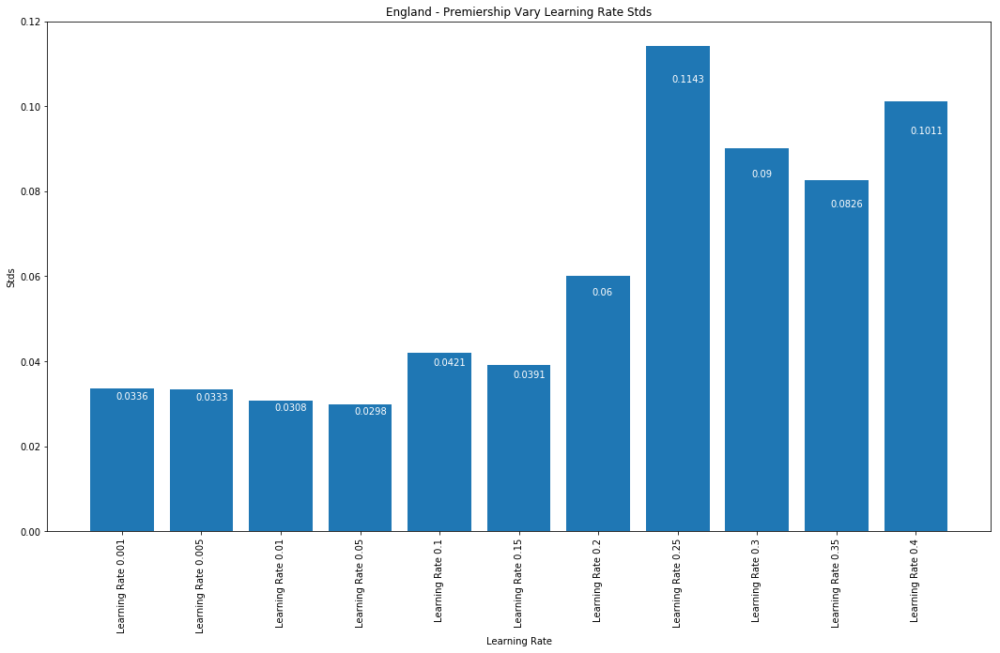

Competition France - Championnat
Best: 0.500153 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.500153 (0.029137) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.487909 (0.029326) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.496174 (0.028396) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.01, 'optimizer': 'Adam'}
0.498316 (0.030537) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.491889 (0.033129) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.1, 'optimizer': 'Adam'}
0.461892 (0.025391) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.15, 'optimizer': 'Adam'}
0.461586 (0.032346) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.2, 'optimizer': 'Adam'}
0.450872 (0.017463) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.25, 'optimizer': 'Adam'}
0.431895 (0.058970) with: {'batch_size': 128, 'epochs': 30, 'l

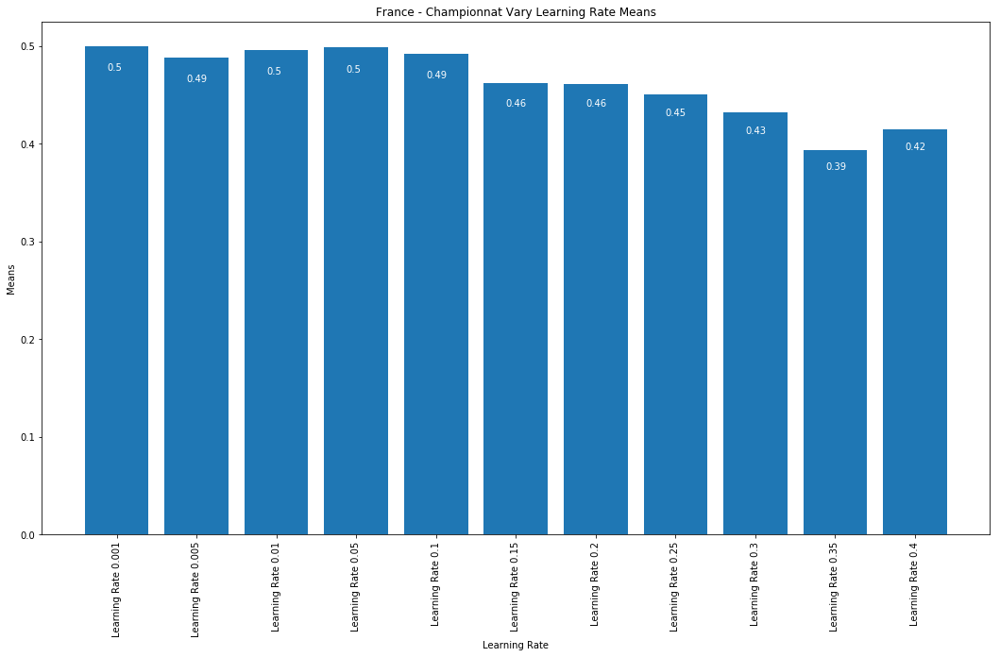

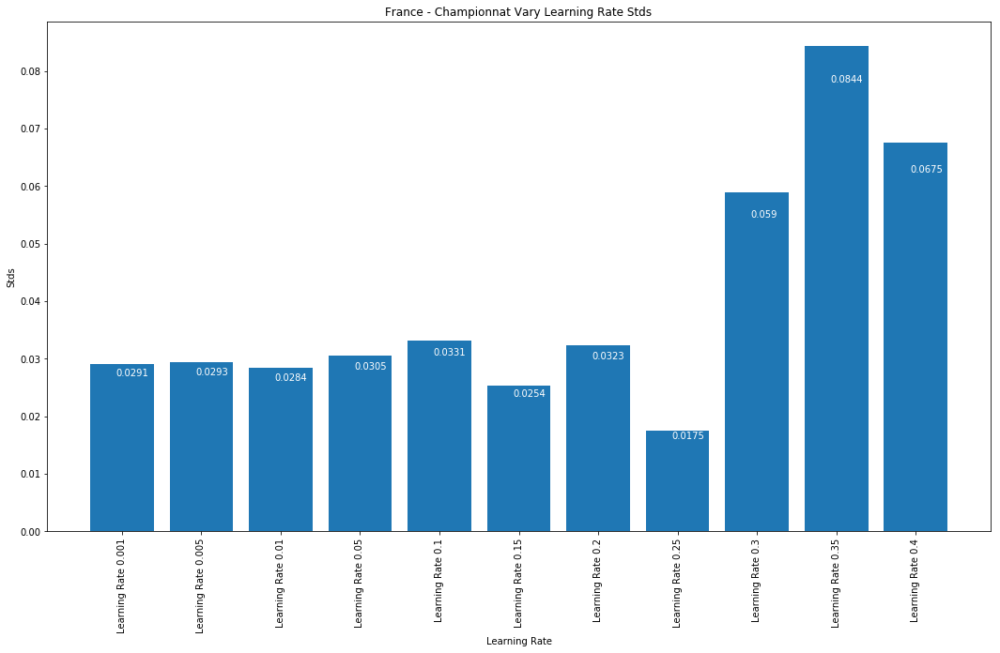

Competition Germany - Bundesliga
Best: 0.510103 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.500572 (0.020484) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.510103 (0.014094) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.501716 (0.017575) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.01, 'optimizer': 'Adam'}
0.504766 (0.015116) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.487610 (0.031155) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.1, 'optimizer': 'Adam'}
0.479222 (0.026926) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.15, 'optimizer': 'Adam'}
0.476935 (0.025455) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.2, 'optimizer': 'Adam'}
0.460160 (0.017707) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.25, 'optimizer': 'Adam'}
0.401449 (0.092731) with: {'batch_size': 128, 'epochs': 30, 'l

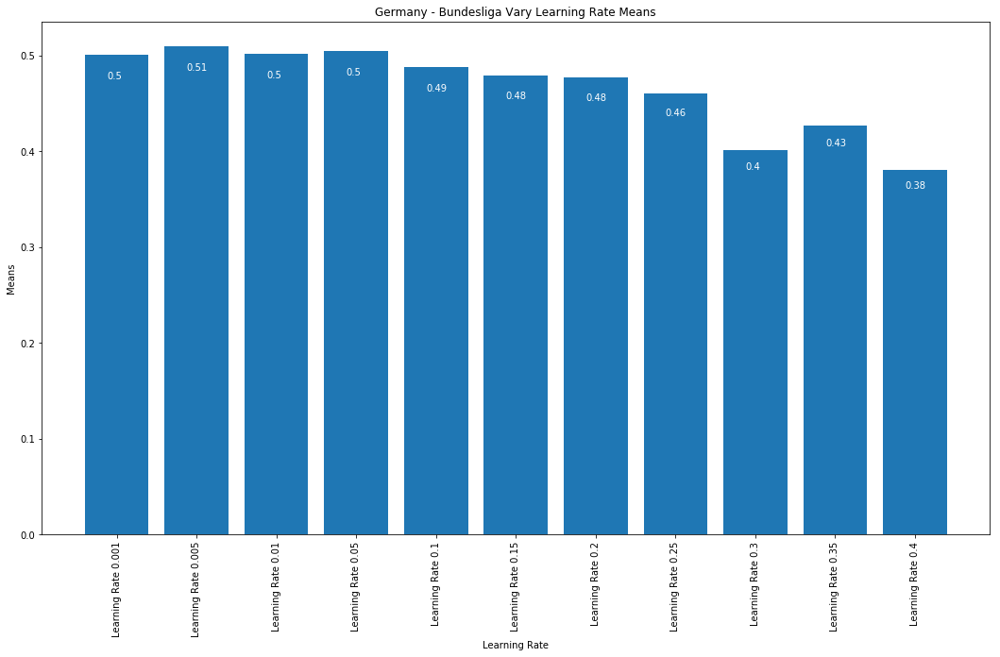

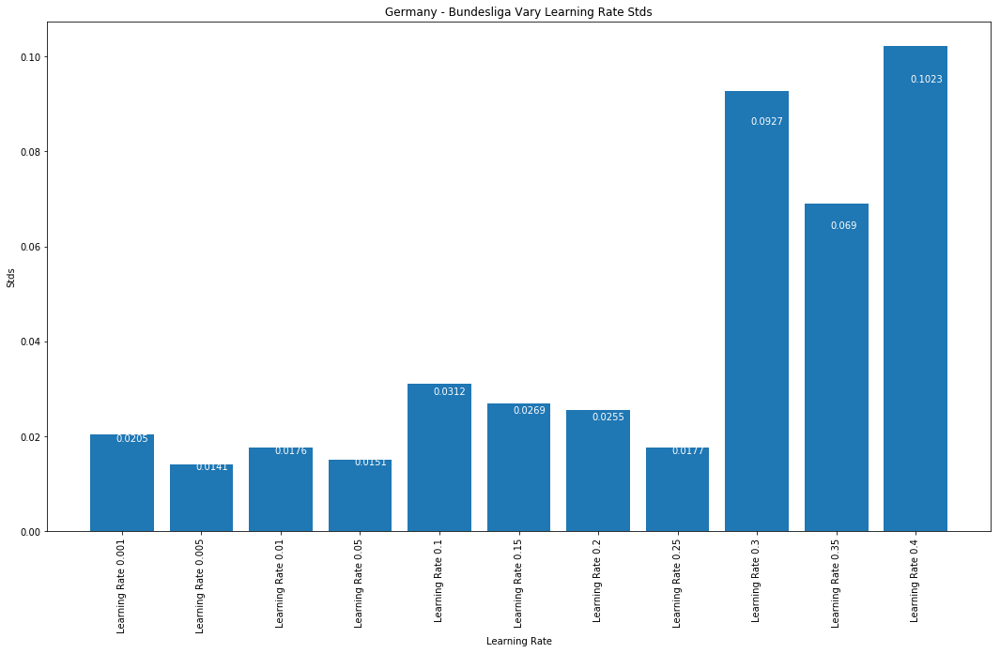

Competition Italy - Serie A
Best: 0.534848 using {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.532727 (0.032264) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.527273 (0.032298) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.005, 'optimizer': 'Adam'}
0.526970 (0.029828) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.01, 'optimizer': 'Adam'}
0.534848 (0.030851) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.05, 'optimizer': 'Adam'}
0.503636 (0.032660) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.1, 'optimizer': 'Adam'}
0.494242 (0.036501) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.15, 'optimizer': 'Adam'}
0.488182 (0.051577) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.2, 'optimizer': 'Adam'}
0.437273 (0.091504) with: {'batch_size': 128, 'epochs': 30, 'learn_rate': 0.25, 'optimizer': 'Adam'}
0.395152 (0.088868) with: {'batch_size': 128, 'epochs': 30, 'learn_r

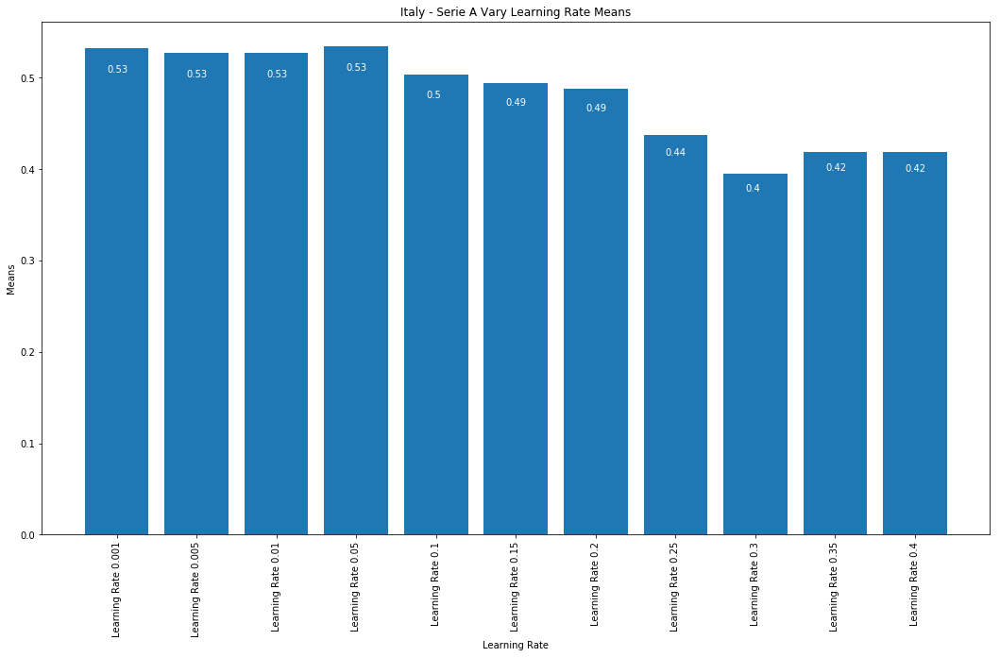

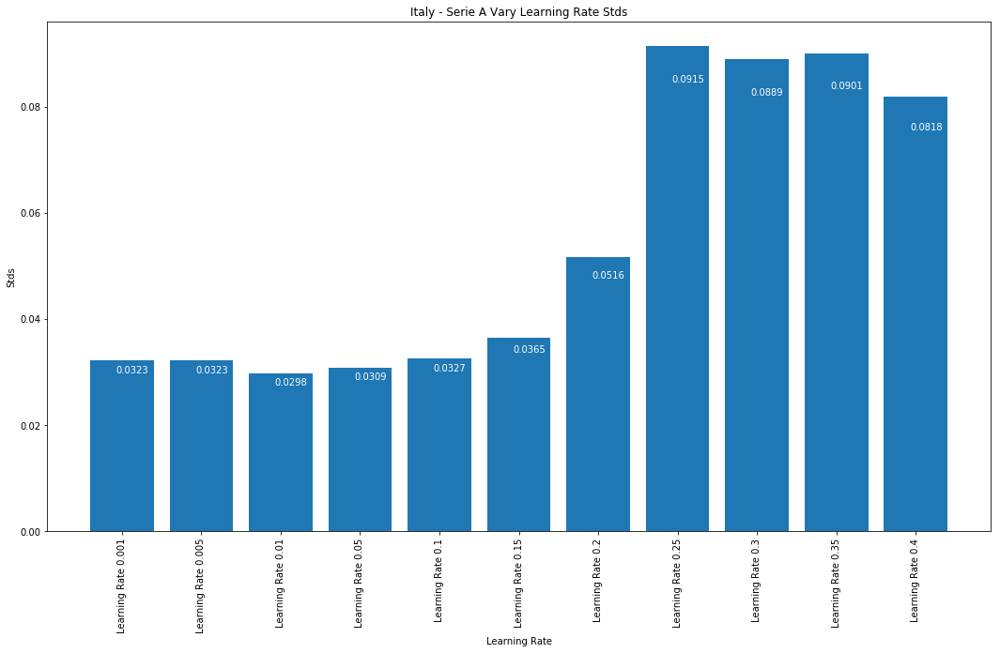

In [59]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[128],
                                          epochs=[50]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[30])}
run_separate_grid_search(nn_08_17, 
                         nn_08_17_lbls, 
                         labels, 
                         competitions, 
                         "Learning Rate",
                         "Vary Learning Rate",
                         settings,
                         learn_rate=learn_rate)

### Kernel Initialiser

In [10]:
init_mode = ['uniform', 'lecun_uniform', 'normal', 'zero', 'glorot_normal', 'glorot_uniform', 'he_normal', 'he_uniform']

Running Grid Search
Competition England - Premiership


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


Best: 0.541198 using {'batch_size': 128, 'epochs': 30, 'init_mode': 'uniform', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.541198 (0.030946) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'uniform', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.540894 (0.036592) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'lecun_uniform', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.535421 (0.031079) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'normal', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.465795 (0.014828) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'zero', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.539374 (0.030145) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_normal', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.539678 (0.032503) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.538462 (0.028813) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'he_normal', 'learn_rate': 0.001, '

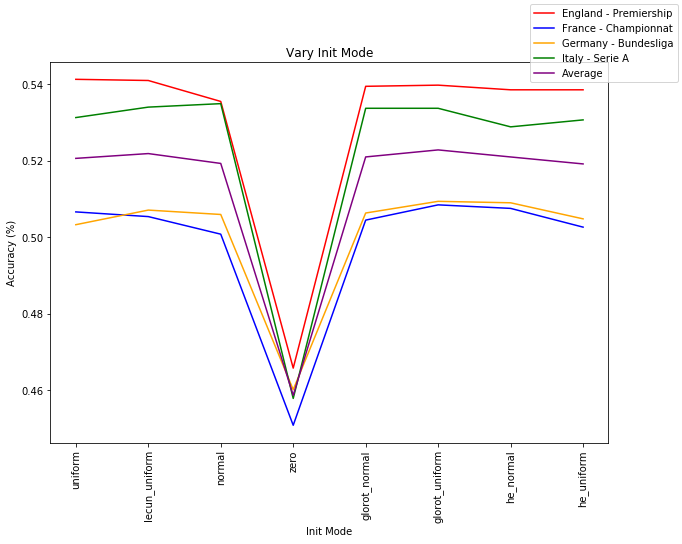

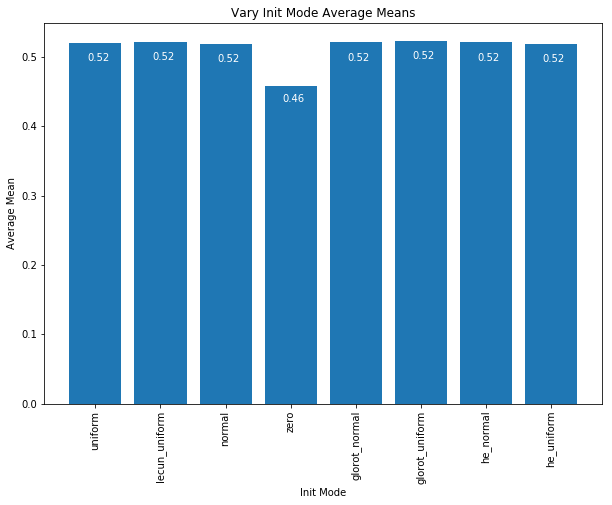

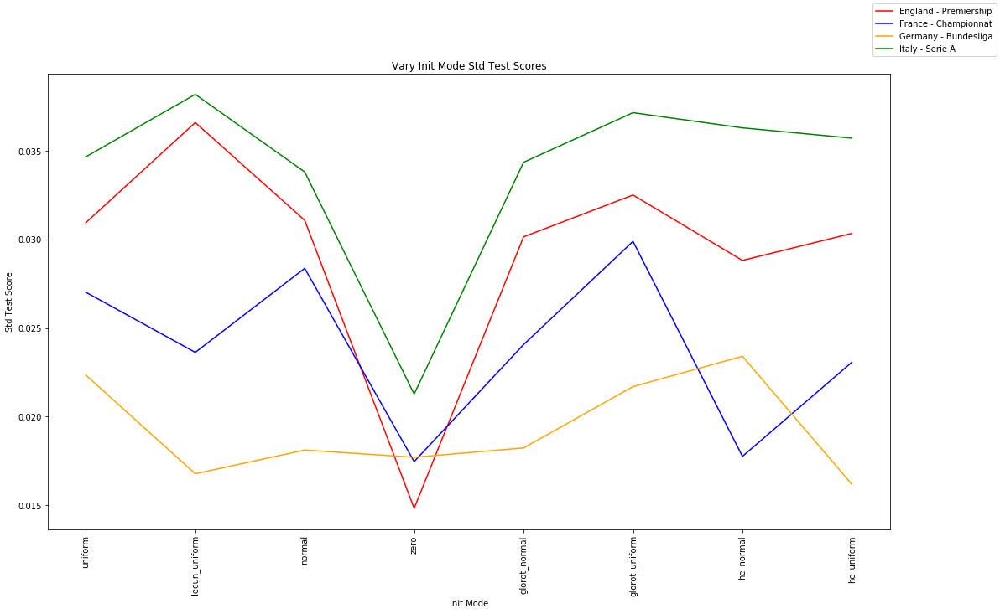

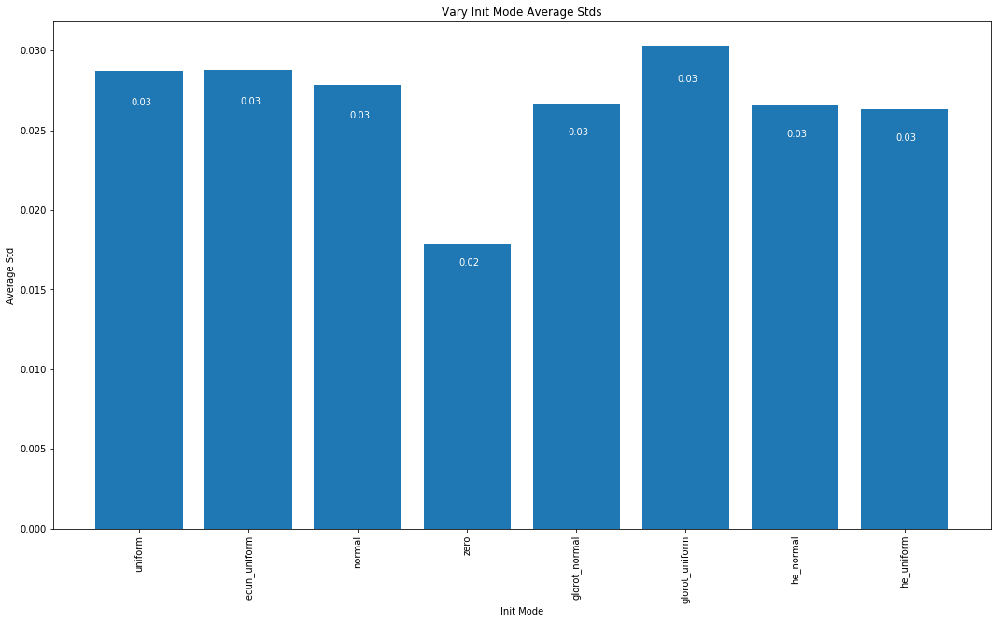

In [34]:
run_grid_search(nn_08_17,
                nn_08_17_lbls, 
                init_mode, 
                competitions, 
                "Init Mode",
                "Vary Init Mode",
                init_mode=init_mode,
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"],
                learn_rate=[0.001])

Running Separate Grid Search
Competition England - Premiership
Best: 0.538462 using {'batch_size': 128, 'epochs': 30, 'init_mode': 'normal', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.529036 (0.030777) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.528732 (0.030542) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'lecun_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.538462 (0.027276) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'normal', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.465795 (0.014828) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'zero', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.530556 (0.032490) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_normal', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.529340 (0.021919) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.526604 (0.020592) with: {'batc

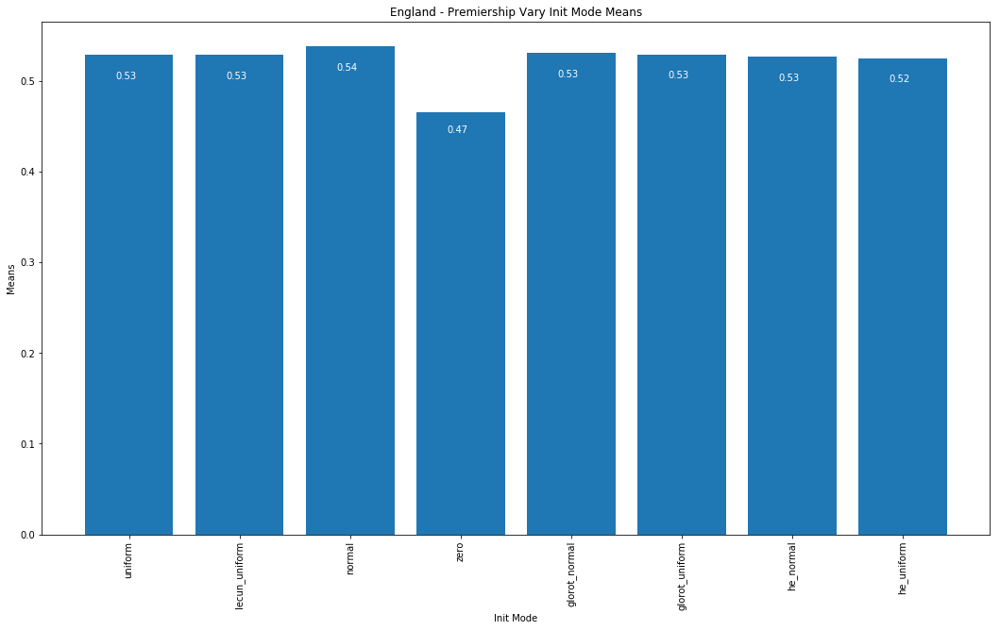

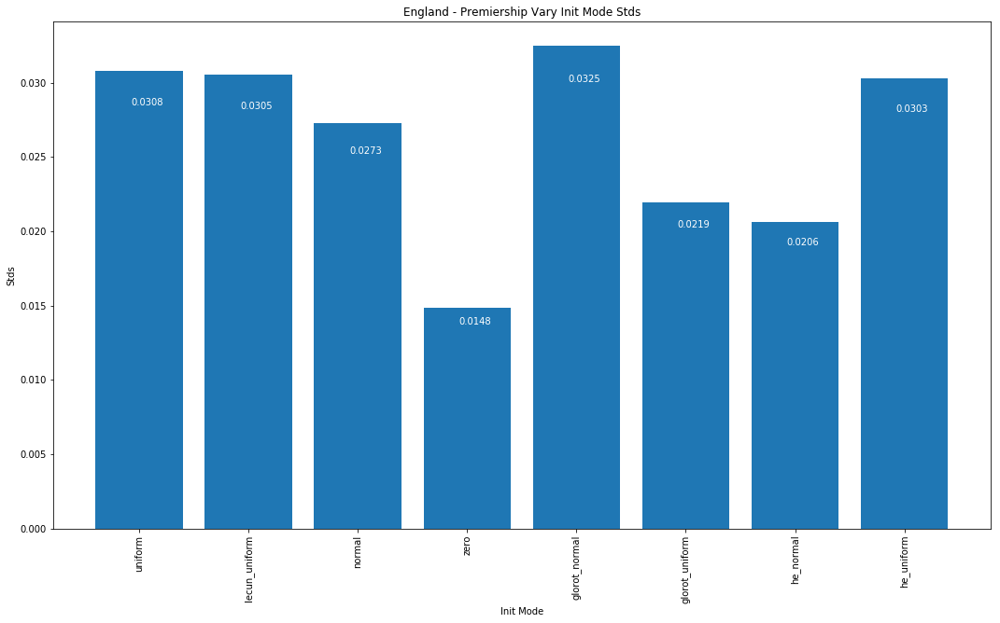

Competition France - Championnat
Best: 0.502296 using {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.494950 (0.024885) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.495562 (0.029879) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'lecun_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.498623 (0.025867) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'normal', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.450872 (0.017463) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'zero', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.497398 (0.020765) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_normal', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.502296 (0.023326) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.491276 (0.024583) with: {'batch_size': 128, 'epochs'

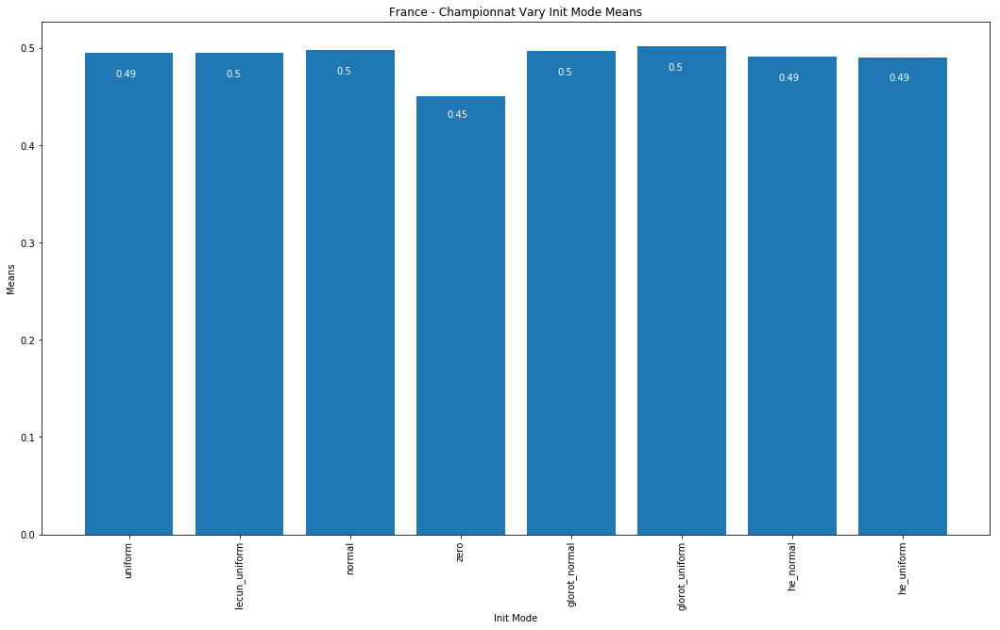

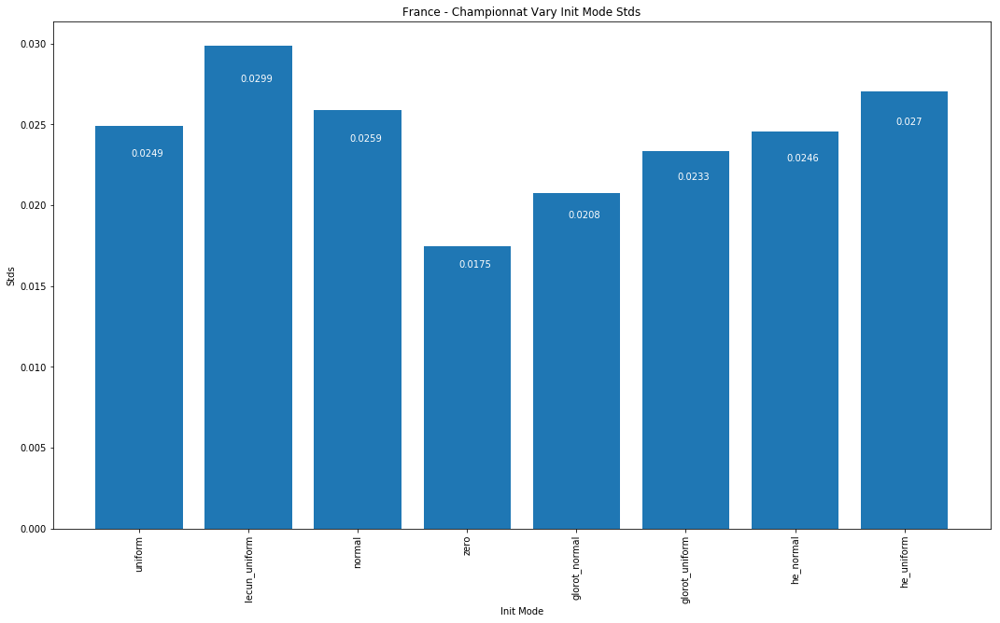

Competition Germany - Bundesliga
Best: 0.513534 using {'batch_size': 128, 'epochs': 50, 'init_mode': 'normal', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.509340 (0.012578) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.509340 (0.019439) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'lecun_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.513534 (0.018757) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'normal', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'zero', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.508197 (0.020022) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_normal', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.509340 (0.023563) with: {'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.508197 (0.015516) with: {'batch_size': 128, 'e

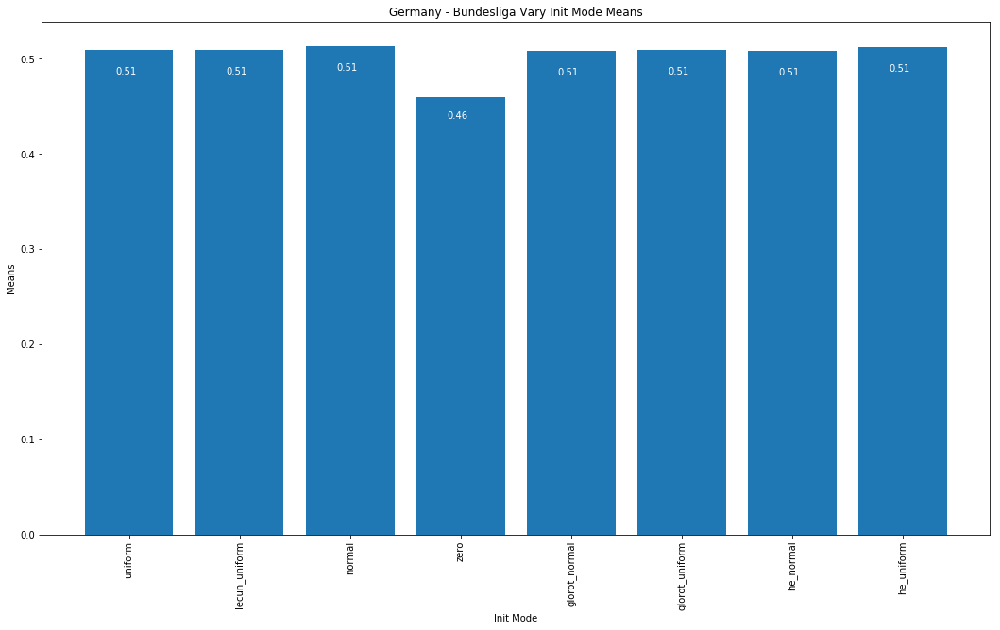

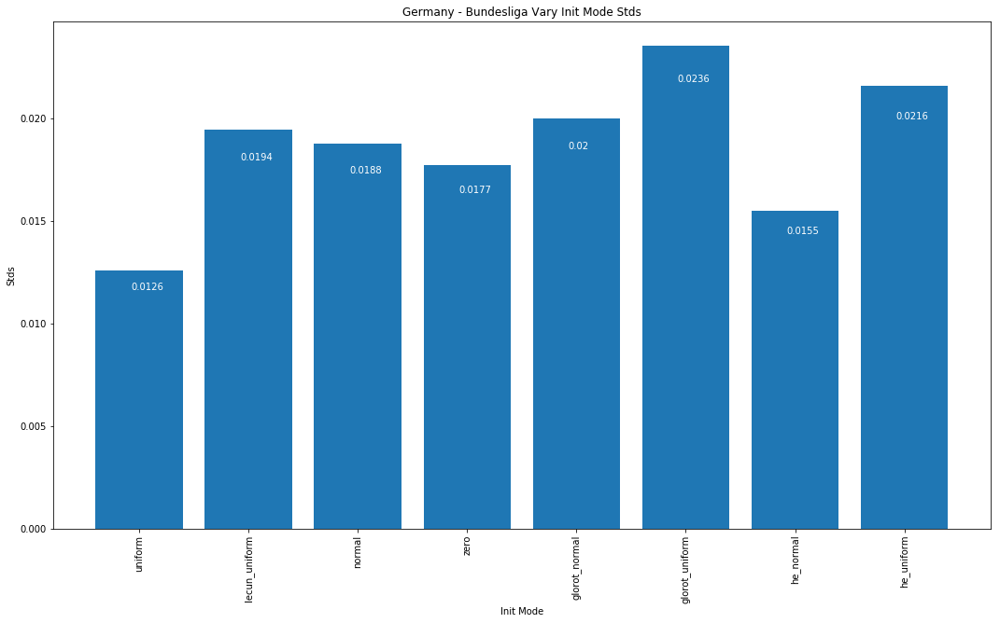

Competition Italy - Serie A
Best: 0.533939 using {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.532727 (0.034994) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.533030 (0.039006) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'lecun_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.533333 (0.032722) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'normal', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.457879 (0.021275) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'zero', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.529697 (0.034439) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_normal', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.533939 (0.031311) with: {'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.530909 (0.035773) with: {'batch_size': 128, 'epoch

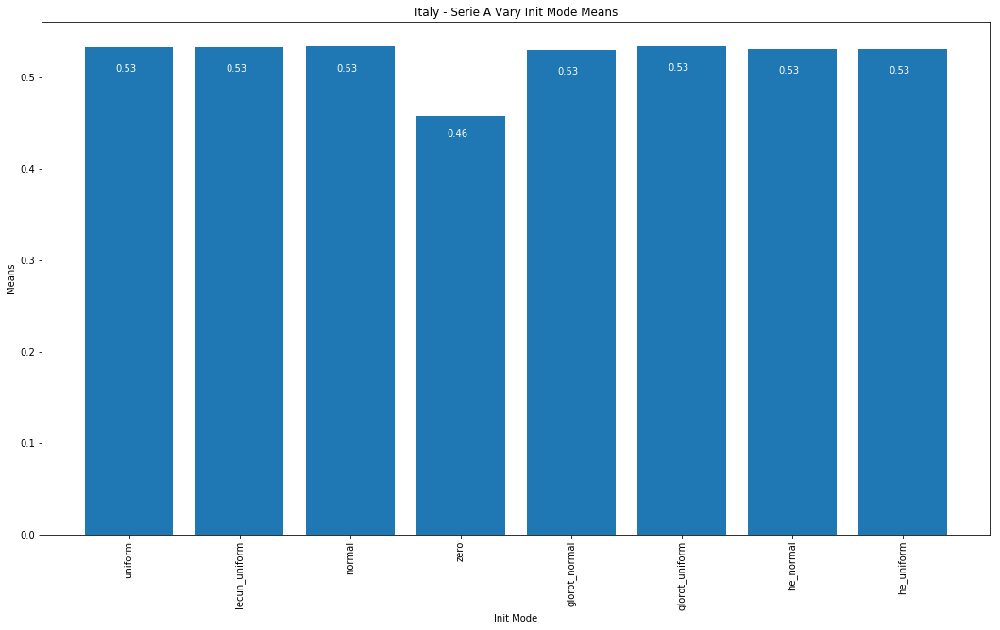

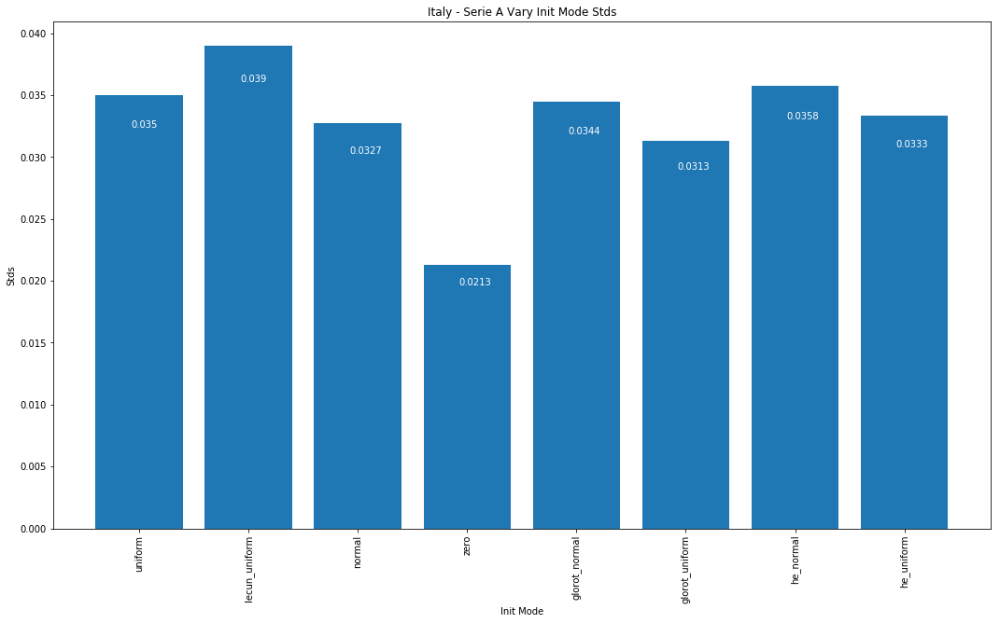

In [35]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[128],
                                          epochs=[50],
                                          learn_rate=[0.0005]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[30],
                                     learn_rate=[0.001])}
run_separate_grid_search(nn_08_17, 
                         nn_08_17_lbls, 
                         init_mode, 
                         competitions, 
                         "Init Mode",
                         "Vary Init Mode",
                         settings,
                         init_mode=init_mode)

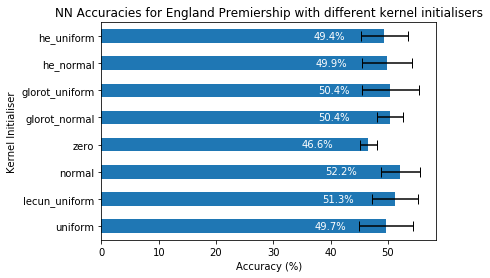

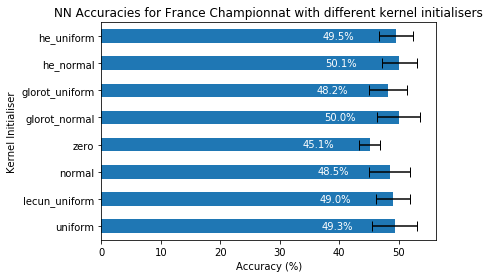

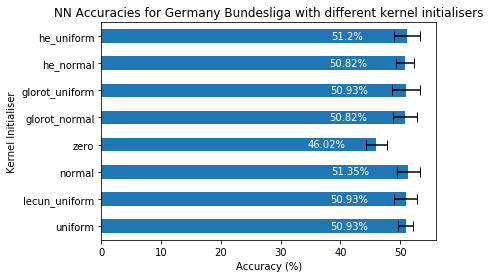

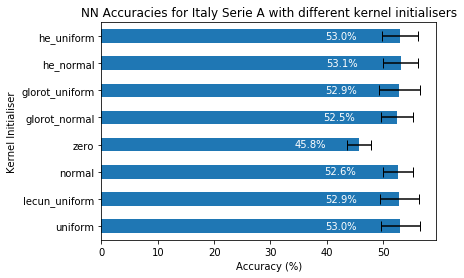

In [11]:
plot_bar_err(accuracies=[0.497, 0.513, 0.522, 0.466, 0.504, 0.504, 0.499, 0.494],
             stds=[0.0476, 0.0402, 0.0347, 0.0148, 0.02323, 0.0496, 0.0434, 0.0412],
             legend="England Premiership",
             labels=init_mode,
             x_lab="Accuracy (%)",
             y_lab="Kernel Initialiser",
             title="NN Accuracies for England Premiership with different kernel initialisers")

plot_bar_err(accuracies=[0.493, 0.49, 0.485, 0.451, 0.5, 0.482, 0.501, 0.495],
             stds=[0.0374, 0.0284, 0.0348, 0.0175, 0.0363, 0.0315, 0.02894, 0.0286],
             legend="France Championnat",
             labels=init_mode,
             x_lab="Accuracy (%)",
             y_lab="Kernel Initialiser",
             title="NN Accuracies for France Championnat with different kernel initialisers")

plot_bar_err(accuracies=[0.50934, 0.50934, 0.513534, 0.46016, 0.508197, 0.50934, 0.508197, 0.512009],
             stds=[0.012578, 0.019439, 0.018757, 0.017707, 0.020022, 0.023563, 0.015516, 0.021597],
             legend="Germany Bundesliga",
             labels=init_mode,
             x_lab="Accuracy (%)",
             y_lab="Kernel Initialiser",
             title="NN Accuracies for Germany Bundesliga with different kernel initialisers")

plot_bar_err(accuracies=[0.53, 0.529, 0.526, 0.458, 0.525, 0.529, 0.531, 0.53],
             stds=[0.0346, 0.0347, 0.0262, 0.0213, 0.0287, 0.037, 0.0315, 0.0318],
             legend="Italy Serie A",
             labels=init_mode,
             x_lab="Accuracy (%)",
             y_lab="Kernel Initialiser",
             title="NN Accuracies for Italy Serie A with different kernel initialisers")

### Activation Function

In [7]:
activation = ['softmax', 'softplus', 'softsign', 'relu', 'tanh', 'sigmoid', 'hard_sigmoid', 'linear']

Running Grid Search
Competition England - Premiership


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the

Best: 0.542110 using {'activation': 'linear', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.465795 (0.014828) with: {'activation': 'softmax', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.540286 (0.030844) with: {'activation': 'softplus', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.538766 (0.030815) with: {'activation': 'softsign', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.539982 (0.034690) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.537549 (0.034011) with: {'activation': 'tanh', 'batch_size': 128, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.519915 (0.030663) with: {'activation': 'si

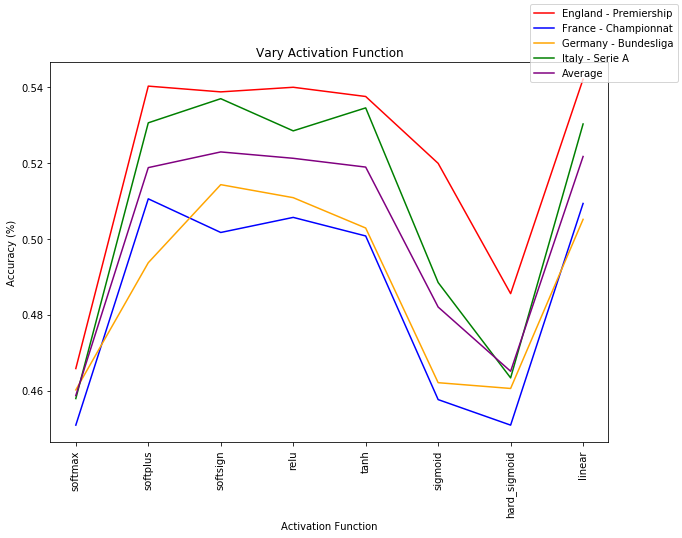

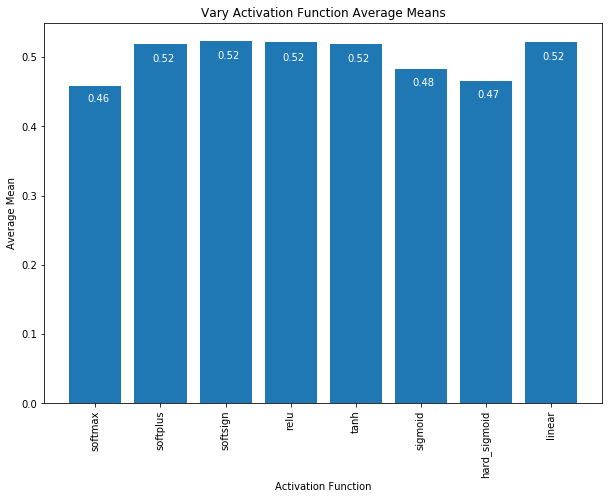

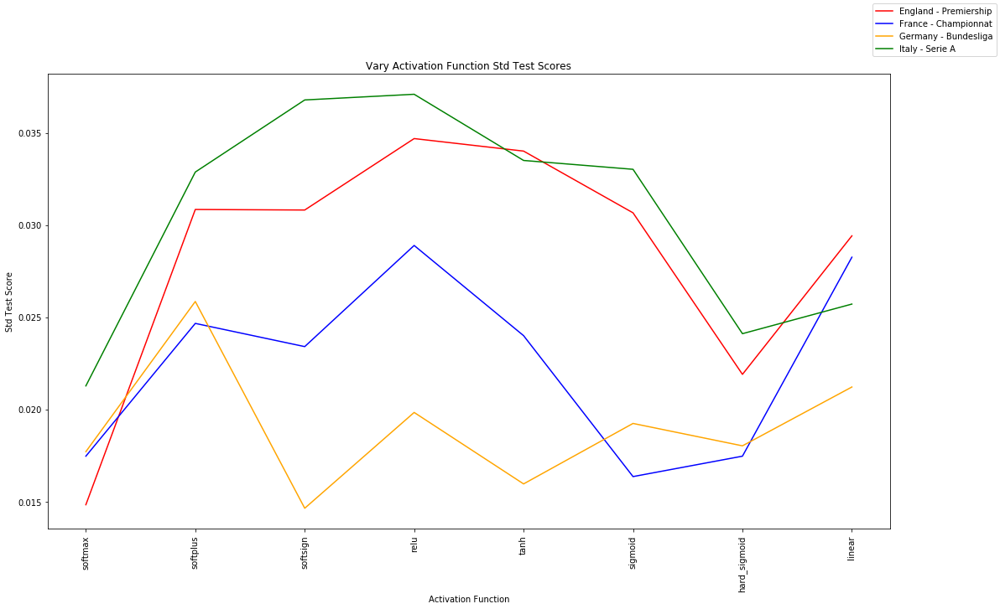

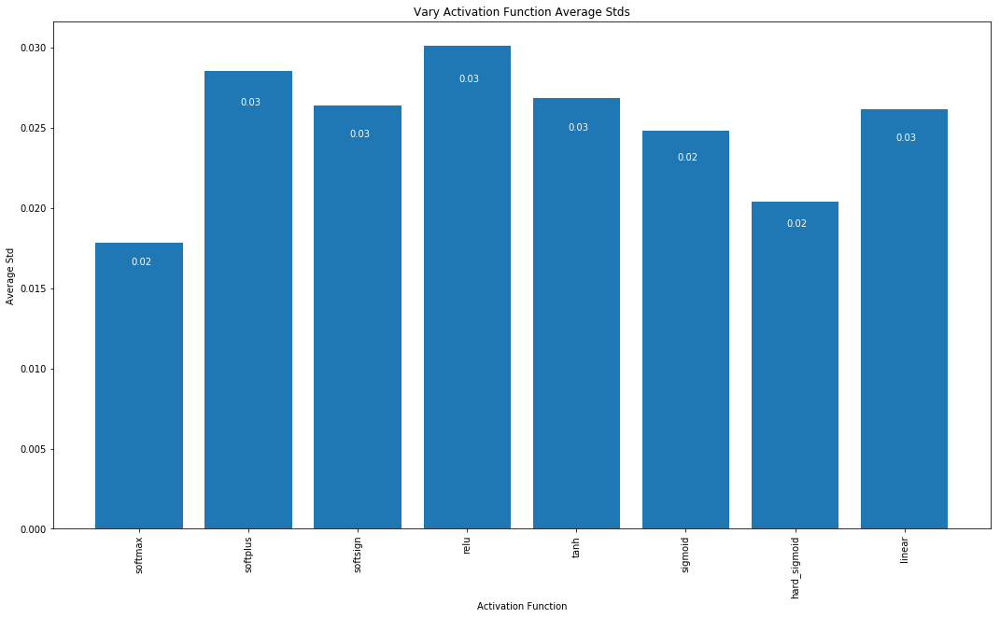

In [11]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls, 
                activation, 
                competitions, 
                "Activation Function",
                "Vary Activation Function",
                activation=activation,
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"],
                learn_rate=[0.001],
                neurons_1=[20],
                neurons_2=[20])

Running Separate Grid Search
Competition England - Premiership


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the

Best: 0.538462 using {'activation': 'tanh', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adamax'}
0.465795 (0.014828) with: {'activation': 'softmax', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adamax'}
0.480085 (0.017257) with: {'activation': 'softplus', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adamax'}
0.535725 (0.031352) with: {'activation': 'softsign', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adamax'}
0.525692 (0.031753) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adamax'}
0.538462 (0.031105) with: {'activation'

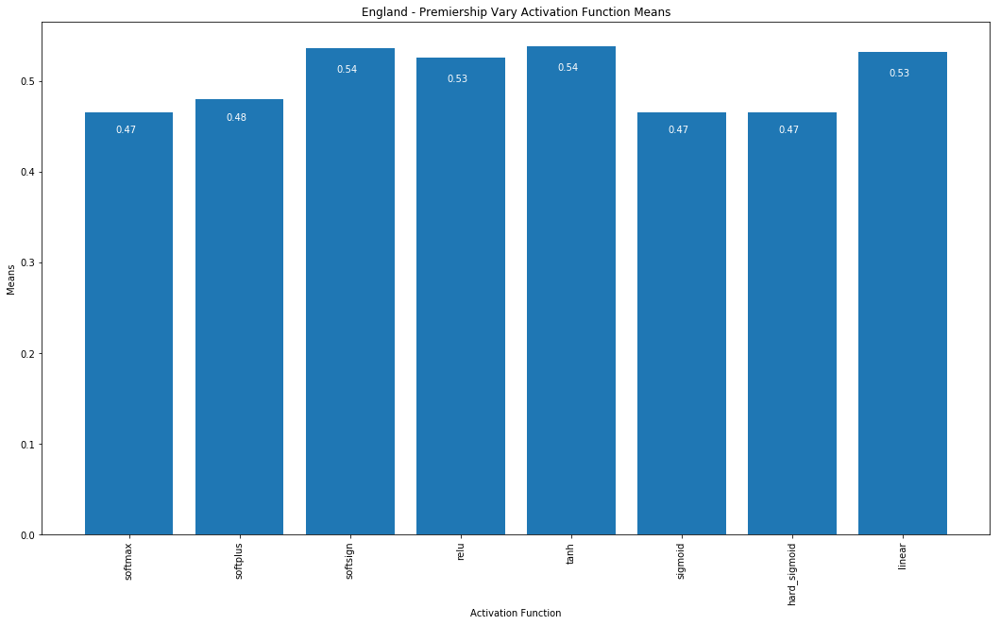

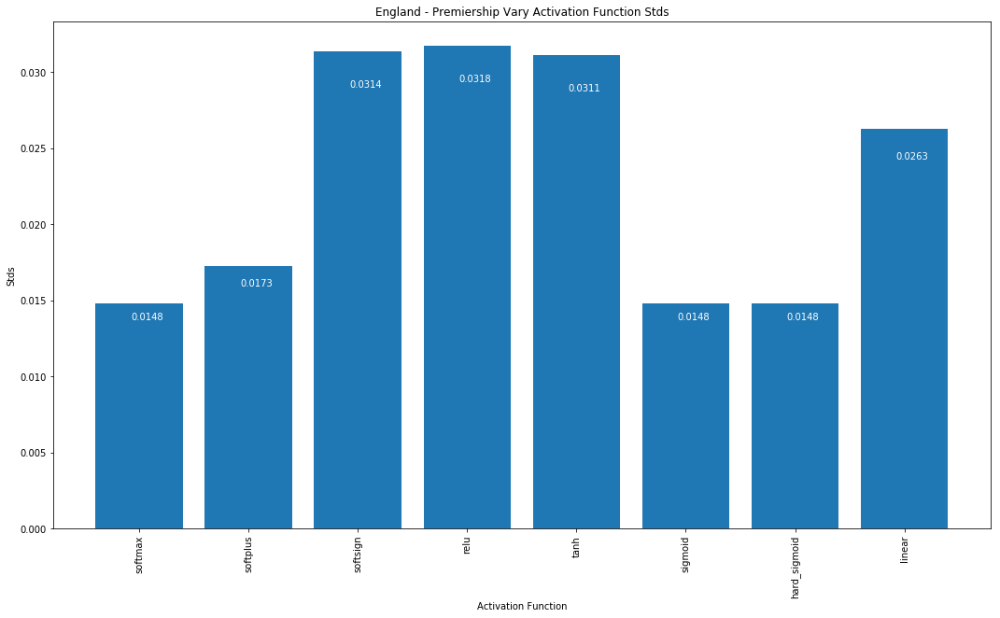

Competition France - Championnat
Best: 0.497398 using {'activation': 'linear', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 30, 'neurons_2': 5, 'neurons_3': 5, 'optimizer': 'Adamax'}
0.450872 (0.017463) with: {'activation': 'softmax', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 30, 'neurons_2': 5, 'neurons_3': 5, 'optimizer': 'Adamax'}
0.454852 (0.018774) with: {'activation': 'softplus', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 30, 'neurons_2': 5, 'neurons_3': 5, 'optimizer': 'Adamax'}
0.494643 (0.023624) with: {'activation': 'softsign', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 30, 'neurons_2': 5, 'neurons_3': 5, 'optimizer': 'Adamax'}
0.477502 (0.022653) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.00

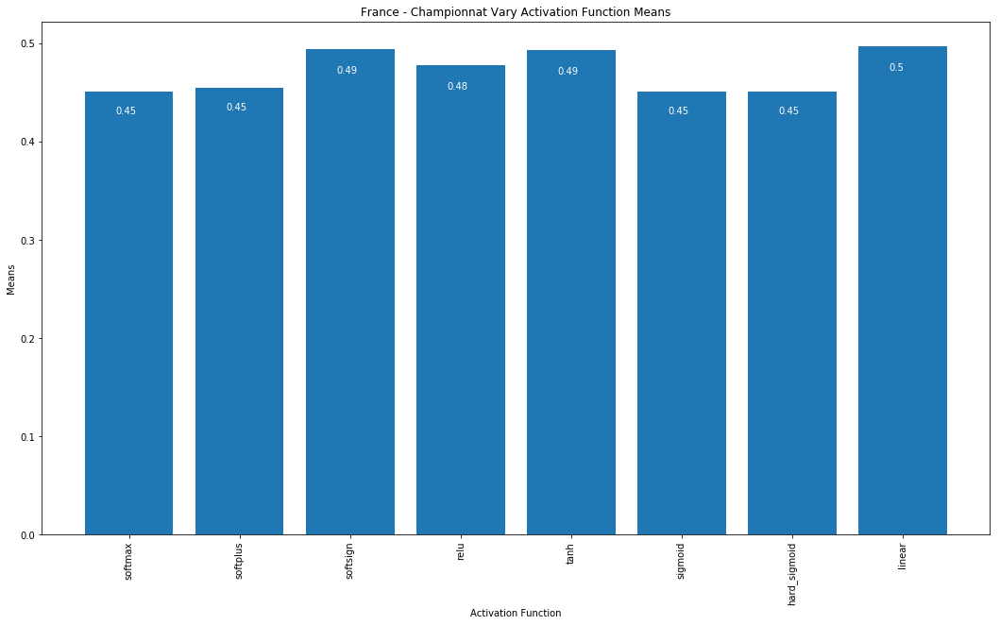

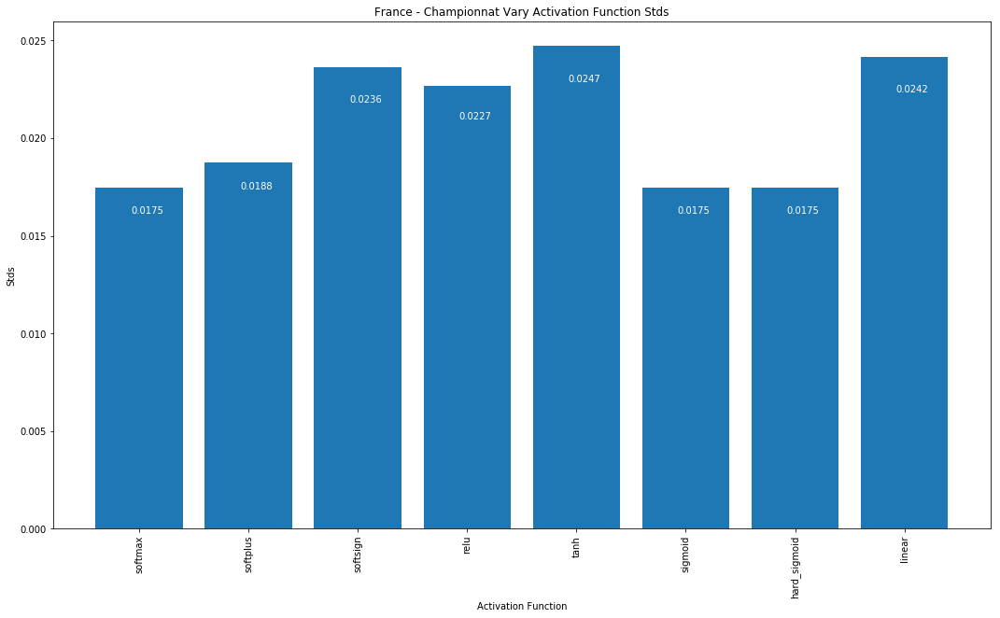

Competition Germany - Bundesliga


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


Best: 0.460160 using {'activation': 'softmax', 'batch_size': 256, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'neurons_1': 25, 'neurons_2': 25, 'neurons_3': 5, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'activation': 'softmax', 'batch_size': 256, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'neurons_1': 25, 'neurons_2': 25, 'neurons_3': 5, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'activation': 'softplus', 'batch_size': 256, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'neurons_1': 25, 'neurons_2': 25, 'neurons_3': 5, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'activation': 'softsign', 'batch_size': 256, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'neurons_1': 25, 'neurons_2': 25, 'neurons_3': 5, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'activation': 'relu', 'batch_size': 256, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'neurons_1': 25, 'neurons_2': 25, 'neurons_3': 5, 'opti

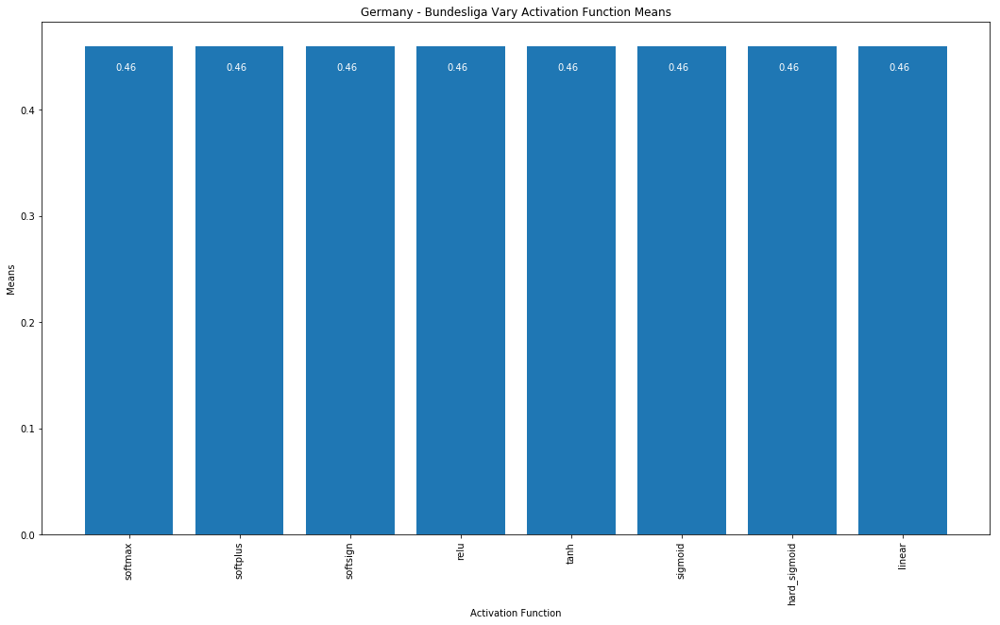

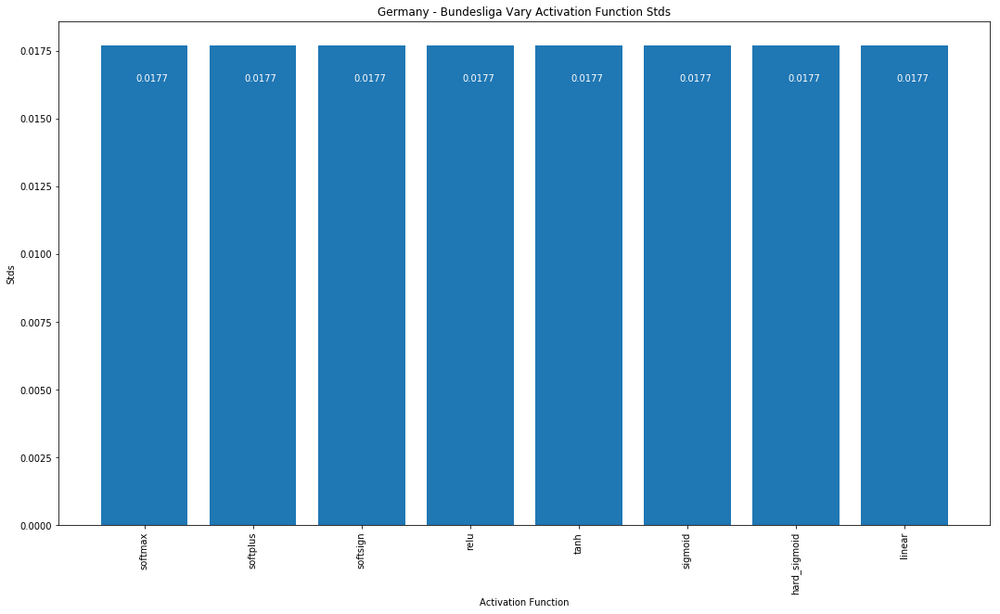

Competition Italy - Serie A
Best: 0.465152 using {'activation': 'tanh', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 20, 'neurons_2': 20, 'neurons_3': 10, 'optimizer': 'Adagrad'}
0.411818 (0.097135) with: {'activation': 'softmax', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 20, 'neurons_2': 20, 'neurons_3': 10, 'optimizer': 'Adagrad'}
0.435152 (0.053133) with: {'activation': 'softplus', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 20, 'neurons_2': 20, 'neurons_3': 10, 'optimizer': 'Adagrad'}
0.458182 (0.021675) with: {'activation': 'softsign', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'neurons_1': 20, 'neurons_2': 20, 'neurons_3': 10, 'optimizer': 'Adagrad'}
0.459091 (0.020564) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate':

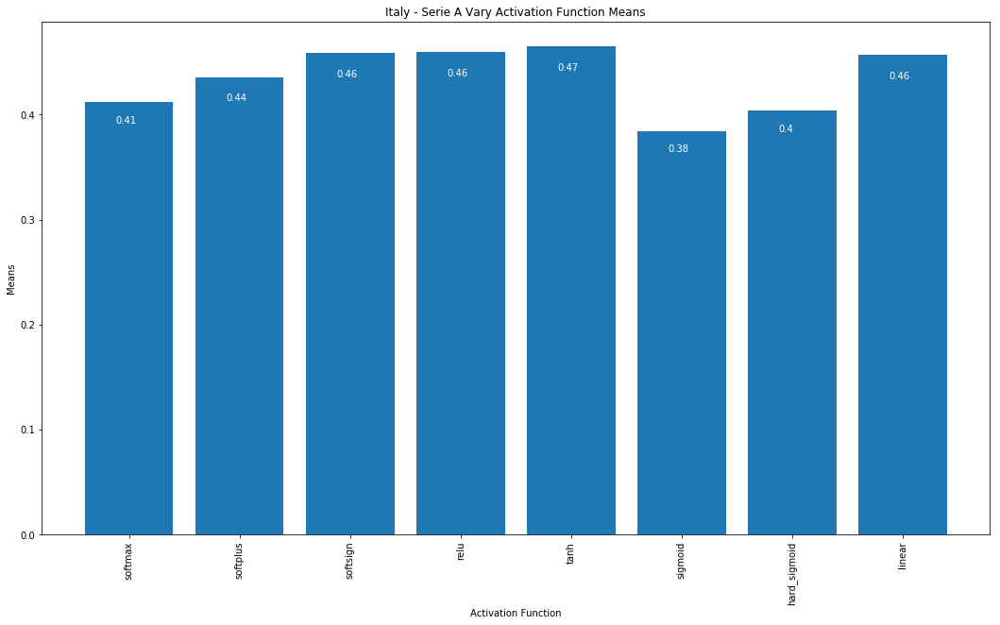

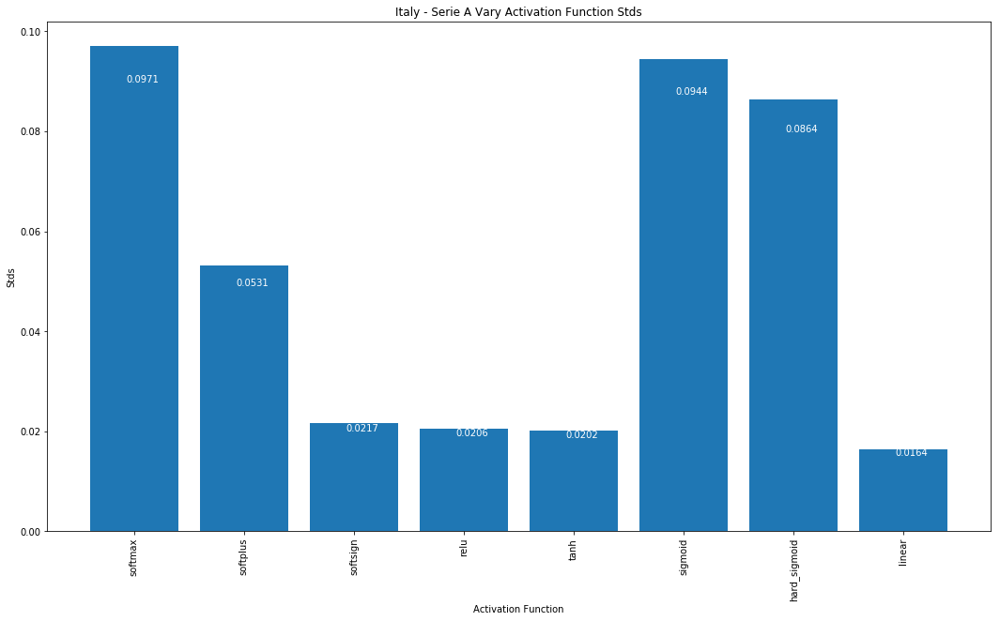

In [10]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"],
                                          neurons_1=[20],
                                          neurons_2=[20]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["glorot_uniform"],
                                          neurons_1=[30],
                                          neurons_2=[5],
                                          neurons_3=[5]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[256],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["uniform"],
                                          neurons_1=[25],
                                          neurons_2=[25]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[50],
                                     learn_rate=[0.0005],
                                     init_mode=["glorot_uniform"],
                                     neurons_1=[20],
                                     neurons_2=[20],
                                     neurons_3=[10])}
run_separate_grid_search(nn_08_17, 
                         nn_08_17_lbls, 
                         activation, 
                         competitions, 
                         "Activation Function",
                         "Vary Activation Function",
                         settings,
                         activation=activation)

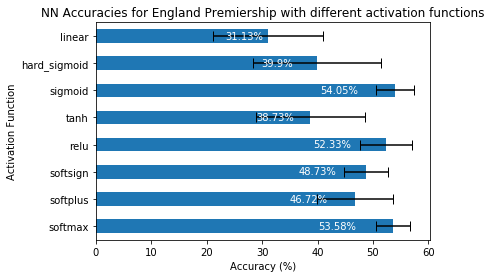

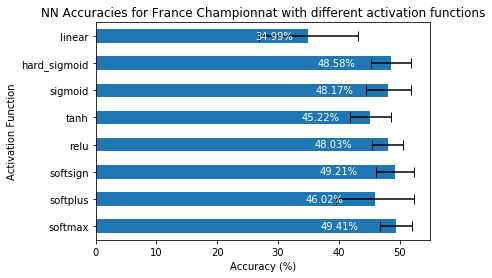

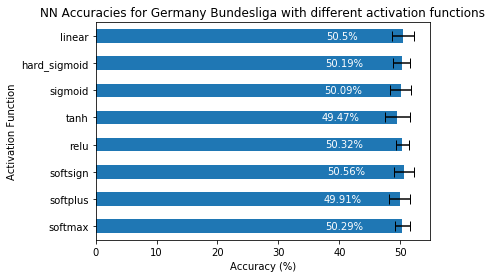

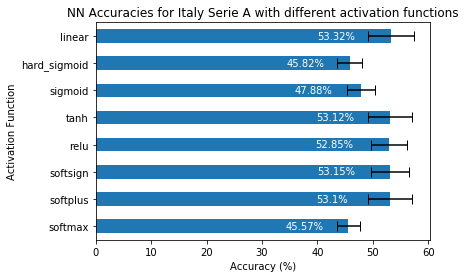

In [66]:
plot_bar_err(accuracies=[0.535841, 0.467157, 0.487326, 0.523303, 0.387299, 0.54047, 0.39901, 0.311256],
             stds=[0.030377, 0.068795, 0.038895, 0.046839, 0.098106, 0.034230, 0.115743, 0.099087],
             legend="England Premiership",
             labels=activation,
             x_lab="Accuracy (%)",
             y_lab="Activation Function",
             title="NN Accuracies for England Premiership with different activation functions")

plot_bar_err(accuracies=[0.494072, 0.460160, 0.492142, 0.480287, 0.452164, 0.481665, 0.485801, 0.34987],
             stds=[0.026828, 0.064323, 0.031005, 0.026056, 0.034095, 0.037181, 0.033165, 0.081433],
             legend="France Championnat",
             labels=activation,
             x_lab="Accuracy (%)",
             y_lab="Activation Function",
             title="NN Accuracies for France Championnat with different activation functions")

plot_bar_err(accuracies=[0.502902, 0.499146, 0.505633, 0.503243, 0.494708, 0.500854, 0.501878, 0.50495],
             stds=[0.012497, 0.017394, 0.015976, 0.010807, 0.02063, 0.017157, 0.013189, 0.018104],
             legend="Germany Bundesliga",
             labels=activation,
             x_lab="Accuracy (%)",
             y_lab="Activation Function",
             title="NN Accuracies for Germany Bundesliga with different activation functions")

plot_bar_err(accuracies=[0.455707, 0.530978, 0.531522, 0.528533, 0.531250, 0.478804, 0.458152, 0.533152],
             stds=[0.021398, 0.039867, 0.034248, 0.032227, 0.039701, 0.025659, 0.022216, 0.041618],
             legend="Italy Serie A",
             labels=activation,
             x_lab="Accuracy (%)",
             y_lab="Activation Function",
             title="NN Accuracies for Italy Serie A with different activation functions")

### Optimizer Parameters

In [12]:
beta_1 = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1.1, 1.2, 1.3, 1.4, 1.5]

Running Grid Search
Competition England - Premiership
Best: 0.540286 using {'batch_size': 128, 'beta_1': 0.7, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.534509 (0.027779) with: {'batch_size': 128, 'beta_1': 0.1, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.532685 (0.030013) with: {'batch_size': 128, 'beta_1': 0.2, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.538462 (0.028058) with: {'batch_size': 128, 'beta_1': 0.3, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.530860 (0.026118) with: {'batch_size': 128, 'beta_1': 0.4, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.536941 (0.027895) with: {'batch_size': 128, 'beta_1': 0.5, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.540286 (0.029561) with: {'batch_size': 128, 'beta_1': 0.6, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.540286 (0.031789) with: {'batch_size': 128, 'beta_1': 0.7, 'epochs': 30, 'learn_rate': 0.001, 'optimizer': 'Adam'}
0.539678 (0.035

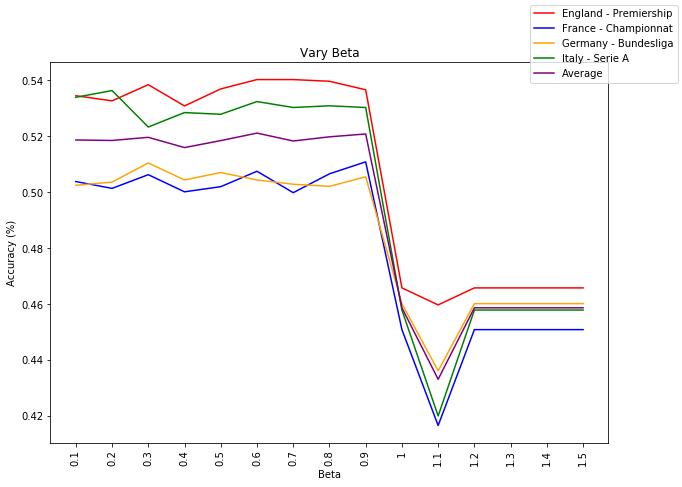

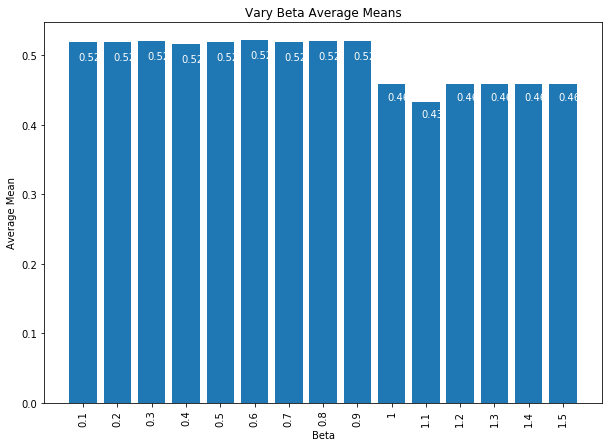

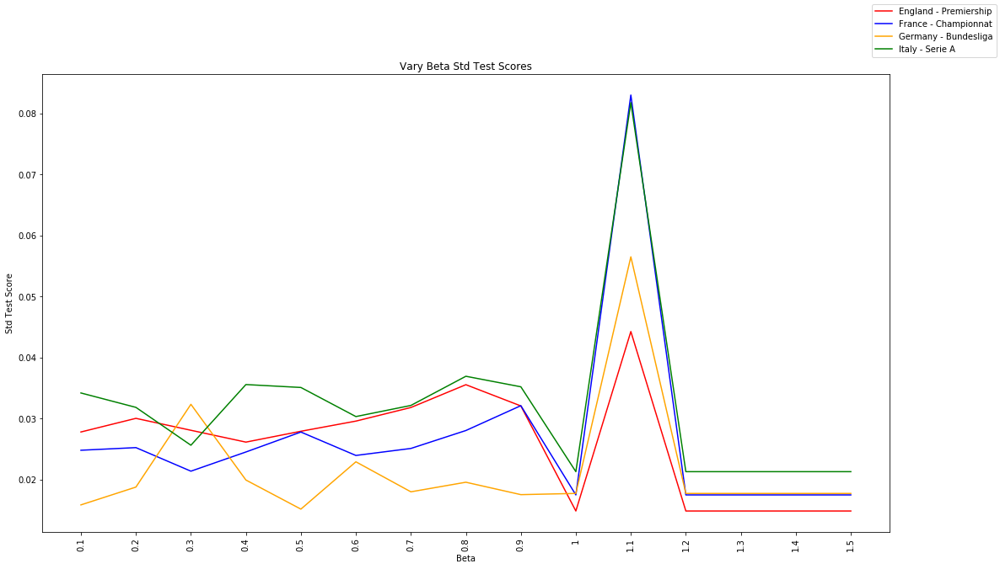

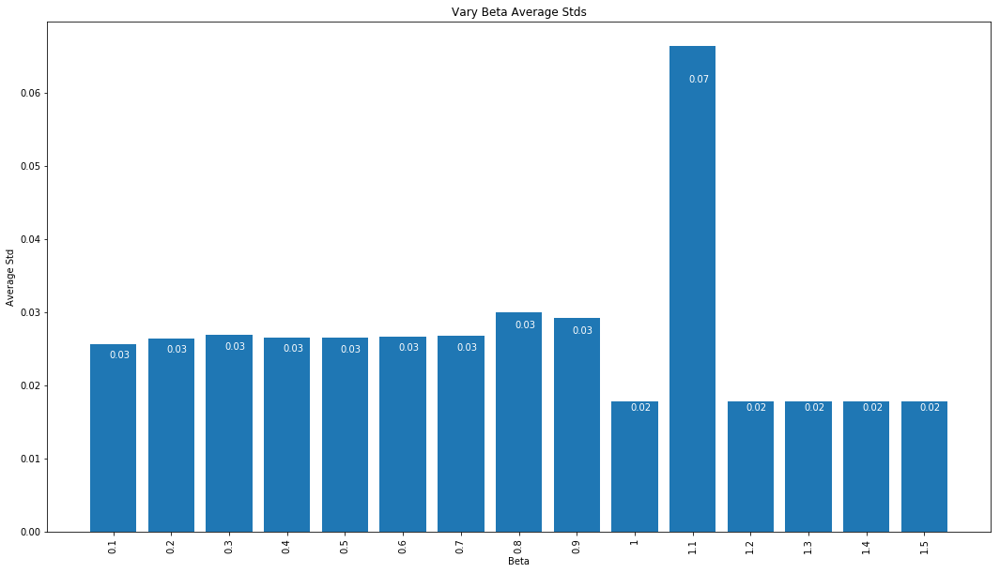

In [19]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls, 
                beta_1, 
                competitions, 
                "Beta",
                "Vary Beta",
                learn_rate=[0.001],
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"],
                beta_1=beta_1)

Running Separate Grid Search
Competition England - Premiership


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


Best: 0.535725 using {'batch_size': 128, 'beta_1': 0.9, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.534813 (0.026923) with: {'batch_size': 128, 'beta_1': 0.1, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.529948 (0.031078) with: {'batch_size': 128, 'beta_1': 0.2, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.532989 (0.028741) with: {'batch_size': 128, 'beta_1': 0.3, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.529948 (0.027783) with: {'batch_size': 128, 'beta_1': 0.4, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.529340 (0.023108) with: {'batch_size': 128, 'beta_1': 0.5, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.533901 (0.027415) with: {'batch_size': 128, 'beta_1': 0.6, 'epochs': 30, 'init_mode': 'glorot_uniform',

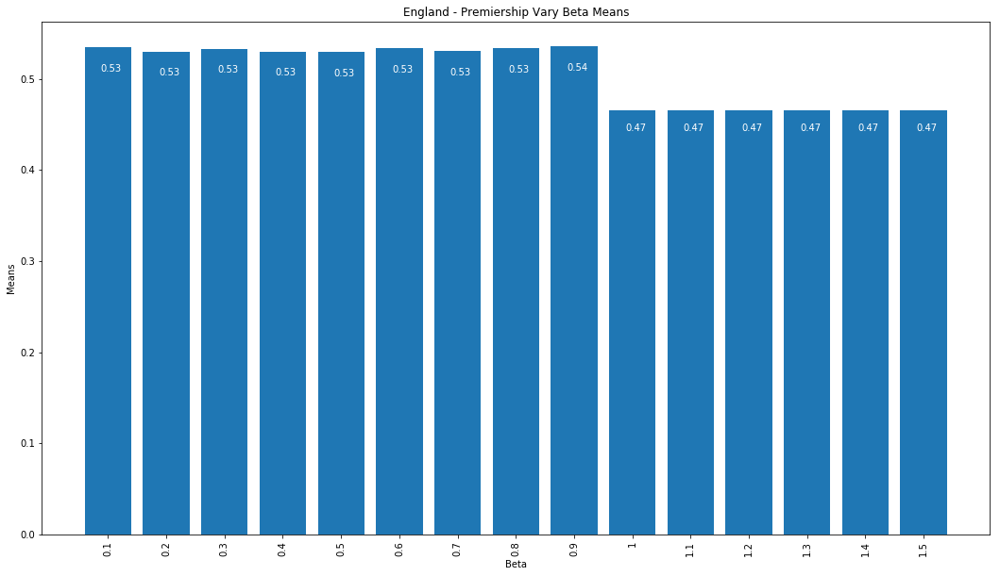

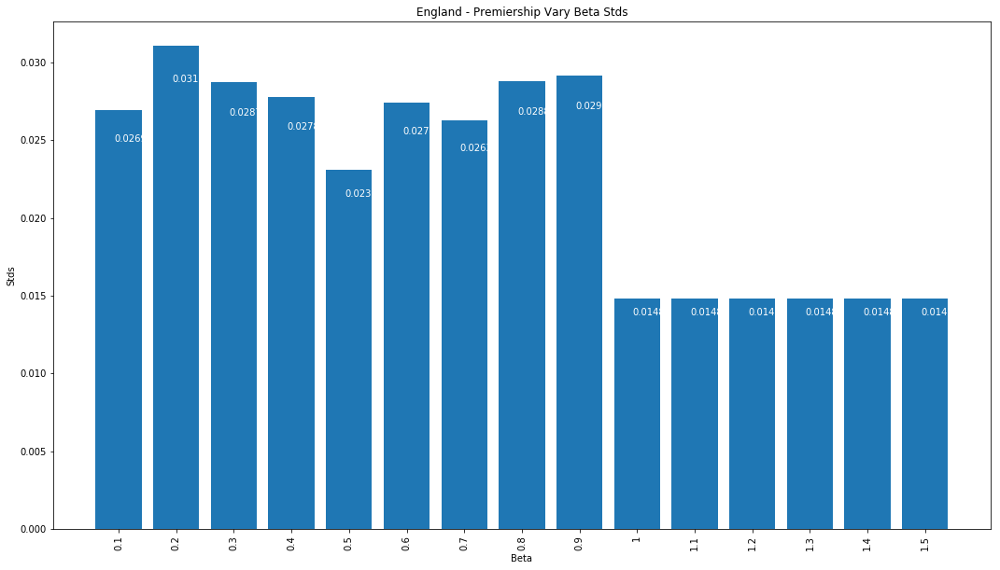

Competition France - Championnat
Best: 0.499541 using {'batch_size': 128, 'beta_1': 0.8, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.497092 (0.029580) with: {'batch_size': 128, 'beta_1': 0.1, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.496480 (0.027921) with: {'batch_size': 128, 'beta_1': 0.2, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.495256 (0.024984) with: {'batch_size': 128, 'beta_1': 0.3, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.495562 (0.023969) with: {'batch_size': 128, 'beta_1': 0.4, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.499235 (0.025748) with: {'batch_size': 128, 'beta_1': 0.5, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.497398 (0.029018) with: {'batch_size': 128, 'beta_1': 0.6, 'epochs': 3

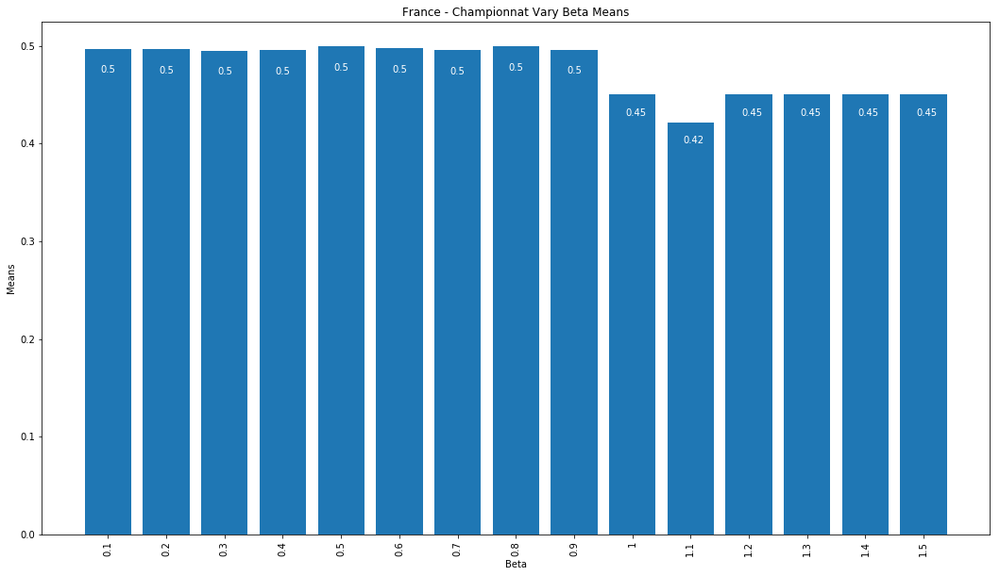

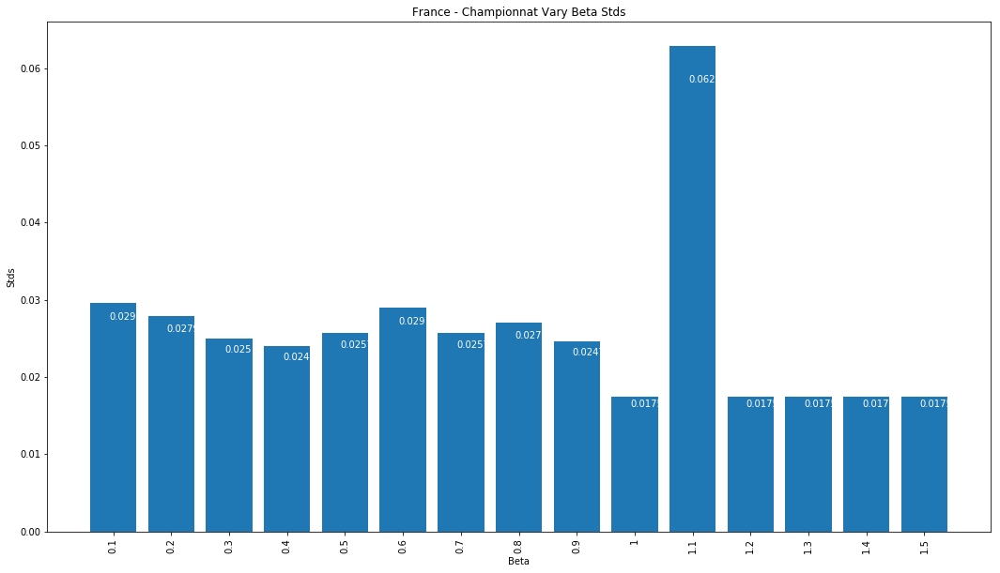

Competition Germany - Bundesliga


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


Best: 0.460160 using {'batch_size': 128, 'beta_1': 0.1, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.1, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.2, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.3, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.4, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.5, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.460160 (0.017707) with: {'batch_size': 128, 'beta_1': 0.6, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': '

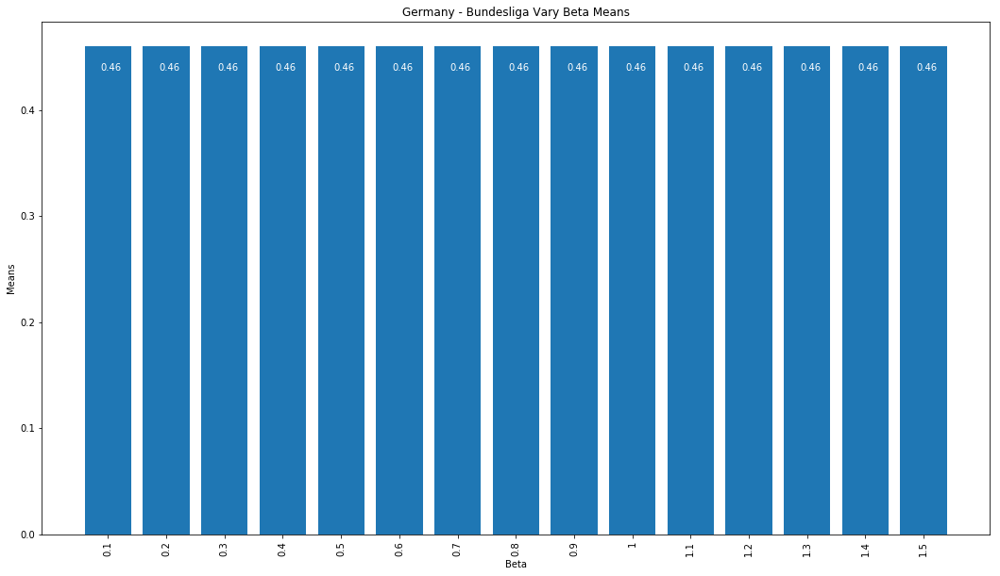

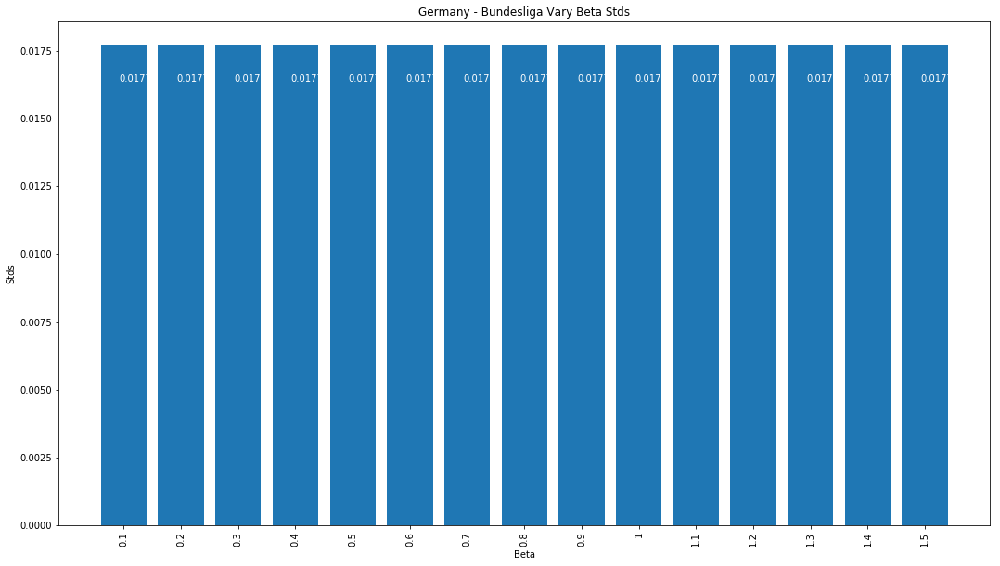

Competition Italy - Serie A
Best: 0.467273 using {'batch_size': 128, 'beta_1': 0.9, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.463333 (0.027689) with: {'batch_size': 128, 'beta_1': 0.1, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.458182 (0.020364) with: {'batch_size': 128, 'beta_1': 0.2, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.458788 (0.024326) with: {'batch_size': 128, 'beta_1': 0.3, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.464545 (0.022270) with: {'batch_size': 128, 'beta_1': 0.4, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.459394 (0.025142) with: {'batch_size': 128, 'beta_1': 0.5, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adagrad'}
0.457576 (0.022798) with: {'batch_size': 128, 'beta_1': 0.6, 'epochs': 

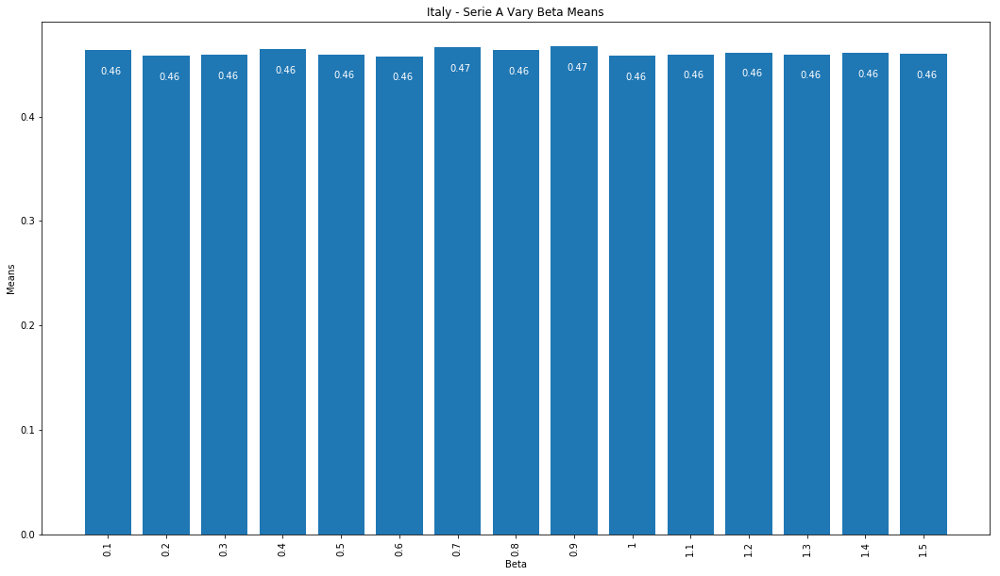

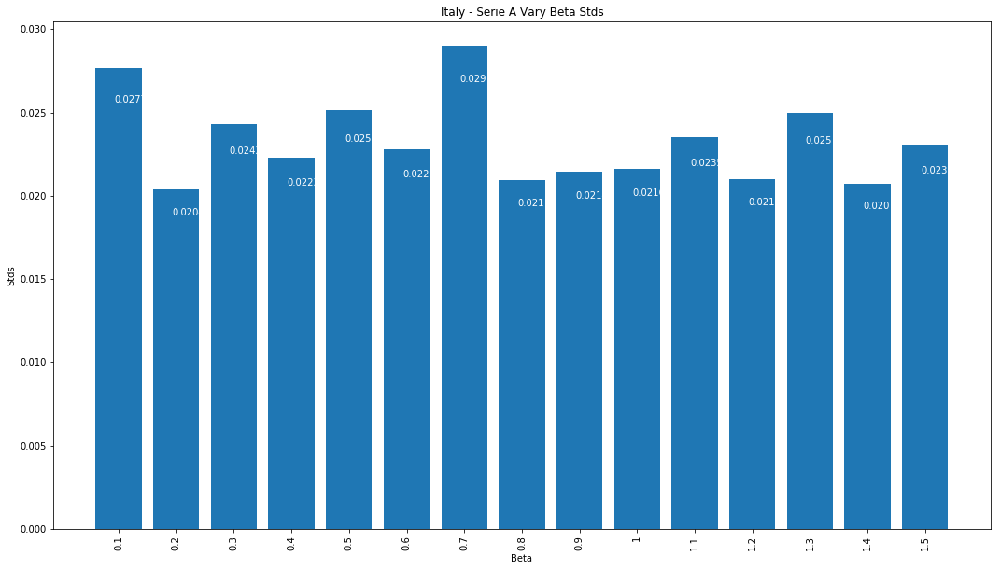

In [21]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[128],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["uniform"]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[30],
                                     learn_rate=[0.001],
                                     init_mode=["glorot_uniform"])}
run_separate_grid_search(nn_08_17, 
                         nn_08_17_lbls, 
                         beta_1, 
                         competitions, 
                         "Beta",
                         "Vary Beta",
                         settings,
                         beta_1=beta_1)

### Dropout

In [13]:
dropout_rate = [0.0, 0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.4, 0.5]

Running Grid Search
Competition England - Premiership


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the

Best: 0.541502 using {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.2, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.531469 (0.027957) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.539070 (0.034672) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.01, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.539070 (0.034281) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.05, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.537245 (0.032669) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.1, 'epochs': 30, 'learn_rate': 0.001, 'neurons_1': 20, 'neurons_2': 20, 'optimizer': 'Adam'}
0.537549 (0.039899) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.15, 'epochs': 30, 'lea

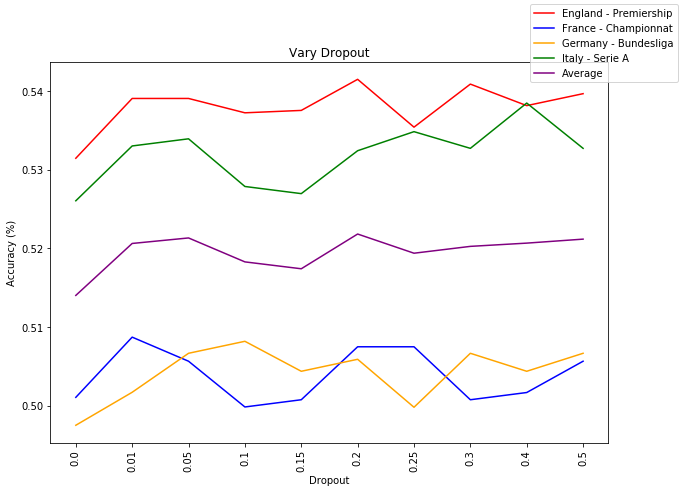

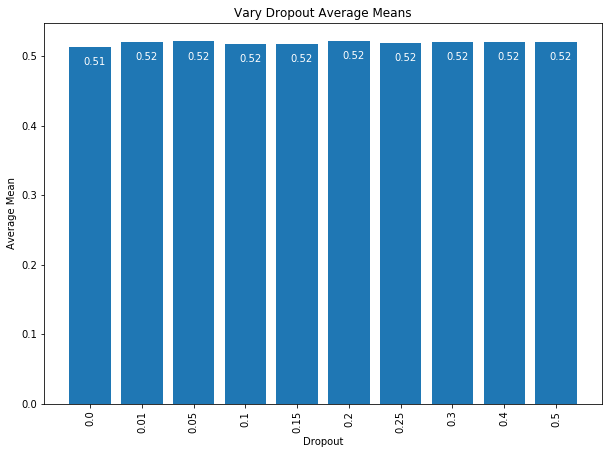

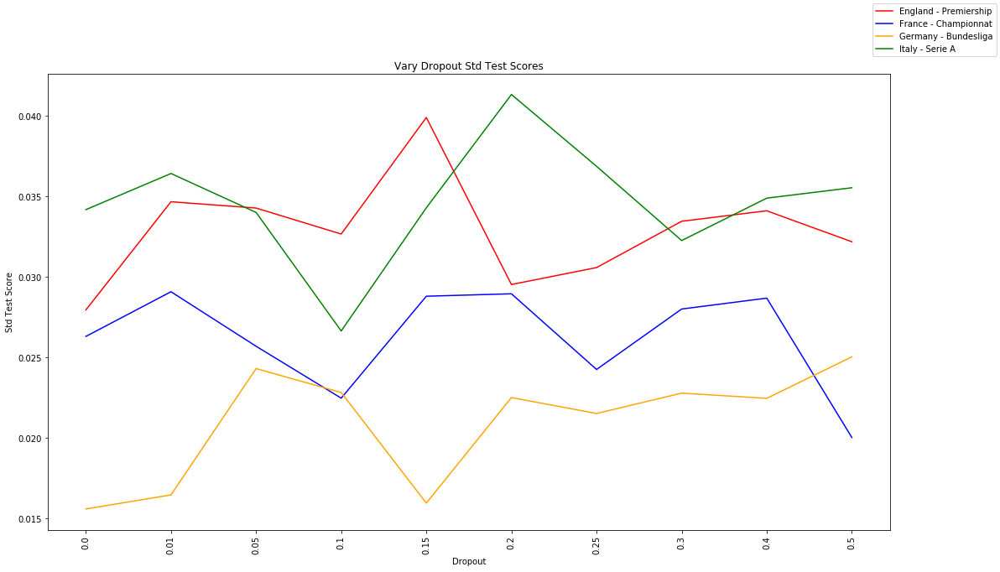

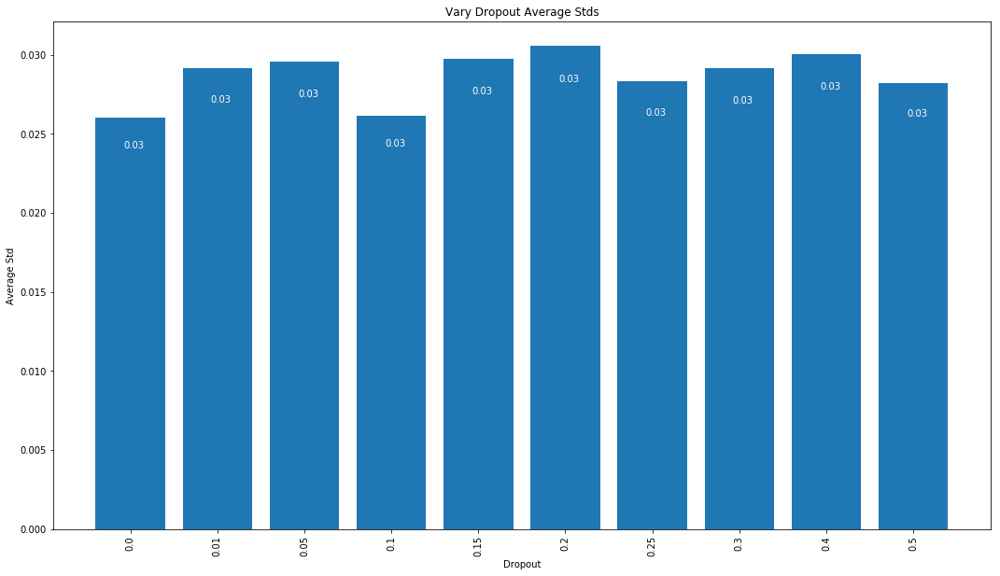

In [14]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls,
                dropout_rate, 
                competitions,
                "Dropout",
                "Vary Dropout",
                dropout_rate=dropout_rate,
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"],
                learn_rate=[0.001],
                neurons_1=[20],
                neurons_2=[20],
                activation=["relu"])

Running Separate Grid Search
Competition England - Premiership
Best: 0.545380 using {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.545380 (0.039743) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.542110 (0.041969) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.01, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.545380 (0.037382) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.05, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.542110 (0.038990) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.1, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'optimizer': 'Adamax'}
0.544017 (0.041204) with: {'activation': 'relu', '

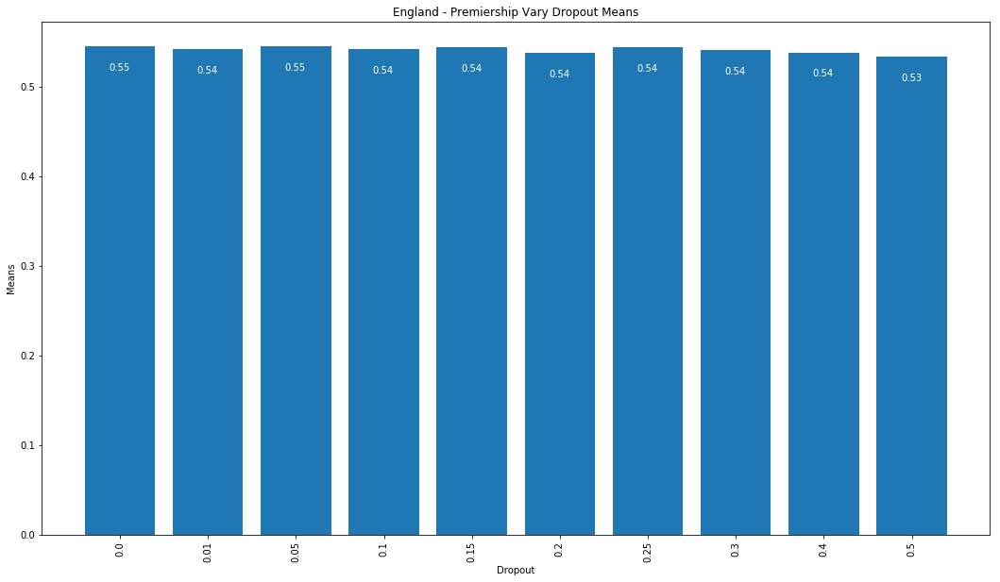

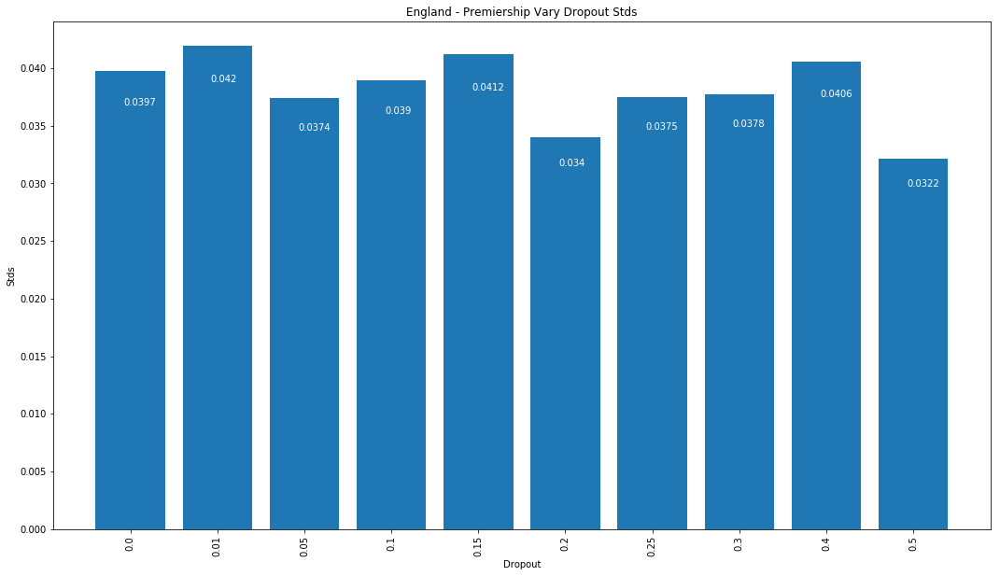

Competition France - Championnat
Best: 0.494899 using {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.05, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adamax'}
0.491867 (0.023614) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adamax'}
0.491039 (0.021423) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.01, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adamax'}
0.494899 (0.025060) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.05, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adamax'}
0.492969 (0.028514) with: {'activation': 'relu', 'batch_size': 128, 'dropout_rate': 0.1, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adamax'}
0.488282 (0.028628) with: {'activation': 'relu', 'batch_size': 128, 'dropo

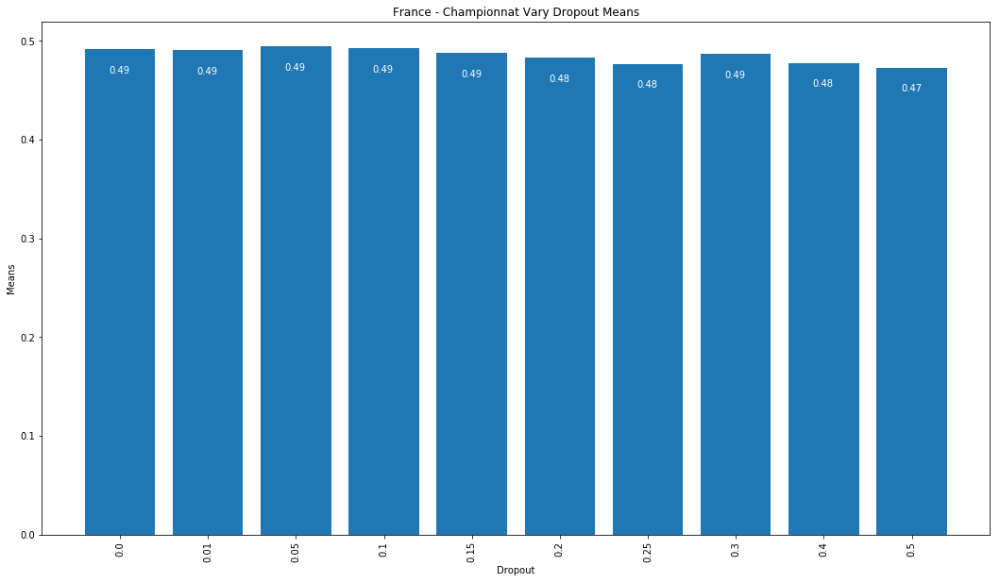

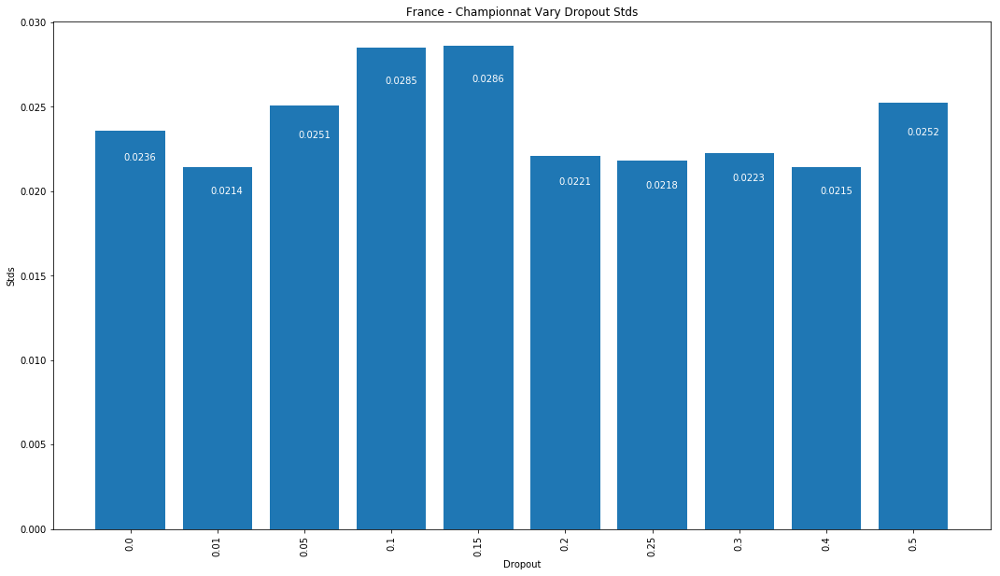

Competition Germany - Bundesliga
Best: 0.459543 using {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.0, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.459543 (0.011782) with: {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.0, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.459543 (0.011782) with: {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.01, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.459543 (0.011782) with: {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.05, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.459543 (0.011782) with: {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.1, 'epochs': 50, 'init_mode': 'uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.459543 (0.011782) with: {'activation': 'relu', 'batch_size': 256, 'dropout_rate': 0.15, 'epochs': 50, '

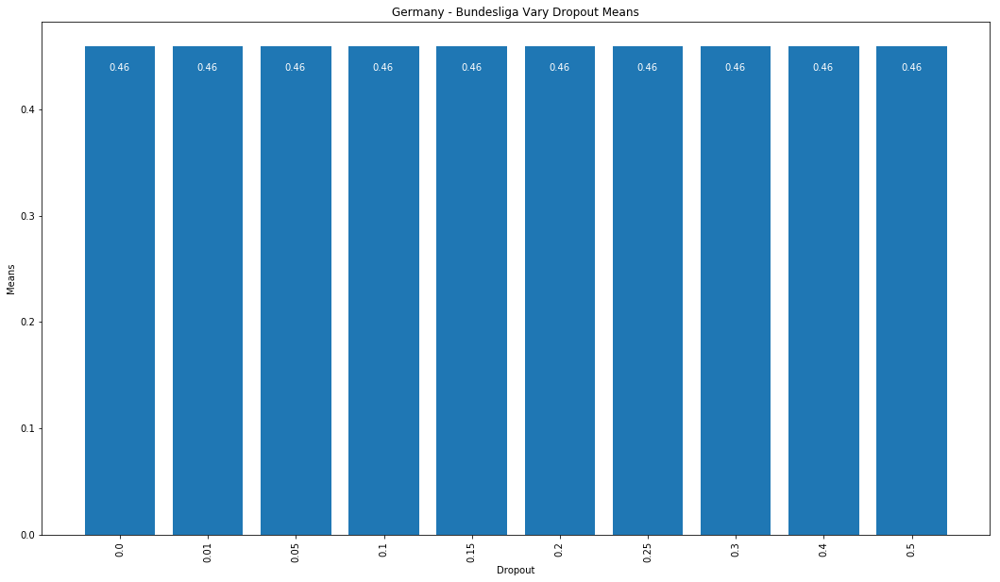

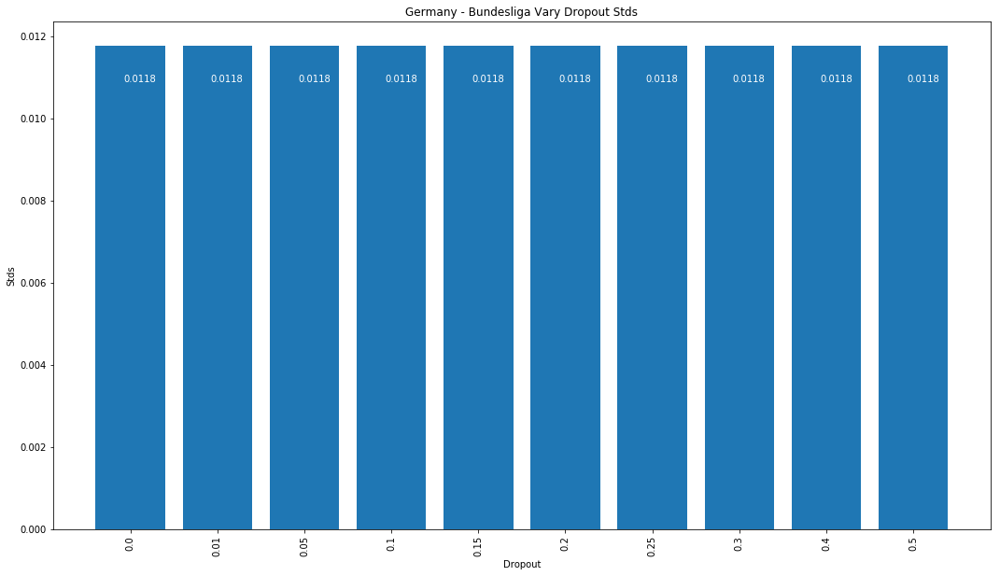

Competition Italy - Serie A


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


Best: 0.455707 using {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.455707 (0.021398) with: {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0.0, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.455707 (0.021398) with: {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0.01, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.455707 (0.021398) with: {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0.05, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.455707 (0.021398) with: {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0.1, 'epochs': 50, 'init_mode': 'glorot_uniform', 'learn_rate': 0.0005, 'optimizer': 'Adagrad'}
0.455707 (0.021398) with: {'activation': 'softmax', 'batch_size': 128, 'dropout_rate': 0

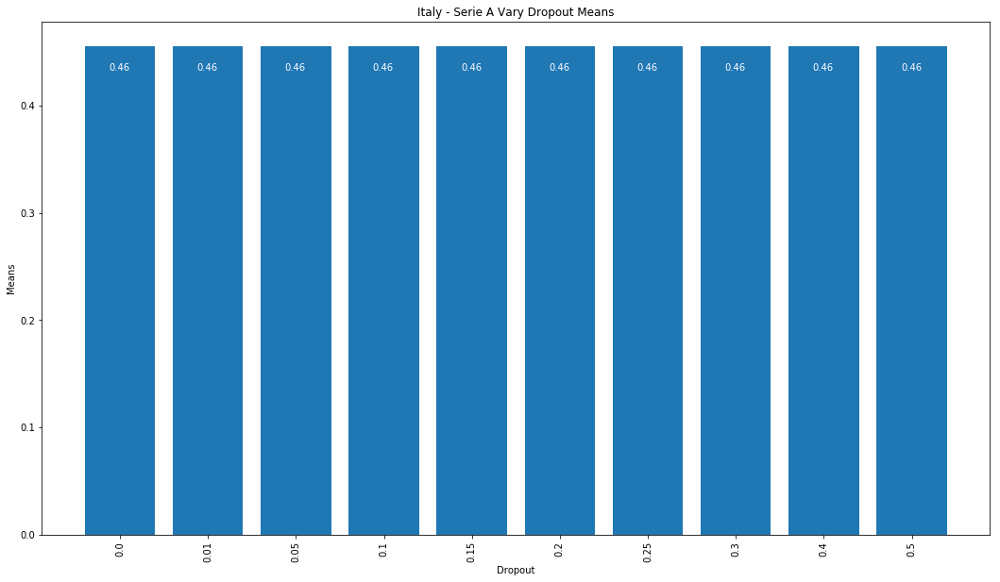

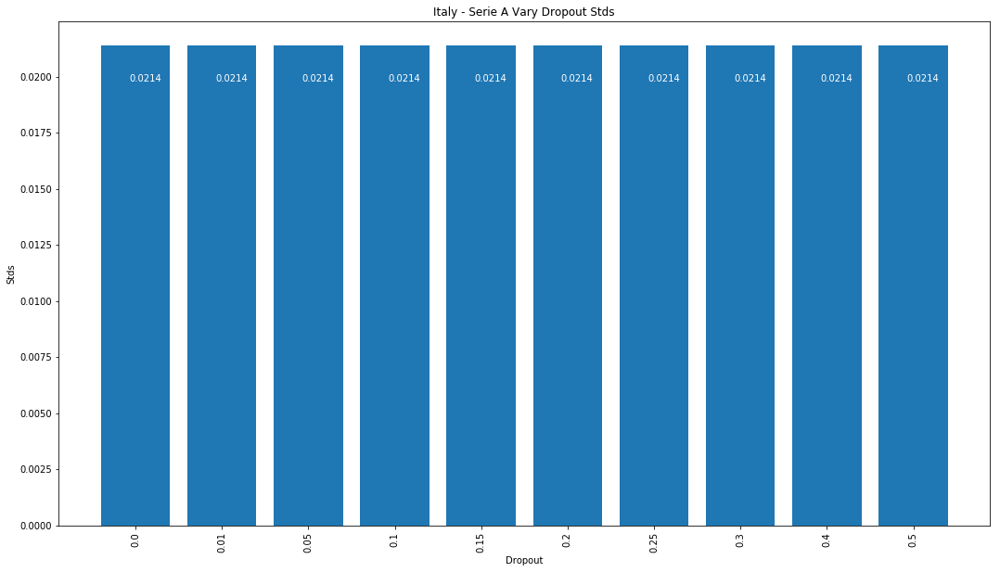

In [15]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"],
                                          activation=["relu"]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["glorot_uniform"],
                                          activation=["relu"]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[256],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["uniform"],
                                          activation=["relu"]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[50],
                                     learn_rate=[0.0005],
                                     init_mode=["glorot_uniform"],
                                     activation=["softmax"])}
run_separate_grid_search(nn_all, 
                         nn_all_lbls,
                         dropout_rate, 
                         competitions,
                         "Dropout",
                         "Vary Dropout",
                         settings,
                         dropout_rate=dropout_rate)

### Architecture

In [22]:
neurons_1 = [10, 20, 25, 30, 35, 40, 45, 50, 60, 70]
neurons_2 = [0, 5, 10, 15, 20, 25, 30, 35, 40]
neurons_3 = [0, 3, 5, 10, 15, 20, 25]
labels = []

for n1 in neurons_1:
    for n2 in neurons_2:
        for n3 in neurons_3:
            labels.append("Neurons 1: " + str(n1) \
                          + " | Neurons 2: " + str(n2) \
                          + " | Neurons 3: " + str(n3))

Running Grid Search
Competition England - Premiership
Best: 0.546063 using {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 50, 'neurons_2': 0, 'neurons_3': 5, 'optimizer': 'Adam'}
0.540590 (0.025110) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 0, 'optimizer': 'Adam'}
0.520219 (0.035628) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 3, 'optimizer': 'Adam'}
0.534813 (0.040602) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 5, 'optimizer': 'Adam'}
0.533597 (0.029192) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, '

Best: 0.514233 using {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 20, 'neurons_3': 0, 'optimizer': 'Adam'}
0.503826 (0.025788) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 0, 'optimizer': 'Adam'}
0.496174 (0.034551) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 3, 'optimizer': 'Adam'}
0.507193 (0.029125) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 5, 'optimizer': 'Adam'}
0.503520 (0.023133) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 10, 'opt

Best: 0.515440 using {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 30, 'neurons_2': 20, 'neurons_3': 0, 'optimizer': 'Adam'}
0.499428 (0.029882) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 0, 'optimizer': 'Adam'}
0.495616 (0.020485) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 3, 'optimizer': 'Adam'}
0.496378 (0.023391) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 5, 'optimizer': 'Adam'}
0.504766 (0.019930) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 10, 'opt

Best: 0.539394 using {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 45, 'neurons_2': 10, 'neurons_3': 15, 'optimizer': 'Adam'}
0.527273 (0.033608) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 0, 'optimizer': 'Adam'}
0.526667 (0.034968) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 3, 'optimizer': 'Adam'}
0.527879 (0.035360) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 5, 'optimizer': 'Adam'}
0.533030 (0.031330) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 10, 'op

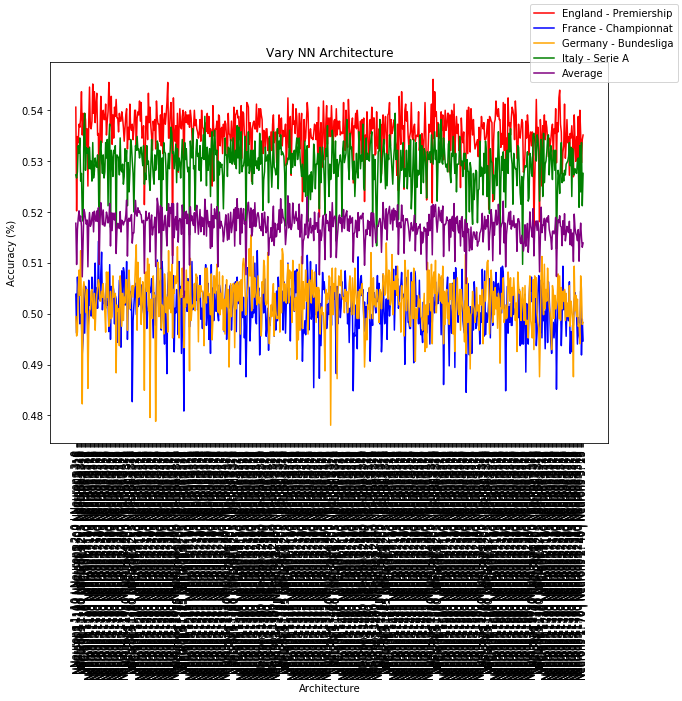

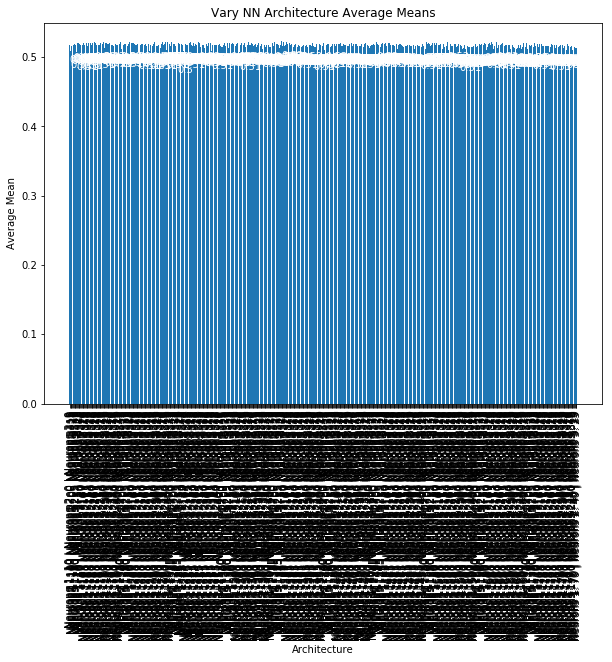

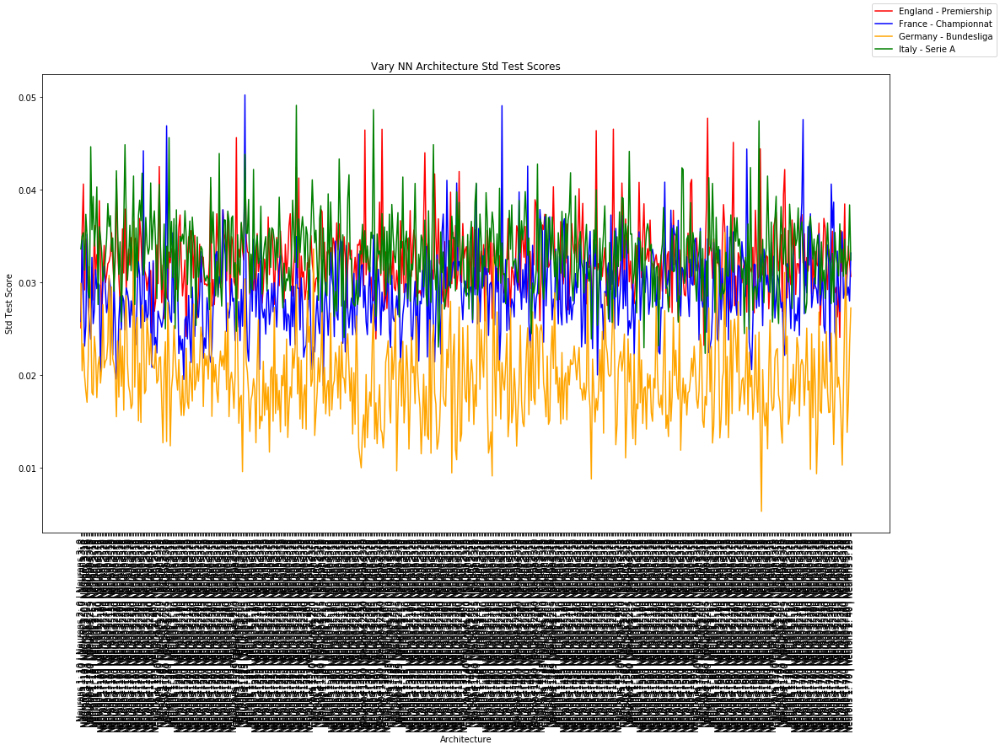

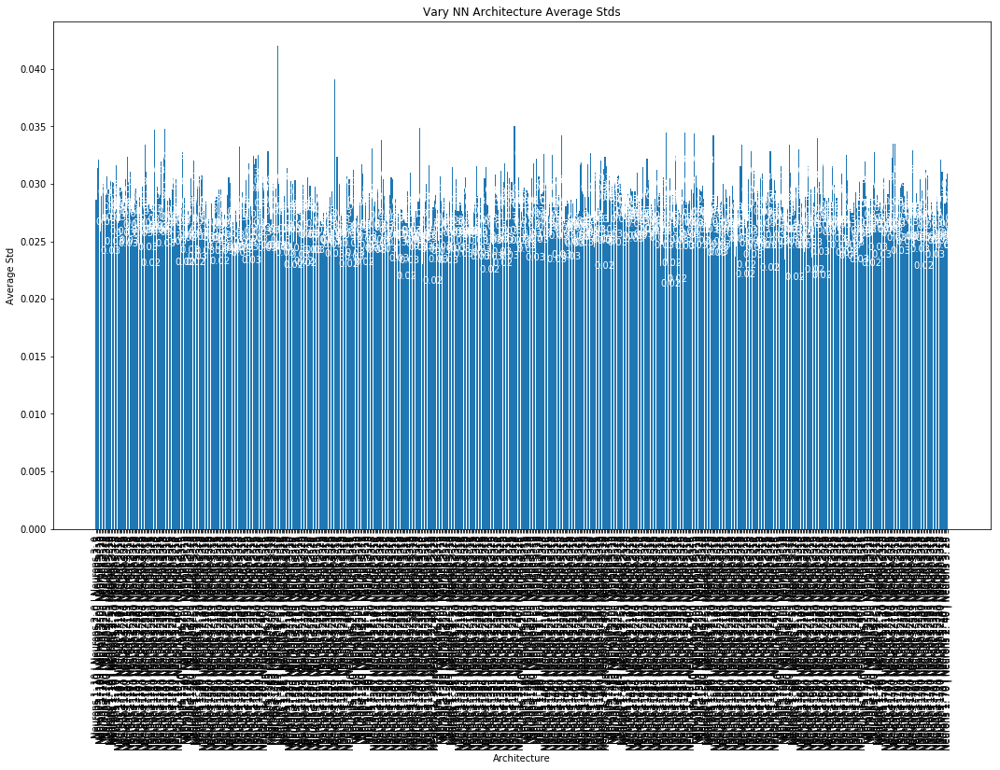

In [23]:
run_grid_search(nn_08_17, 
                nn_08_17_lbls,
                labels, 
                competitions,
                "Architecture",
                "Vary NN Architecture",
                neurons_1=neurons_1, 
                neurons_2=neurons_2, 
                neurons_3=neurons_3, 
                batch_size=[128],
                epochs=[30],
                optimizer=["Adam"],
                learn_rate=[0.001],
                init_mode=["glorot_uniform"],
                activation=['relu'])

In [18]:
settings = {'England - Premiership': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"],
                                          neurons_1=[20],
                                          neurons_2=[20]),
             'France - Championnat': dict(optimizer=["Adamax"],
                                          batch_size=[128],
                                          epochs=[30],
                                          learn_rate=[0.001],
                                          init_mode=["glorot_uniform"],
                                          neurons_1=[30],
                                          neurons_2=[5],
                                          neurons_3=[5]),
             'Germany - Bundesliga': dict(optimizer=["Adagrad"],
                                          batch_size=[128],
                                          epochs=[50],
                                          learn_rate=[0.0005],
                                          init_mode=["uniform"],
                                          neurons_1=[25],
                                          neurons_2=[25]),
             'Italy - Serie A': dict(optimizer=["Adagrad"],
                                     batch_size=[128],
                                     epochs=[30],
                                     learn_rate=[0.001],
                                     init_mode=["glorot_uniform"],
                                     neurons_1=[20],
                                     neurons_2=[20],
                                     neurons_3=[10])}


run_separate_grid_search(nn_all, 
                         nn_all_lbls,
                         labels, 
                         competitions,
                         "Architecture",
                         "Vary NN Architecture",
                         settings,
                         neurons_1=neurons_1, 
                         neurons_2=neurons_2, 
                         neurons_3=neurons_3)

NameError: name 'labels' is not defined

In [53]:
def find_best_architecture(excel_name):
    
    def calc_score(accuracy, std):
        return accuracy - 1.5 * std
    
    def parse_data(file_name):
        data = pd.read_excel(name)
        acc = []
        std = []
        arch = []
        for index, info in data.iterrows():
            arch.append(info['Data'])
            retrieved = re.findall("\d+\.\d+", info['Data'])
            acc.append(float(retrieved[0]))
            std.append(float(retrieved[1]))
        return acc, std, arch

    if isinstance(excel_name, str):
        excel_name = [excel_name]
    
    accuracies = []
    stds = []
    architectures = []
    for name in excel_name:
        new_acc, new_std, new_arch = parse_data(name)
        accuracies.append(new_acc)
        stds.append(new_std)
        architectures.append(new_arch)
    
    scores = []
    for accuracy, std in zip(accuracies, stds):
        scores.append([])
        for acc, sd in zip(accuracy, std):
            scores[-1].append(calc_score(acc, sd))
    
    
    if len(scores) == 1:
        top_3 = sorted(zip(scores[0], architectures[0]), reverse=True)[:3]
        print("\nTop 1: Max %s for architecture %s" % (top_3[0][0], top_3[0][1]))
        print("Top 2: Max %s for architecture %s" % (top_3[1][0], top_3[1][1]))
        print("Top 3: Max %s for architecture %s" % (top_3[2][0], top_3[2][1]))
    else:
        scores = [sum(x) / len(x) for x in zip(*scores)]
        top_3_eng = sorted(zip(scores, architectures[0], accuracies[0], stds[0]), reverse=True)[:3]
        top_3_fr = sorted(zip(scores, architectures[1], accuracies[1], stds[1]), reverse=True)[:3]
        top_3_ger = sorted(zip(scores, architectures[2], accuracies[2], stds[2]), reverse=True)[:3]
        top_3_it = sorted(zip(scores, architectures[3], accuracies[3], stds[3]), reverse=True)[:3]
        print("Max %s" % (max(scores)))
        print("Architectures:")
        
        print("\nEngland")
        print("Top 1: %s\nTop 2: %s\nTop 3: %s" % (top_3_eng[0][1], top_3_eng[1][1], top_3_eng[2][1]))
        
        print("\nFrance")
        print("Top 1: %s\nTop 2: %s\nTop 3: %s" % (top_3_fr[0][1], top_3_fr[1][1], top_3_fr[2][1]))
        
        print("\nGermany")
        print("Top 1: %s\nTop 2: %s\nTop 3: %s" % (top_3_ger[0][1], top_3_ger[1][1], top_3_ger[2][1]))
        
        print("\nItaly")
        print("Top 1: %s\nTop 2: %s\nTop 3: %s" % (top_3_it[0][1], top_3_it[1][1], top_3_it[2][1]))
        
        
        """
        print("%s\nFrance %s\nGermany %s\nItaly %s" % (architectures[0][scores.index(max(scores))],
                                                                               architectures[1][scores.index(max(scores))],
                                                                               architectures[2][scores.index(max(scores))],
                                                                               architectures[3][scores.index(max(scores))]))
        """
        print("\nAverage accuracy %s" % ((top_3_eng[0][2] + top_3_fr[0][2] + top_3_ger[0][2] + top_3_it[0][2]) / 4))
        print("Average std %s" % ((top_3_eng[0][3] + top_3_fr[0][3] + top_3_ger[0][3] + top_3_it[0][3]) / 4))
    
names = ["Data/NN Architecture/England Premiership.xlsx", 
         "Data/NN Architecture/France Championnat.xlsx", 
         "Data/NN Architecture/Germany Bundesliga.xlsx", 
         "Data/NN Architecture/Italy Serie A.xlsx"]
for name in names:
    find_best_architecture(name)
find_best_architecture(names)


Top 1: Max 0.505524 for architecture 0.544542 (0.026012) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 10, 'neurons_3': 10, 'optimizer': 'Adam'}
Top 2: Max 0.5029250000000001 for architecture 0.540590 (0.025110) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 0, 'neurons_3': 0, 'optimizer': 'Adam'}
Top 3: Max 0.502852 for architecture 0.538462 (0.023740) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 10, 'neurons_2': 40, 'neurons_3': 5, 'optimizer': 'Adam'}

Top 1: Max 0.47795050000000006 for architecture 0.506275 (0.018883) with: {'activation': 'relu', 'batch_size': 128, 'epochs': 30, 'init_mode': 'glorot_uniform', 'learn_rate': 0.001, 'neurons_1': 30, 'neurons_2': 5, 'neurons_3': 5, 'optimizer': 'Adam'}
Top 2: Max

## NFL

In [11]:
nfl_comp_paths = ['Data/NFL/NFL']
nfl_comp_name = ['NFL']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]
# Read in NFL data
nfl_data = get_sport_data(nfl_comp_name, 
                          years, 
                          nfl_comp_paths, 
                          lambda competition, year: str(competition) + str(year) + '.csv', 
                          required_fields=[("Home Score", int), 
                                           ("Away Score", int), 
                                           ("Home Odds Open", float), 
                                           ("Away Odds Open", float)],
                          reverse=True)

# Calculate extra fields required for the NN
nfl_data = calc_extra_attributes(nfl_data,
                                 home_team='Home Team', 
                                 away_team='Away Team', 
                                 home_score='Home Score', 
                                 away_score='Away Score')

columns = ['Home Odds Open', 
           'Away Odds Open', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away', 
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20']

# Want to only get columns that NN uses
nfl_data, nfl_labels = extract_columns(nfl_data, columns)
# Retrieve train and test data/labels
nfl_train, nfl_test = get_train_test(nfl_data, years, nfl_labels, test_year=2018)

Got data for Data/NFL/NFL2008.csv (278)
Got data for Data/NFL/NFL2009.csv (267)
Got data for Data/NFL/NFL2010.csv (267)
Got data for Data/NFL/NFL2011.csv (267)
Got data for Data/NFL/NFL2012.csv (266)
Got data for Data/NFL/NFL2013.csv (268)
Got data for Data/NFL/NFL2014.csv (267)
Got data for Data/NFL/NFL2015.csv (267)
Got data for Data/NFL/NFL2016.csv (267)
Got data for Data/NFL/NFL2017.csv (267)
Got data for Data/NFL/NFL2018.csv (256)
Got data for Data/NFL/NFL2008.csv (267)
Dropped 11 matches
Got data for Data/NFL/NFL2009.csv (267)
Got data for Data/NFL/NFL2010.csv (267)
Got data for Data/NFL/NFL2011.csv (267)
Got data for Data/NFL/NFL2012.csv (266)
Got data for Data/NFL/NFL2013.csv (268)
Got data for Data/NFL/NFL2014.csv (267)
Got data for Data/NFL/NFL2015.csv (267)
Got data for Data/NFL/NFL2016.csv (267)
Got data for Data/NFL/NFL2017.csv (267)
Got data for Data/NFL/NFL2018.csv (256)
Not enough data for year 2008
Processed 2009
Processed 2010
Processed 2011
Processed 2012
Processed 2

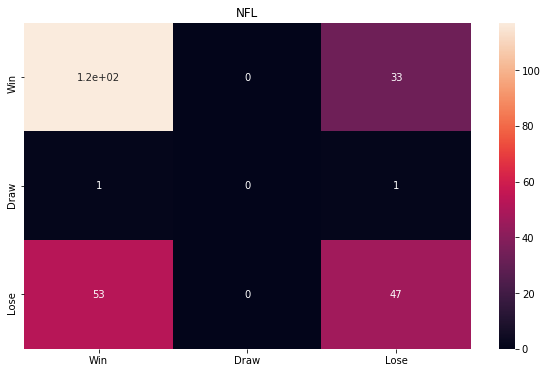

Accuracy 65.08
MAE 0.9506098447702063
RMSE 0.9509345042003235
Precision: 	Win 0.68 	Draw 0.00 	Lose 0.58 
Recall: 	Win 0.78 	Draw 0.00 	Lose 0.47 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.52 


In [12]:
# Get bookie accuracy for NFL
get_bookie_accuracy(nfl_comp_name, nfl_test[0], nfl_test[1], draw=False)

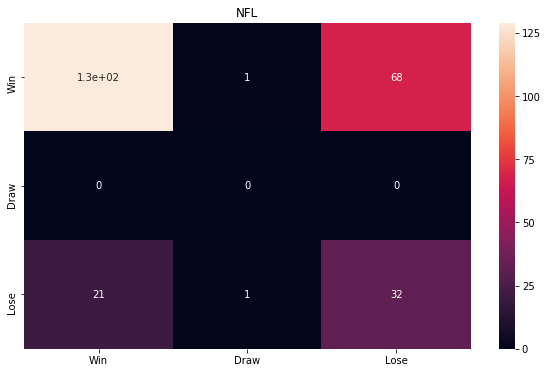

Accuracy 63.888888888888886
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.32 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.42 
Iteration 0 COMPLETE (1/25)
Time remaining: 1870.072975 seconds (31.167882916666667 min)


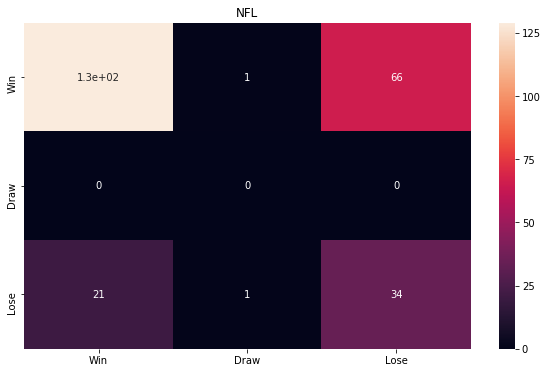

Accuracy 64.68253968253968
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 1 COMPLETE (2/25)
Time remaining: 1776.5109599999998 seconds (29.608515999999998 min)


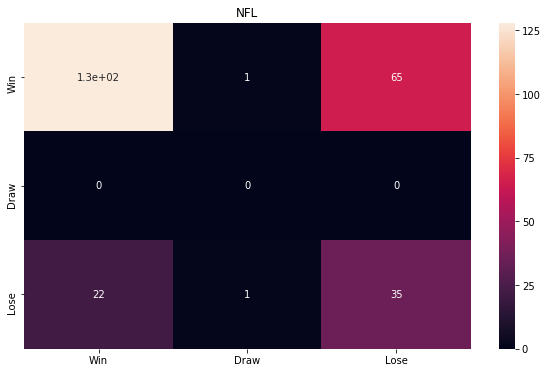

Accuracy 64.68253968253968
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.35 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.44 
Iteration 2 COMPLETE (3/25)
Time remaining: 1564.2437080000002 seconds (26.07072846666667 min)


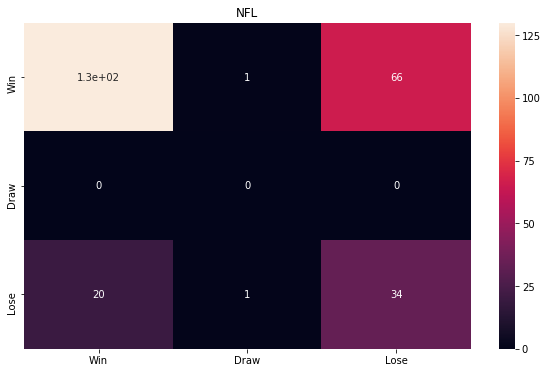

Accuracy 65.07936507936508
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 3 COMPLETE (4/25)
Time remaining: 1511.2936300000001 seconds (25.188227166666668 min)


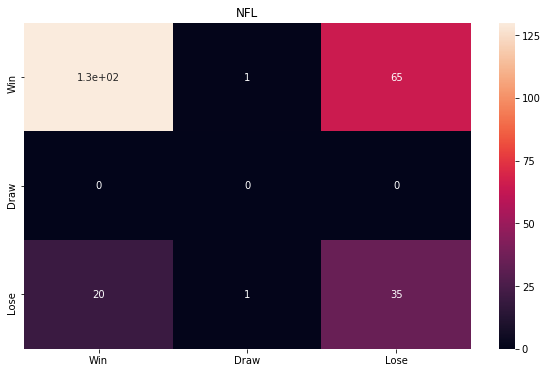

Accuracy 65.47619047619048
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.35 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.45 
Iteration 4 COMPLETE (5/25)
Time remaining: 1439.204256 seconds (23.9867376 min)


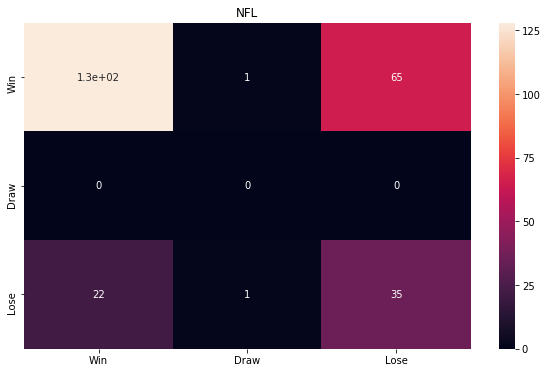

Accuracy 64.68253968253968
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.35 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.44 
Iteration 5 COMPLETE (6/25)
Time remaining: 1404.12454 seconds (23.40207566666667 min)


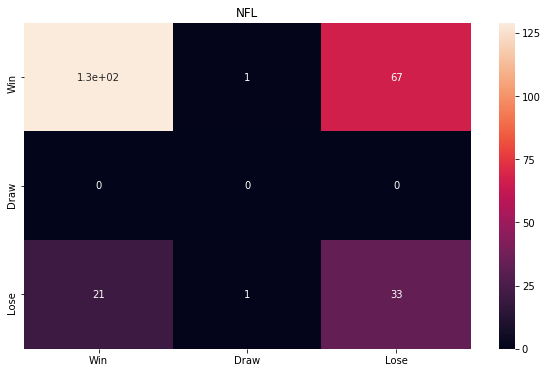

Accuracy 64.28571428571429
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.43 
Iteration 6 COMPLETE (7/25)
Time remaining: 1358.425653 seconds (22.640427550000002 min)


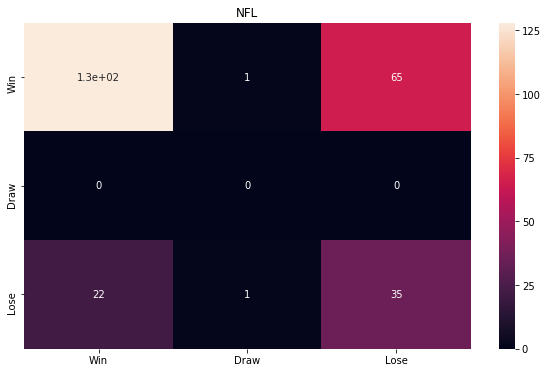

Accuracy 64.68253968253968
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.35 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.44 
Iteration 7 COMPLETE (8/25)
Time remaining: 1326.925134 seconds (22.1154189 min)


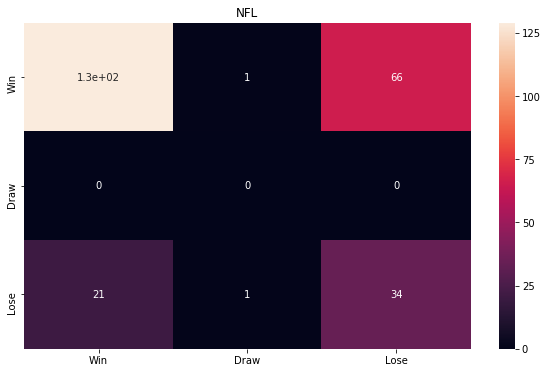

Accuracy 64.68253968253968
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 8 COMPLETE (9/25)
Time remaining: 1353.7712680000002 seconds (22.56285446666667 min)


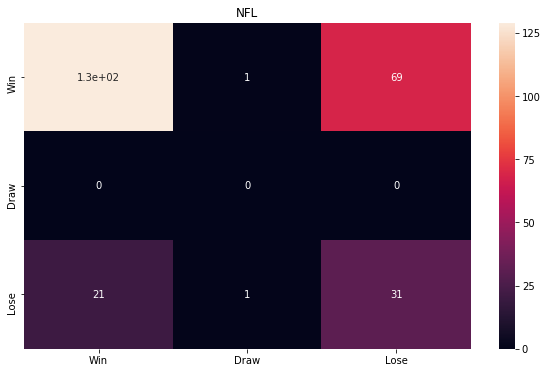

Accuracy 63.49206349206349
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.41 
Iteration 9 COMPLETE (10/25)
Time remaining: 1230.083264 seconds (20.501387733333335 min)


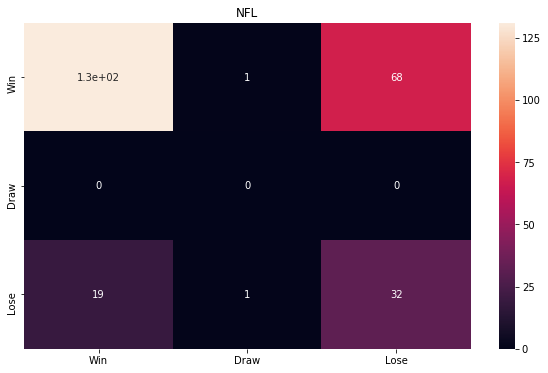

Accuracy 64.68253968253968
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.32 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.42 
Iteration 10 COMPLETE (11/25)
Time remaining: 1190.643615 seconds (19.84406025 min)


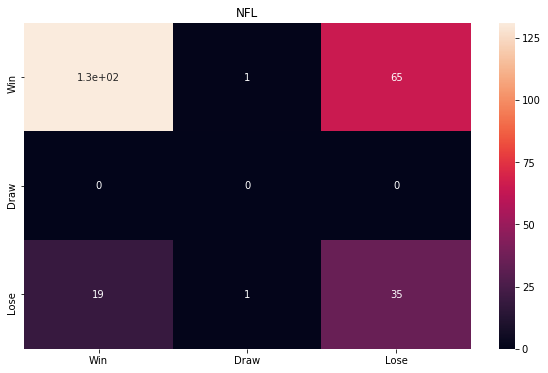

Accuracy 65.87301587301587
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.35 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.76 	Draw 0.00 	Lose 0.45 
Iteration 11 COMPLETE (12/25)
Time remaining: 1122.5214139999998 seconds (18.708690233333332 min)


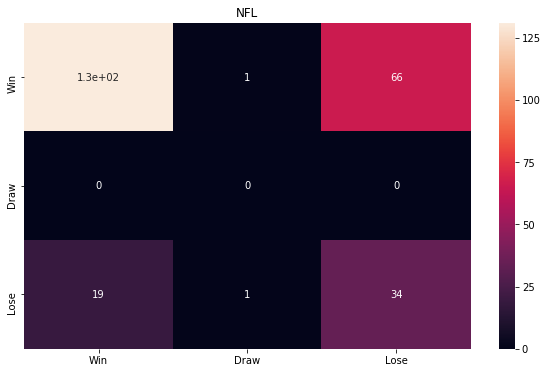

Accuracy 65.47619047619048
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.63 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 12 COMPLETE (13/25)
Time remaining: 1037.455926 seconds (17.290932100000003 min)


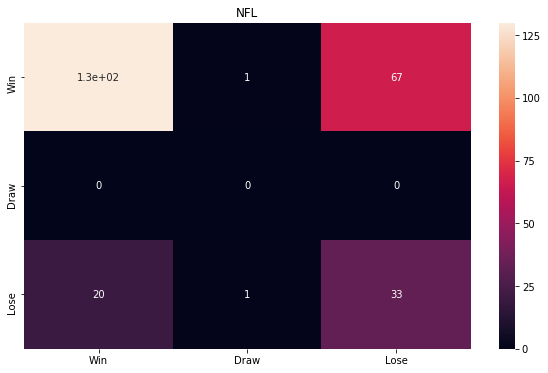

Accuracy 64.68253968253968
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.43 
Iteration 13 COMPLETE (14/25)
Time remaining: 879.9934680000001 seconds (14.666557800000001 min)


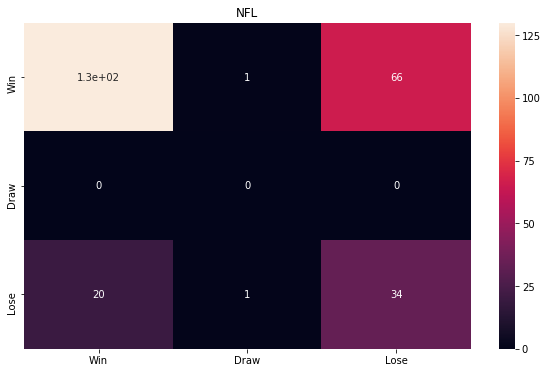

Accuracy 65.07936507936508
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 14 COMPLETE (15/25)
Time remaining: 819.8923920000001 seconds (13.6648732 min)


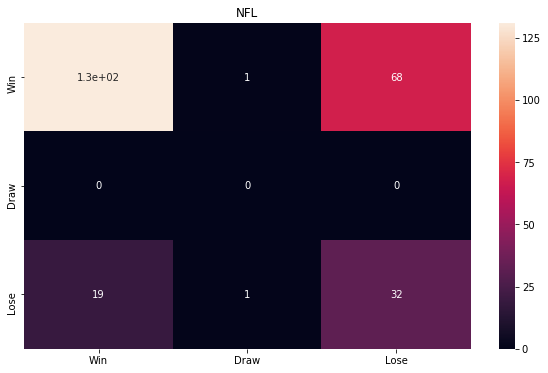

Accuracy 64.68253968253968
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.32 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.42 
Iteration 15 COMPLETE (16/25)
Time remaining: 719.0367200000001 seconds (11.983945333333335 min)


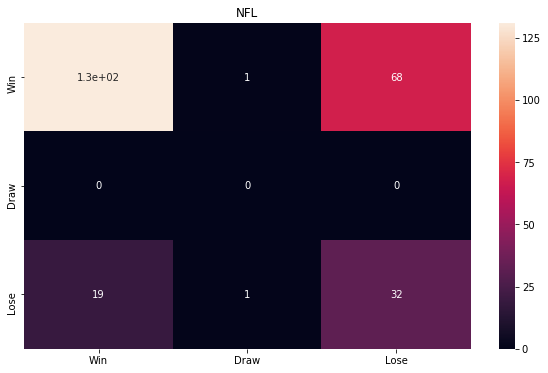

Accuracy 64.68253968253968
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.32 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.42 
Iteration 16 COMPLETE (17/25)
Time remaining: 628.308882 seconds (10.471814700000001 min)


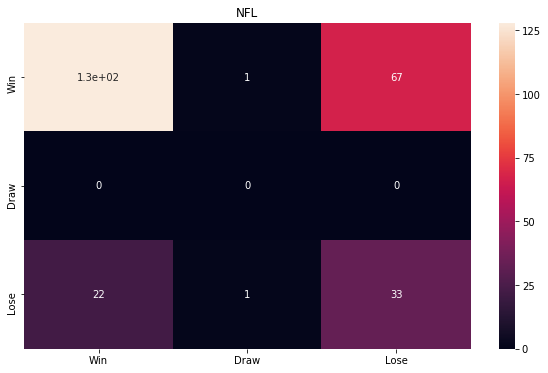

Accuracy 63.888888888888886
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.42 
Iteration 17 COMPLETE (18/25)
Time remaining: 585.154656 seconds (9.7525776 min)


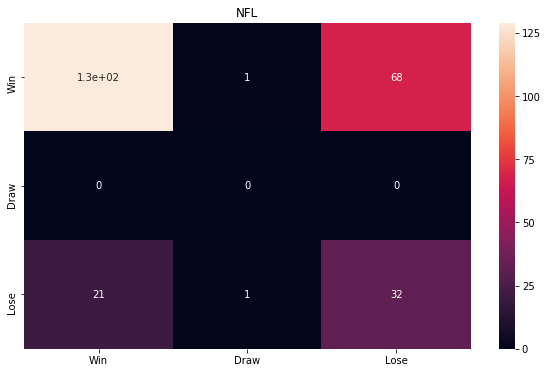

Accuracy 63.888888888888886
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.32 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.42 
Iteration 18 COMPLETE (19/25)
Time remaining: 547.111908 seconds (9.1185318 min)


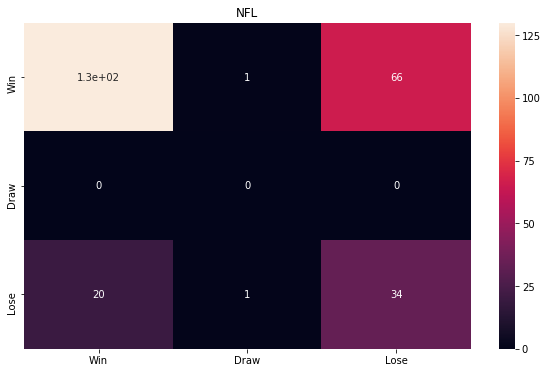

Accuracy 65.07936507936508
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 19 COMPLETE (20/25)
Time remaining: 453.7467 seconds (7.562444999999999 min)


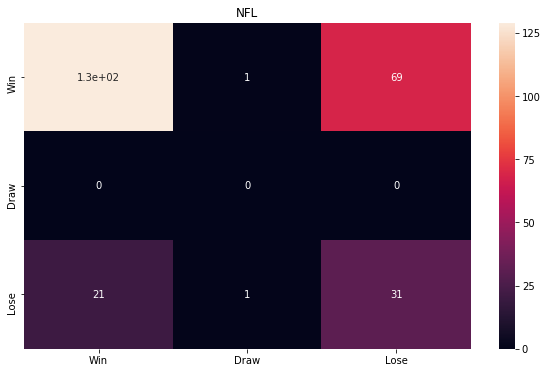

Accuracy 63.49206349206349
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.41 
Iteration 20 COMPLETE (21/25)
Time remaining: 360.69664 seconds (6.011610666666667 min)


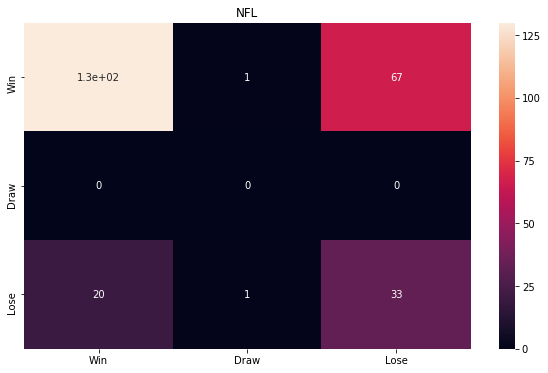

Accuracy 64.68253968253968
Precision: 	Win 0.87 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.43 
Iteration 21 COMPLETE (22/25)
Time remaining: 283.856228 seconds (4.730937133333333 min)


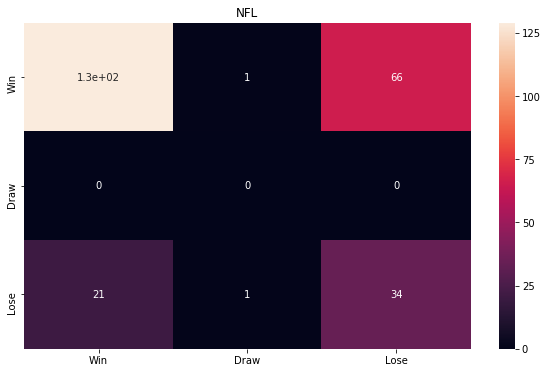

Accuracy 64.68253968253968
Precision: 	Win 0.86 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.75 	Draw 0.00 	Lose 0.44 
Iteration 22 COMPLETE (23/25)
Time remaining: 215.35511400000001 seconds (3.5892519000000003 min)


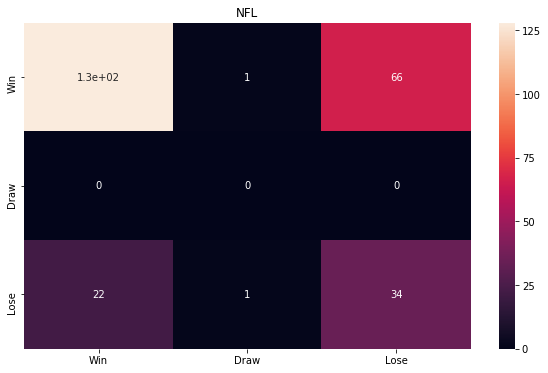

Accuracy 64.28571428571429
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.34 
Recall: 	Win 0.66 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.43 
Iteration 23 COMPLETE (24/25)
Time remaining: 152.238234 seconds (2.5373039 min)


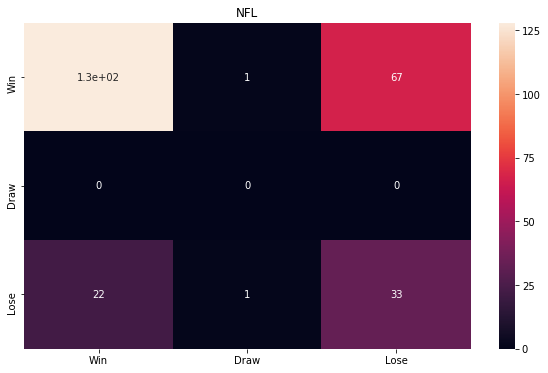

Accuracy 63.888888888888886
Precision: 	Win 0.85 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.59 
F1: 	Win 0.74 	Draw 0.00 	Lose 0.42 
Iteration 24 COMPLETE (25/25)
Time remaining: 80.964629 seconds (1.3494104833333334 min)

NFL
Model Summary after 25 iterations:64.5873015873016 - test accuracy 
0.5862281051625218 - acc std


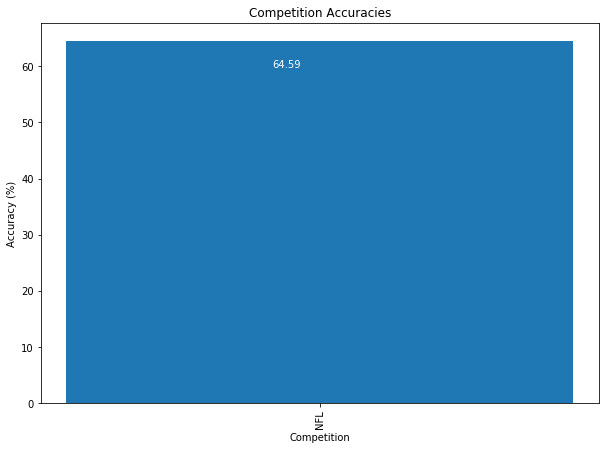

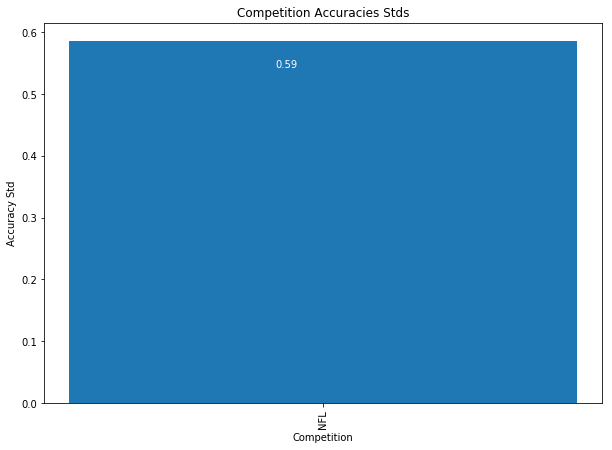

In [14]:
competition_stats = {'NFL': NnParams(batch_size=128,
                                     epochs=40,
                                     optimizer="Adam",
                                     learn_rate=0.001,
                                     init_mode="glorot_uniform",
                                     neurons_1=10,
                                     neurons_2=10,
                                     neurons_3=0,
                                     activation="relu",
                                     dropout=0)}

run_nn(nfl_train[0], 
       nfl_train[1], 
       nfl_test[0], 
       nfl_test[1], 
       nfl_comp_name, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=2)

## NBL

In [26]:
nbl_comp_paths = ['Data/NBL/NBL']
nbl_comp_name = ['NBL']
years = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in football data
nbl_data = get_sport_data(nbl_comp_name, 
                          years, 
                          nbl_comp_paths, 
                          lambda competition, year: str(competition) + str(year) +"-" + str(year+1) + '.csv', 
                          required_fields=[("Home Score", int), 
                                           ("Away Score", int), 
                                           ("Home Odds", float), 
                                           ("Away Odds", float)],
                          reverse=True)

# Calculate extra fields required for the NN
nbl_data = calc_extra_attributes(nbl_data,
                                 home_team='Home Team', 
                                 away_team='Away Team', 
                                 home_score='Home Score', 
                                 away_score='Away Score')

columns = ['Home Odds', 
           'Away Odds', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away', 
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20']

# Want to only get columns that NN uses
nbl_data, nbl_labels = extract_columns(nbl_data, columns)
# Retrieve train and test data/labels
nbl_train, nbl_test = get_train_test(nbl_data, years, nbl_labels, test_year=2018)

Got data for Data/NBL/NBL2009-2010.csv (120)
Got data for Data/NBL/NBL2010-2011.csv (135)
Got data for Data/NBL/NBL2011-2012.csv (135)
Got data for Data/NBL/NBL2012-2013.csv (118)
Got data for Data/NBL/NBL2013-2014.csv (120)
Got data for Data/NBL/NBL2014-2015.csv (118)
Got data for Data/NBL/NBL2015-2016.csv (120)
Got data for Data/NBL/NBL2016-2017.csv (120)
Got data for Data/NBL/NBL2017-2018.csv (121)
Got data for Data/NBL/NBL2018-2019.csv (120)
Got data for Data/NBL/NBL2009-2010.csv (107)
Dropped 13 matches
Got data for Data/NBL/NBL2010-2011.csv (132)
Dropped 3 matches
Got data for Data/NBL/NBL2011-2012.csv (135)
Got data for Data/NBL/NBL2012-2013.csv (118)
Got data for Data/NBL/NBL2013-2014.csv (120)
Got data for Data/NBL/NBL2014-2015.csv (118)
Got data for Data/NBL/NBL2015-2016.csv (120)
Got data for Data/NBL/NBL2016-2017.csv (120)
Got data for Data/NBL/NBL2017-2018.csv (121)
Got data for Data/NBL/NBL2018-2019.csv (120)
Processed 2009
Processed 2010
Processed 2011
Processed 2012
Pro

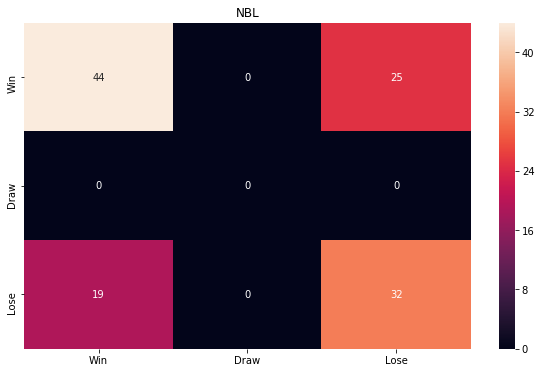

Accuracy 63.33
MAE 0.8726321195144724
RMSE 0.874568081016361
Precision: 	Win 0.70 	Draw 0.00 	Lose 0.56 
Recall: 	Win 0.64 	Draw 0.00 	Lose 0.63 
F1: 	Win 0.67 	Draw 0.00 	Lose 0.59 


In [70]:
# Get bookie accuracy for NBL
get_bookie_accuracy(nbl_comp_name, nbl_test[0], nbl_test[1], draw=False)

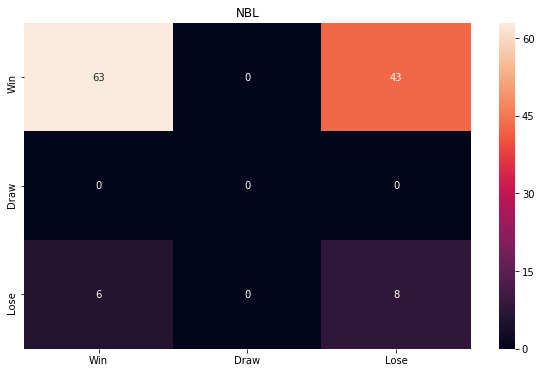

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 0 COMPLETE (1/25)
Time remaining: 1422.260475 seconds (23.704341250000002 min)


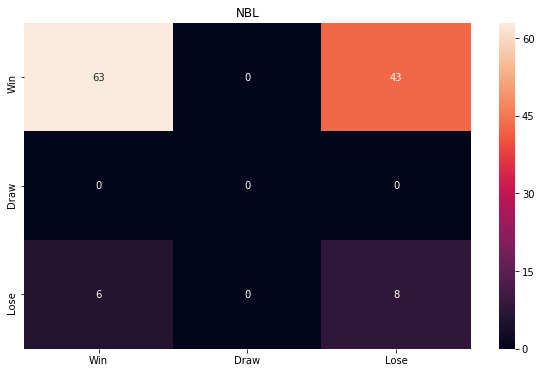

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 1 COMPLETE (2/25)
Time remaining: 1375.41012 seconds (22.923502 min)


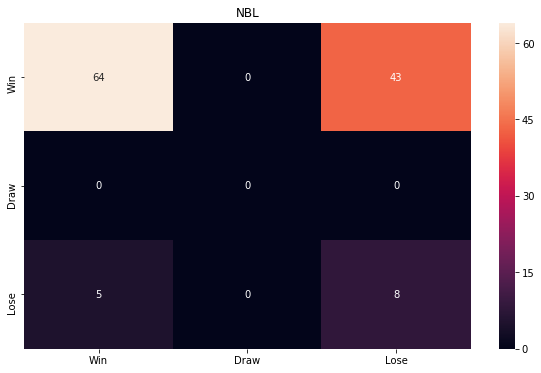

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 2 COMPLETE (3/25)
Time remaining: 1297.924845 seconds (21.63208075 min)


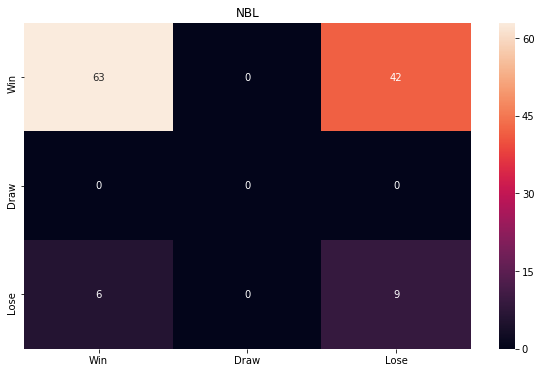

Accuracy 60.0
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.27 
Iteration 3 COMPLETE (4/25)
Time remaining: 1242.6260659999998 seconds (20.71043443333333 min)


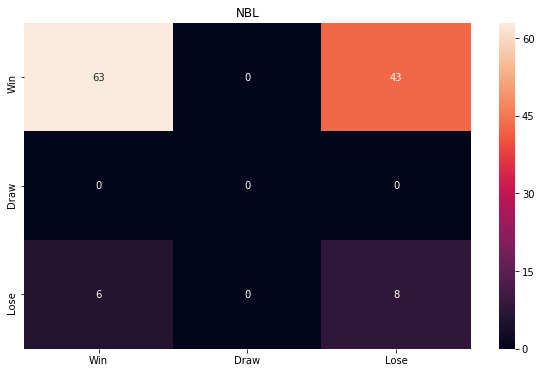

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 4 COMPLETE (5/25)
Time remaining: 1172.524038 seconds (19.5420673 min)


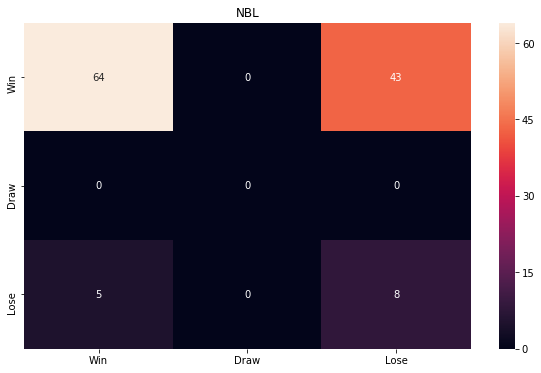

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 5 COMPLETE (6/25)
Time remaining: 1133.78894 seconds (18.89648233333333 min)


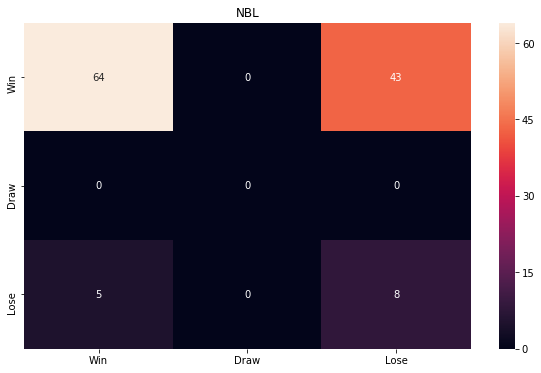

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 6 COMPLETE (7/25)
Time remaining: 1067.6315650000001 seconds (17.79385941666667 min)


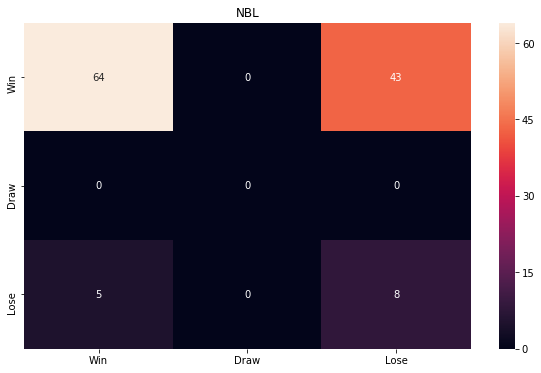

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 7 COMPLETE (8/25)
Time remaining: 998.95329 seconds (16.6492215 min)


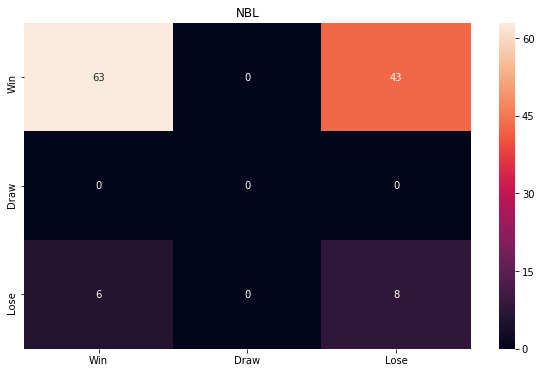

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 8 COMPLETE (9/25)
Time remaining: 956.474978 seconds (15.941249633333333 min)


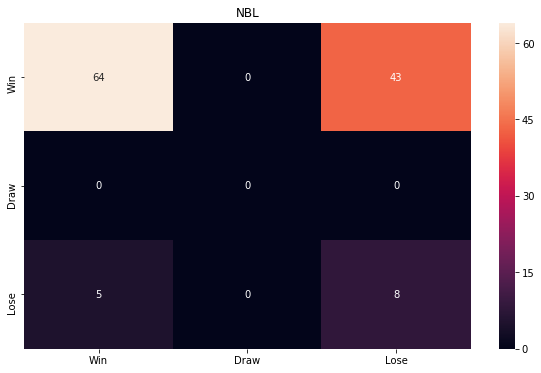

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 9 COMPLETE (10/25)
Time remaining: 889.689792 seconds (14.8281632 min)


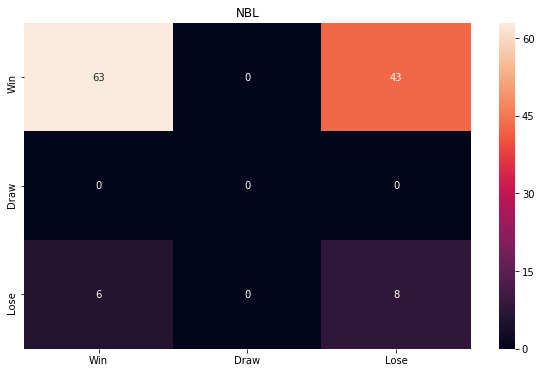

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 10 COMPLETE (11/25)
Time remaining: 823.19358 seconds (13.719893 min)


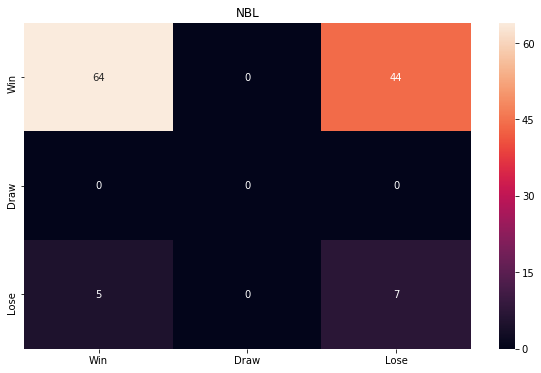

Accuracy 59.166666666666664
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.14 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.22 
Iteration 11 COMPLETE (12/25)
Time remaining: 774.5187520000001 seconds (12.908645866666667 min)


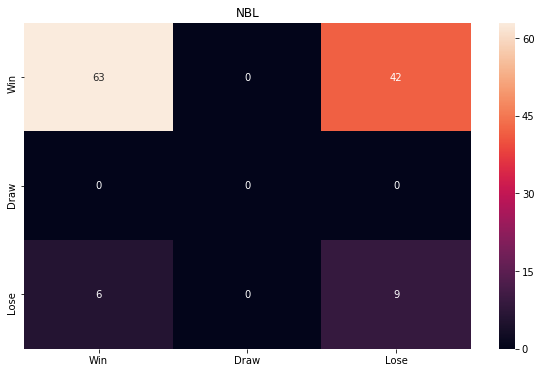

Accuracy 60.0
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.27 
Iteration 12 COMPLETE (13/25)
Time remaining: 744.372837 seconds (12.40621395 min)


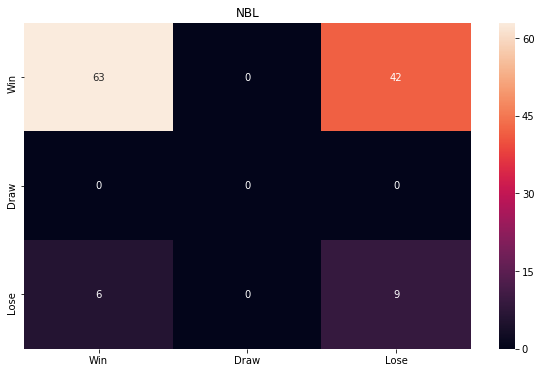

Accuracy 60.0
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.27 
Iteration 13 COMPLETE (14/25)
Time remaining: 656.3307 seconds (10.938844999999999 min)


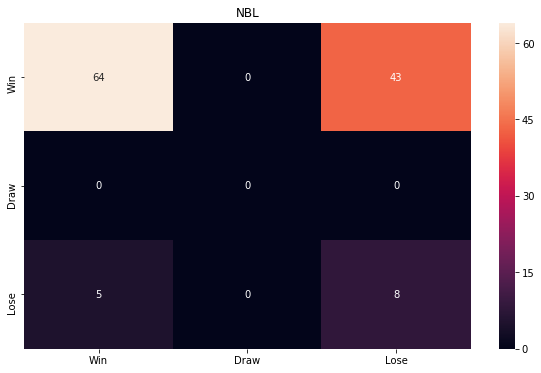

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 14 COMPLETE (15/25)
Time remaining: 615.600546 seconds (10.2600091 min)


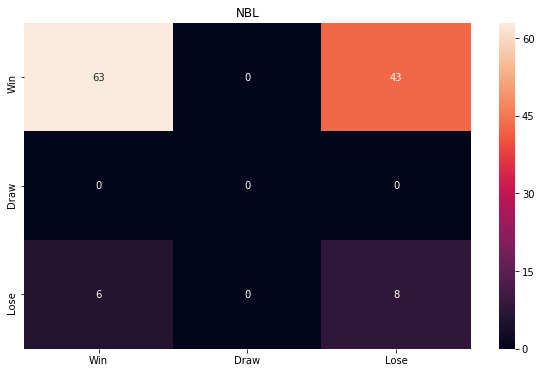

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 15 COMPLETE (16/25)
Time remaining: 554.17692 seconds (9.236282 min)


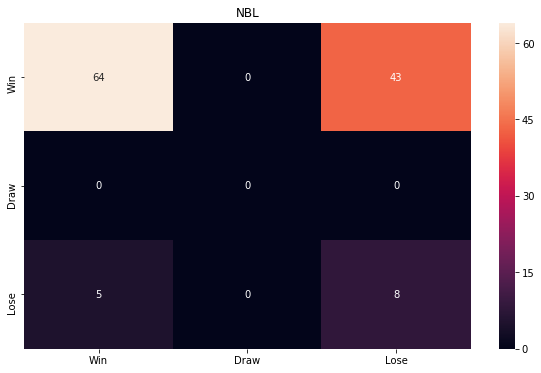

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 16 COMPLETE (17/25)
Time remaining: 500.7447 seconds (8.345745 min)


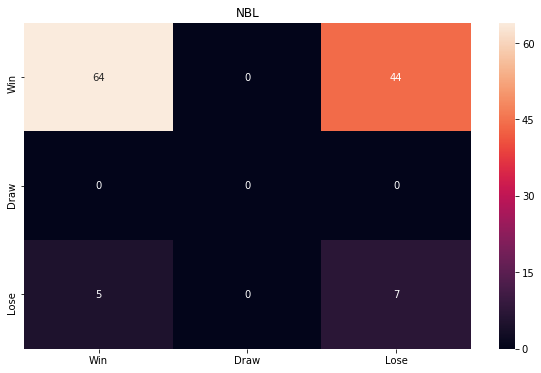

Accuracy 59.166666666666664
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.14 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.22 
Iteration 17 COMPLETE (18/25)
Time remaining: 450.864896 seconds (7.514414933333333 min)


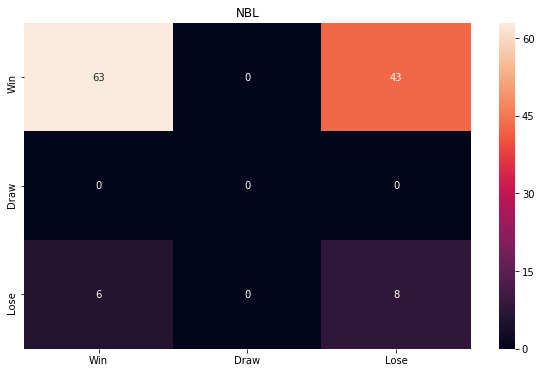

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 18 COMPLETE (19/25)
Time remaining: 396.75066899999996 seconds (6.61251115 min)


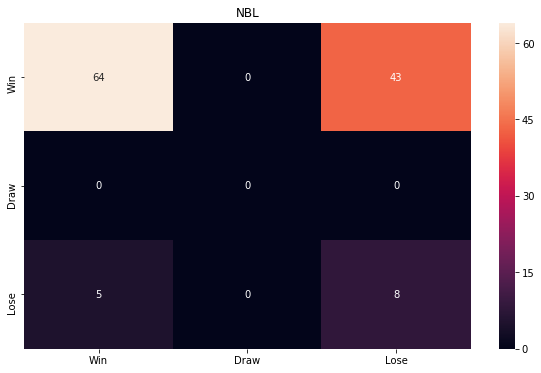

Accuracy 60.0
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.60 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.73 	Draw 0.00 	Lose 0.25 
Iteration 19 COMPLETE (20/25)
Time remaining: 338.177268 seconds (5.636287800000001 min)


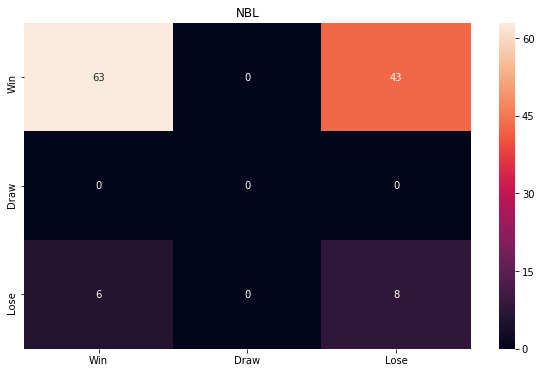

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 20 COMPLETE (21/25)
Time remaining: 275.708545 seconds (4.595142416666667 min)


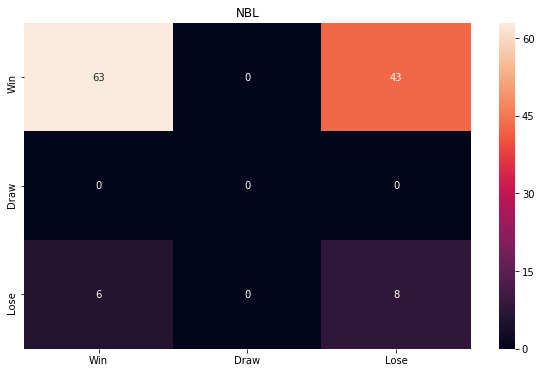

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 21 COMPLETE (22/25)
Time remaining: 223.384544 seconds (3.7230757333333333 min)


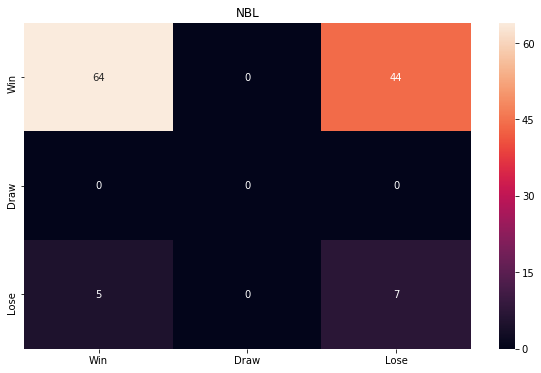

Accuracy 59.166666666666664
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.14 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.22 
Iteration 22 COMPLETE (23/25)
Time remaining: 166.021062 seconds (2.7670177 min)


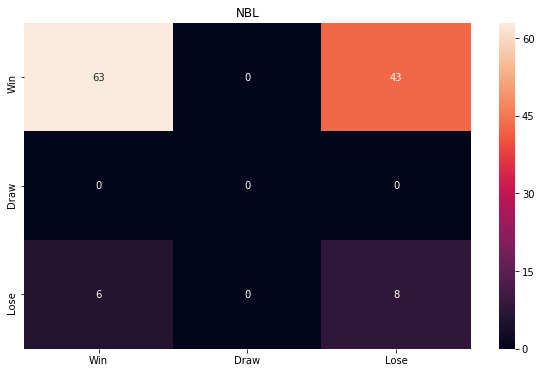

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 23 COMPLETE (24/25)
Time remaining: 111.82181 seconds (1.8636968333333332 min)


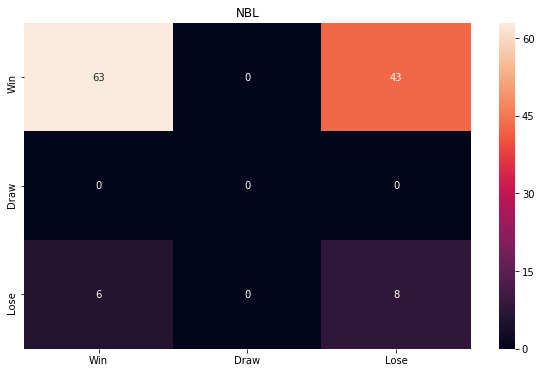

Accuracy 59.166666666666664
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.16 
Recall: 	Win 0.59 	Draw 0.00 	Lose 0.57 
F1: 	Win 0.72 	Draw 0.00 	Lose 0.25 
Iteration 24 COMPLETE (25/25)
Time remaining: 55.380401 seconds (0.9230066833333334 min)

NBL
Model Summary after 25 iterations:59.533333333333346 - test accuracy 
0.4136557881996964 - acc std


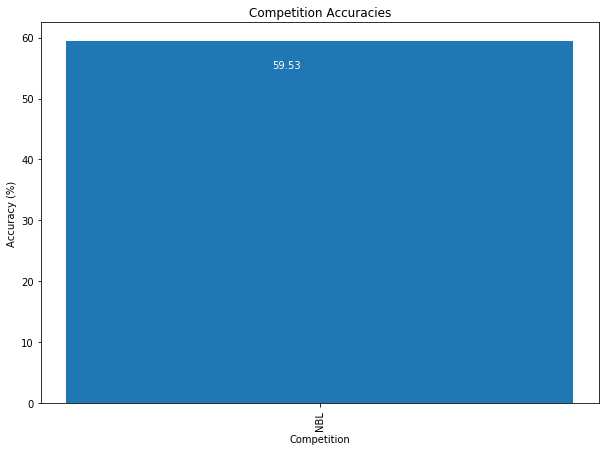

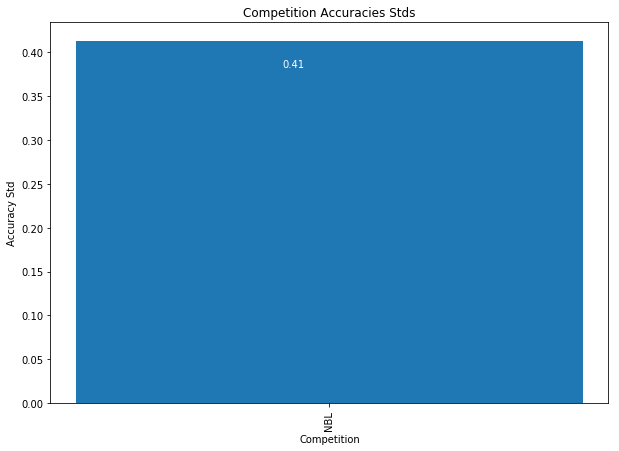

In [71]:
competition_stats = {'NBL': NnParams(batch_size=128,
                                     epochs=40,
                                     optimizer="Adam",
                                     learn_rate=0.001,
                                     init_mode="glorot_uniform",
                                     neurons_1=10,
                                     neurons_2=10,
                                     neurons_3=0,
                                     activation="relu",
                                     dropout=0)}

run_nn(nbl_train[0], 
       nbl_train[1], 
       nbl_test[0], 
       nbl_test[1], 
       nbl_comp_name, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=2)

## Super Rugby

In [15]:
sr_comp_paths = ['Data/Super Rugby/SuperRugby']
sr_comp_name = ['SuperRugby']
years = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

# Read in Super Rugby data
sr_data = get_sport_data(sr_comp_name, 
                         years, 
                         sr_comp_paths, 
                         lambda competition, year: str(competition) + str(year) + '.csv', 
                         required_fields=[("Home Score", int), 
                                          ("Away Score", int), 
                                          ("Home Odds", float), 
                                          ("Draw Odds", float), 
                                          ("Away Odds", float)],
                         reverse=True)

# Calculate extra fields required for the NN
sr_data = calc_extra_attributes(sr_data,
                                home_team='Home Team', 
                                away_team='Away Team', 
                                home_score='Home Score', 
                                away_score='Away Score')

columns = ['Home Odds', 
           'Draw Odds',
           'Away Odds', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away', 
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20']

# Want to only get columns that NN uses
sr_data, sr_labels = extract_columns(sr_data, columns)
# Retrieve train and test data/labels
sr_train, sr_test = get_train_test(sr_data, years, sr_labels, test_year=2019)

Got data for Data/Super Rugby/SuperRugby2009.csv (92)
Got data for Data/Super Rugby/SuperRugby2010.csv (94)
Got data for Data/Super Rugby/SuperRugby2011.csv (125)
Got data for Data/Super Rugby/SuperRugby2012.csv (125)
Got data for Data/Super Rugby/SuperRugby2013.csv (127)
Got data for Data/Super Rugby/SuperRugby2014.csv (125)
Got data for Data/Super Rugby/SuperRugby2015.csv (125)
Got data for Data/Super Rugby/SuperRugby2016.csv (142)
Got data for Data/Super Rugby/SuperRugby2017.csv (142)
Got data for Data/Super Rugby/SuperRugby2018.csv (127)
Got data for Data/Super Rugby/SuperRugby2019.csv (127)
Got data for Data/Super Rugby/SuperRugby2009.csv (75)
Dropped 17 matches
Got data for Data/Super Rugby/SuperRugby2010.csv (94)
Got data for Data/Super Rugby/SuperRugby2011.csv (124)
Dropped 1 matches
Got data for Data/Super Rugby/SuperRugby2012.csv (125)
Got data for Data/Super Rugby/SuperRugby2013.csv (127)
Got data for Data/Super Rugby/SuperRugby2014.csv (125)
Got data for Data/Super Rugby/Su

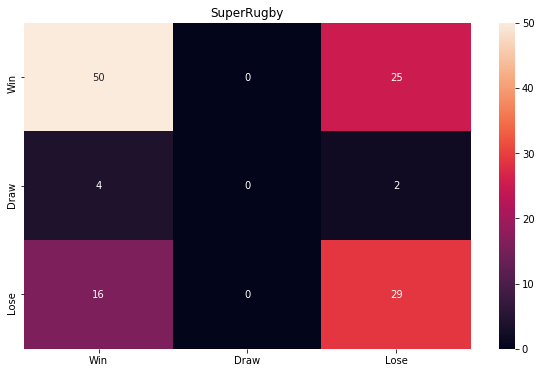

Accuracy 62.7
MAE 0.9307418785661291
RMSE 0.9363384462284559
Precision: 	Win 0.71 	Draw 0.00 	Lose 0.52 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.69 	Draw 0.00 	Lose 0.57 


In [16]:
# Get bookie accuracy for Super Rugby
get_bookie_accuracy(sr_comp_name, sr_test[0], sr_test[1], draw=False)

C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


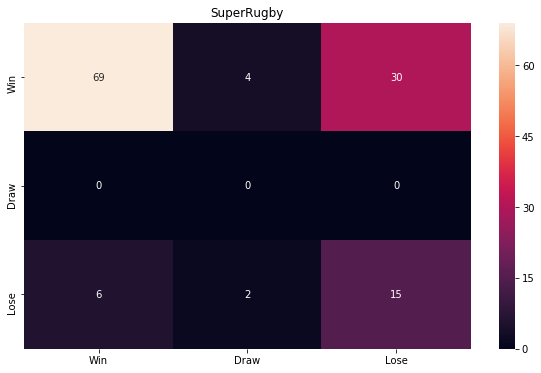

Accuracy 66.66666666666666
Precision: 	Win 0.92 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.44 
Iteration 0 COMPLETE (1/10)
Time remaining: 162.24813 seconds (2.7041355 min)


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


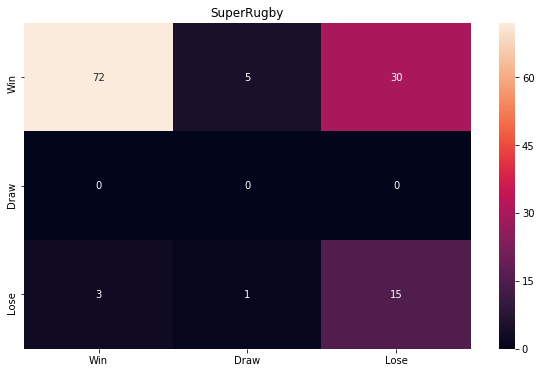

Accuracy 69.04761904761905
Precision: 	Win 0.96 	Draw 0.00 	Lose 0.33 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.79 
F1: 	Win 0.79 	Draw 0.00 	Lose 0.47 
Iteration 1 COMPLETE (2/10)
Time remaining: 9.520802999999999 seconds (0.15868005 min)


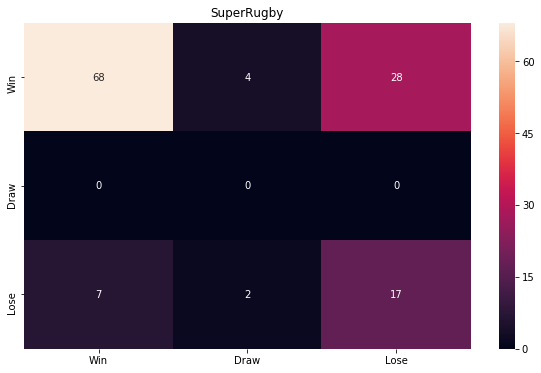

Accuracy 67.46031746031747
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.68 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.48 
Iteration 2 COMPLETE (3/10)
Time remaining: 10.377496 seconds (0.17295826666666667 min)


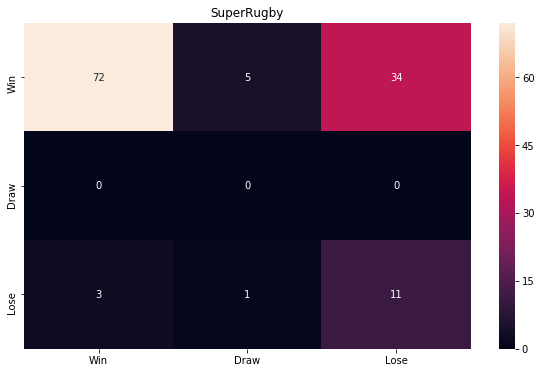

Accuracy 65.87301587301587
Precision: 	Win 0.96 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.73 
F1: 	Win 0.77 	Draw 0.00 	Lose 0.37 
Iteration 3 COMPLETE (4/10)
Time remaining: 7.977619999999999 seconds (0.13296033333333332 min)


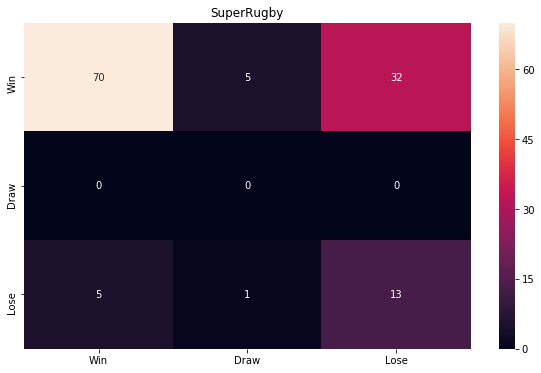

Accuracy 65.87301587301587
Precision: 	Win 0.93 	Draw 0.00 	Lose 0.29 
Recall: 	Win 0.65 	Draw 0.00 	Lose 0.68 
F1: 	Win 0.77 	Draw 0.00 	Lose 0.41 
Iteration 4 COMPLETE (5/10)
Time remaining: 8.400912 seconds (0.1400152 min)


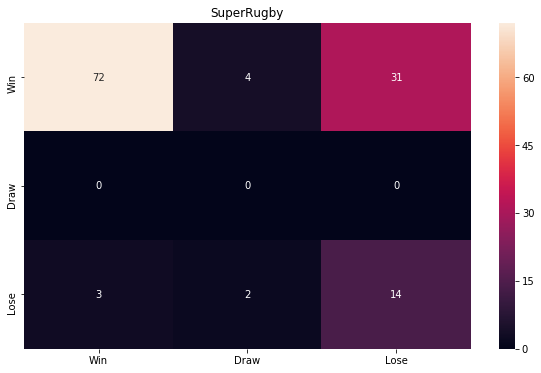

Accuracy 68.25396825396825
Precision: 	Win 0.96 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.74 
F1: 	Win 0.79 	Draw 0.00 	Lose 0.44 
Iteration 5 COMPLETE (6/10)
Time remaining: 5.849995 seconds (0.09749991666666666 min)


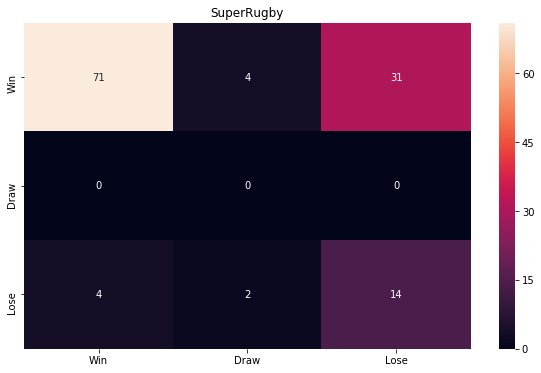

Accuracy 67.46031746031747
Precision: 	Win 0.95 	Draw 0.00 	Lose 0.31 
Recall: 	Win 0.67 	Draw 0.00 	Lose 0.70 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.43 
Iteration 6 COMPLETE (7/10)
Time remaining: 5.200456 seconds (0.08667426666666667 min)


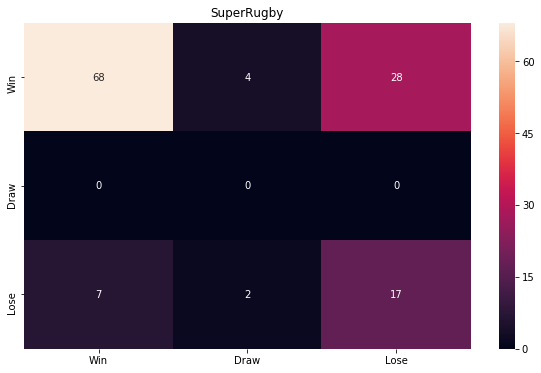

Accuracy 67.46031746031747
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.68 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.48 
Iteration 7 COMPLETE (8/10)
Time remaining: 3.449574 seconds (0.0574929 min)


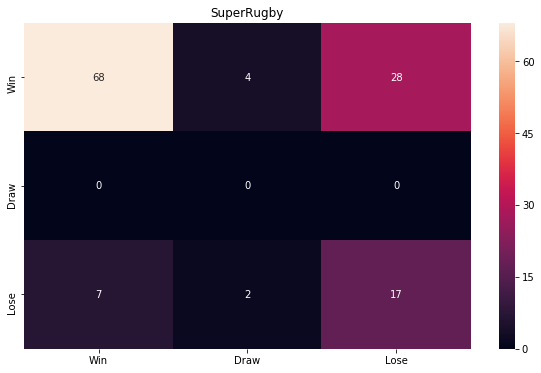

Accuracy 67.46031746031747
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.68 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.48 
Iteration 8 COMPLETE (9/10)
Time remaining: 2.239748 seconds (0.037329133333333334 min)


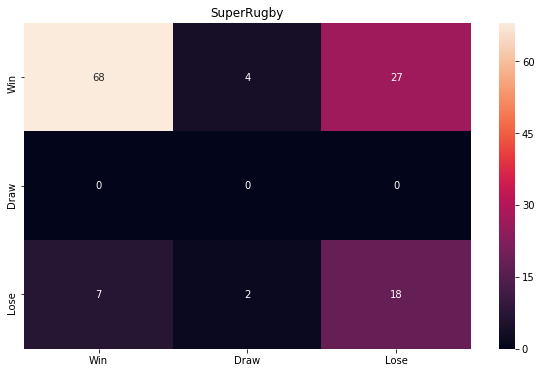

Accuracy 68.25396825396825
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.40 
Recall: 	Win 0.69 	Draw 0.00 	Lose 0.67 
F1: 	Win 0.78 	Draw 0.00 	Lose 0.50 
Iteration 9 COMPLETE (10/10)
Time remaining: 1.320175 seconds (0.022002916666666667 min)

SuperRugby
Model Summary after 10 iterations:67.38095238095238 - test accuracy 
0.9687742552169617 - acc std


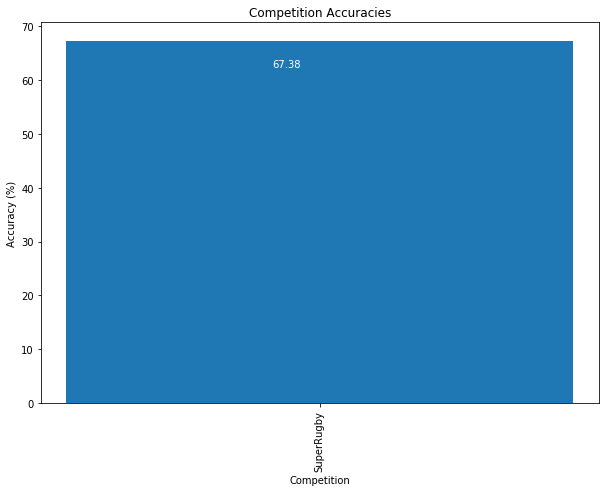

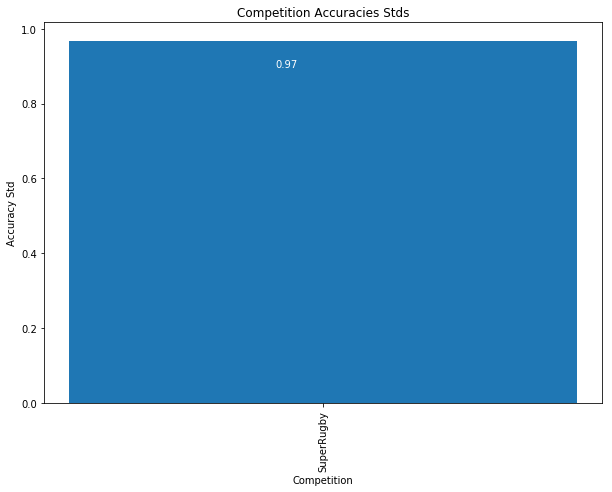

In [55]:
competition_stats = {'SuperRugby': NnParams(batch_size=128,
                                            epochs=40,
                                            optimizer="Adam",
                                            learn_rate=0.001,
                                            init_mode="glorot_uniform",
                                            neurons_1=10,
                                            neurons_2=10,
                                            neurons_3=0,
                                            activation="relu",
                                            dropout=0)}

run_nn(sr_train[0], 
       sr_train[1], 
       sr_test[0], 
       sr_test[1], 
       sr_comp_name, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=25, 
       verbose=2)

## Twenty20 Big Bash

In [50]:
tw_comp_paths = ['Data/Twenty20 Big Bash/TwentyBigBash']
tw_comp_name = ['TwentyBigBash']
years = [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in Twenty20 Big Bash data
tw_data = get_sport_data(tw_comp_name, 
                         years, 
                         tw_comp_paths, 
                         lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                         required_fields=[("Home Score", int),
                                          ("Away Score", int), 
                                          ("Home Odds", float), 
                                          ("Away Odds", float)],
                         reverse=True)

# Calculate extra fields required for the NN
tw_data = calc_extra_attributes(tw_data,
                                home_team='Home Team (H)', 
                                away_team='Away Team (A)', 
                                home_score='Home Score', 
                                away_score='Away Score')

columns = ['Home Odds',
           'Away Odds', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away', 
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20']

# Want to only get columns that NN uses
tw_data, tw_labels = extract_columns(tw_data, columns)
# Retrieve train and test data/labels
tw_train, tw_test = get_train_test(tw_data, years, tw_labels, test_year=[2017, 2018])

Got data for Data/Twenty20 Big Bash/TwentyBigBash2011-2012.csv (31)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2012-2013.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2013-2014.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2014-2015.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2015-2016.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2016-2017.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2017-2018.csv (43)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2018-2019.csv (43)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2011-2012.csv (31)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2012-2013.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2013-2014.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2014-2015.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2015-2016.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBash2016-2017.csv (35)
Got data for Data/Twenty20 Big Bash/TwentyBigBas

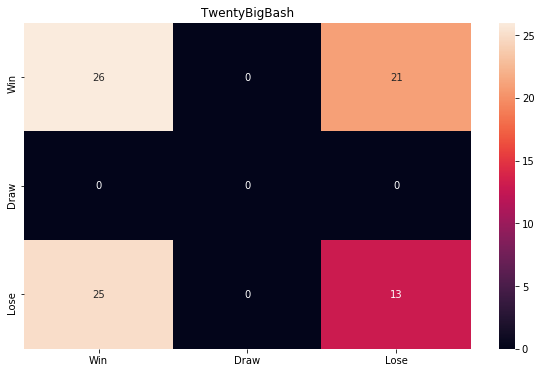

Accuracy 45.88
MAE 0.7890875395635517
RMSE 0.7963087397795303
Precision: 	Win 0.51 	Draw 0.00 	Lose 0.38 
Recall: 	Win 0.55 	Draw 0.00 	Lose 0.34 
F1: 	Win 0.53 	Draw 0.00 	Lose 0.36 


In [68]:
# Get bookie accuracy for Twenty20 Big Bash
get_bookie_accuracy(tw_comp_name, tw_test[0], tw_test[1], draw=False)

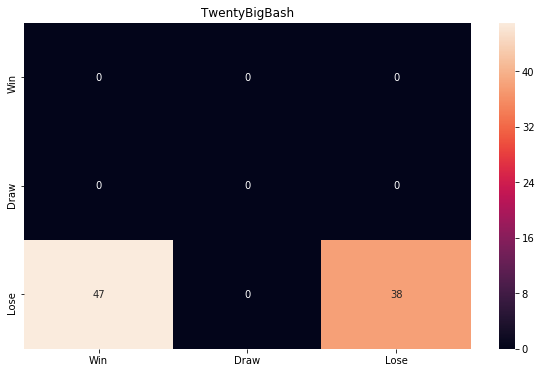

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 0 COMPLETE (1/25)
Time remaining: 2947.88775 seconds (49.1314625 min)


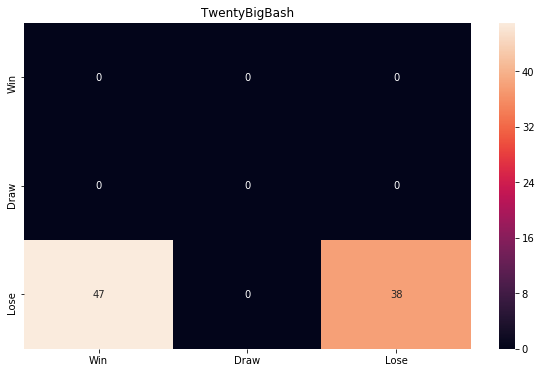

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 1 COMPLETE (2/25)
Time remaining: 1207.3547760000001 seconds (20.1225796 min)


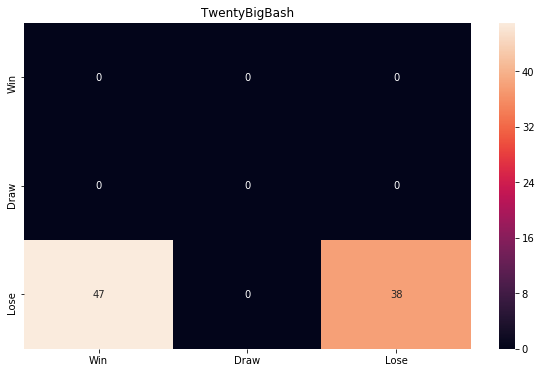

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 2 COMPLETE (3/25)
Time remaining: 1154.741772 seconds (19.2456962 min)


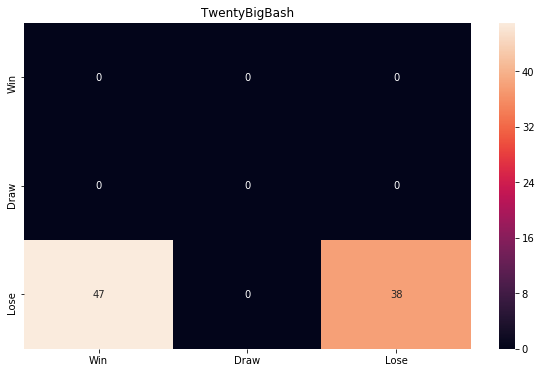

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 3 COMPLETE (4/25)
Time remaining: 1102.2625679999999 seconds (18.371042799999998 min)


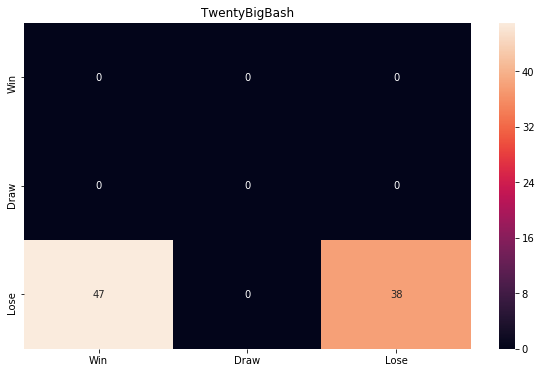

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 4 COMPLETE (5/25)
Time remaining: 1053.848019 seconds (17.56413365 min)


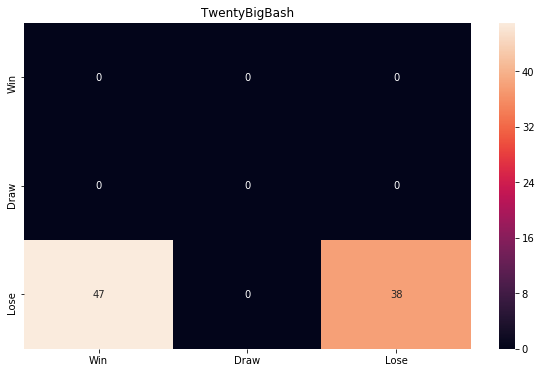

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 5 COMPLETE (6/25)
Time remaining: 993.55828 seconds (16.559304666666666 min)


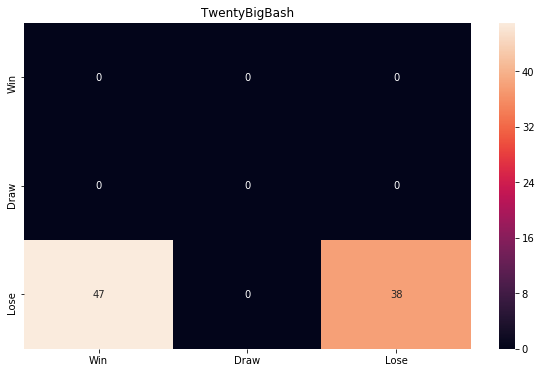

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 6 COMPLETE (7/25)
Time remaining: 955.176873 seconds (15.91961455 min)


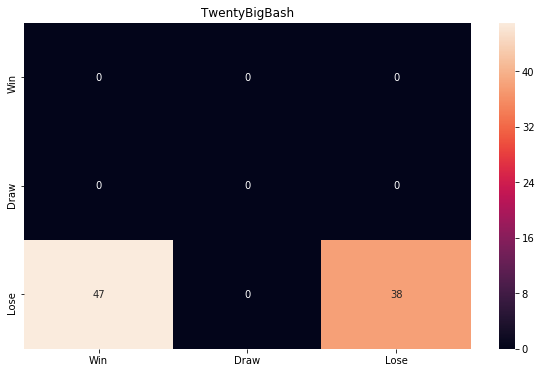

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 7 COMPLETE (8/25)
Time remaining: 886.1841900000001 seconds (14.7697365 min)


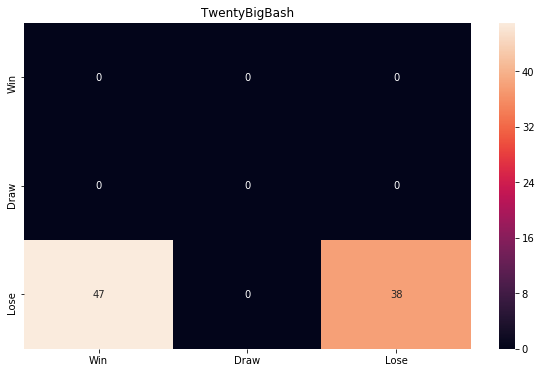

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 8 COMPLETE (9/25)
Time remaining: 843.820993 seconds (14.063683216666668 min)


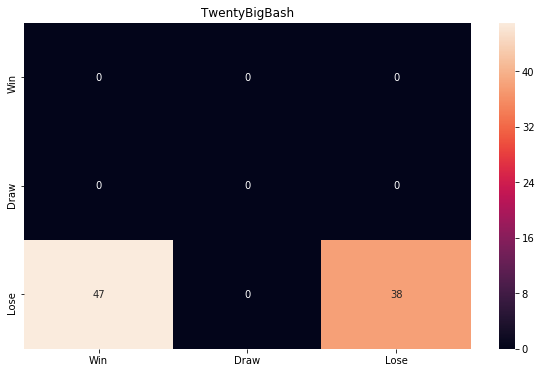

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 9 COMPLETE (10/25)
Time remaining: 786.159152 seconds (13.102652533333332 min)


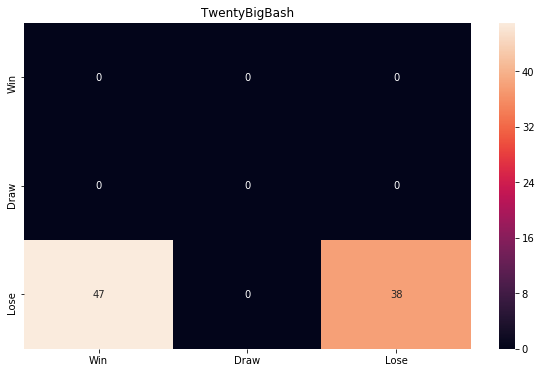

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 10 COMPLETE (11/25)
Time remaining: 738.431835 seconds (12.30719725 min)


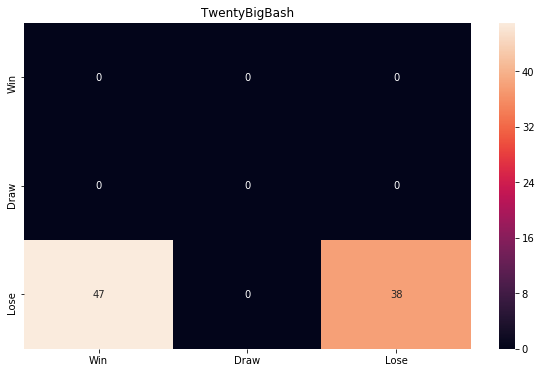

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 11 COMPLETE (12/25)
Time remaining: 696.738616 seconds (11.612310266666666 min)


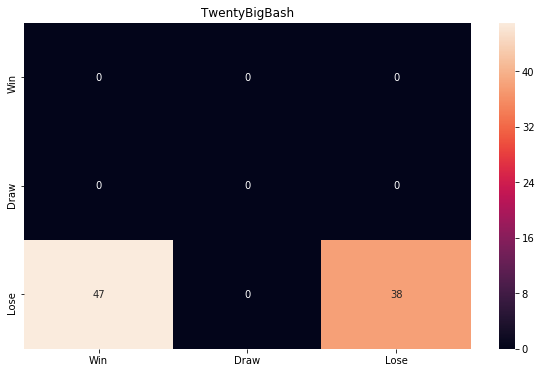

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 12 COMPLETE (13/25)
Time remaining: 651.065896 seconds (10.851098266666666 min)


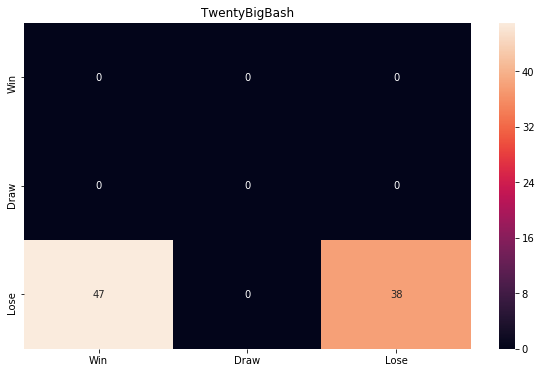

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 13 COMPLETE (14/25)
Time remaining: 597.1937760000001 seconds (9.953229600000002 min)


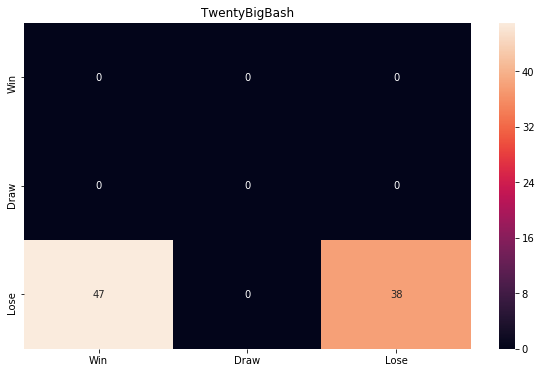

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 14 COMPLETE (15/25)
Time remaining: 545.652426 seconds (9.0942071 min)


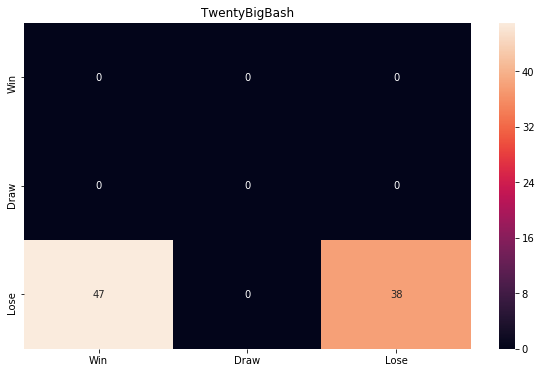

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 15 COMPLETE (16/25)
Time remaining: 498.24156000000005 seconds (8.304026 min)


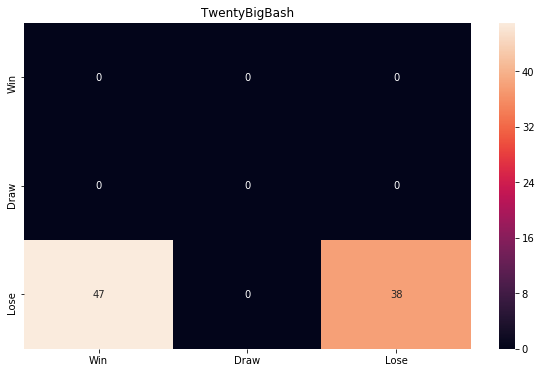

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 16 COMPLETE (17/25)
Time remaining: 443.111157 seconds (7.385185949999999 min)


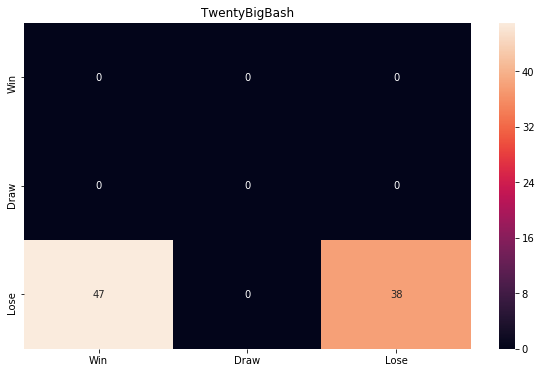

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 17 COMPLETE (18/25)
Time remaining: 399.47456 seconds (6.6579093333333335 min)


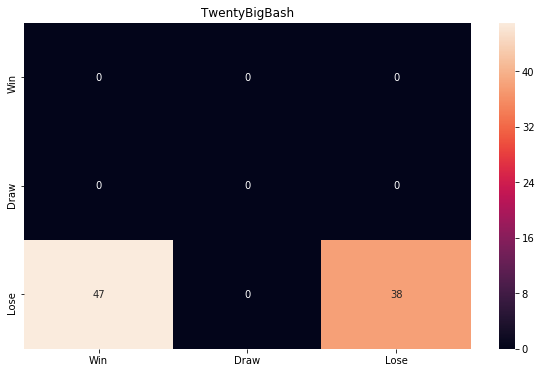

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 18 COMPLETE (19/25)
Time remaining: 346.793279 seconds (5.779887983333333 min)


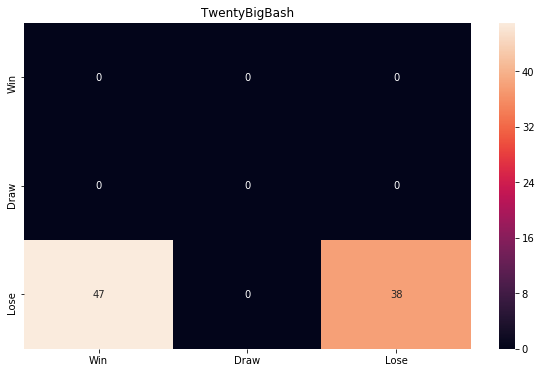

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 19 COMPLETE (20/25)
Time remaining: 297.92535 seconds (4.9654225 min)


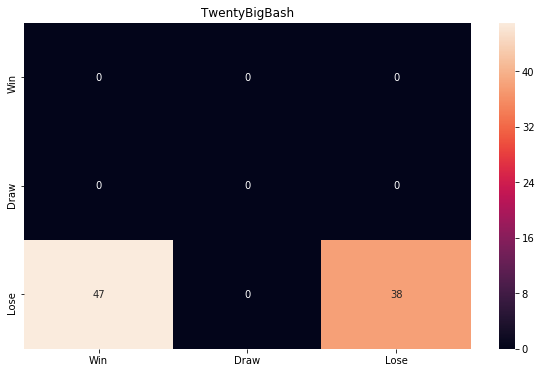

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 20 COMPLETE (21/25)
Time remaining: 249.80810000000002 seconds (4.163468333333333 min)


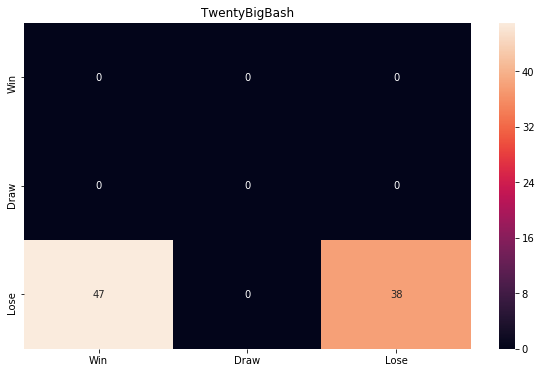

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 21 COMPLETE (22/25)
Time remaining: 196.766292 seconds (3.2794382 min)


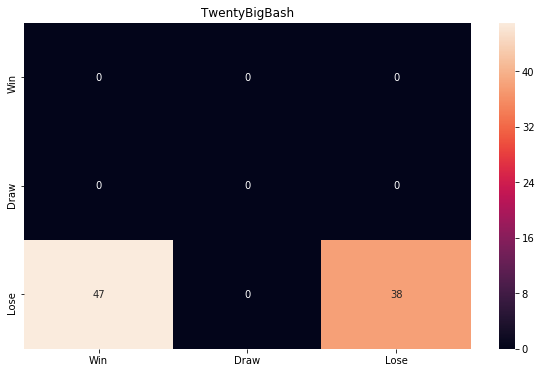

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 22 COMPLETE (23/25)
Time remaining: 147.99847499999998 seconds (2.46664125 min)


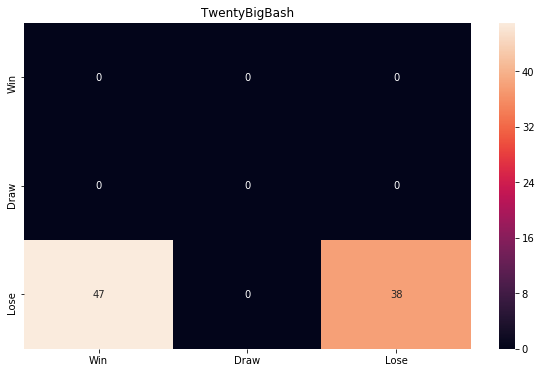

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 23 COMPLETE (24/25)
Time remaining: 98.503244 seconds (1.6417207333333332 min)


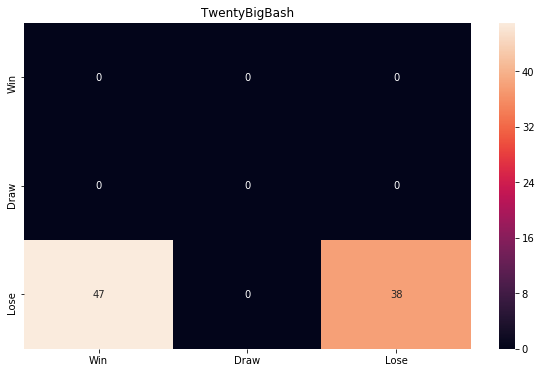

Accuracy 44.70588235294118
Precision: 	Win 0.00 	Draw 0.00 	Lose 1.00 
Recall: 	Win 0.00 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.00 	Draw 0.00 	Lose 0.62 
Iteration 24 COMPLETE (25/25)
Time remaining: 50.190724 seconds (0.8365120666666667 min)

TwentyBigBash
Model Summary after 25 iterations:44.70588235294119 - test accuracy 
0.0 - acc std


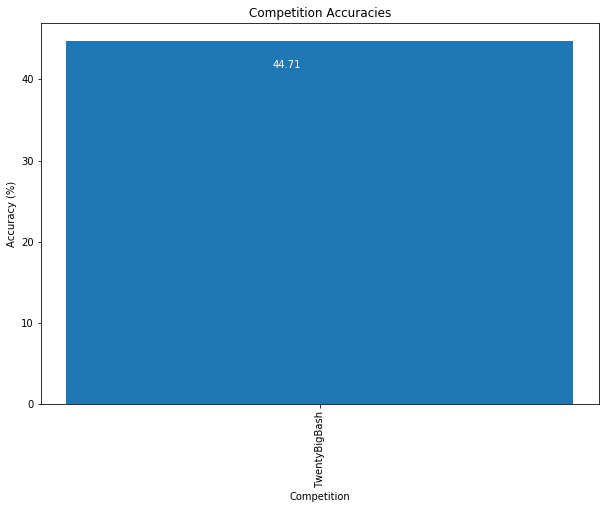

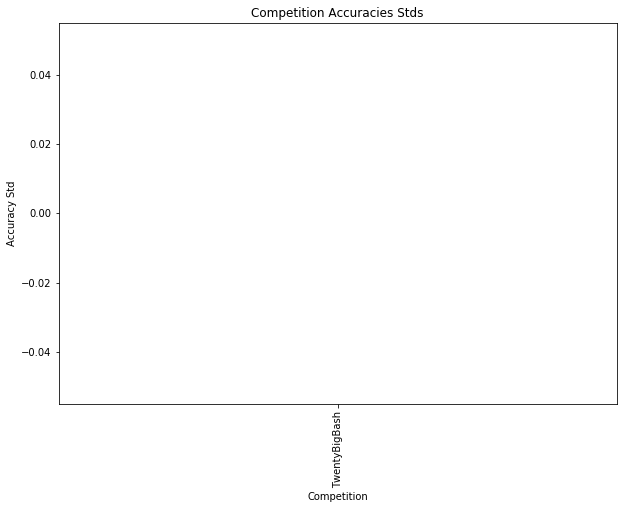

In [69]:
competition_stats = {'TwentyBigBash': NnParams(batch_size=128,
                                               epochs=60,
                                               optimizer="Adam",
                                               learn_rate=0.001,
                                               init_mode="glorot_uniform",
                                               neurons_1=10,
                                               neurons_2=10,
                                               neurons_3=0,
                                               activation="relu",
                                               dropout=0)}

run_nn(tw_train[0], 
       tw_train[1], 
       tw_test[0], 
       tw_test[1], 
       tw_comp_name, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=2)

In [14]:
avg_num_matches = []
labels = []

def get_avg_matches(competition_names, years, data, avg_matches, labels):
    for competition in competition_names:
        avg = 0
        for year in years:
            avg += len(data[competition][year])
        avg /= len(years)
        avg_matches.append(avg)
        labels.append(competition)
        
    return avg_matches, labels

competition_paths = ['Data/England - Premiership/Premier', 
                     'Data/France - Championnat/Championnat',
                     'Data/Germany - Bundesliga/Bundesliga', 
                     'Data/Italy - Serie A/SerieA']
competition_names = ['England - Premiership',
                     'France - Championnat',
                     'Germany - Bundesliga',
                     'Italy - Serie A']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in football data
football_data = get_sport_data(competition_names, 
                               years, 
                               competition_paths, 
                               lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                               required_fields=[("B365H", float), 
                                                ("B365D", float), 
                                                ("B365A", float), 
                                                ("FTHG", int),
                                                ("FTAG", int)],
                               reverse=False)

get_avg_matches(competition_names, years, football_data, avg_num_matches, labels)

nfl_comp_paths = ['Data/NFL/NFL']
nfl_comp_name = ['NFL']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]
# Read in NFL data
nfl_data = get_sport_data(nfl_comp_name, 
                          years, 
                          nfl_comp_paths, 
                          lambda competition, year: str(competition) + str(year) + '.csv', 
                          required_fields=[("Home Score", int), 
                                           ("Away Score", int), 
                                           ("Home Odds Open", float), 
                                           ("Away Odds Open", float)],
                          reverse=True)

get_avg_matches(nfl_comp_name, years, nfl_data, avg_num_matches, labels)

nbl_comp_paths = ['Data/NBL/NBL']
nbl_comp_name = ['NBL']
years = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

nbl_data = get_sport_data(nbl_comp_name, 
                          years, 
                          nbl_comp_paths, 
                          lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                          reverse=True)

get_avg_matches(nbl_comp_name, years, nbl_data, avg_num_matches, labels)

sr_comp_paths = ['Data/Super Rugby/SuperRugby']
sr_comp_name = ['SuperRugby']
years = [2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

# Read in Super Rugby data
sr_data = get_sport_data(sr_comp_name, 
                         years, 
                         sr_comp_paths, 
                         lambda competition, year: str(competition) + str(year) + '.csv', 
                         required_fields=[("Home Score", int), 
                                          ("Away Score", int), 
                                          ("Home Odds", float), 
                                          ("Draw Odds", float), 
                                          ("Away Odds", float)],
                         reverse=True)

get_avg_matches(sr_comp_name, years, sr_data, avg_num_matches, labels)

tw_comp_paths = ['Data/Twenty20 Big Bash/TwentyBigBash']
tw_comp_name = ['TwentyBigBash']
years = [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in Twenty20 Big Bash data
tw_data = get_sport_data(tw_comp_name, 
                         years, 
                         tw_comp_paths, 
                         lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                         required_fields=[("Home Score", int),
                                          ("Away Score", int), 
                                          ("Home Odds", float), 
                                          ("Away Odds", float)],
                         reverse=True)

get_avg_matches(tw_comp_name, years, tw_data, avg_num_matches, labels)

Got data for Data/England - Premiership/Premier2008-2009.csv (380)
Got data for Data/England - Premiership/Premier2009-2010.csv (380)
Got data for Data/England - Premiership/Premier2010-2011.csv (380)
Got data for Data/England - Premiership/Premier2011-2012.csv (380)
Got data for Data/England - Premiership/Premier2012-2013.csv (380)
Got data for Data/England - Premiership/Premier2013-2014.csv (380)
Got data for Data/England - Premiership/Premier2014-2015.csv (380)
Dropped 1 matches
Got data for Data/England - Premiership/Premier2015-2016.csv (380)
Got data for Data/England - Premiership/Premier2016-2017.csv (380)
Got data for Data/England - Premiership/Premier2017-2018.csv (380)
Got data for Data/England - Premiership/Premier2018-2019.csv (380)
Got data for Data/France - Championnat/Championnat2008-2009.csv (380)
Got data for Data/France - Championnat/Championnat2009-2010.csv (380)
Got data for Data/France - Championnat/Championnat2010-2011.csv (380)
Got data for Data/France - Champion

([380.0,
  379.90909090909093,
  306.0,
  379.72727272727275,
  266.0,
  122.7,
  121.0909090909091,
  36.5],
 ['England - Premiership',
  'France - Championnat',
  'Germany - Bundesliga',
  'Italy - Serie A',
  'NFL',
  'NBL',
  'SuperRugby',
  'TwentyBigBash'])

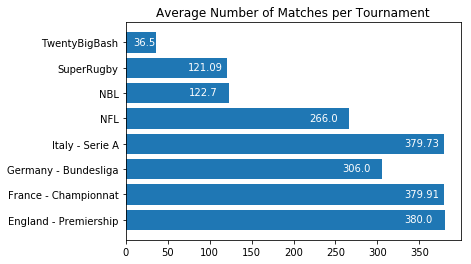

In [44]:
plt.barh(labels, avg_num_matches)
for i, v in enumerate(avg_num_matches):
    plt.text(max(max(avg_num_matches) * 0.0225, v - max(avg_num_matches) * 0.125), 
             i - len(labels) * 0.0125, 
             str(round(v, 2)), 
             color='white')
plt.title("Average Number of Matches per Tournament")
plt.show()

## Extra features NN

In [10]:
competition_paths = ['Data/England - Premiership/Premier', 
                     'Data/France - Championnat/Championnat',
                     'Data/Germany - Bundesliga/Bundesliga', 
                     'Data/Italy - Serie A/SerieA']
competition_names = ['England - Premiership',
                     'France - Championnat',
                     'Germany - Bundesliga',
                     'Italy - Serie A']
years = [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]

# Read in football data
football_data = get_sport_data(competition_names, 
                               years, 
                               competition_paths, 
                               lambda competition, year: str(competition) + str(year) + "-" + str(year+1) + '.csv', 
                               required_fields=[("B365H", float), 
                                                ("B365D", float), 
                                                ("B365A", float), 
                                                ("FTHG", int),
                                                ("FTAG", int)],
                               reverse=False)

# Calculate extra fields required for the NN
football_data = calc_extra_attributes(football_data,
                                      home_team='HomeTeam', 
                                      away_team='AwayTeam', 
                                      home_score='FTHG', 
                                      away_score='FTAG')

columns = ['B365H', 
           'B365D', 
           'B365A', 
           'h_won_home', 
           'h_won_away', 
           'h_drawn_home', 
           'h_drawn_away', 
           'h_lost_home', 
           'h_lost_away', 
           'h_avg_g_home', 
           'h_avg_c_home',
           'h_avg_g_away', 
           'h_avg_c_away',
           'h_history1_w',
           'h_history1_d',
           'h_history1_a',
           'h_history2_w',
           'h_history2_d',
           'h_history2_a',
           'h_history3_w',
           'h_history3_d',
           'h_history3_a',
           'h_history4_w',
           'h_history4_d',
           'h_history4_a',
           'h_history5_w',
           'h_history5_d',
           'h_history5_a',
           'a_won_home', 
           'a_won_away', 
           'a_drawn_home', 
           'a_drawn_away', 
           'a_lost_home', 
           'a_lost_away', 
           'a_avg_g_home', 
           'a_avg_c_home', 
           'a_avg_g_away', 
           'a_avg_c_away',
           'h_won_h_20',
           'h_drawn_h_20',
           'h_lost_h_20',
           'h_won_a_20',
           'h_drawn_a_20',
           'h_lost_a_20',
           'a_won_h_20',
           'a_drawn_h_20',
           'a_lost_h_20',
           'a_won_a_20',
           'a_drawn_a_20',
           'a_lost_a_20',
           'a_history1_w',
           'a_history1_d',
           'a_history1_a',
           'a_history2_w',
           'a_history2_d',
           'a_history2_a',
           'a_history3_w',
           'a_history3_d',
           'a_history3_a',
           'a_history4_w',
           'a_history4_d',
           'a_history4_a',
           'a_history5_w',
           'a_history5_d',
           'a_history5_a',]

# Want to only get columns that NN uses
football_data, football_labels = extract_columns(football_data, columns, home='FTHG', away='FTAG')
# Retrieve train and test data/labels
train, test = get_train_test(football_data, years, football_labels, test_year=2018)

Got data for Data/England - Premiership/Premier2008-2009.csv (380)
Got data for Data/England - Premiership/Premier2009-2010.csv (380)
Got data for Data/England - Premiership/Premier2010-2011.csv (380)
Got data for Data/England - Premiership/Premier2011-2012.csv (380)
Got data for Data/England - Premiership/Premier2012-2013.csv (380)
Got data for Data/England - Premiership/Premier2013-2014.csv (380)
Got data for Data/England - Premiership/Premier2014-2015.csv (380)
Dropped 1 matches
Got data for Data/England - Premiership/Premier2015-2016.csv (380)
Got data for Data/England - Premiership/Premier2016-2017.csv (380)
Got data for Data/England - Premiership/Premier2017-2018.csv (380)
Got data for Data/England - Premiership/Premier2018-2019.csv (380)
Got data for Data/France - Championnat/Championnat2008-2009.csv (380)
Got data for Data/France - Championnat/Championnat2009-2010.csv (380)
Got data for Data/France - Championnat/Championnat2010-2011.csv (380)
Got data for Data/France - Champion

WARNING (theano.gof.compilelock): Overriding existing lock by dead process '18836' (I am process '5592')
C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


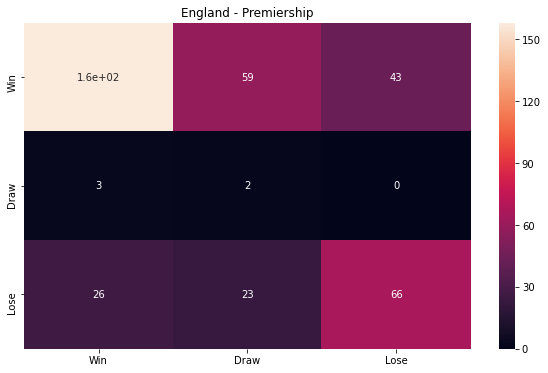

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.57 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.59 


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


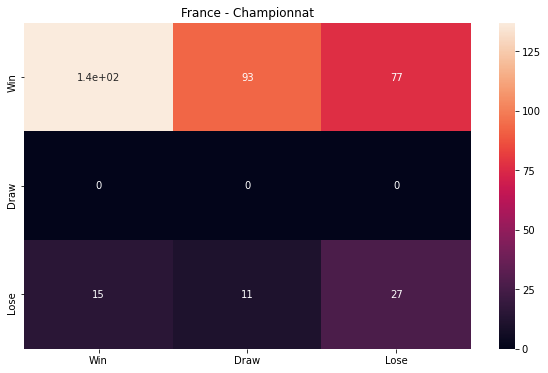

Accuracy: 45.56%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.26 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.34 


C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]


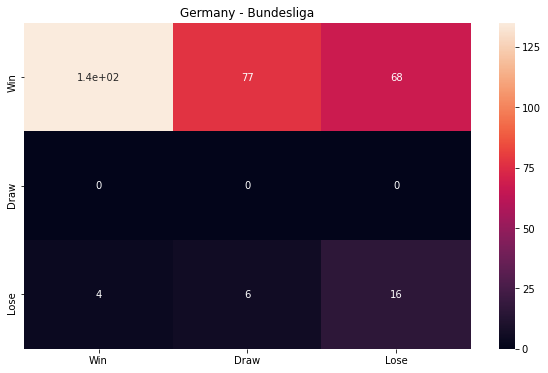

Accuracy: 49.35%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.19 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.29 


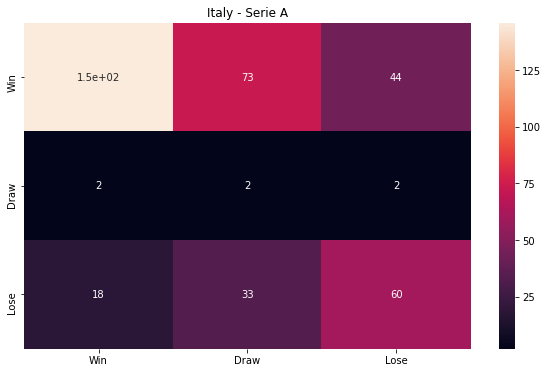

Accuracy: 54.74%
Precision: 	Win 0.88 	Draw 0.02 	Lose 0.57 
Recall: 	Win 0.56 	Draw 0.33 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 0 COMPLETE (1/25)
Time remaining: 3430.7500500000006 seconds (57.17916750000001 min)


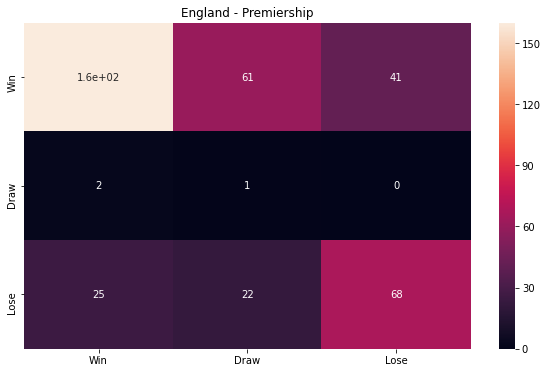

Accuracy: 60.26%
Precision: 	Win 0.86 	Draw 0.01 	Lose 0.62 
Recall: 	Win 0.61 	Draw 0.33 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.61 


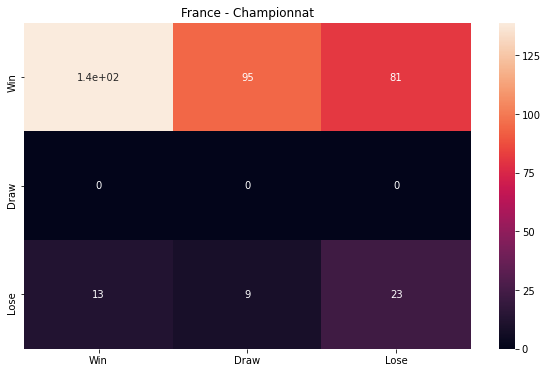

Accuracy: 45.0%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.22 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.31 


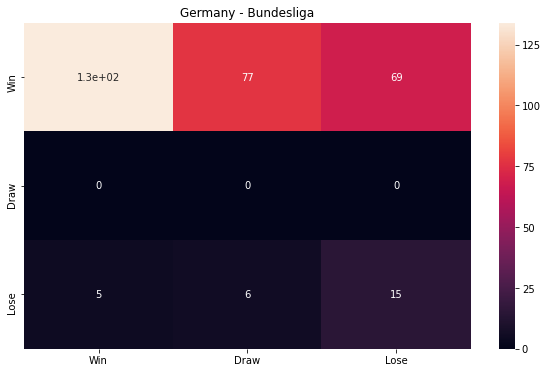

Accuracy: 48.69%
Precision: 	Win 0.96 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.58 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.27 


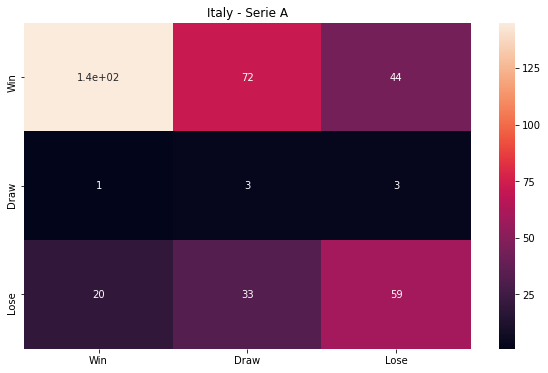

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.03 	Lose 0.56 
Recall: 	Win 0.56 	Draw 0.43 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.05 	Lose 0.54 
Iteration 1 COMPLETE (2/25)
Time remaining: 3276.015696 seconds (54.600261599999996 min)


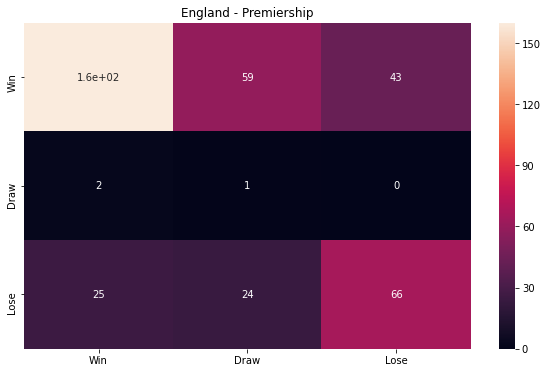

Accuracy: 59.74%
Precision: 	Win 0.86 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.33 	Lose 0.57 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.59 


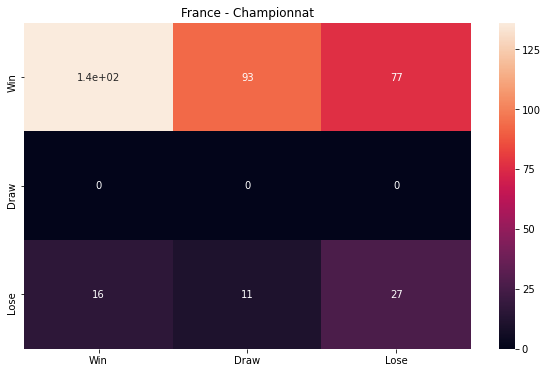

Accuracy: 45.28%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.26 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.34 


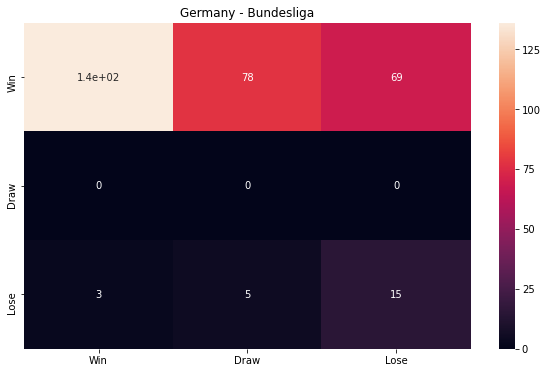

Accuracy: 49.35%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.28 


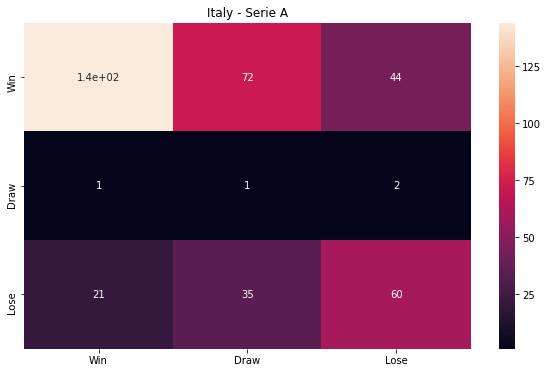

Accuracy: 53.95%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.25 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.54 
Iteration 2 COMPLETE (3/25)
Time remaining: 3139.9398060000003 seconds (52.33233010000001 min)


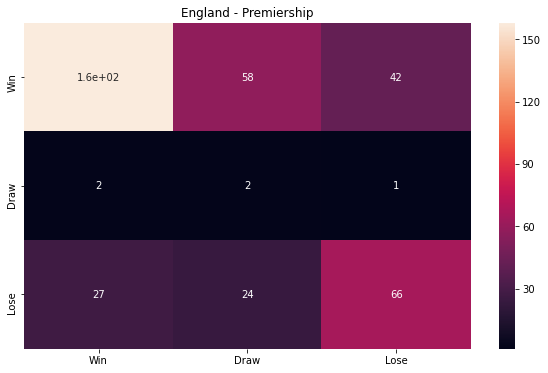

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.56 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.58 


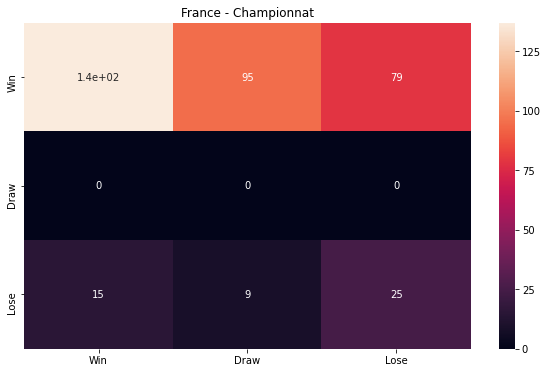

Accuracy: 45.0%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


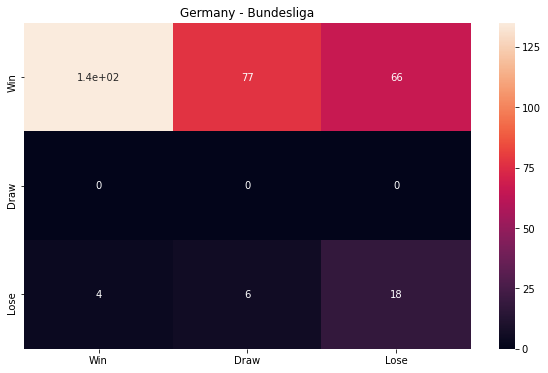

Accuracy: 50.0%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.21 
Recall: 	Win 0.49 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.32 


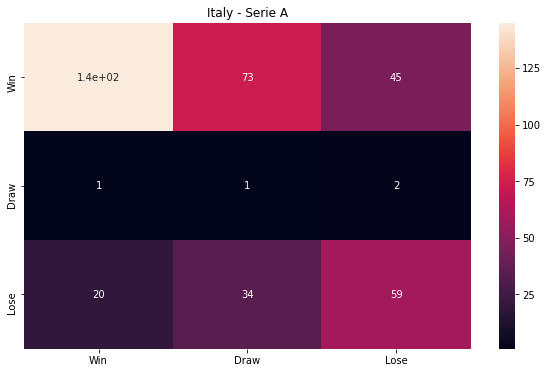

Accuracy: 53.95%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.56 
Recall: 	Win 0.55 	Draw 0.25 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.54 
Iteration 3 COMPLETE (4/25)
Time remaining: 3066.018208 seconds (51.10030346666667 min)


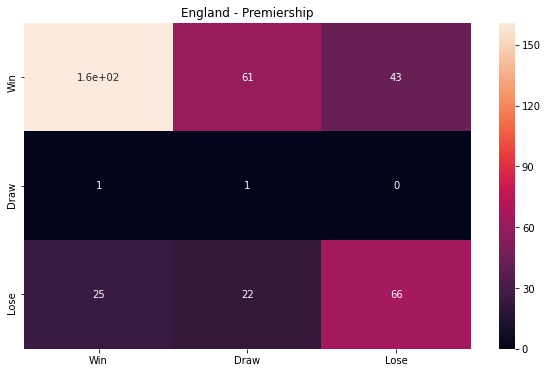

Accuracy: 60.0%
Precision: 	Win 0.86 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.50 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.59 


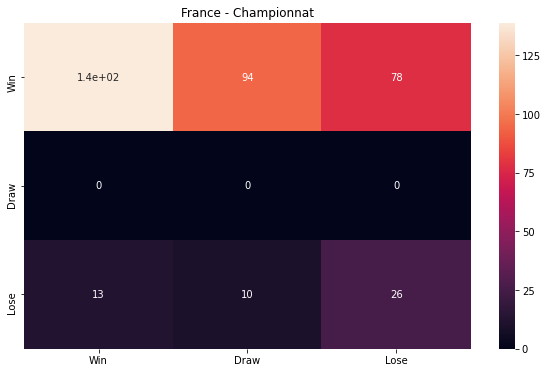

Accuracy: 45.83%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.34 


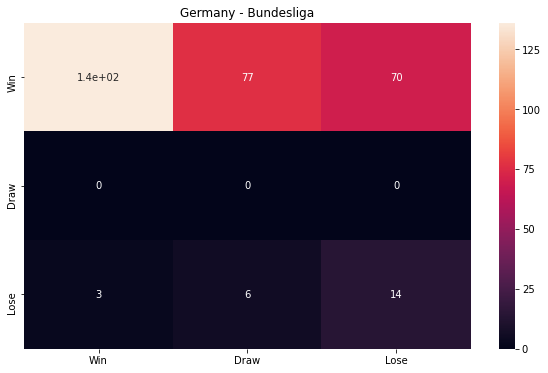

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


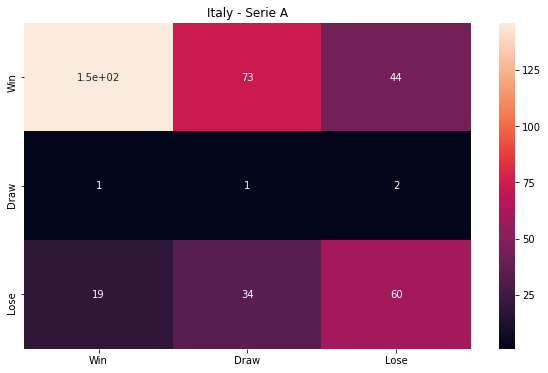

Accuracy: 54.47%
Precision: 	Win 0.88 	Draw 0.01 	Lose 0.57 
Recall: 	Win 0.56 	Draw 0.25 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 4 COMPLETE (5/25)
Time remaining: 2869.200222 seconds (47.8200037 min)


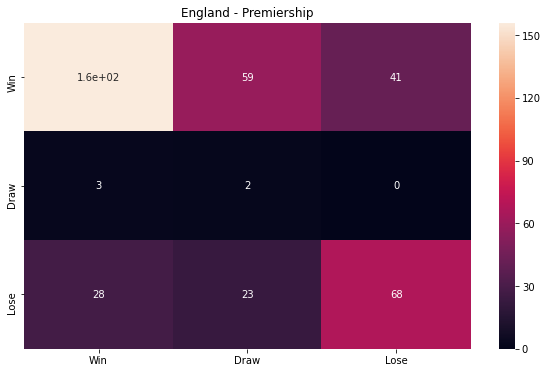

Accuracy: 59.47%
Precision: 	Win 0.83 	Draw 0.02 	Lose 0.62 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.57 
F1: 	Win 0.70 	Draw 0.04 	Lose 0.60 


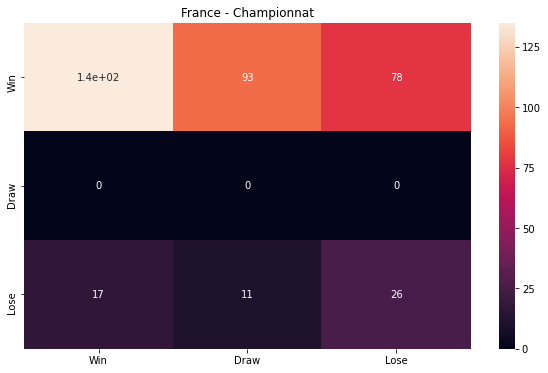

Accuracy: 44.72%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


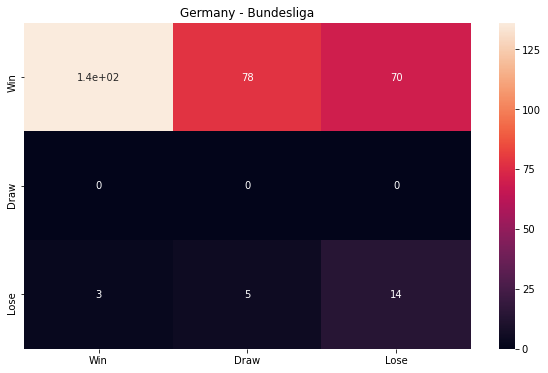

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


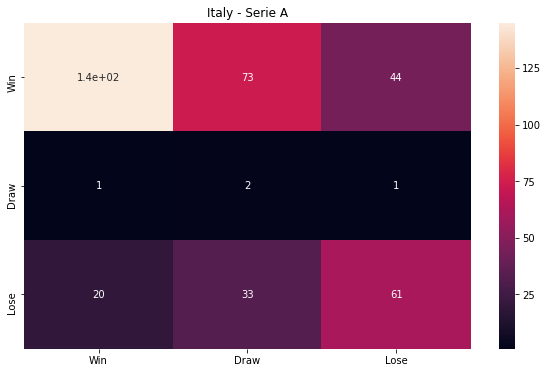

Accuracy: 54.74%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.58 
Recall: 	Win 0.55 	Draw 0.50 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 5 COMPLETE (6/25)
Time remaining: 3167.4134400000003 seconds (52.790224 min)


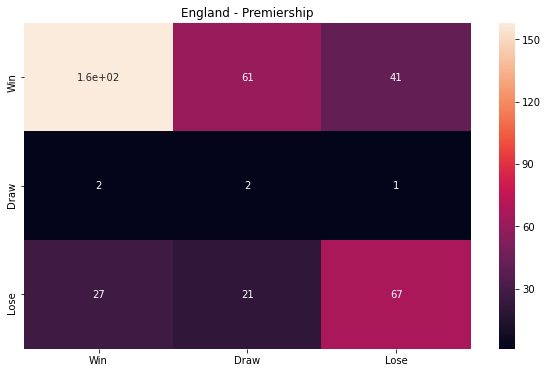

Accuracy: 59.74%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.60 


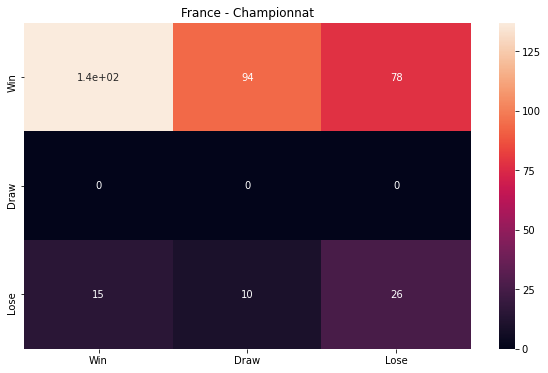

Accuracy: 45.28%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.34 


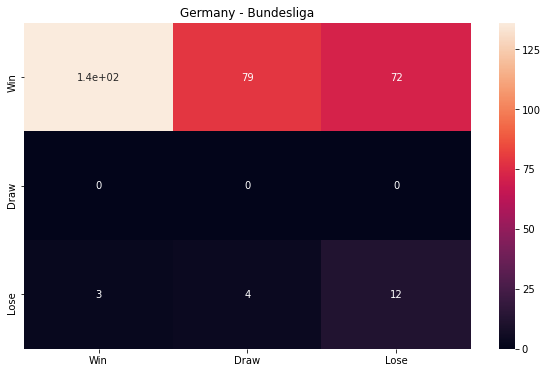

Accuracy: 48.37%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.14 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.63 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.23 


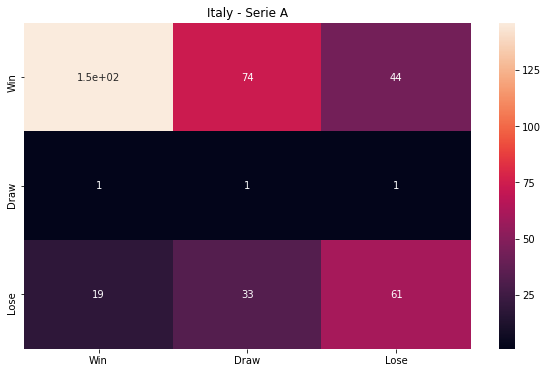

Accuracy: 54.74%
Precision: 	Win 0.88 	Draw 0.01 	Lose 0.58 
Recall: 	Win 0.55 	Draw 0.33 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.56 
Iteration 6 COMPLETE (7/25)
Time remaining: 2989.747831 seconds (49.829130516666666 min)


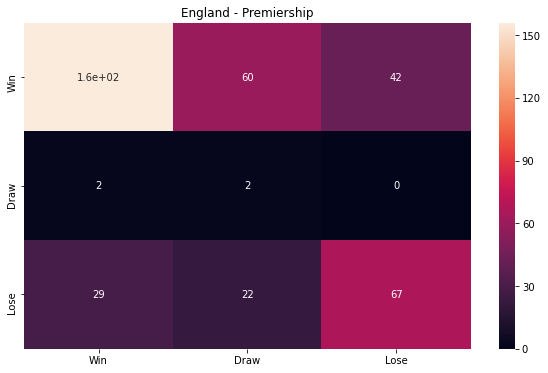

Accuracy: 59.21%
Precision: 	Win 0.83 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.50 	Lose 0.57 
F1: 	Win 0.70 	Draw 0.05 	Lose 0.59 


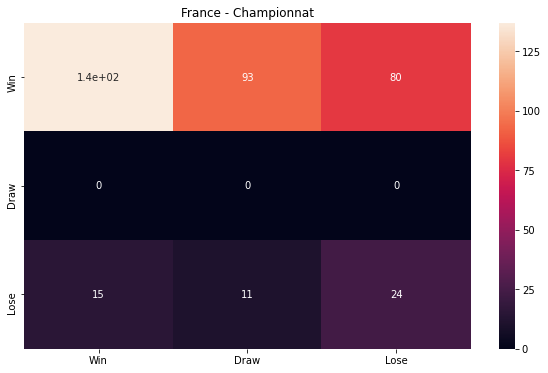

Accuracy: 44.72%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.23 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.31 


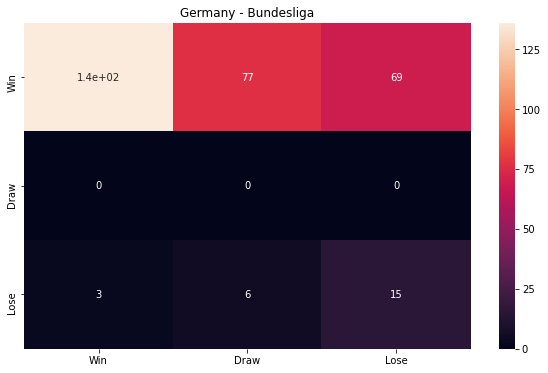

Accuracy: 49.35%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.28 


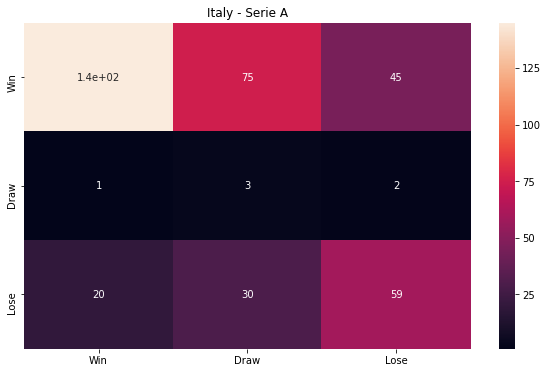

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.03 	Lose 0.56 
Recall: 	Win 0.55 	Draw 0.50 	Lose 0.54 
F1: 	Win 0.67 	Draw 0.05 	Lose 0.55 
Iteration 7 COMPLETE (8/25)
Time remaining: 3107.1785219999997 seconds (51.78630869999999 min)


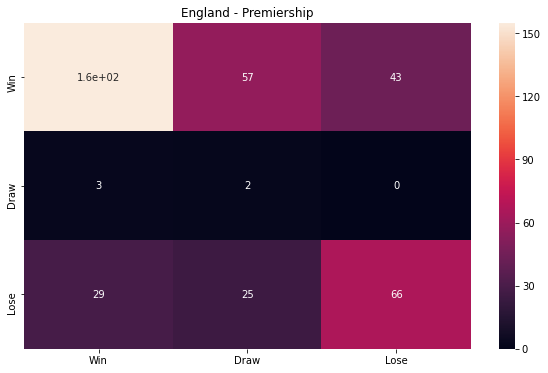

Accuracy: 58.68%
Precision: 	Win 0.83 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.55 
F1: 	Win 0.70 	Draw 0.04 	Lose 0.58 


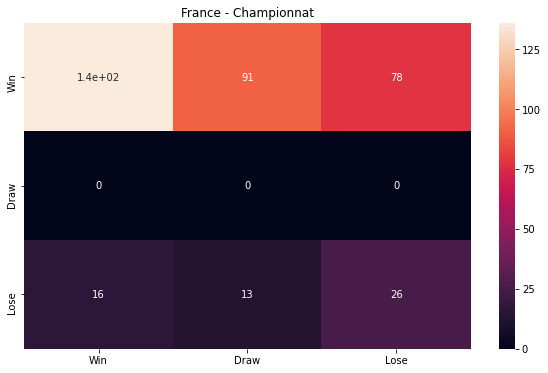

Accuracy: 45.0%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.47 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.33 


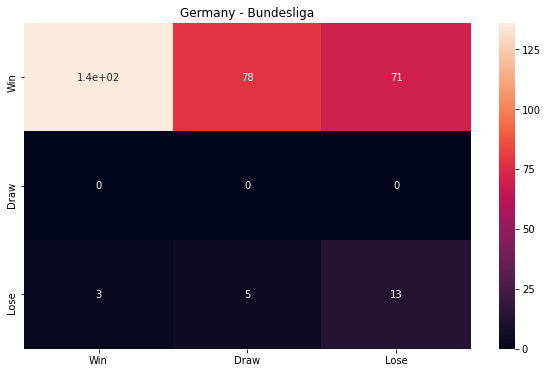

Accuracy: 48.69%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.15 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.25 


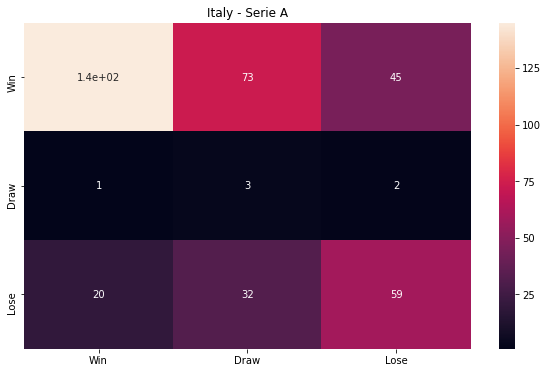

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.03 	Lose 0.56 
Recall: 	Win 0.55 	Draw 0.50 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.05 	Lose 0.54 
Iteration 8 COMPLETE (9/25)
Time remaining: 2442.0073979999997 seconds (40.700123299999994 min)


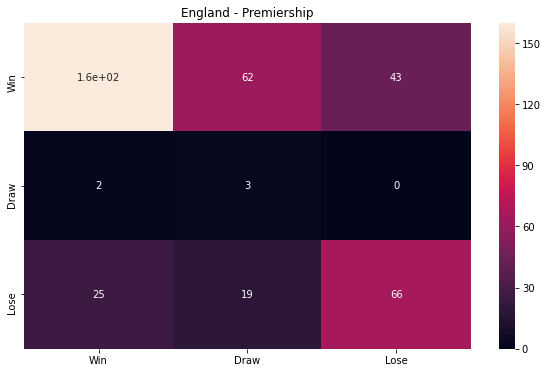

Accuracy: 60.26%
Precision: 	Win 0.86 	Draw 0.04 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.60 	Lose 0.60 
F1: 	Win 0.71 	Draw 0.07 	Lose 0.60 


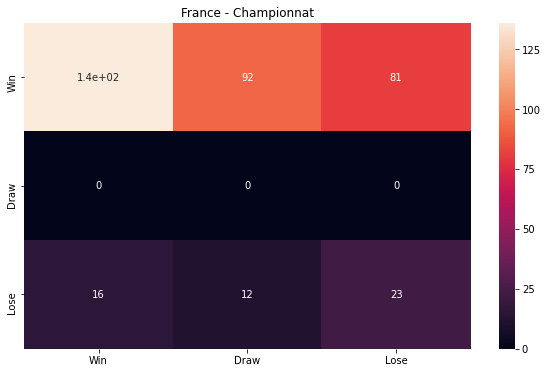

Accuracy: 44.17%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.22 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.45 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.30 


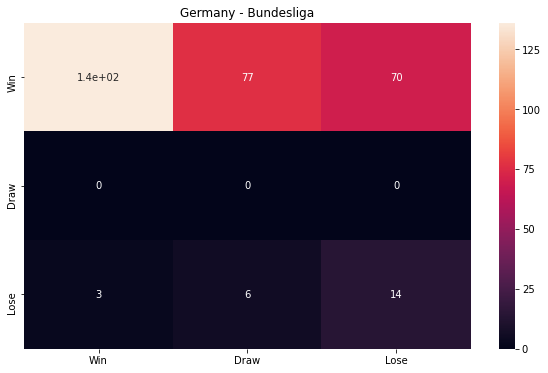

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


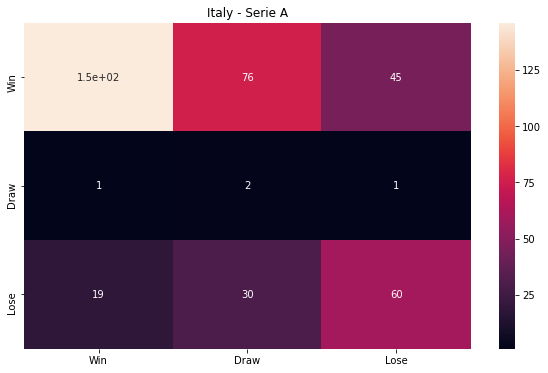

Accuracy: 54.74%
Precision: 	Win 0.88 	Draw 0.02 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.50 	Lose 0.55 
F1: 	Win 0.67 	Draw 0.04 	Lose 0.56 
Iteration 9 COMPLETE (10/25)
Time remaining: 2447.828064 seconds (40.7971344 min)


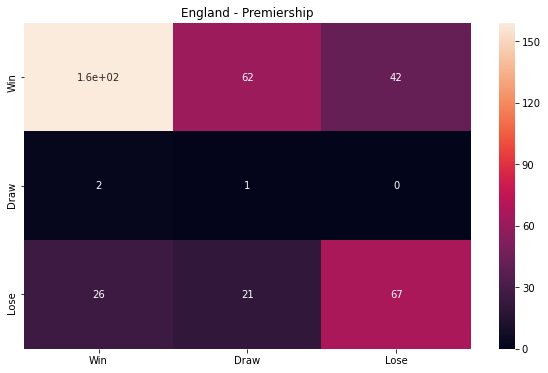

Accuracy: 59.74%
Precision: 	Win 0.85 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.33 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.60 


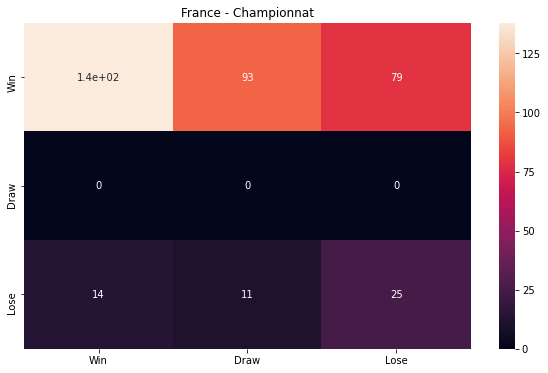

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.32 


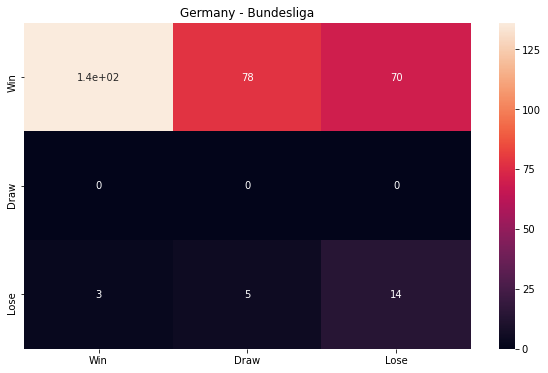

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


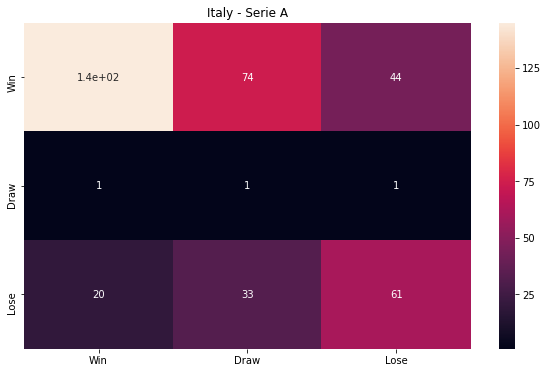

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.58 
Recall: 	Win 0.55 	Draw 0.33 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 10 COMPLETE (11/25)
Time remaining: 2270.1693 seconds (37.836155 min)


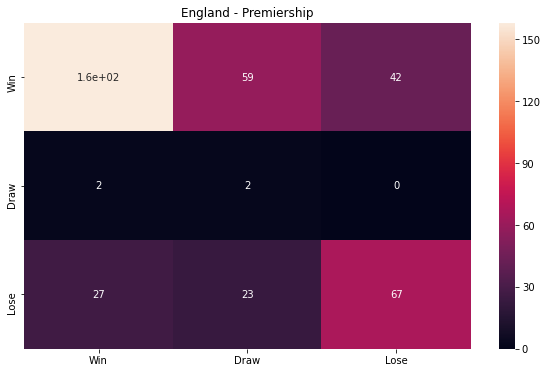

Accuracy: 59.74%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.50 	Lose 0.57 
F1: 	Win 0.71 	Draw 0.05 	Lose 0.59 


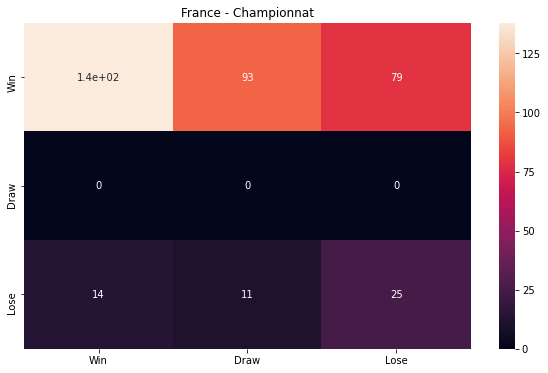

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.50 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.32 


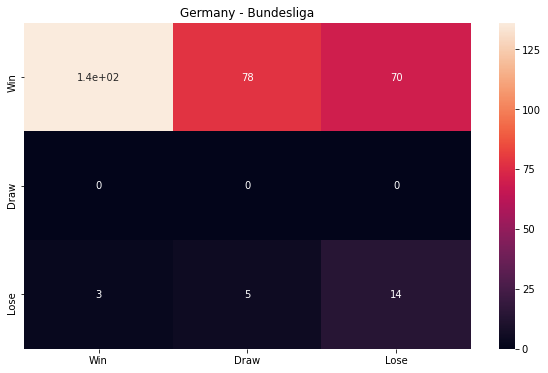

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


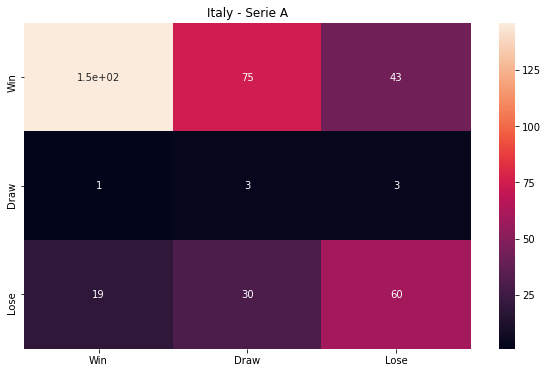

Accuracy: 55.0%
Precision: 	Win 0.88 	Draw 0.03 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.43 	Lose 0.55 
F1: 	Win 0.68 	Draw 0.05 	Lose 0.56 
Iteration 11 COMPLETE (12/25)
Time remaining: 2006.2611940000002 seconds (33.43768656666667 min)


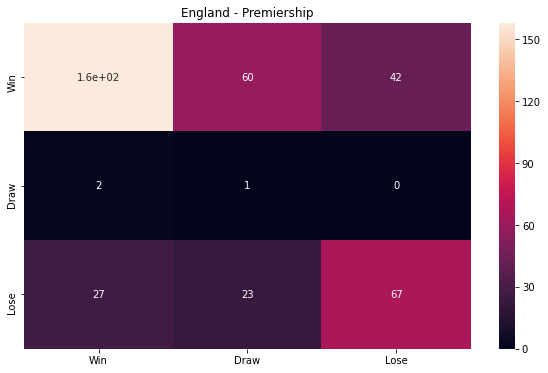

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.33 	Lose 0.57 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.59 


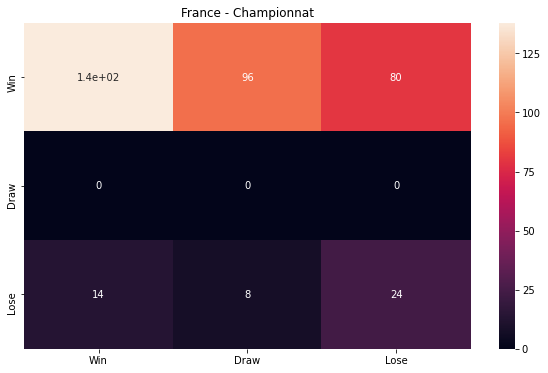

Accuracy: 45.0%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.23 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.32 


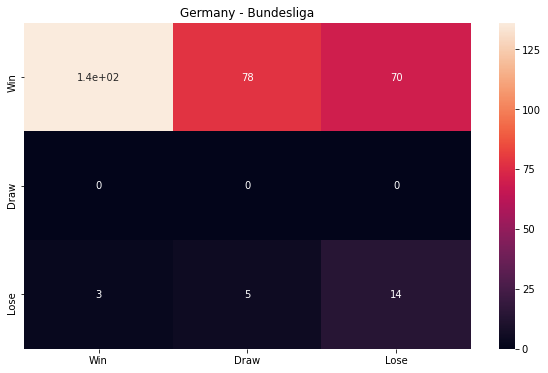

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


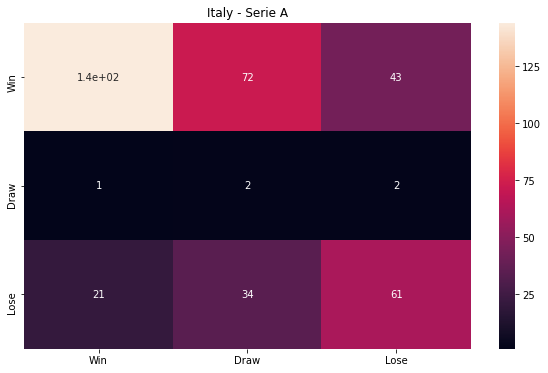

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.58 
Recall: 	Win 0.56 	Draw 0.40 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 12 COMPLETE (13/25)
Time remaining: 1998.941724 seconds (33.3156954 min)


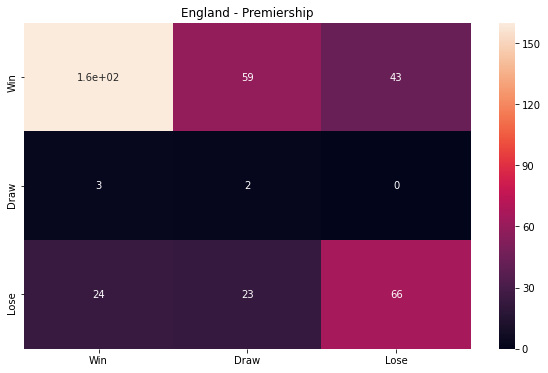

Accuracy: 60.0%
Precision: 	Win 0.86 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.59 


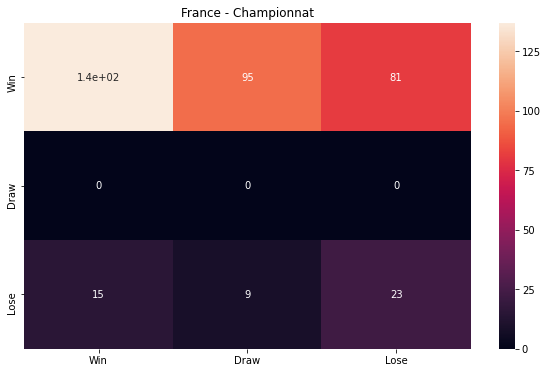

Accuracy: 44.44%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.22 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.30 


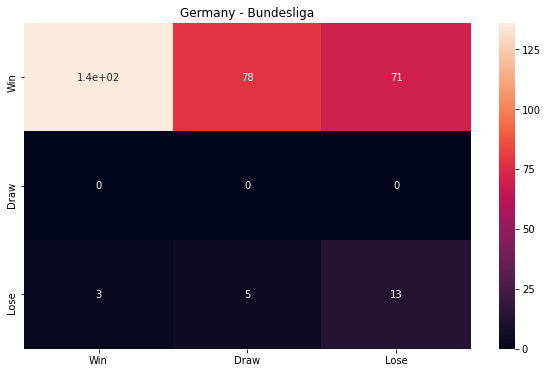

Accuracy: 48.69%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.15 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.25 


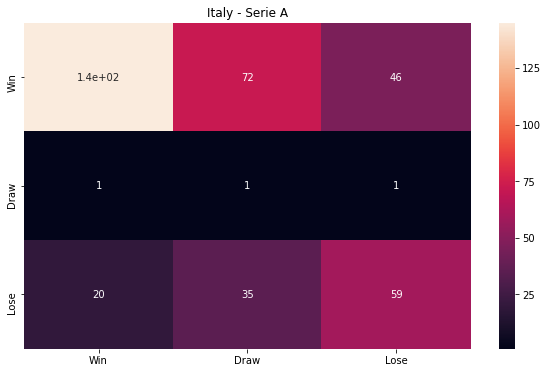

Accuracy: 53.95%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.56 
Recall: 	Win 0.55 	Draw 0.33 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.54 
Iteration 13 COMPLETE (14/25)
Time remaining: 1908.7909679999998 seconds (31.813182799999996 min)


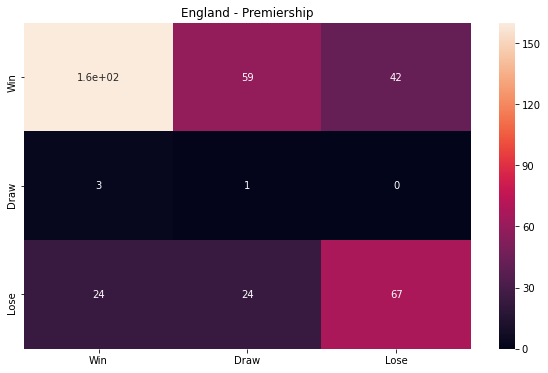

Accuracy: 60.0%
Precision: 	Win 0.86 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.25 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.60 


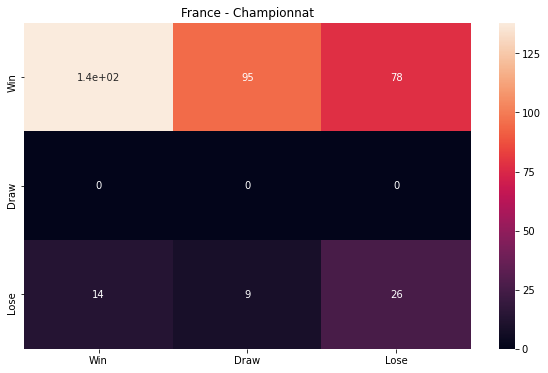

Accuracy: 45.56%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.34 


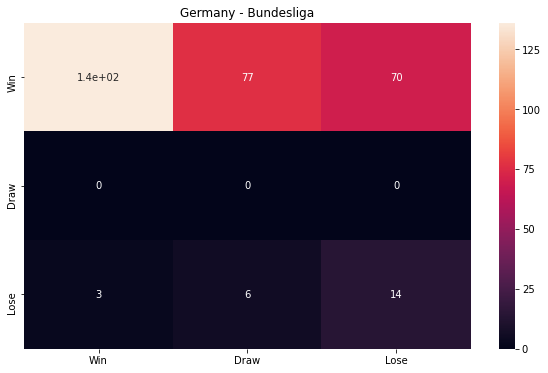

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


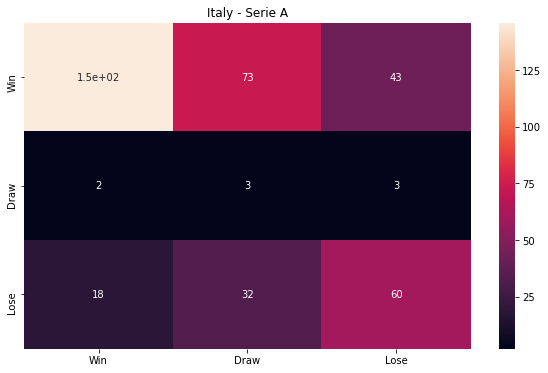

Accuracy: 55.0%
Precision: 	Win 0.88 	Draw 0.03 	Lose 0.57 
Recall: 	Win 0.56 	Draw 0.38 	Lose 0.55 
F1: 	Win 0.68 	Draw 0.05 	Lose 0.56 
Iteration 14 COMPLETE (15/25)
Time remaining: 1667.3289820000002 seconds (27.78881636666667 min)


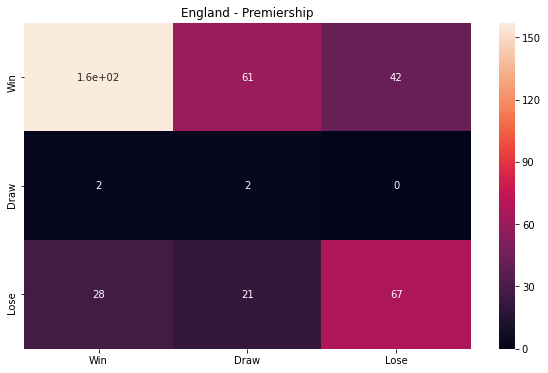

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.50 	Lose 0.58 
F1: 	Win 0.70 	Draw 0.05 	Lose 0.60 


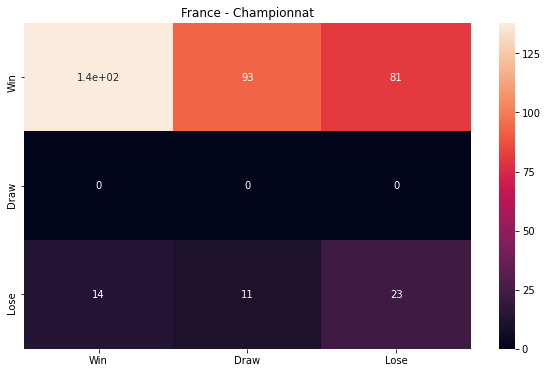

Accuracy: 44.72%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.22 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.48 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.30 


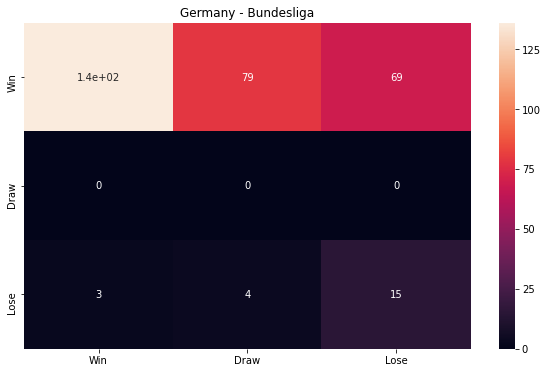

Accuracy: 49.35%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.68 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.28 


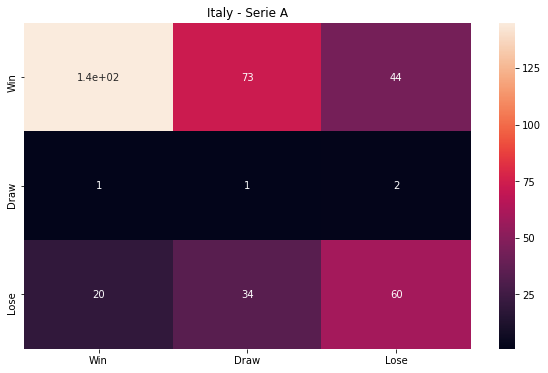

Accuracy: 54.21%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.25 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 15 COMPLETE (16/25)
Time remaining: 1408.8587400000001 seconds (23.480979 min)


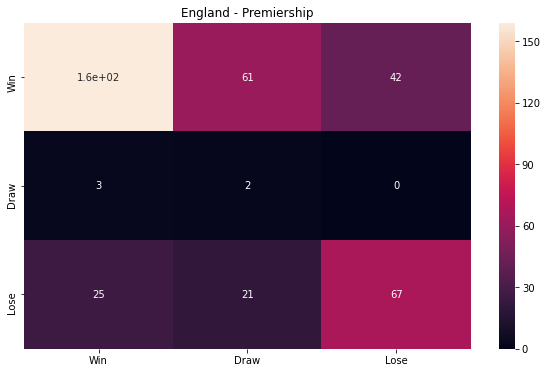

Accuracy: 60.0%
Precision: 	Win 0.85 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.60 


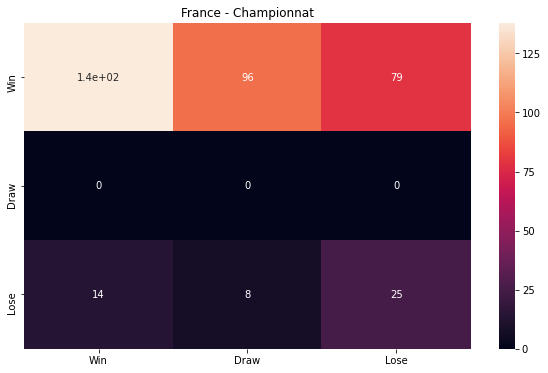

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


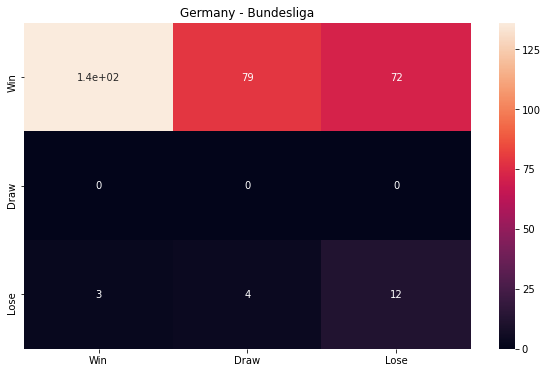

Accuracy: 48.37%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.14 
Recall: 	Win 0.47 	Draw 0.00 	Lose 0.63 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.23 


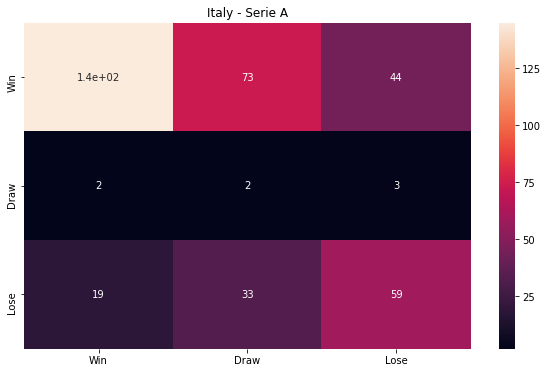

Accuracy: 54.21%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.56 
Recall: 	Win 0.55 	Draw 0.29 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.03 	Lose 0.54 
Iteration 16 COMPLETE (17/25)
Time remaining: 1360.365084 seconds (22.6727514 min)


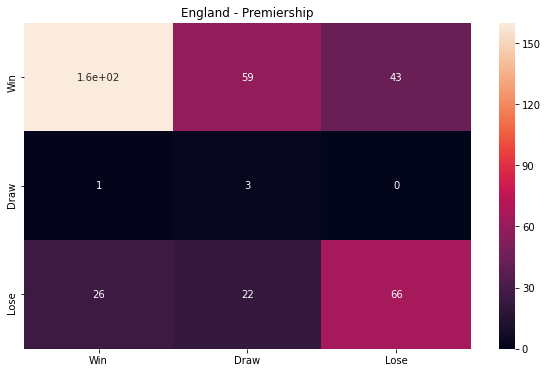

Accuracy: 60.26%
Precision: 	Win 0.86 	Draw 0.04 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.75 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.07 	Lose 0.59 


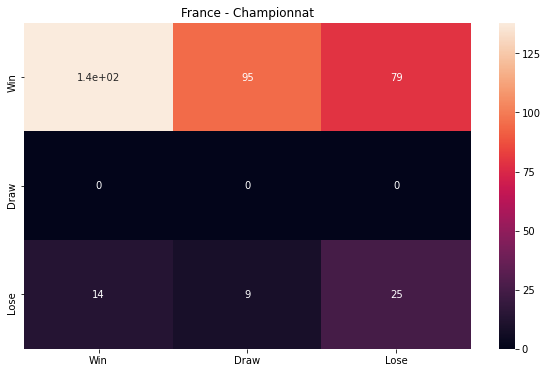

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


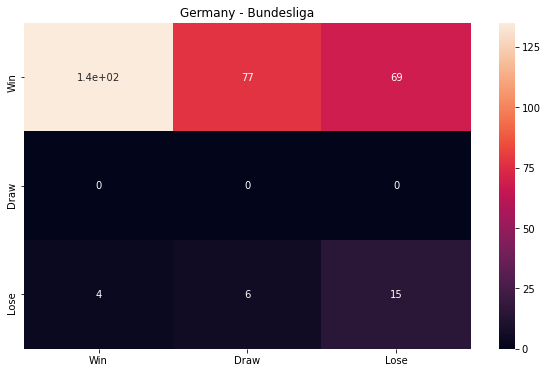

Accuracy: 49.02%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.28 


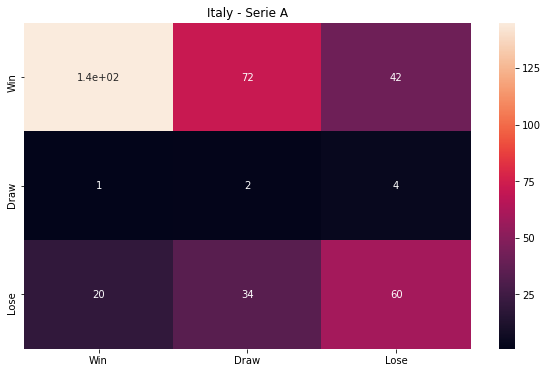

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.57 
Recall: 	Win 0.56 	Draw 0.29 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.03 	Lose 0.55 
Iteration 17 COMPLETE (18/25)
Time remaining: 1121.883704 seconds (18.698061733333336 min)


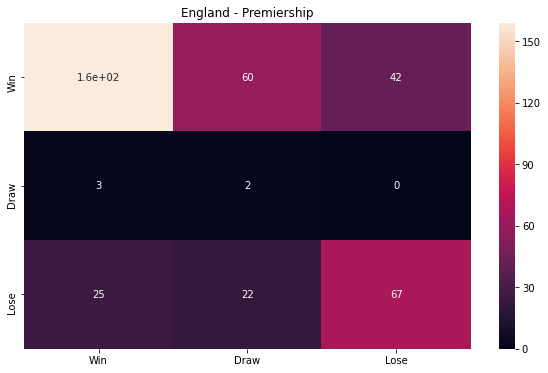

Accuracy: 60.0%
Precision: 	Win 0.85 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.40 	Lose 0.59 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.60 


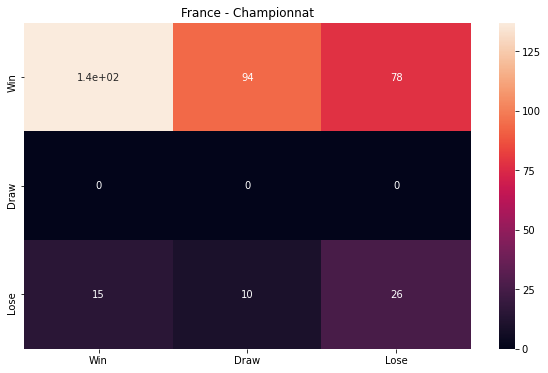

Accuracy: 45.28%
Precision: 	Win 0.90 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.34 


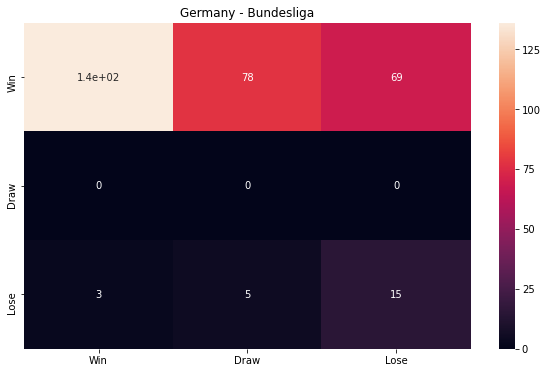

Accuracy: 49.35%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.65 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.28 


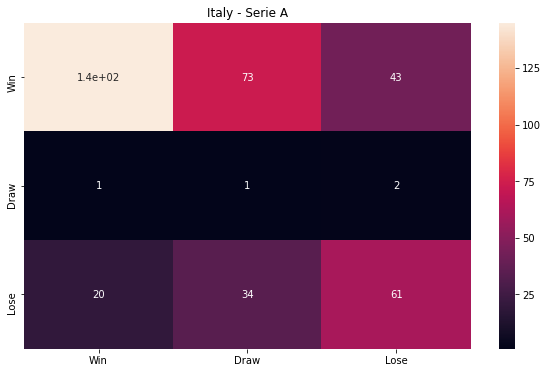

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.58 
Recall: 	Win 0.56 	Draw 0.25 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 18 COMPLETE (19/25)
Time remaining: 1065.1199299999998 seconds (17.75199883333333 min)


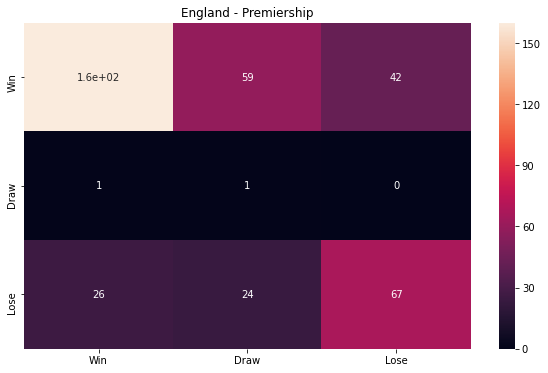

Accuracy: 60.0%
Precision: 	Win 0.86 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.50 	Lose 0.57 
F1: 	Win 0.71 	Draw 0.02 	Lose 0.59 


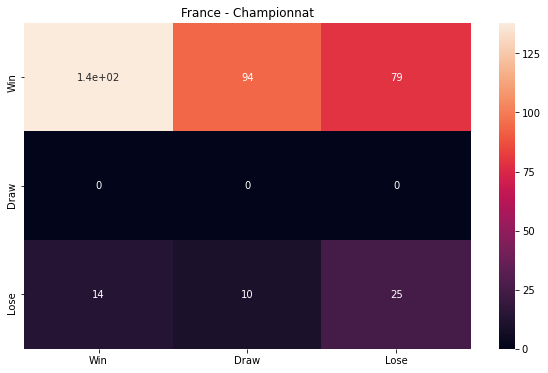

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.33 


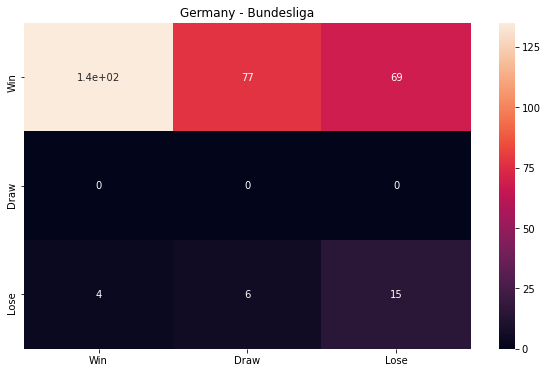

Accuracy: 49.02%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.60 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.28 


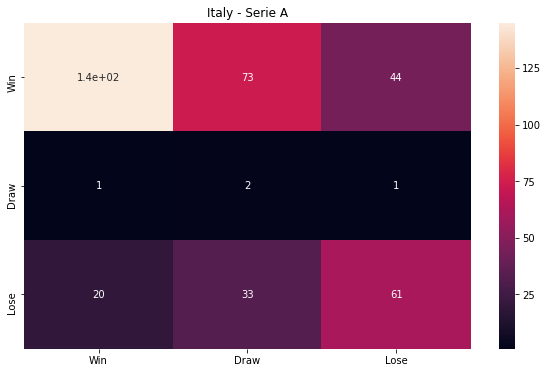

Accuracy: 54.74%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.58 
Recall: 	Win 0.55 	Draw 0.50 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 19 COMPLETE (20/25)
Time remaining: 827.949744 seconds (13.7991624 min)


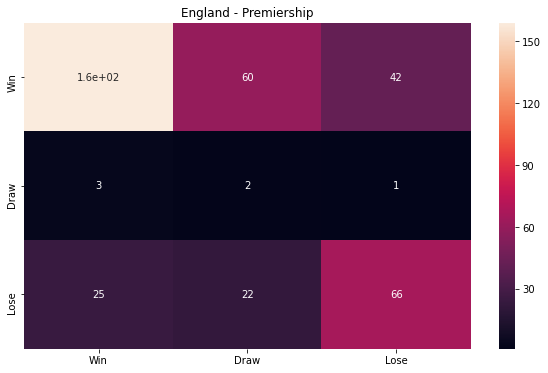

Accuracy: 59.74%
Precision: 	Win 0.85 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.33 	Lose 0.58 
F1: 	Win 0.71 	Draw 0.04 	Lose 0.59 


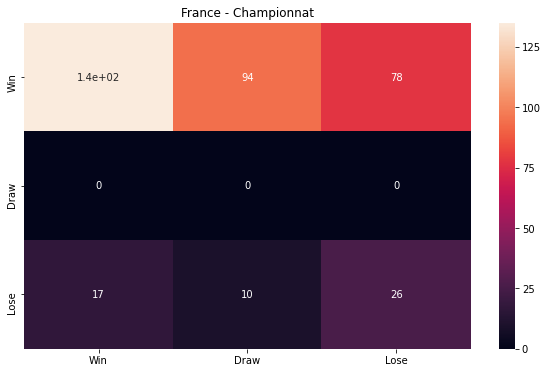

Accuracy: 44.72%
Precision: 	Win 0.89 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.49 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


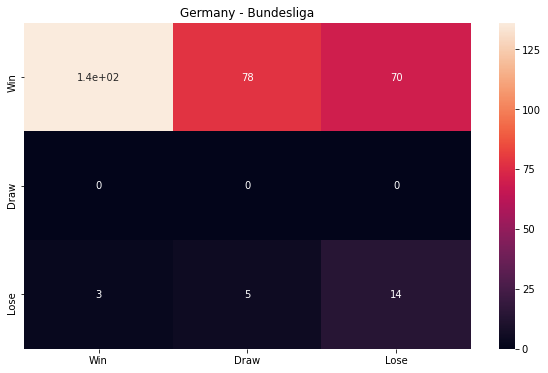

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


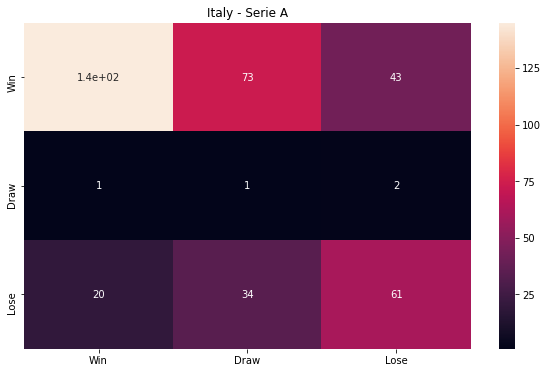

Accuracy: 54.47%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.58 
Recall: 	Win 0.56 	Draw 0.25 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 20 COMPLETE (21/25)
Time remaining: 757.82195 seconds (12.630365833333334 min)


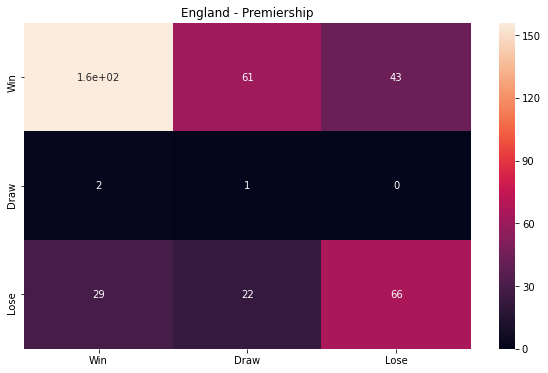

Accuracy: 58.68%
Precision: 	Win 0.83 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.33 	Lose 0.56 
F1: 	Win 0.70 	Draw 0.02 	Lose 0.58 


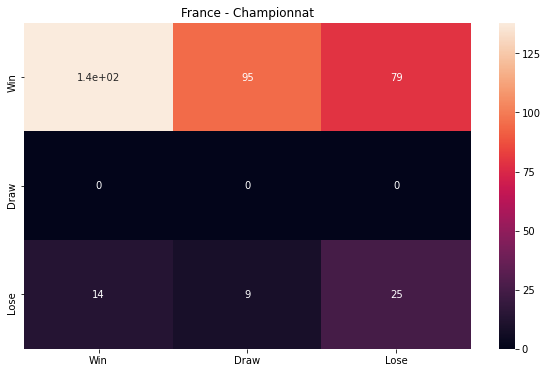

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


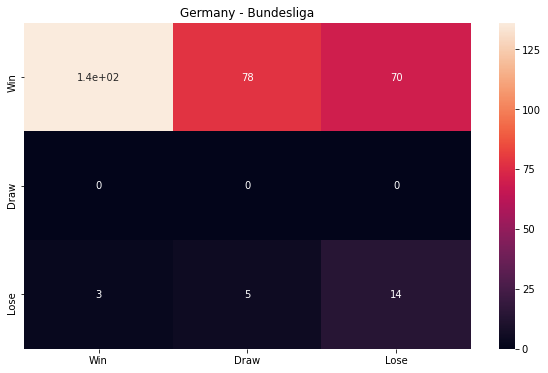

Accuracy: 49.02%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.64 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


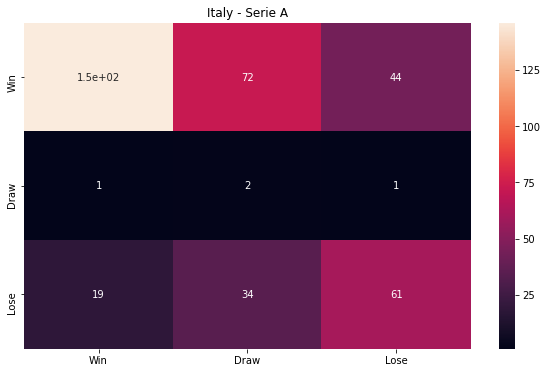

Accuracy: 55.0%
Precision: 	Win 0.88 	Draw 0.02 	Lose 0.58 
Recall: 	Win 0.56 	Draw 0.50 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 21 COMPLETE (22/25)
Time remaining: 603.220004 seconds (10.053666733333333 min)


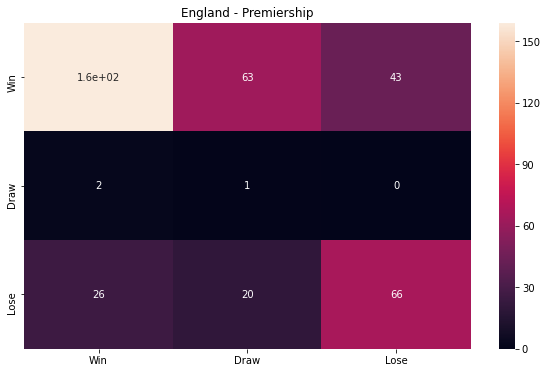

Accuracy: 59.47%
Precision: 	Win 0.85 	Draw 0.01 	Lose 0.61 
Recall: 	Win 0.60 	Draw 0.33 	Lose 0.59 
F1: 	Win 0.70 	Draw 0.02 	Lose 0.60 


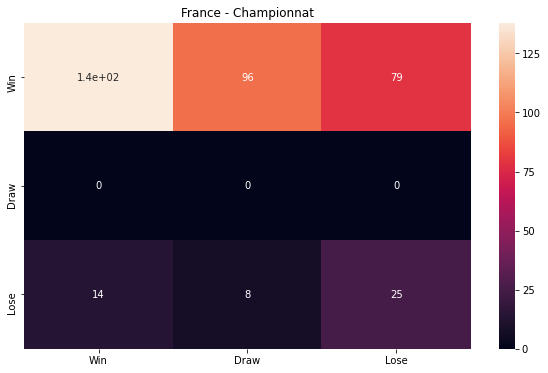

Accuracy: 45.28%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.24 
Recall: 	Win 0.44 	Draw 0.00 	Lose 0.53 
F1: 	Win 0.59 	Draw 0.00 	Lose 0.33 


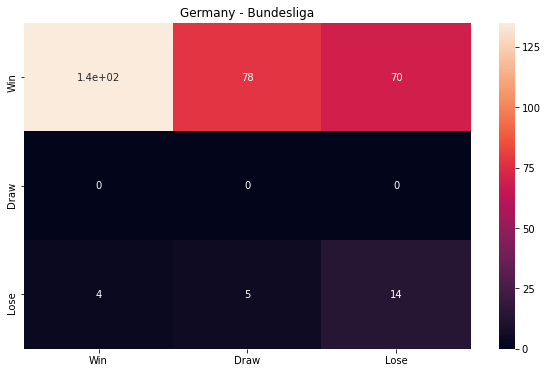

Accuracy: 48.69%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.17 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.61 
F1: 	Win 0.64 	Draw 0.00 	Lose 0.26 


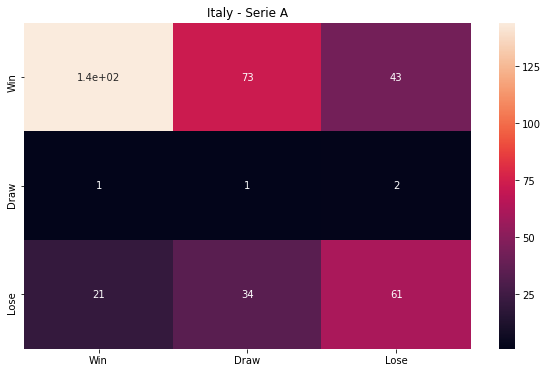

Accuracy: 54.21%
Precision: 	Win 0.87 	Draw 0.01 	Lose 0.58 
Recall: 	Win 0.55 	Draw 0.25 	Lose 0.53 
F1: 	Win 0.68 	Draw 0.02 	Lose 0.55 
Iteration 22 COMPLETE (23/25)
Time remaining: 459.90005099999996 seconds (7.665000849999999 min)


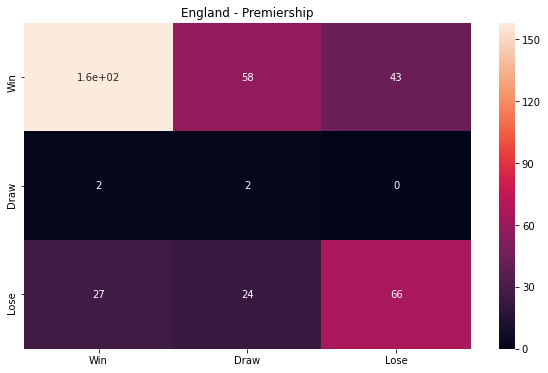

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.02 	Lose 0.61 
Recall: 	Win 0.61 	Draw 0.50 	Lose 0.56 
F1: 	Win 0.71 	Draw 0.05 	Lose 0.58 


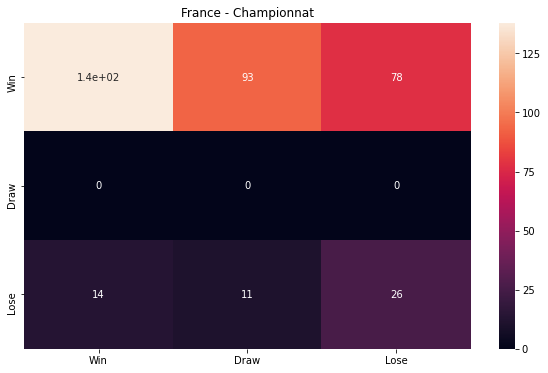

Accuracy: 45.56%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.51 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.34 


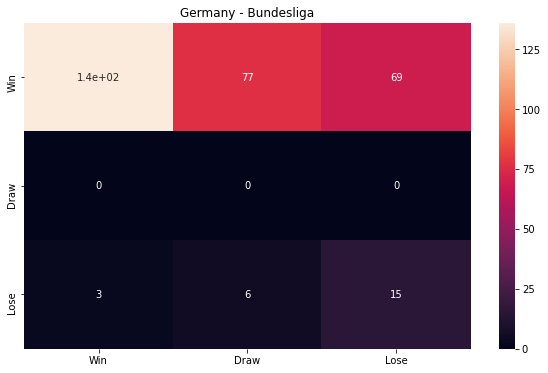

Accuracy: 49.35%
Precision: 	Win 0.98 	Draw 0.00 	Lose 0.18 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.62 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.28 


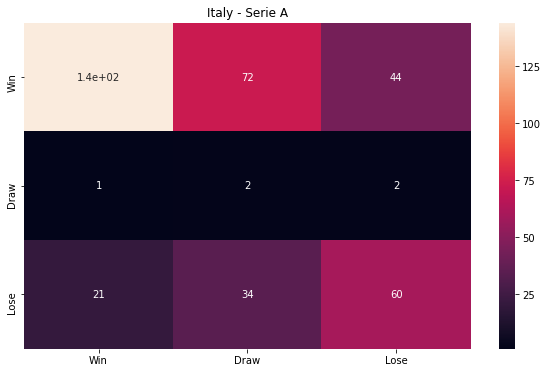

Accuracy: 54.21%
Precision: 	Win 0.87 	Draw 0.02 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.40 	Lose 0.52 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.54 
Iteration 23 COMPLETE (24/25)
Time remaining: 283.860294 seconds (4.7310049 min)


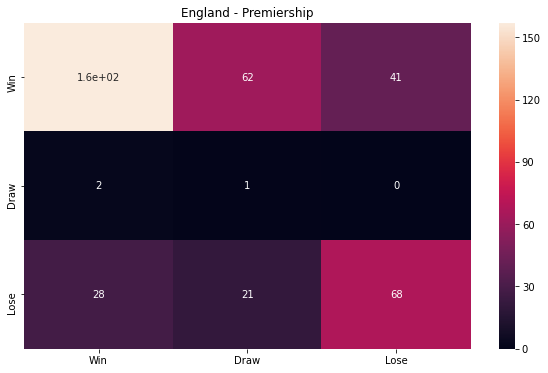

Accuracy: 59.47%
Precision: 	Win 0.84 	Draw 0.01 	Lose 0.62 
Recall: 	Win 0.60 	Draw 0.33 	Lose 0.58 
F1: 	Win 0.70 	Draw 0.02 	Lose 0.60 


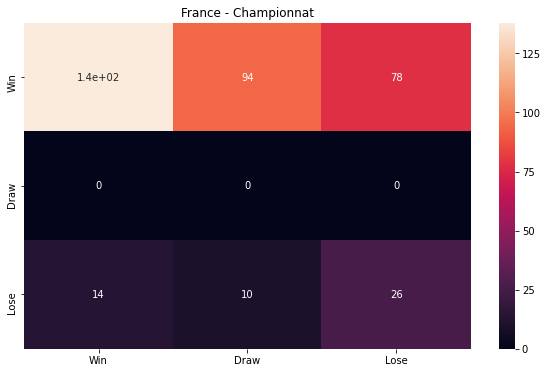

Accuracy: 45.56%
Precision: 	Win 0.91 	Draw 0.00 	Lose 0.25 
Recall: 	Win 0.45 	Draw 0.00 	Lose 0.52 
F1: 	Win 0.60 	Draw 0.00 	Lose 0.34 


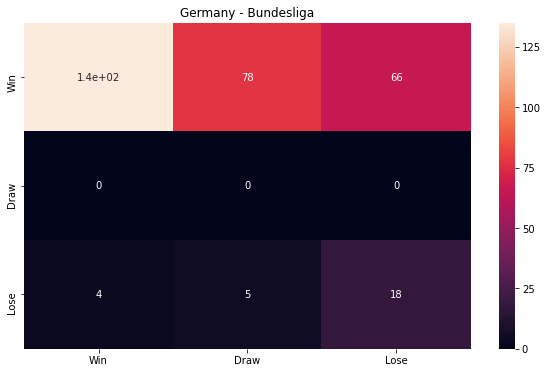

Accuracy: 50.0%
Precision: 	Win 0.97 	Draw 0.00 	Lose 0.21 
Recall: 	Win 0.48 	Draw 0.00 	Lose 0.67 
F1: 	Win 0.65 	Draw 0.00 	Lose 0.32 


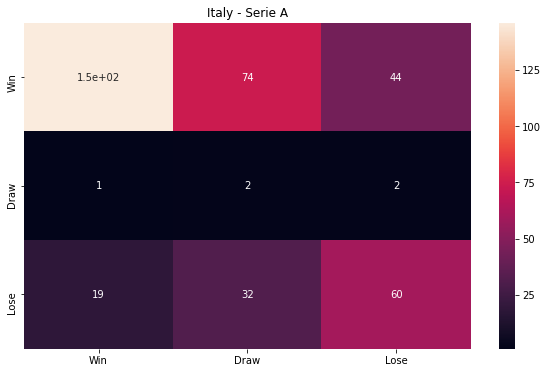

Accuracy: 54.74%
Precision: 	Win 0.88 	Draw 0.02 	Lose 0.57 
Recall: 	Win 0.55 	Draw 0.40 	Lose 0.54 
F1: 	Win 0.68 	Draw 0.04 	Lose 0.55 
Iteration 24 COMPLETE (25/25)
Time remaining: 138.057966 seconds (2.3009660999999997 min)

England - Premiership
Model Summary after 25 iterations:59.67368421052631 - test accuracy 
0.409580557017762 - acc std

France - Championnat
Model Summary after 25 iterations:45.13333333333335 - test accuracy 
0.3777777777777783 - acc std

Germany - Bundesliga
Model Summary after 25 iterations:49.07189542483659 - test accuracy 
0.3886553920867595 - acc std

Italy - Serie A
Model Summary after 25 iterations:54.49473684210525 - test accuracy 
0.3061692541526135 - acc std


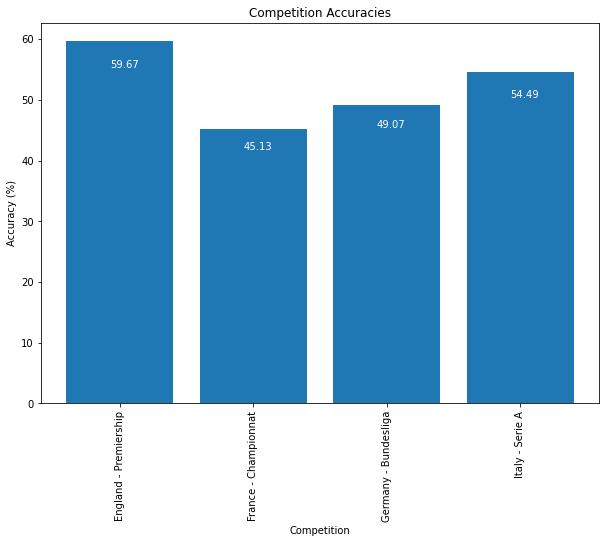

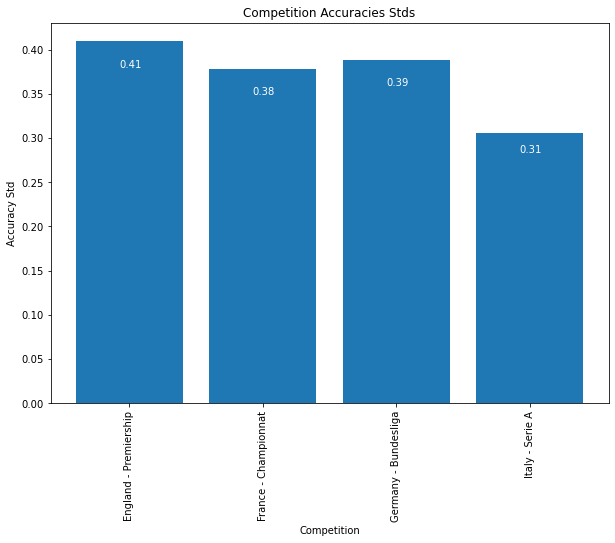

([59.67368421052631, 45.13333333333335, 49.07189542483659, 54.49473684210525],
 [0.409580557017762,
  0.3777777777777783,
  0.3886553920867595,
  0.3061692541526135])

In [19]:
competition_stats = {'England - Premiership': NnParams(batch_size=64,
                                                       epochs=30,
                                                       optimizer="Adamax",
                                                       learn_rate=0.001,
                                                       init_mode="glorot_uniform",
                                                       neurons_1=20,
                                                       neurons_2=20,
                                                       neurons_3=0,
                                                       activation="tanh",
                                                       dropout=0),
                     'France - Championnat': NnParams(batch_size=128,
                                                      epochs=70,
                                                      optimizer="Adam",
                                                      learn_rate=0.00025,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=30,
                                                      neurons_2=5,
                                                      neurons_3=5,
                                                      activation="relu",
                                                      dropout=0),
                     'Germany - Bundesliga': NnParams(batch_size=64,
                                                      epochs=10,
                                                      optimizer="Adagrad",
                                                      learn_rate=0.005,
                                                      init_mode="normal",
                                                      neurons_1=25,
                                                      neurons_2=25,
                                                      neurons_3=0,
                                                      activation="relu",
                                                      dropout=0),
                     'Italy - Serie A': NnParams(batch_size=128,
                                                 epochs=40,
                                                 optimizer="Adagrad",
                                                 learn_rate=0.0005,
                                                 init_mode="glorot_uniform",
                                                 neurons_1=20,
                                                 neurons_2=20,
                                                 neurons_3=10,
                                                 activation="tanh",
                                                 dropout=0)}     

run_nn(train[0], 
       train[1], 
       test[0], 
       test[1], 
       competition_names, 
       competition_stats, 
       num_of_iterations=25, 
       num_of_models=50, 
       verbose=2)

## Retrain Model NN

In [ ]:
def run_nn_retrain(train_data, 
                   train_lbls, 
                   test_data, 
                   test_lbls, 
                   competitions, 
                   nn_params, 
                   num_of_iterations=50, 
                   num_of_models=1, 
                   verbose=0):
    def plot_bar(data, labels, title, xlab, ylab):
        fig, ax = plt.subplots(figsize=(10,7))
        plt.bar(range(len(data)), data, align="center")
        plt.xticks(range(len(labels)), labels, rotation='vertical')
        ax.set_ylabel(ylab)
        ax.set_xlabel(xlab)
        plt.title(title)
        for i, v in enumerate(data):
            ax.text(i-0.075, v - (v * 0.075), str(round(v, 2)), color='white')
        plt.show()
            
    histories = {}
    avg_acc = {}
    avg_loss = {}
    for i in range(num_of_iterations):
        for competition in competitions:
            if competition not in avg_acc:
                avg_acc[competition] = []
            if competition not in avg_loss:
                avg_loss[competition] = []

            prediction_tracker = PredictionTracker(competition)
            if verbose > 1:
                start_time = datetime.now()
            nn_param = competition_stats[competition] if competition in competition_stats else competition_stats["ALL"]
            
            models = []
            test = test_data[competition]
            test_lbl = test_lbls[competition]
            train = train_data[competition]
            train_lbl = train_lbls[competition]
            accuracy = []
            while len(test) > 0:
                for m in range(num_of_models):
                    layers = []
                    layers.append(nn_param.get_first_layer())

                    if nn_param.has_second_layer():
                        layers.append(nn_param.get_second_layer())

                    if nn_param.has_third_layer():
                        layers.append(nn_param.get_third_layer())

                    if nn_param.has_dropout():
                        layers.append(nn_param.get_dropout())

                    layers.append(nn_param.get_out_layer())

                    model = keras.Sequential(layers)

                    optimizer = nn_param.get_optimizer()

                    model.compile(optimizer=optimizer,
                                  loss='sparse_categorical_crossentropy',
                                  metrics=['accuracy'])
                    histories[competition] = model.fit(train, 
                                                       np.array(train_lbl), 
                                                       epochs=nn_param.epochs, 
                                                       batch_size=nn_param.batch_size,
                                                       verbose=0)
                                                       #validation_split=0.2)
                    models.append(model)

                    if verbose > 2:
                        fig, ax = plt.subplots()
                        ax.plot(range(len(histories[competition].history['accuracy'])), 
                                histories[competition].history['accuracy'],
                                label="Train")
                        if 'val_accuracy' in histories[competition].history:
                            ax.plot(range(len(histories[competition].history['val_accuracy'])), 
                                    histories[competition].history['val_accuracy'], 
                                    color="red",
                                    label="Validation")
                        fig = plt.legend()
                        plt.title("Accuracy for " + str(competition))
                        plt.xlabel("Epochs")
                        plt.ylabel("Accuracy")
                        plt.show()

                        fig, ax = plt.subplots()
                        ax.plot(range(len(histories[competition].history['loss'])), 
                                histories[competition].history['loss'],
                                label="Train")
                        if 'val_loss' in histories[competition].history:
                            ax.plot(range(len(histories[competition].history['val_loss'])), 
                                    histories[competition].history['val_loss'], 
                                    color="red",
                                    label="Validation")
                        fig = plt.legend()
                        plt.title("Loss for " + str(competition))
                        plt.xlabel("Epochs")
                        plt.ylabel("Loss")
                        plt.legend(loc="upper left")
                        plt.show()

                        test_loss, test_acc = model.evaluate([test[0]], [test_lbl[0]], verbose=0)
                        print("\nTESTING THE MODEL:\n%s - test loss \t|\t %s - test accuracy" % (test_loss, test_acc*100))
                        avg_loss[competition].append(test_loss)

                assembled_predictions = []
                for model in models:
                    ypred = model.predict_classes(np.array([test[0]]))
                    for index, pred in enumerate(ypred):
                        try:
                            assembled_predictions[index].append(pred)
                        except IndexError:
                            assembled_predictions.append([pred])

                final_predictions = []
                for pred in assembled_predictions:
                    count_win = len([x for x in pred if x == 0])
                    count_lose = len([x for x in pred if x == 1])
                    count_draw = len([x for x in pred if x == 2])

                    if count_win >= count_lose and count_win >= count_draw:
                        final_predictions.append(0)
                    elif count_lose >= count_win and count_lose >= count_draw:
                        final_predictions.append(1)
                    else:
                        final_predictions.append(2)
                
                for index, prediction in enumerate(final_predictions):
                    # 0 - win; 1 - lose; 2 - draw
                    if prediction == 0:
                        if test_lbl[index] == 0:
                            prediction_tracker.correct_win(test[index][0])
                            accuracy.append(1)
                        elif test_lbl[index] == 1:
                            prediction_tracker.incorrect_win_as_lose(test[index][0])
                            accuracy.append(0)
                        else:
                            prediction_tracker.incorrect_win_as_draw(test[index][0])
                            accuracy.append(0)
                    elif prediction == 1:
                        if test_lbl[index] == 0:
                            prediction_tracker.incorrect_lose_as_win(test[index][2])
                            accuracy.append(0)
                        elif test_lbl[index] == 1:
                            prediction_tracker.correct_lose(test[index][2])
                            accuracy.append(1)
                        else:
                            prediction_tracker.incorrect_lose_as_draw(test[index][2])
                            accuracy.append(0)
                    elif prediction == 2:
                        if test_lbl[index] == 0:
                            prediction_tracker.incorrect_draw_as_win(test[index][1])
                            accuracy.append(0)
                        elif test_lbl[index] == 1:
                            prediction_tracker.incorrect_draw_as_lose(test[index][1])
                            accuracy.append(0)
                        else:
                            prediction_tracker.correct_draw(test[index][1])
                            accuracy.append(1)
                
                train = np.append(train, [test[0]], axis=0)
                train_lbl = np.append(train_lbl, [test_lbl[0]], axis=0)
                test = test[1:]
                test_lbl = test_lbl[1:]
                            
            accuracy = sum(accuracy) / float(len(accuracy))
            accuracy = accuracy * 100.0
            try:
                avg_acc[competition].append(accuracy)
            except KeyError:
                avg_acc[competition] = [accuracy]
            if verbose > 0:
                prediction_tracker.display_confusion_matrix()
                print("Accuracy: " + str(round(accuracy, 2)) + "%")
                print("Precision: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_precision(), 
                                                                                    prediction_tracker.draw_precision(),
                                                                                    prediction_tracker.lose_precision()))
                print("Recall: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_recall(), 
                                                                                 prediction_tracker.draw_recall(),
                                                                                 prediction_tracker.lose_recall()))
                print("F1: \tWin {:.2f} \tDraw {:.2f} \tLose {:.2f} ".format(prediction_tracker.win_f1(), 
                                                                             prediction_tracker.draw_f1(),
                                                                             prediction_tracker.lose_f1()))

            if verbose > 1:
                time_diff = datetime.now() - start_time
                print("Iteration %s COMPLETE (%s/%s)" % (i,
                                                         i+1,
                                                         num_of_iterations))
                print("Time remaining: %s seconds (%s min)" % ((num_of_iterations - i) * time_diff.total_seconds(),
                                                               (num_of_iterations - i) * time_diff.total_seconds()/60))

    avg_accuracies = []
    std_accuracies = []
    avg_losses = []
    std_losses = []
    for competition in competitions:
        avg_accuracies.append(sum(avg_acc[competition]) / num_of_iterations)
        std_accuracies.append(np.std(avg_acc[competition]))
        if verbose > 1:
            print("\n" + str(competition) + \
                  "\nModel Summary after " + str(num_of_iterations) + " iterations:" + \
                  str(sum(avg_acc[competition]) / num_of_iterations) + " - test accuracy \n" + \
                  str(np.std(avg_acc[competition])) + " - acc std")

        if verbose > 2:
            avg_losses.append(sum(avg_loss[competition]) / num_of_iterations)
            std_losses.append(np.std(avg_loss[competition]))
            print(str(sum(avg_loss[competition]) / num_of_iterations) + " - test loss \n" + \
                  str(np.std(avg_loss[competition])) + " - loss std")

    if verbose > 0:
        # Plot Accuracies
        plot_bar(avg_accuracies, competitions, "Competition Accuracies", "Competition", "Accuracy (%)")

        # Plot Accuracies Std
        plot_bar(std_accuracies, competitions, "Competition Accuracies Stds", "Competition", "Accuracy Std")

    if verbose > 2:
        # Plot Losses
        plot_bar(avg_losses, competitions, "Competition Losses", "Competition", "Loss")

        # Plot Losses Std
        plot_bar(std_losses, competitions, "Competition Losses Stds", "Competition", "Loss Std")

    return avg_accuracies, std_accuracies


competition_stats = {'England - Premiership': NnParams(batch_size=64,
                                                       epochs=30,
                                                       optimizer="Adamax",
                                                       learn_rate=0.001,
                                                       init_mode="glorot_uniform",
                                                       neurons_1=20,
                                                       neurons_2=20,
                                                       neurons_3=0,
                                                       activation="tanh",
                                                       dropout=0),
                     'France - Championnat': NnParams(batch_size=128,
                                                      epochs=70,
                                                      optimizer="Adam",
                                                      learn_rate=0.00025,
                                                      init_mode="glorot_uniform",
                                                      neurons_1=30,
                                                      neurons_2=5,
                                                      neurons_3=5,
                                                      activation="relu",
                                                      dropout=0),
                     'Germany - Bundesliga': NnParams(batch_size=64,
                                                      epochs=10,
                                                      optimizer="Adagrad",
                                                      learn_rate=0.005,
                                                      init_mode="normal",
                                                      neurons_1=25,
                                                      neurons_2=25,
                                                      neurons_3=0,
                                                      activation="relu",
                                                      dropout=0),
                     'Italy - Serie A': NnParams(batch_size=128,
                                                 epochs=40,
                                                 optimizer="Adagrad",
                                                 learn_rate=0.0005,
                                                 init_mode="glorot_uniform",
                                                 neurons_1=20,
                                                 neurons_2=20,
                                                 neurons_3=10,
                                                 activation="tanh",
                                                 dropout=0)}     

run_nn_retrain(train[0], 
       train[1], 
       test[0], 
       test[1], 
       competition_names, 
       competition_stats, 
       num_of_iterations=2, 
       num_of_models=2, 
       verbose=2)

C:\Users\anton\Anaconda3\envs\pp\lib\site-packages\theano\tensor\subtensor.py:2339: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[0][inputs[2:]] = inputs[1]
